In [ ]:
### looks like some errors in f2f_harmonised Income imputation

In [1]:
# %%time
## Just an easy way to load utility functions
dataset_name = "W19_only"
df_list = []

%matplotlib inline 
%run f2f_header.py {dataset_name} {df_list}

global BES_label_list, BES_df_list

# %run f2f_utility.py

Toggle code

In [2]:
dataset_name = "W19_only"
df_list = []
%run f2f_header.py {dataset_name} {df_list}

Toggle code

In [3]:
BES_df_list = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_df_list.pickle", "rb" ) )
# f2f_harmonised = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')
BES_label_list = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_label_list.pickle", "rb" ) )
demo_var_dict = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\demo_var_dict.pickle", "rb" ) )
var_type_dict_nonans = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\var_type_dict_nonans.pickle", "rb" ) )

f2f_harmonised = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised_temp.zip", compression='zip')


generic_cols = f2f_harmonised.columns
list_of_scale_harm_vars = ["Age","year_past_min_sch_leave_age","in_school_past_min_age"]



## BUGS

BES_label_list["1959"]["v1236"] = 'LOCAL ELECTION VOTE 1963(2nd)'
BES_label_list["1964"]["v1236"] = 'LOCAL ELECTION VOTE 1963(2nd)'
BES_label_list["1966"]["v1236"] = 'LOCAL ELECTION VOTE 1963(2nd)'
BES_label_list["1970"]["v1236"] = 'LOCAL ELECTION VOTE 1963(2nd)'

BES_label_list["2015"]['edlevel'] = 'Education level (summary)'

,inc_det,inc_norm,inc_norm_wt
inc_det,1.000000,0.928029,0.865011
inc_norm,0.928029,1.000000,0.951439
inc_norm_wt,0.865011,0.951439,1.000000


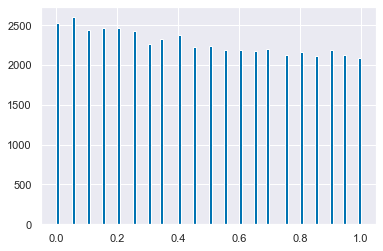

In [4]:
f2f_harmonised["AuthRight"] = f2f_harmonised["bloc_complete"]=="Right-Auth"
f2f_harmonised["LibLeft"] = f2f_harmonised["bloc_complete"]=="Left-Lib"

f2f_harmonised["CON"] = f2f_harmonised["vote_complete_simple"]=="CON"
f2f_harmonised["LAB"] = f2f_harmonised["vote_complete_simple"]=="LAB"
f2f_harmonised["DNV"] = f2f_harmonised["vote_complete_simple"]=="DNV"
f2f_harmonised["LD"]  = f2f_harmonised["vote_complete_simple"]=="LD"
f2f_harmonised["REFUK"]  = f2f_harmonised["vote_complete_simple"]=="REFUK"
f2f_harmonised["SNP"]  = f2f_harmonised["vote_complete_simple"]=="SNP"
f2f_harmonised["GP"]  = f2f_harmonised["vote_complete_simple"]=="GP"
f2f_harmonised["DK"]  = f2f_harmonised["vote_complete_simple"]=="DK"
f2f_harmonised["PC"]  = f2f_harmonised["vote_complete_simple"]=="PC"
f2f_harmonised["decade"] = f2f_harmonised["age"]/10
f2f_harmonised["generation"] = f2f_harmonised["age"]/20
inc_maxes = f2f_harmonised.groupby("dataset")["inc_det"].max().to_dict()
f2f_harmonised["inc_norm"] = f2f_harmonised.apply(lambda x: x["inc_det"]/inc_maxes[x["dataset"]] , axis=1 )#.groupby(f2f_harmonised["dataset"]).hist()
## do a proper version with weighting/quantiles

f2f_harmonised["inc_norm_wt"]=np.nan
temp = (f2f_harmonised[f2f_harmonised["wt"].notnull()].groupby("dataset").apply(lambda x: weighted_qcut(x["inc_det"],x["wt"],21)).cat.codes/20)
reverse_dict = {v:k for k,v in f2f_harmonised[f2f_harmonised["wt"].notnull()].groupby("dataset").apply(lambda x: x["uid"]).to_dict().items()}
f2f_harmonised.loc[f2f_harmonised["wt"].notnull(),"inc_norm_wt"]=temp.loc[f2f_harmonised["uid"][f2f_harmonised["wt"].notnull()].apply(lambda x: reverse_dict[x])].values
# weighted_qcut

f2f_harmonised["inc(quartile)"] = f2f_harmonised["inc_norm_wt"]*4
f2f_harmonised["inc_norm_wt"].hist(bins=100)
f2f_harmonised[["inc_det","inc_norm","inc_norm_wt"]].corr()


In [5]:
bool_cols = f2f_harmonised.select_dtypes('boolean').columns
f2f_harmonised[bool_cols] = f2f_harmonised[bool_cols].astype('float')

In [6]:
wt_means = f2f_harmonised.groupby("dataset")["wt"].mean().to_dict()
f2f_harmonised["wt_norm"] = f2f_harmonised.apply(lambda x: x["wt"]/wt_means[x["dataset"]] , axis=1 )

In [7]:
ge_to_date_dict = {'1959':"8/10/1959", '1964':"15/10/1964", '1966':"31/3/1966", '1970':"18/6/1970", '1974_feb':"28/2/1974",
 '1974_oct':"10/10/1974", '1979':"5/3/1979", '1983':"9/6/1983",'1987':"11/6/1987", '1992':"9/4/1992",
 '1997':"1/5/1997", '2001':"7/6/2001", '2005':"5/5/2005", '2010':"6/5/2010", '2015':"7/5/2015",
 '2017':"8/6/2017", '2019':"12/12/2019"}

def errplot(x, y, yerr, **kwargs):
    ax = plt.gca()
    data = kwargs.pop("data")
#     raise Exception
    data.plot(x=x, y=y, yerr=yerr,xerr=None, kind="line", ax=ax, **kwargs)

def OLS_party_housing(variance_scaled = False, regularised=False, regression_type="OLS",const=True,
                     cols = ['age', 'inc_det', 'gender_complete', 'housing'],drop_first=True,dummy_na=False,
                     dummied_cols = None,
                     mask = f2f_harmonised["bloc_complete"].isin(["Left-Lib","Right-Auth"]),
                     target = "auth_right_vote",
                     error_bars=False, hide_const=False,add_actual=False,
                     ax=None,single_legend=False,eyeline=True,alpha_const_actual=True,
                     ge_range = f2f_harmonised["dataset"].unique()):

    import statsmodels.api as sm
    from sklearn.preprocessing import StandardScaler
    from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
    wt_var = "wt_norm"
    
    
#     mask = 
    if regression_type=="Weighted_OLS":
        mask = mask & f2f_harmonised[wt_var].notnull()
    if dummied_cols == None:
        dummied_cols = list(pd.get_dummies(f2f_harmonised[cols][mask],drop_first=drop_first,dummy_na=dummy_na).columns)

    if const:
        dummied_cols = ["const"]+dummied_cols
    if add_actual:
        dummied_cols = ["actual"]+dummied_cols
    results_df = pd.DataFrame(columns = dummied_cols)        
    # add error_bar columns
    if error_bars:
        dummied_errs = [x+'_err' for x in dummied_cols]
        results_df[dummied_errs]=np.nan
        
    scaler = StandardScaler()

    for ge in ge_range:
    # ge = "1979"
        df = f2f_harmonised[mask][f2f_harmonised["dataset"][mask]==ge][cols+[target]]
        if regression_type == "Weighted_OLS":
            sample_weight = f2f_harmonised[mask][f2f_harmonised["dataset"][mask]==ge][wt_var]
#             raise Exception
        X = pd.get_dummies(df.drop([target],axis=1),drop_first=drop_first,dummy_na=dummy_na)
        X = X[intersection(X.columns, dummied_cols)]
        
        if variance_scaled:
            X = pd.DataFrame(scaler.fit_transform(X,sample_weight=sample_weight),columns=X.columns,index=X.index)
        if const:
            X = sm.add_constant(X)

        Y = df[target]
        if regression_type == "OLS":
            model = sm.OLS(Y,X)
        elif regression_type == "Logit":
            model = sm.Logit(Y,X)
        elif regression_type == "Probit":
            model = sm.Probit(Y,X)
        elif regression_type == "Weighted_OLS":
            if regularised:
                model = ElasticNet(fit_intercept=False,alpha=0.0)
#                 LinearRegression()
            else:
                model = LinearRegression(fit_intercept=False)
                
            model.fit(X, Y, sample_weight=sample_weight)
            

        # results.params
        if regression_type == "Weighted_OLS":
            results_df.loc[ge,X.columns] = model.coef_
        else:
            if regularised:        
                results = model.fit_regularized()
            else:
                results = model.fit()            
            results_df.loc[ge,X.columns] = results.params.values
            
        # error bars
        # dodgy, grabbing only
        if error_bars:
            if regression_type == "Weighted_OLS":
                model = sm.OLS(Y,X)
            # otherwise use sm model used prior
            results = model.fit()
            errors = results.conf_int()
            results_df.loc[ge,[x+"_err" for x in X.columns]] = (results_df.loc[ge,X.columns]-errors[0]).values
#             raise Exception
        
        if add_actual:
            if regression_type == "Weighted_OLS":
                results_df.loc[ge,"actual"] = sum(Y.loc[X.dropna().index]*sample_weight.loc[X.dropna().index])/sum(sample_weight.loc[X.dropna().index])
#                 (Y.loc[X.dropna().index]*sample_weight.loc[X.dropna().index]).mean()
#                 results_df.loc[ge,"actual"] = Y.mean()
#                 raise Exception
            else:
                results_df.loc[ge,"actual"] = Y.loc[X.dropna().index].mean()

    results_df = results_df.sort_index()

#     else:
#         title = title+"_unscaled"        
#     results_df.plot(kind='line',title=title)  

    if ax is None:
        plt.figure(figsize=(12,6));
        ax=plt.gca()
        
#     if single_legend:
#         legend=False
#     else:
#         legend='auto'
    x_label = "UK GE Date"
    y_label = "Impact on Probability"
    hue_label = "Factor"
    title = 'Probability of Voting: '+target
#     if variance_scaled:
#         title = title+"_scaled"
# #     else:
# #         title = title+"_unscaled"
#     if regularised:
#         title = title+"_regularised"    
    hue_name_replace_dict = {"inc_norm_wt":"income(decile)",
                         "generation":"age(generation)",
                         "gender_complete":"gender(female)",
                         "housing_OWN":"tenure(OWN&MORT)","housing_RENT":"tenure(RENT)",
                         "housing_det_OWN":"tenure(OWN)","housing_det_MORT":"tenure(MORT)","housing_det_OWN-MORT":"tenure(OWN&MORT)",
                         "housing_det_RENT-LA":"tenure(RENT-LA)","housing_det_RENT-PR":"tenure(RENT-PR)","housing_det_RENT-HA":"tenure(RENT-HA)","housing_det_RENT-ALL":"tenure(RENT)",
                         "age_left_education_3_15 or younger":"left_edu(15-)","age_left_education_3_16":"left_edu(16)",
                         "age_left_education_3_18":"left_edu(17-18)","age_left_education_3_19 or older":"left_edu(19+)",
                        }
#     sns.set(font_scale = 2)
    if error_bars:
        res_df = results_df[dummied_cols].reset_index().melt(id_vars='index')
        res_df["index"] = res_df["index"].replace(ge_to_date_dict).apply(lambda x: pd.to_datetime(x))
        res_df.columns = [x_label,hue_label,y_label]
        res_df[y_label] = res_df[y_label.astype('float')]

        err_df = results_df[dummied_errs].reset_index().melt(id_vars='index')
        err_df["index"] = err_df["index"].replace(ge_to_date_dict).apply(lambda x: pd.to_datetime(x))
        err_df.columns = [x_label,hue_label,y_label]
        err_df[y_label] = err_df[y_label].astype('float')
        res_df["yerr"] = err_df[y_label]
        if hide_const:
            res_df = res_df.replace("const",np.nan).dropna()
#         res_df
        res_df=res_df.replace(hue_name_replace_dict)
        g = sns.FacetGrid(res_df, hue=hue_label,height=6,aspect=1.5)
        g.map_dataframe(errplot, x_label, y_label, "yerr",ax=ax)# test ax!
        g.add_legend()    
    
    else:
        

        res_df = results_df.reset_index().melt(id_vars='index')
        res_df["index"] = res_df["index"].replace(ge_to_date_dict).apply(lambda x: pd.to_datetime(x))
        res_df.columns = [x_label,hue_label,y_label]
        res_df[y_label] = res_df[y_label].astype('float')
        if hide_const:
            res_df = res_df.replace("const",np.nan).dropna()
        res_df=res_df.replace(hue_name_replace_dict)
        sns.lineplot(data = res_df,x=x_label,y=y_label,hue=hue_label,style=hue_label,markers=True,ax=ax);
        ax.set_xlabel(x_label,fontsize=16);
        ax.set_ylabel(y_label,fontsize=22);
        ax.set_title(title,fontsize=22);
#         plt.xticks(rotation=90);   
#         plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    if eyeline:
        ax.axhline(0, color ='grey', lw = 2, alpha=.2);
    if alpha_const_actual:
        if const or add_actual:
            ax.get_lines()[0].set_alpha(.5);   
        if const and add_actual:
            ax.get_lines()[1].set_alpha(.5);   

    if single_legend:
        handles, labels = ax.get_legend_handles_labels()
        ax.get_legend().remove()
        legend_data = (handles, labels)
    else:
        legend_data = None
    
    
    return res_df,legend_data

In [8]:
def plot_OLS_set(target_list, X_list, figsize=(16.5, 6),  sharey=True, regression_type="Weighted_OLS",regularised=False,
                 variance_scaled=False,drop_first=False,hide_const=False,add_actual=True,dummied_cols=None, single_legend=True,
                 mask=f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull(),
                 ge_range = f2f_harmonised["dataset"].unique()):
    
    fig, axs = plt.subplots(ncols=len(target_list),figsize=figsize, sharey=sharey);
    ax_pos = 0
    for target in target_list:
        df,(handles, labels)=OLS_party_housing(variance_scaled=variance_scaled,drop_first=drop_first,cols = X_list,
                    target=target,mask = mask,
                    regression_type=regression_type, regularised=regularised, hide_const=hide_const,add_actual=add_actual,
                    dummied_cols=dummied_cols,single_legend=single_legend,
                    ax=axs[ax_pos],ge_range=ge_range)
        ax_pos=ax_pos+1
    if single_legend:
#         handles, labels = axs[0].get_legend_handles_labels()
        fig.legend(handles, labels, 
                   loc='upper center',
                   bbox_to_anchor=(0.5, 0.05), bbox_transform = plt.gcf().transFigure,
                   fancybox=False, shadow=False, ncol=5);
#         raise Exception
#     return (handles, labels)

In [49]:
generic_cols = f2f_harmonised.columns
list_of_scale_harm_vars = ["Age","year_past_min_sch_leave_age","in_school_past_min_age"]

def run_ge_regression(ge,target_var,demo_var_only=True,min_features=10,
                      harmonised_only=False,drop_vars = [],get_predictions=False,dependence_plots=False,
                     harm_vars = ["wt","age","housing_det",
#                                   "inc_det","inc",
                 #,"bloc_complete"
#                  'gender', 
                                  'gender_complete', 'age_left_education',
#            'age_left_education_2', 
                                  'age_left_education_3', 'anyQuals',
           'rsa_or_city_and_guilds', 'overseas_other_postschl', 'overseas_degree',
           'other_academic_vocational', 'other_tech_business',
           'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
           'trade_appenticeship', 'nursing', 'teachers_training',
           'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
           'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
           'rsa_other_commercial', 'school_cert_or_matric',
           'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
           'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
           'professional_qualification', 'spec_qual_gained_at_work',
           'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
           'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5', 
           'att_university', 'att_commercial_training',
           'att_polytech_or_techcollege', 'att_night_school',
           'att_non_voc_training', 'att_other', 'att_art_school',
           'att_college_of_commerce', 'att_teacher_training',
           'att_trade_military_apprent', 'att_tech_college_teacher_nursing',
           'att_tech_or_occ_training', 'att_summer_schl_corresp_courses',
           'att_NoFE', 'att_forces_training', 'school_type', 'school_selective',
           'school_fees', 'school_fees_when', 'school_where', 'school_type_2','inc_norm_wt',
            'ec_left_right_complete','soc_lib_auth_complete']):

    target_var = target_var
    harm_vars = harm_vars + [target_var]
    target_var_replace_dict = {}
    target_var_drop_list = []
    target_var_title_pair = ["Lower Income","Higher Income"]
    var_stub = target_var
    min_features = min_features
    drop_vars = drop_vars
    drop_std_thresh = 0

    alg = get_xgboost_alg(classification_problem=False)
    demo_var_only=demo_var_only
    dependence_plots=dependence_plots

    # find variables with no coverage/variation in focal instances (mask)
    df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
           var_stub,harm_vars,min_features,dependence_plots=dependence_plots,drop_vars=drop_vars,demo_var_only=demo_var_only,
                           harmonised_only=harmonised_only,
                          )
    if get_predictions:
        mask = df_pred[target_var].isnull()
    else:
        mask = df_pred[target_var].notnull()
    stds = df_pred[mask].std()
    drop_vars = drop_vars + list(stds[stds.isnull()].index)+list(stds[stds<=drop_std_thresh].index)
    drop_vars = [x for x in drop_vars if x not in ["wt",var_stub]]

    (explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,
                                                                                         target_var_drop_list,target_var_title_pair,
           var_stub,harm_vars,min_features,dependence_plots=dependence_plots,drop_vars=drop_vars,demo_var_only=demo_var_only,alg=alg,
                                                                                        harmonised_only=harmonised_only)

    if get_predictions:
        # setup df back up
        df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
               var_stub,harm_vars,min_features,dependence_plots=dependence_plots,drop_vars=drop_vars,demo_var_only=demo_var_only,
                              harmonised_only=harmonised_only)
        # # use fitted algorithm to predict values
        predictions = pd.Series(alg.predict(df_pred[train_columns]),index=df_pred[target_var].index)#.round()
        return predictions,shap_values,train_columns
        # inc_pred = pd.Series(alg.predict(df_pred[train_columns]),index=inc.index).round()
        # income_var_df_sm.loc[income_var_df_sm[ge].isnull(),ge] = pd.Series(inc_pred,index=income_var_df_sm[ge].index).apply(round)[income_var_df_sm[ge].isnull()]

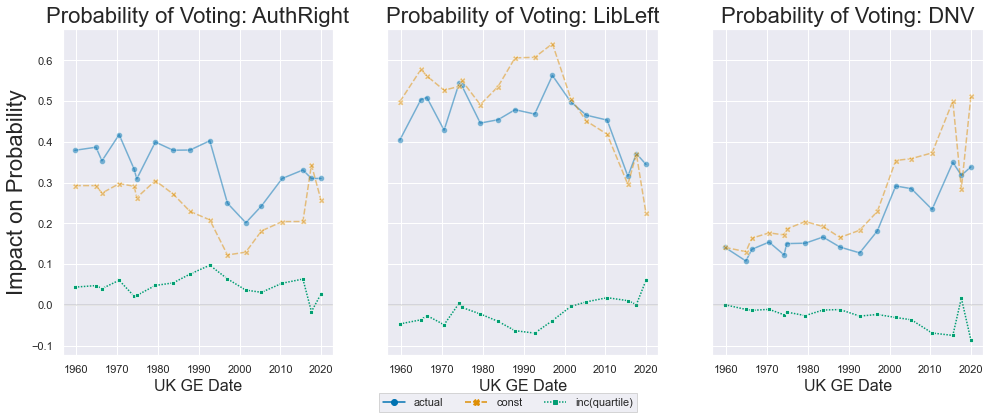

In [31]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["inc(quartile)"], figsize=(16.5, 6),  sharey=True, drop_first=True)

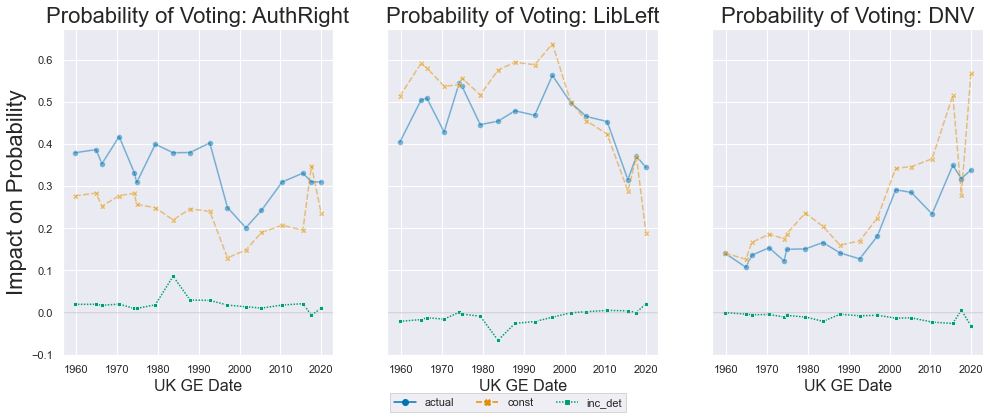

In [33]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["inc_det"], figsize=(16.5, 6),  sharey=True, drop_first=True)

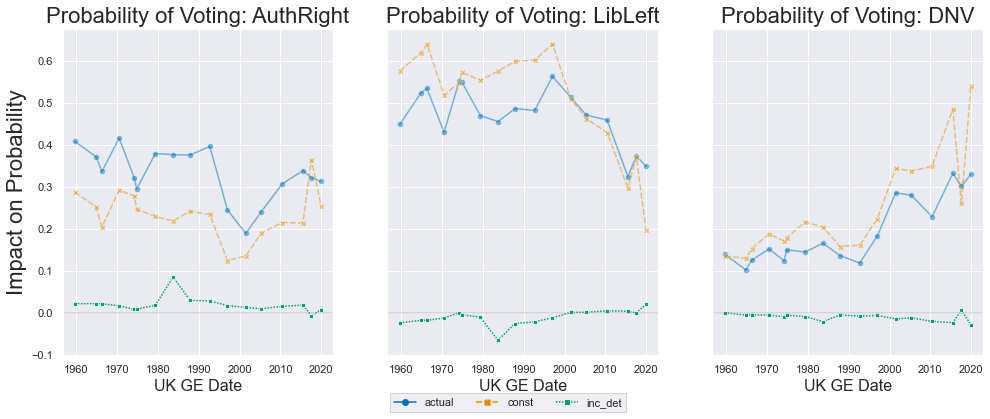

In [34]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["inc_det"], figsize=(16.5, 6),  sharey=True, drop_first=True,
            mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull() )

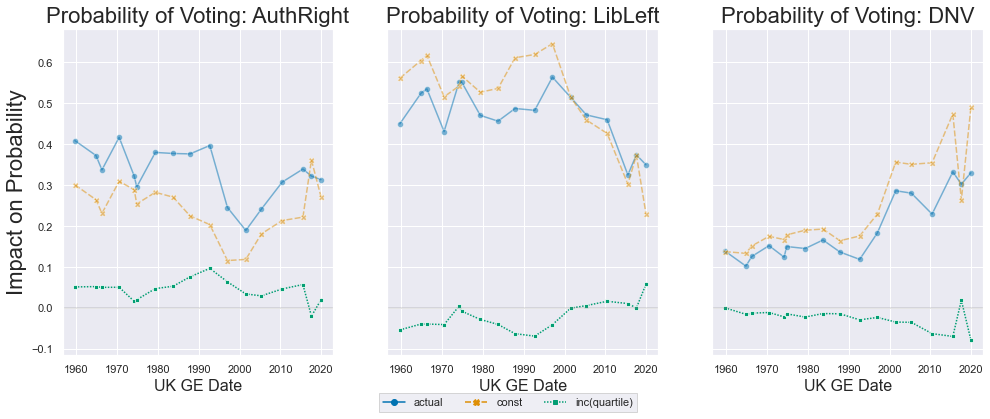

In [35]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["inc(quartile)"], figsize=(16.5, 6),  sharey=True, drop_first=True,
            mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull() )

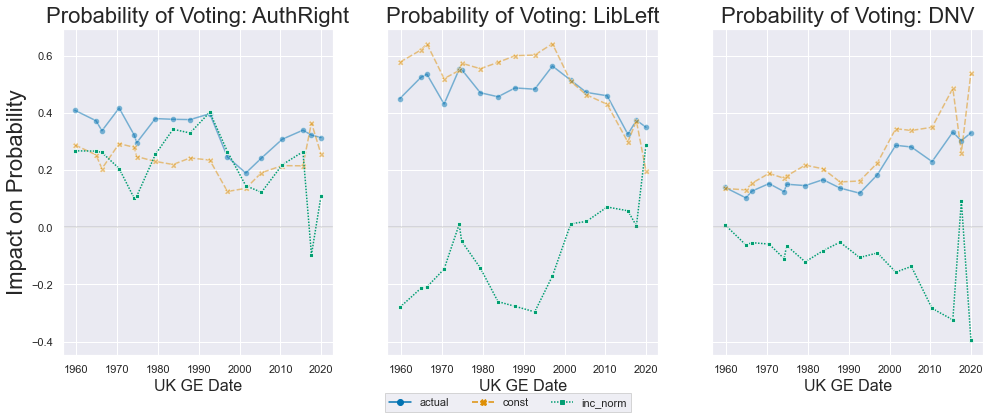

In [37]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["inc_norm"], figsize=(16.5, 6),  sharey=True, drop_first=True,
            mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull() )

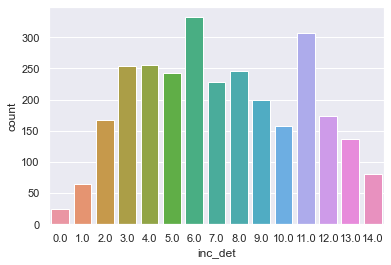

In [41]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2019")

sns.countplot( f2f_harmonised["inc_det"][mask] )

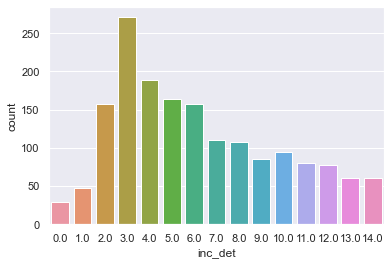

In [42]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2017")

sns.countplot( f2f_harmonised["inc_det"][mask] )

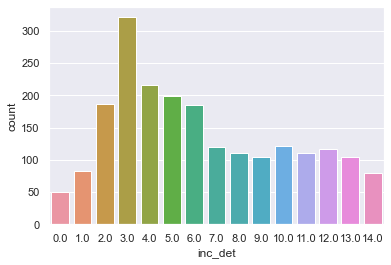

In [43]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2015")

sns.countplot( f2f_harmonised["inc_det"][mask] )

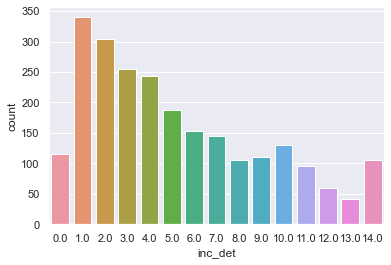

In [44]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2010")

sns.countplot( f2f_harmonised["inc_det"][mask] )

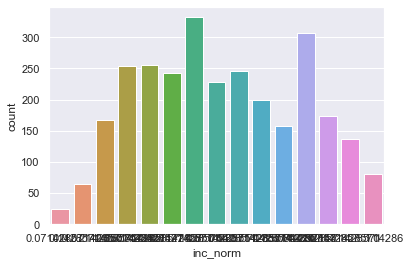

In [47]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2019")

sns.countplot( f2f_harmonised["inc_norm"][mask] );
# plt.xticks(rotation=90);

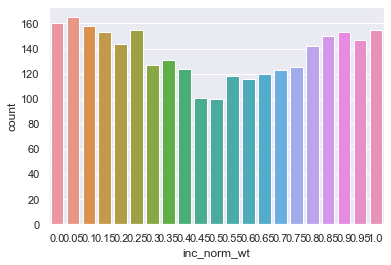

In [48]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2019")

sns.countplot( f2f_harmonised["inc_norm_wt"][mask] );
# plt.xticks(rotation=90);

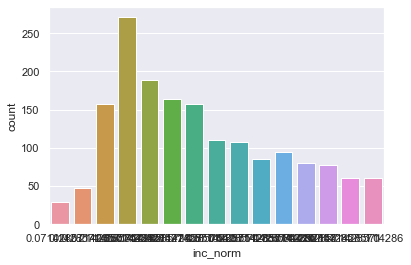

In [49]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2017")

sns.countplot( f2f_harmonised["inc_norm"][mask] );
# plt.xticks(rotation=90);

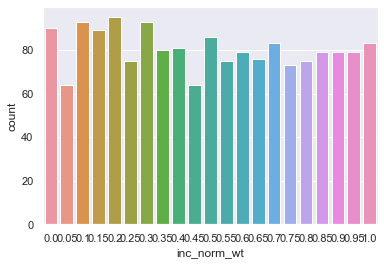

In [50]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2017")

sns.countplot( f2f_harmonised["inc_norm_wt"][mask] );
# plt.xticks(rotation=90);

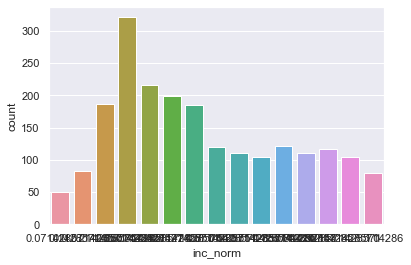

In [51]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2015")

sns.countplot( f2f_harmonised["inc_norm"][mask] );
# plt.xticks(rotation=90);

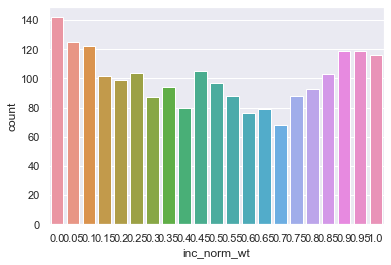

In [52]:
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised["inc"].notnull()\
    &(f2f_harmonised["dataset"]=="2015")

sns.countplot( f2f_harmonised["inc_norm_wt"][mask] );
# plt.xticks(rotation=90);

In [ ]:
## crosstab with weights

In [83]:
ylims = [.05,.55]

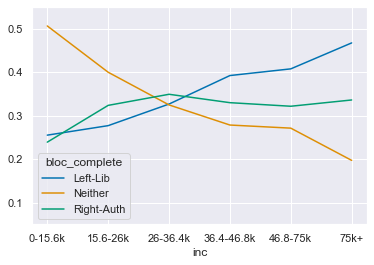

In [84]:
## DNV in 2019, voted ? in 2017
# DK/pref not to say -> big swing from women

df = f2f_harmonised[f2f_harmonised["dataset"]=="2019"]
# mask = df["inc"].notnull()
#(BES_df_list["2019"]["u05"]=="Conservative")
pd.crosstab(df["inc"],df["bloc_complete"],
            values=df["wt_norm"],aggfunc=sum,normalize='index',
#            margins='all'
           ).plot(kind='line')
plt.ylim(ylims);

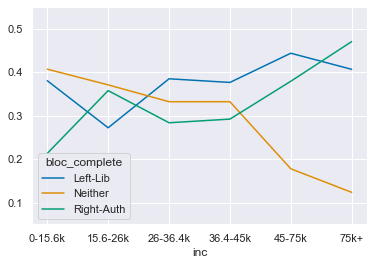

In [85]:
## DNV in 2019, voted ? in 2017
# DK/pref not to say -> big swing from women

df = f2f_harmonised[f2f_harmonised["dataset"]=="2017"]
# mask = df["inc"].notnull()
#(BES_df_list["2019"]["u05"]=="Conservative")
pd.crosstab(df["inc"],df["bloc_complete"],
            values=df["wt_norm"],aggfunc=sum,normalize='index',
#            margins='all'
           ).plot(kind='line')
plt.ylim(ylims);

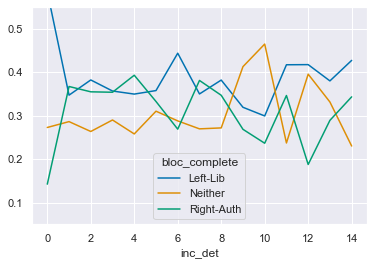

In [135]:
## DNV in 2019, voted ? in 2017
# DK/pref not to say -> big swing from women

df = f2f_harmonised[f2f_harmonised["dataset"]=="2017"]
mask = df["inc"].notnull()
#(BES_df_list["2019"]["u05"]=="Conservative")
pd.crosstab(df["inc_det"][mask],df["bloc_complete"][mask],
            values=df["wt_norm"][mask],aggfunc=sum,
            normalize='index',
#            margins='all'
           ).plot(kind='line')
plt.ylim(ylims);

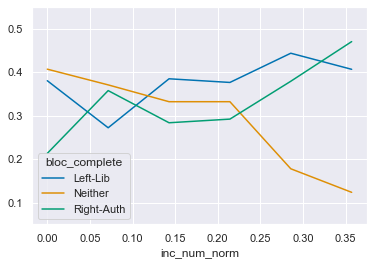

In [132]:
## DNV in 2019, voted ? in 2017
# DK/pref not to say -> big swing from women

df = f2f_harmonised[f2f_harmonised["dataset"]=="2017"]
mask = df["inc"].notnull()
#(BES_df_list["2019"]["u05"]=="Conservative")
pd.crosstab(df["inc_num_norm"][mask],df["bloc_complete"][mask],
            values=df["wt_norm"][mask],aggfunc=sum,
            normalize='index',
#            margins='all'
           ).plot(kind='line')
plt.ylim(ylims);

In [ ]:
# inc_maxes = f2f_harmonised.groupby("dataset")["inc_det"].max().to_dict()
# f2f_harmonised["inc_norm"] = f2f_harmonised.apply(lambda x: x["inc_det"]/inc_maxes[x["dataset"]] , axis=1 )#.groupby(f2f_harmonised["dataset"]).hist()
# ## do a proper version with weighting/quantiles

# f2f_harmonised["inc_norm_wt"]=np.nan
# temp = (f2f_harmonised[f2f_harmonised["wt"].notnull()].groupby("dataset").apply(lambda x: weighted_qcut(x["inc_det"],x["wt"],21)).cat.codes/20)
# reverse_dict = {v:k for k,v in f2f_harmonised[f2f_harmonised["wt"].notnull()].groupby("dataset").apply(lambda x: x["uid"]).to_dict().items()}
# f2f_harmonised.loc[f2f_harmonised["wt"].notnull(),"inc_norm_wt"]=temp.loc[f2f_harmonised["uid"][f2f_harmonised["wt"].notnull()].apply(lambda x: reverse_dict[x])].values
# # weighted_qcut


In [125]:
inc_dict = {}

f2f_harmonised.groupby("dataset")["inc"].apply(lambda x: inc_dict.update({x.astype('category').cat.categories[k]:k for k in range(0,len(x.astype('category').cat.categories))}))

dataset
1959        None
1964        None
1966        None
1970        None
1974_feb    None
1974_oct    None
1979        None
1983        None
1987        None
1992        None
1997        None
2001        None
2005        None
2010        None
2015        None
2017        None
2019        None
Name: inc, dtype: object

In [130]:
inc_dict = {'lowest 3rd': 0,
 'middle 3rd': 1,
 'upper 3rd': 2,
 'above average': 2,
 'average': 1,
 'below average': 0,
 '0-5k': 0,
 '05-10k': 1,
 '10-15k': 2,
 '15k+': 3,
 '1st 1/4(lowest)': 0,
 '2nd 1/4': 1,
 '3rd 1/4': 2,
 '4th 1/4': 3,
 '1st fifth (lowest)': 0,
 '2nd fifth': 1,
 '3rd fifth': 2,
 '4th fifth': 3,
 '5th fifth': 4,
 '0-15k': 0,
 '15-25k': 1,
 '25-35k': 2,
 '35-45k': 3,
 '45-60k': 4,
 '60k+': 5,
 '45-70k': 4,
 '70k+': 5,
 '0-15.6k': 0,
 '15.6-26k': 1,
 '26-36.4k': 2,
 '36.4-45k': 3,
 '45-75k': 4,
 '75k+': 5,
 '36.4-46.8k': 3,
 '46.8-75k': 4}

f2f_harmonised["inc_num"] = f2f_harmonised["inc"].replace(inc_dict)
inc_num_maxes = f2f_harmonised.groupby("dataset")["inc_num"].max().to_dict()
f2f_harmonised["inc_num_norm"] = f2f_harmonised.apply(lambda x: x["inc_num"]/inc_maxes[x["dataset"]] , axis=1 )

In [101]:
f2f_harmonised[["inc_det","inc_norm","inc_norm_wt"]].corr()

,inc_det,inc_norm,inc_norm_wt
inc_det,1.000000,0.927910,0.866745
inc_norm,0.927910,1.000000,0.951784
inc_norm_wt,0.866745,0.951784,1.000000


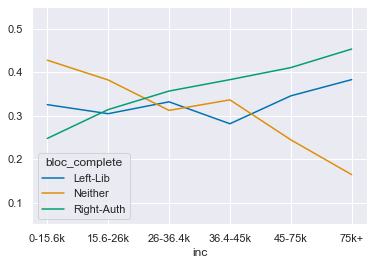

In [86]:
## DNV in 2019, voted ? in 2017
# DK/pref not to say -> big swing from women

df = f2f_harmonised[f2f_harmonised["dataset"]=="2015"]
# mask = df["inc"].notnull()
#(BES_df_list["2019"]["u05"]=="Conservative")
pd.crosstab(df["inc"],df["bloc_complete"],
            values=df["wt_norm"],aggfunc=sum,normalize='index',
#            margins='all'
           ).plot(kind='line')
plt.ylim(ylims);

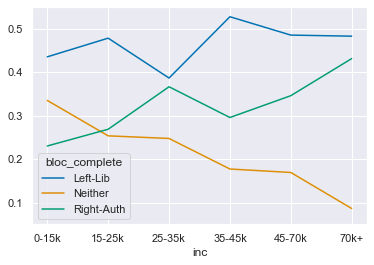

In [87]:
## DNV in 2019, voted ? in 2017
# DK/pref not to say -> big swing from women

df = f2f_harmonised[f2f_harmonised["dataset"]=="2010"]
# mask = df["inc"].notnull()
#(BES_df_list["2019"]["u05"]=="Conservative")
pd.crosstab(df["inc"],df["bloc_complete"],
            values=df["wt_norm"],aggfunc=sum,normalize='index',
#            margins='all'
           ).plot(kind='line')
plt.ylim(ylims);

In [138]:
# ge = "2010"
for ge in f2f_harmonised["dataset"].unique():
    df = f2f_harmonised[f2f_harmonised["dataset"]==ge]
    print(ge,df["inc_num_norm"].corr(df["inc_det"]))

2019 0.965260900491183
2017 -0.015380761371684433
2015 0.9818279243281635
2010 0.9829263035750131
2005 0.9838819006982998
2001 0.9784010129396599
1997 0.9796294032072922
1992 0.9316784982249179
1987 0.957283133777793
1983 0.953233337128938
1979 0.9092220033862753
1974_feb 0.9268934814619096
1974_oct 0.9240194654500083
1970 0.9161090213700588
1966 0.9068852488412067
1964 0.9075406610297624
1959 0.9075406610297624


In [202]:
inc = BES_df_list[ge]["y01"].cat.remove_categories(["Refused",'Don`t know']).cat.codes.replace(-1,np.nan)

In [207]:
f2f_harmonised[f2f_harmonised["dataset"]=="2017"]["inc"].astype('category').cat.codes.corr(inc)

0.9833695507414087

In [209]:
f2f_harmonised[f2f_harmonised["dataset"]=="2017"]["inc"].astype('category').cat.codes.corr(f2f_harmonised[f2f_harmonised["dataset"]=="2017"]["inc_det"])

0.9833695507414087

In [210]:
ge = "2017"
# inc = BES_df_list[ge]["hhincqua"].cat.remove_categories(['refused', "don't   know", 'not     answered']).cat.codes.replace(-1,np.nan)
# inc = BES_df_list[ge]["hhincome"].cat.remove_categories(['form not completed','defaced ballot', 'refusal', "don't   know", 'not     answered']).cat.codes.replace(-1,np.nan)
# inc = BES_df_list[ge][['aq45','bq78','incomes']].replace("refused",np.nan).replace("don't know",np.nan).fillna(axis=1,method='ffill')["incomes"]
# replace_dict = {98:np.nan,99:np.nan,999:np.nan,9999:np.nan}
# inc = BES_df_list[ge][["aq55","bq84","tq84"]].replace(replace_dict).fillna(axis=1,method='ffill')["tq84"]
inc = BES_df_list[ge]["y01"].cat.remove_categories(["Refused",'Don`t know']).cat.codes.replace(-1,np.nan)
# BES_df_list[ge][["aq70","bq96","zq96"]].fillna(method='ffill',axis=1)["zq96"].cat.codes.replace(-1,np.nan)
# inc.cat.categories[-3:]
# inc = inc.cat.codes.replace(-1,np.nan).astype('float')
inc.value_counts(dropna=False)
mask = inc.isnull()
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"inc_det"] = inc.astype('float')

MSE: 8.41, MAE: 2.26, EV: 0.44, R2: 0.44


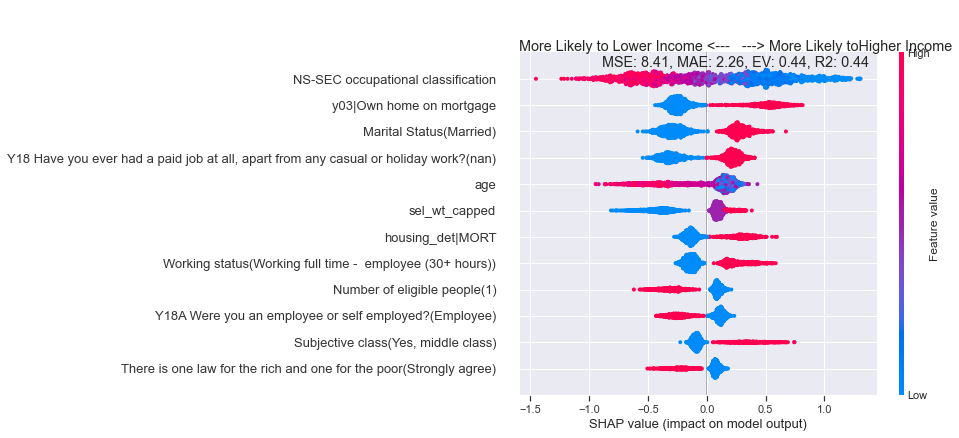

<Figure size 1152x720 with 0 Axes>

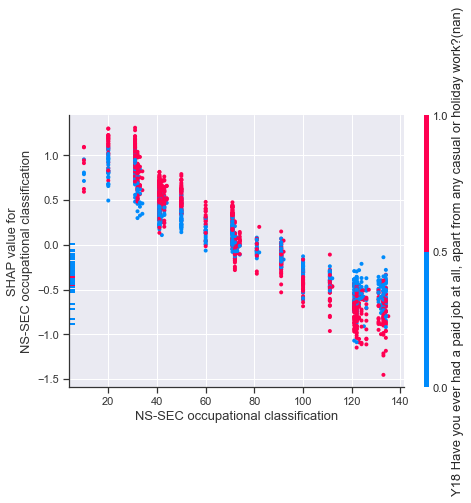

<Figure size 1152x720 with 0 Axes>

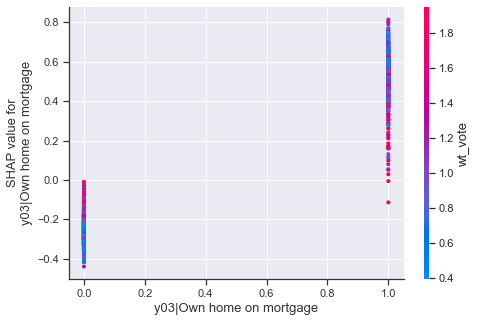

<Figure size 1152x720 with 0 Axes>

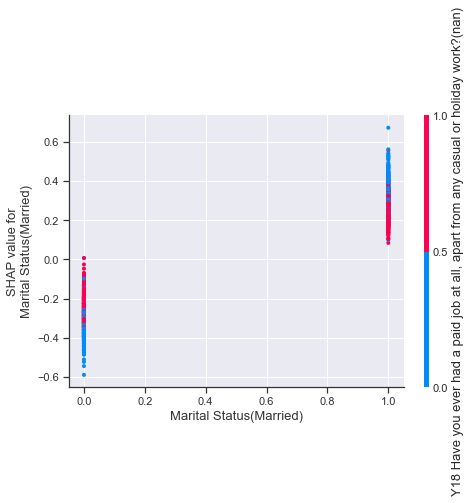

<Figure size 1152x720 with 0 Axes>

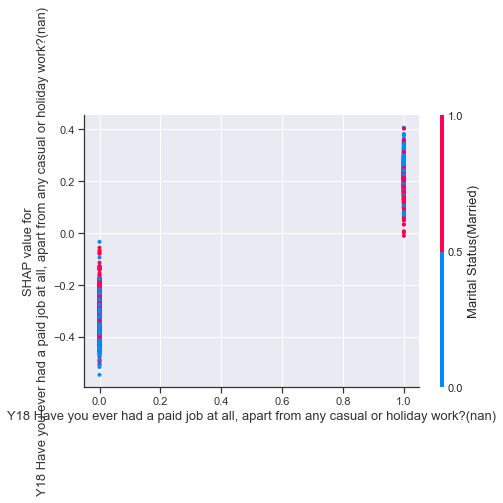

<Figure size 1152x720 with 0 Axes>

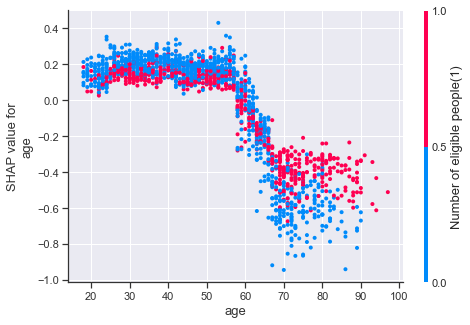

<Figure size 1152x720 with 0 Axes>

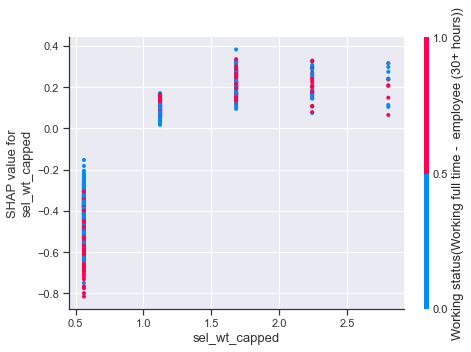

<Figure size 1152x720 with 0 Axes>

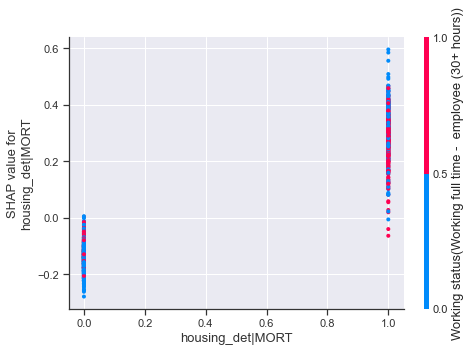

<Figure size 1152x720 with 0 Axes>

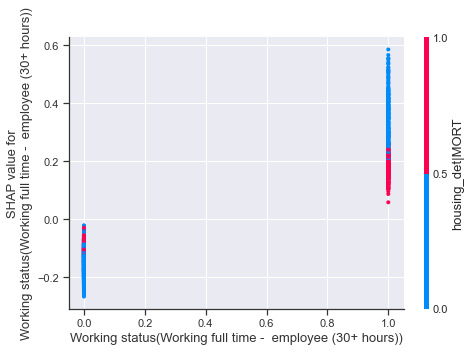

<Figure size 1152x720 with 0 Axes>

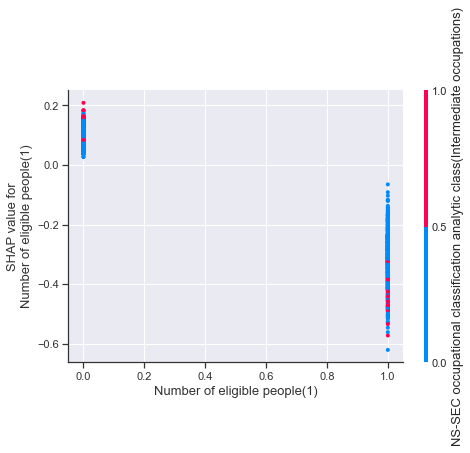

<Figure size 1152x720 with 0 Axes>

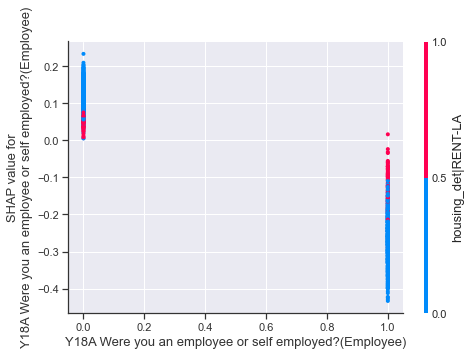

<Figure size 1152x720 with 0 Axes>

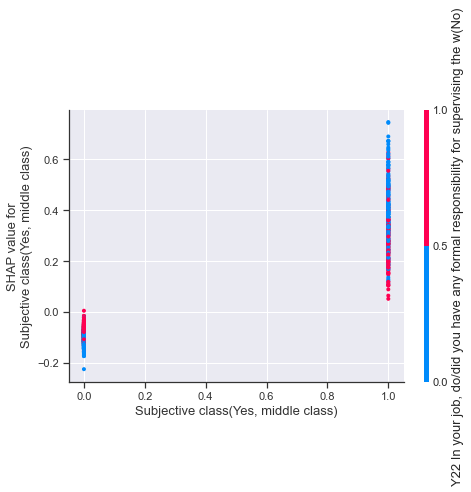

<Figure size 1152x720 with 0 Axes>

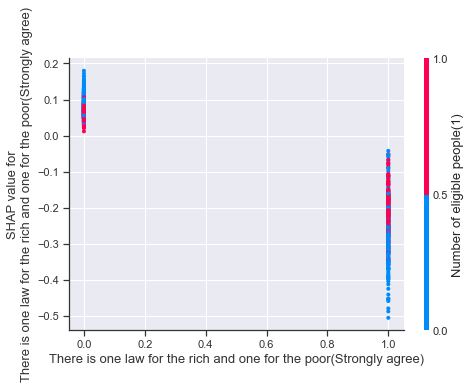

In [242]:
ge = "2017"
harm_vars = ["wt","age","housing_det","vote_complete","inc_det"]
target_var = "inc_det"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Lower Income","Higher Income"]
var_stub = "inc_det"
min_features = 10
drop_vars = ["y01","Int_fin_time"]
drop_std_thresh = 0

alg = get_xgboost_alg(classification_problem=False)

# find variables with no coverage/variation in focal instances (mask)
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=False)
stds = df_pred[mask].std()
drop_vars = drop_vars + list(stds[stds.isnull()].index)+list(stds[stds<=drop_std_thresh].index)
drop_vars = [x for x in drop_vars if x not in ["wt",var_stub]]

(explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,
                                                                                     target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=False,alg=alg)

# setup df back up
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=False)
# use fitted algorithm to predict values
inc_pred = pd.Series(alg.predict(df_pred[train_columns]),index=inc.index).round()
# income_var_df_sm.loc[income_var_df_sm[ge].isnull(),ge] = pd.Series(inc_pred,index=income_var_df_sm[ge].index).apply(round)[income_var_df_sm[ge].isnull()]

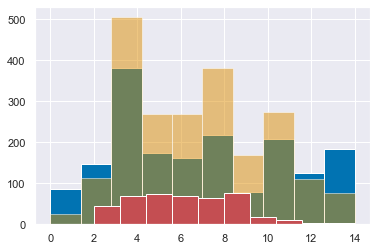

In [214]:
ge="2017"
inc.hist()
inc_pred.hist(alpha=.5)
inc_pred[mask].hist(color='r')

# inc.loc[mask] = inc_pred.loc[mask]
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"inc_det"] = inc
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"inc_det"].isnull().sum()

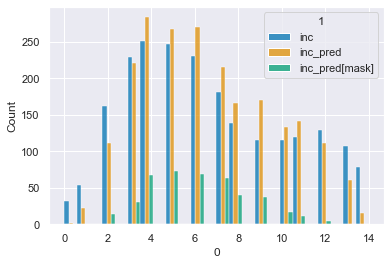

In [245]:
df = pd.DataFrame(inc)
df[1] ="inc"
df.shape[0]
# df.loc[df.shape[0]:inc_pred.shape[0],0] = np.nan
df2 = pd.DataFrame(inc_pred)
df2[1]="inc_pred"
df3 = pd.DataFrame(inc_pred[mask])
df3[1]="inc_pred[mask]"
df = pd.concat([df,df2,df3],axis=0)
#append(inc_pred,ignore_index=True,axis=1)
# df.shape[0],inc_pred.shape[0]
sns.histplot(data = df, x=0,hue=1,multiple="dodge")

In [243]:
f2f_harmonised[f2f_harmonised["dataset"]=="2017"]["inc"][~mask].astype('category').cat.codes.corr(inc[~mask])

0.9833695507414087

In [244]:
inc_mask = f2f_harmonised[f2f_harmonised["dataset"]=="2017"]["inc"].notnull()&inc.notnull()
f2f_harmonised[f2f_harmonised["dataset"]=="2017"]["inc"][inc_mask].astype('category').cat.codes.corr(inc[inc_mask])

0.9833695507414087

In [249]:
inc.loc[mask] = inc_pred.loc[mask]
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"inc_det"] = inc
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"inc_det"].isnull().sum()

0

In [250]:
# FIXED!
f2f_harmonised.to_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised_temp.zip", compression='zip')

In [311]:
#edqual21
f2f_harmonised.drop("edqual21",axis=1).to_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised_temp.zip", compression='zip')


# search(f2f_harmonised,"ed")

In [198]:

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression, Ridge
X_train, X_test, y_train, y_test = train_test_split(
    df_pred.drop("inc_det",axis=1).dropna(axis=1), df_pred["inc_det"], test_size=0.33, random_state=42)

clf = Ridge().fit(X_train, y_train)

from sklearn.metrics import r2_score
r2_score(y_test, clf.predict(X_test))

-1.5977650079336563

In [199]:
pd.Series(clf.coef_,index = df_pred.drop("inc_det",axis=1).dropna(axis=1).columns).sort_values()

Date of interview(04/08/2017)               -1.679846
Probability of voting for UKIP(9)           -1.453420
Tax/spend: UKIP(9)                          -1.365442
Date of interview(31/07/2017)               -1.319243
Religious attendance(Once a week or more)   -1.297999
                                               ...   
Date of interview(25/07/2017)                1.285259
Like/dislike: UKIP(Strongly dislike 0)       1.446475
Left/right Conservatives(5)                  1.483916
EU integration: Green(3)                     1.520505
Keeps promises: Conservative(Don't know)     1.533224
Length: 8906, dtype: float64

In [189]:
df_pred.columns

Index(['sel_wt_capped', 'wt_vote_valid', 'age', 'wt_demog', 'inc_det', 'wt',
       'wt_demog_cses', 'wt_vote', 'NS-SEC occupational classification',
       'Votes were counted fairly(Not stated)',
       ...
       'Like/dislike: Conservatives(2)', 'Like/dislike: Conservatives(3)',
       'Like/dislike: Conservatives(4)', 'Like/dislike: Conservatives(5)',
       'Like/dislike: Conservatives(6)', 'Like/dislike: Conservatives(7)',
       'Like/dislike: Conservatives(8)', 'Like/dislike: Conservatives(9)',
       'Like/dislike: Conservatives(Strongly like 10)',
       'Like/dislike: Conservatives(nan)'],
      dtype='object', length=8913)

In [192]:
BES_label_list["2017"]
# q11_cses_1

{'finalserialno': 'Final Serial Number',
 'serial': 'Respondent Serial Number',
 'a01': 'A1: Most important issue',
 'a02': 'Best party on most important issue',
 'a03': 'Interest in politics',
 'm02_1': "Politicians don't care what people like me think",
 'm02_2': 'It is often difficult for me to understand what is going on in government and po',
 'm02_3': 'People like me have no say in what government does.',
 'm02_4': "The main political parties in Britain don't offer voters real choices in electio",
 'm02_5': 'Parties and politicians in the UK are more concerned with fighting each other th',
 'm02_6': 'Politicians ignore the issues I really care about',
 'b01': 'B1 Talking with people about the general election on June 8th, we have found tha',
 'b02': 'B2 Which party did you vote for in the general election?',
 'b04': 'B4 If you had voted, which party would you probably have voted for?',
 'b05': 'B5 How did you cast your vote in the general election on June 8th?',
 'b0601': 'The pa

In [194]:
var_type_dict_nonans["2017"]["q25_cses"]

'nominal'

In [254]:
f2f_harmonised.columns

Index(['dataset', 'uid', 'housing_det', 'housing', 'inc', 'vote', 'year', 'wt',
       'age', 'vote_simple', 'bloc', 'birth_year', 'harmonised_voted',
       'inc_det', 'vote_complete', 'vote_complete_simple', 'bloc_complete',
       'turnout_complete', 'gender', 'gender_complete', 'age_left_education',
       'age_left_education_2', 'age_left_education_3', 'anyQuals',
       'rsa_or_city_and_guilds', 'overseas_other_postschl', 'overseas_degree',
       'other_academic_vocational', 'other_tech_business',
       'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
       'trade_appenticeship', 'nursing', 'teachers_training',
       'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
       'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
       'rsa_other_commercial', 'school_cert_or_matric',
       'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
       'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
       'professional_qualification'

***************************
1959
***************************
MSE: 0.18, MAE: 0.36, EV: 0.22, R2: 0.22


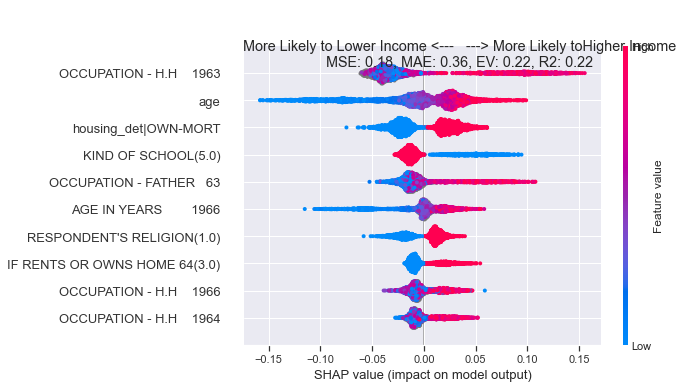

MSE: 0.18, MAE: 0.38, EV: 0.21, R2: 0.21


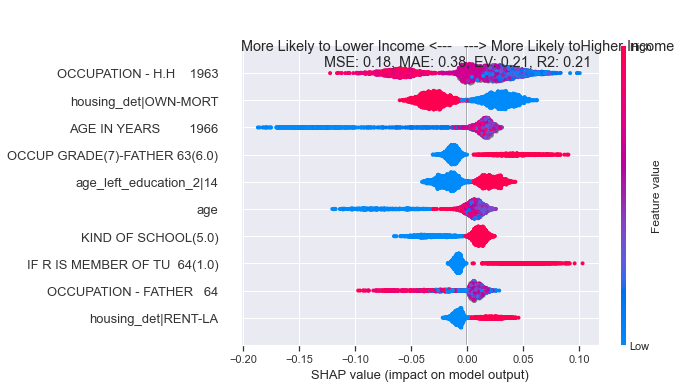

MSE: 0.11, MAE: 0.24, EV: 0.04, R2: 0.03


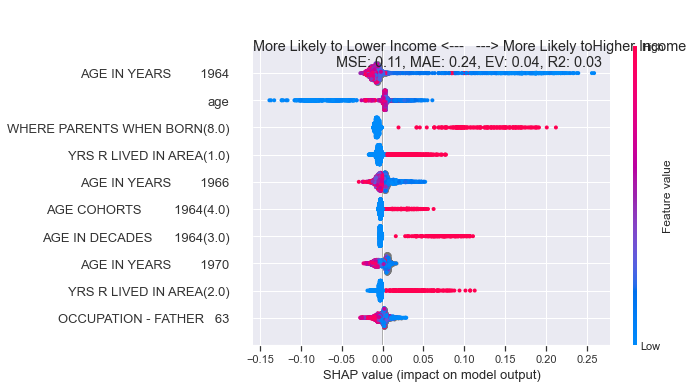

***************************
1964
***************************
MSE: 0.20, MAE: 0.40, EV: 0.18, R2: 0.18


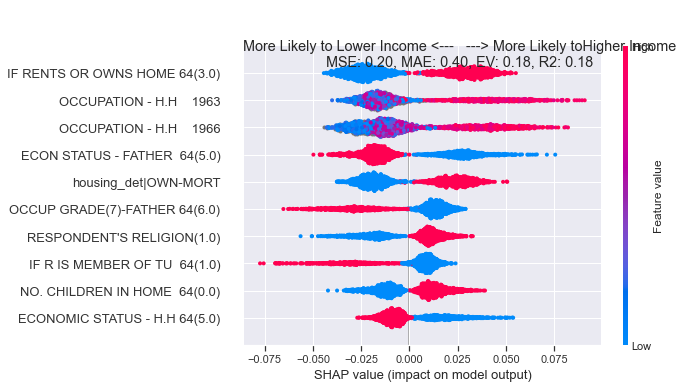

MSE: 0.21, MAE: 0.43, EV: 0.14, R2: 0.14


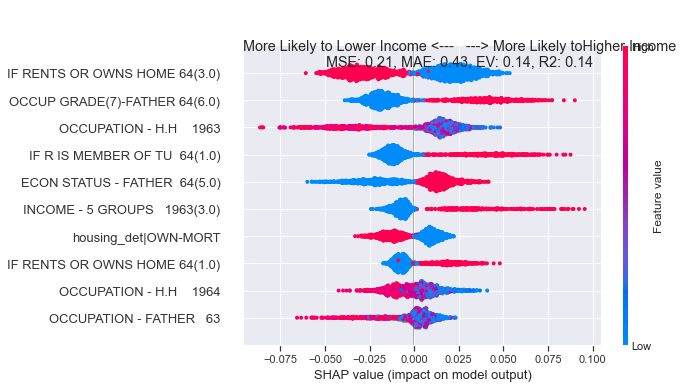

MSE: 0.10, MAE: 0.21, EV: -0.02, R2: -0.03


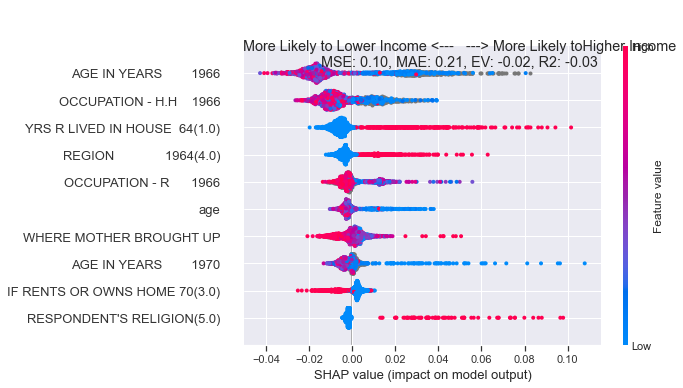

***************************
1966
***************************
MSE: 0.19, MAE: 0.38, EV: 0.17, R2: 0.17


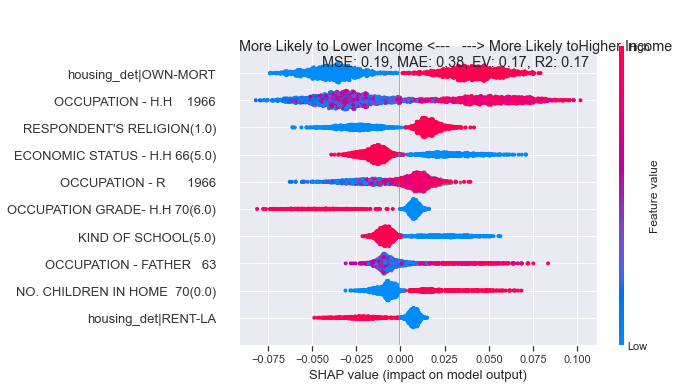

MSE: 0.22, MAE: 0.45, EV: 0.11, R2: 0.11


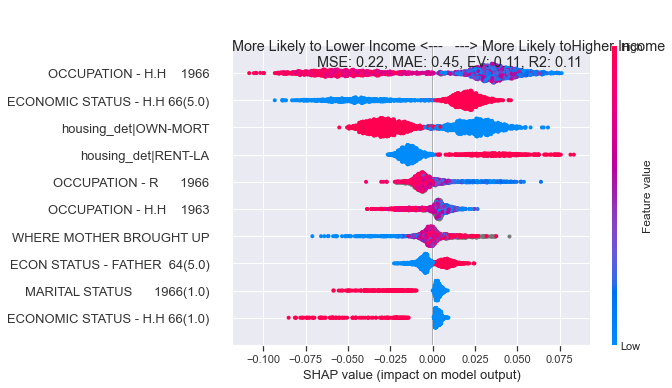

MSE: 0.11, MAE: 0.24, EV: 0.05, R2: 0.05


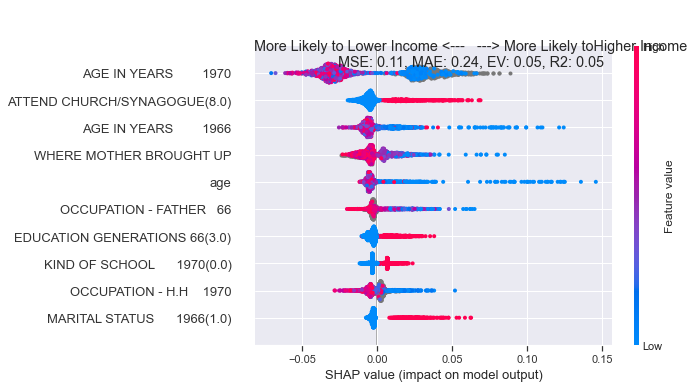

***************************
1970
***************************
MSE: 0.22, MAE: 0.44, EV: 0.08, R2: 0.07


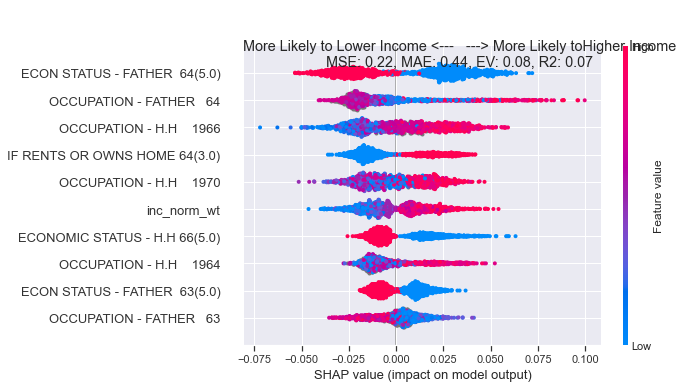

MSE: 0.23, MAE: 0.45, EV: 0.06, R2: 0.06


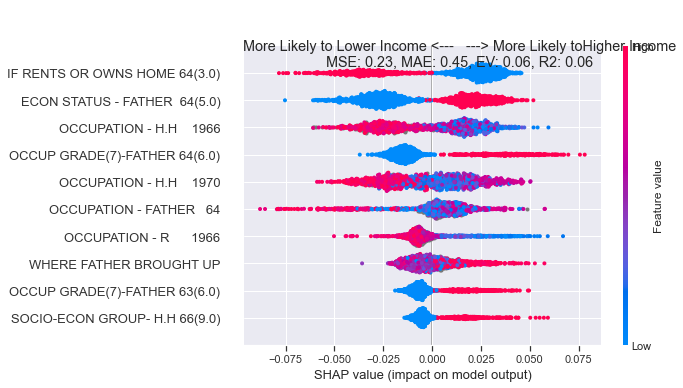

MSE: 0.14, MAE: 0.28, EV: -0.01, R2: -0.01


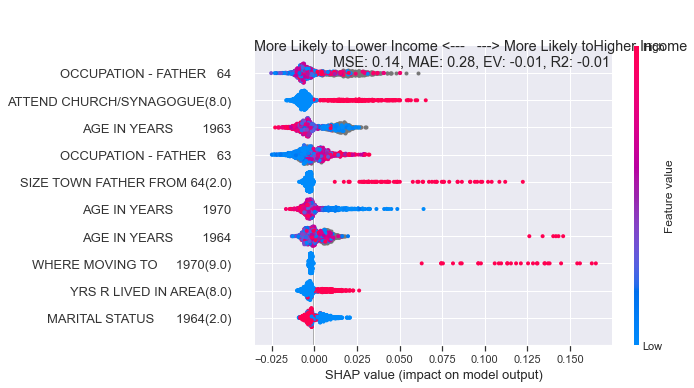

***************************
1974_oct
***************************
MSE: 0.18, MAE: 0.36, EV: 0.14, R2: 0.14


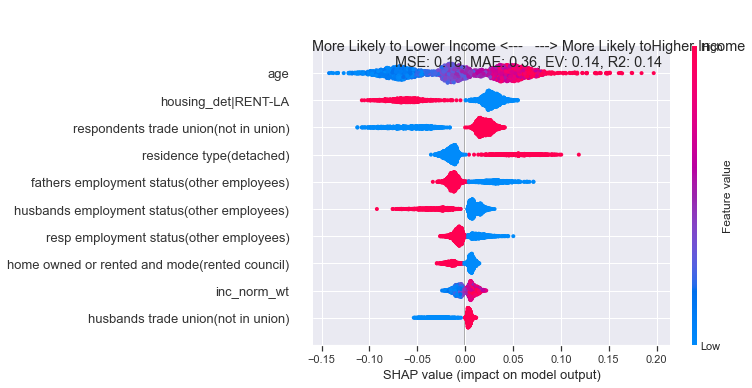

MSE: 0.22, MAE: 0.45, EV: 0.12, R2: 0.12


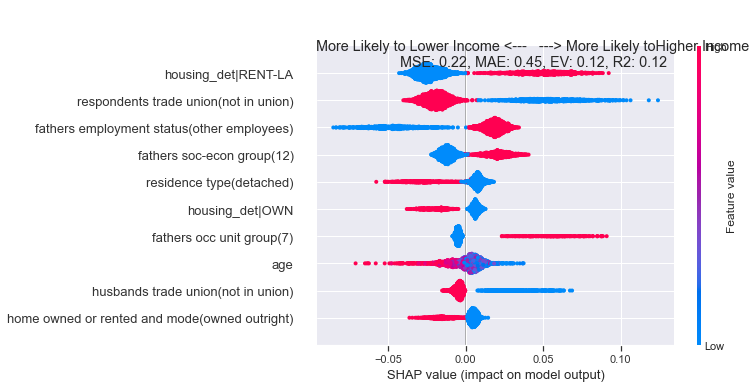

MSE: 0.12, MAE: 0.25, EV: 0.04, R2: 0.04


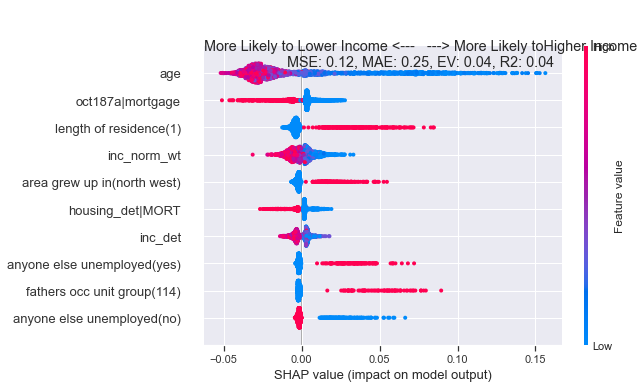

***************************
1974_feb
***************************
MSE: 0.19, MAE: 0.38, EV: 0.14, R2: 0.14


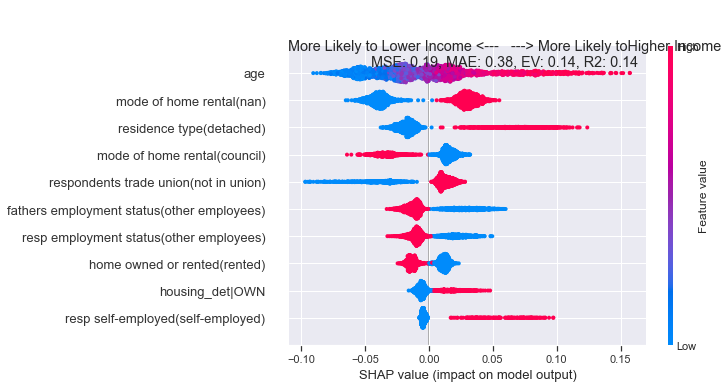

MSE: 0.22, MAE: 0.44, EV: 0.12, R2: 0.12


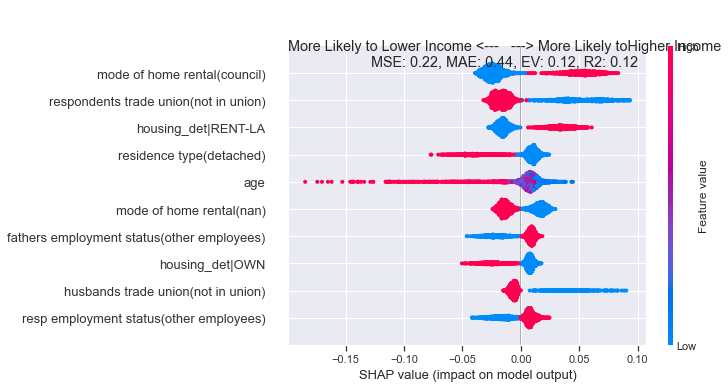

MSE: 0.11, MAE: 0.20, EV: 0.02, R2: 0.02


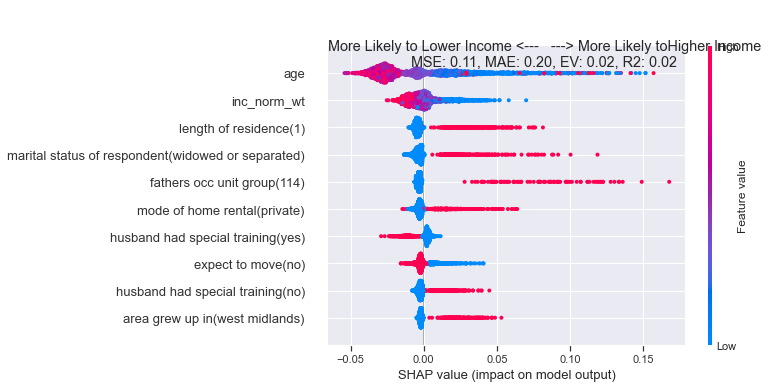

***************************
1979
***************************
MSE: 0.21, MAE: 0.42, EV: 0.12, R2: 0.12


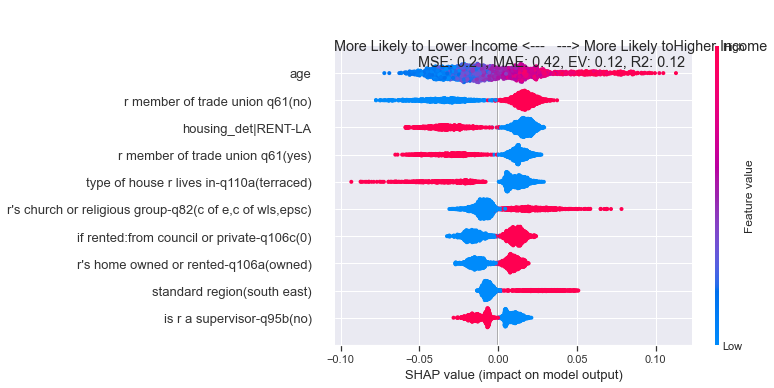

MSE: 0.23, MAE: 0.46, EV: 0.06, R2: 0.06


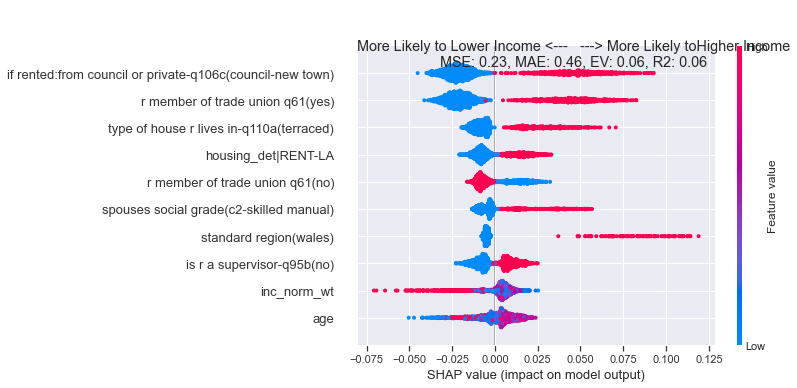

MSE: 0.12, MAE: 0.25, EV: 0.05, R2: 0.05


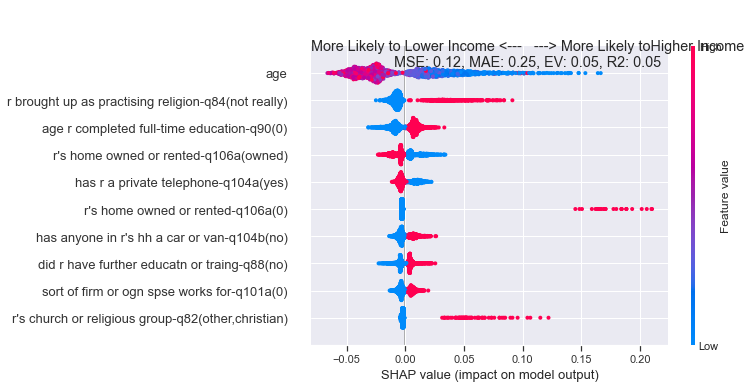

***************************
1983
***************************
MSE: 0.20, MAE: 0.40, EV: 0.13, R2: 0.13


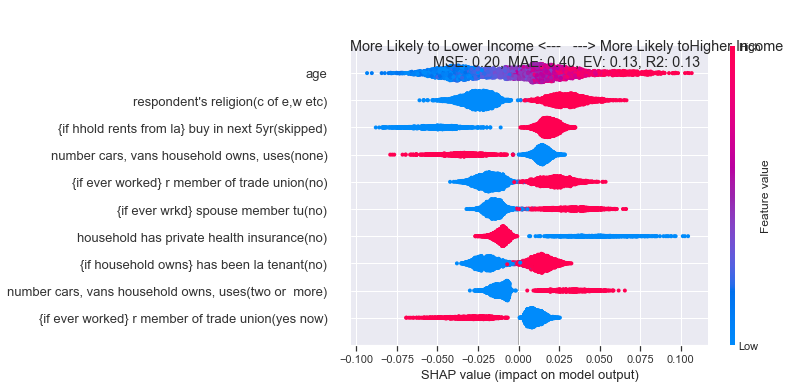

MSE: 0.23, MAE: 0.45, EV: 0.09, R2: 0.09


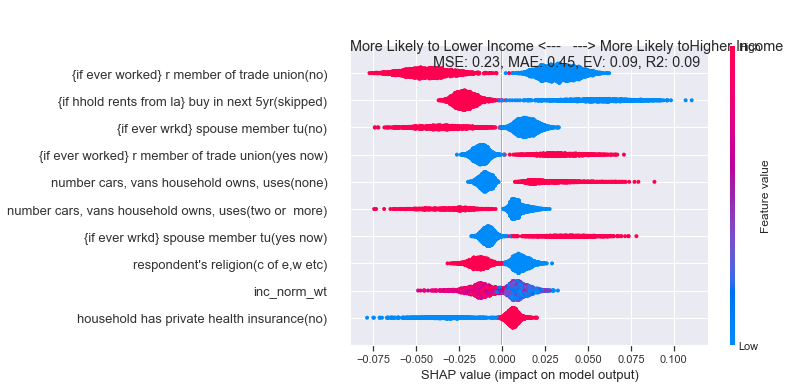

MSE: 0.14, MAE: 0.28, EV: 0.02, R2: 0.02


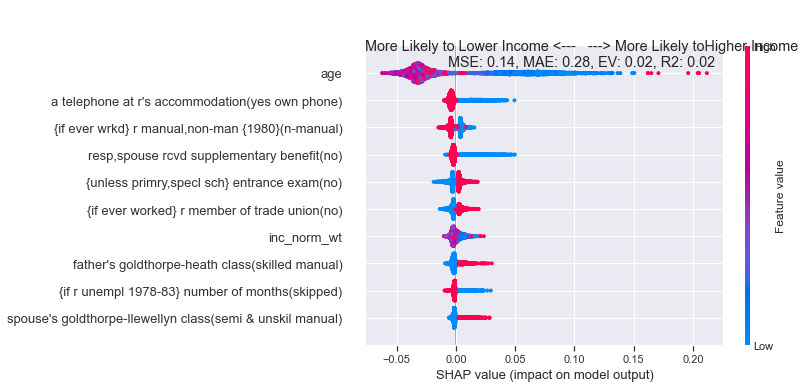

***************************
1987
***************************
MSE: 0.19, MAE: 0.38, EV: 0.20, R2: 0.20


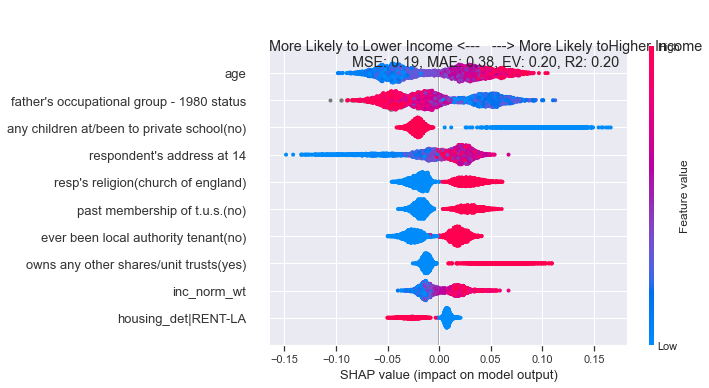

MSE: 0.21, MAE: 0.43, EV: 0.14, R2: 0.14


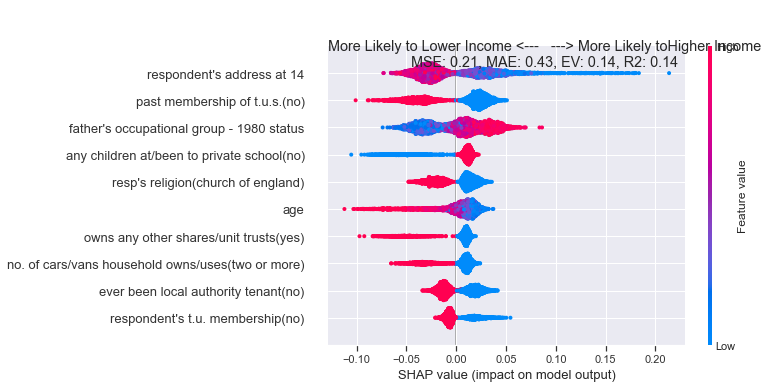

MSE: 0.12, MAE: 0.24, EV: 0.01, R2: 0.01


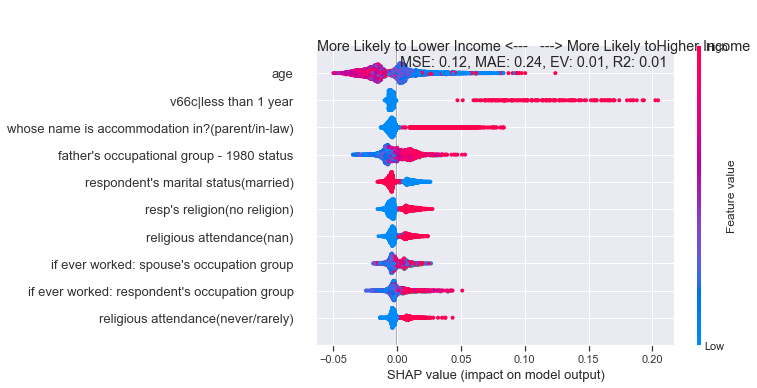

***************************
1992
***************************
MSE: 0.18, MAE: 0.37, EV: 0.21, R2: 0.21


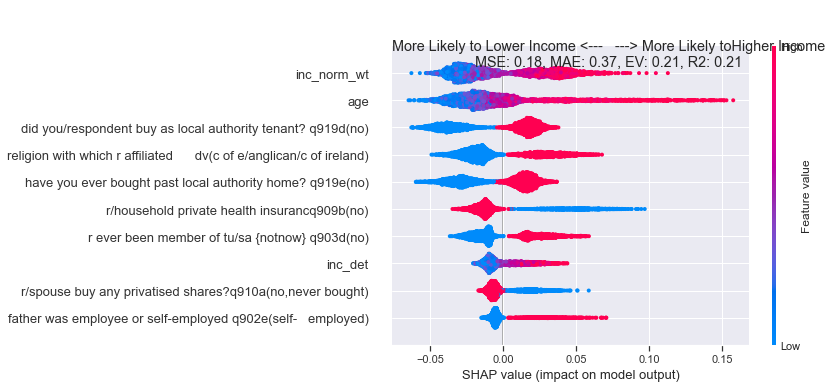

MSE: 0.21, MAE: 0.43, EV: 0.15, R2: 0.15


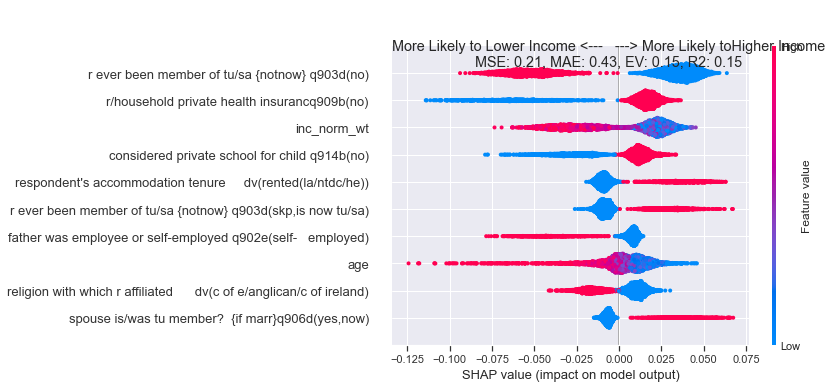

MSE: 0.11, MAE: 0.23, EV: 0.02, R2: 0.02


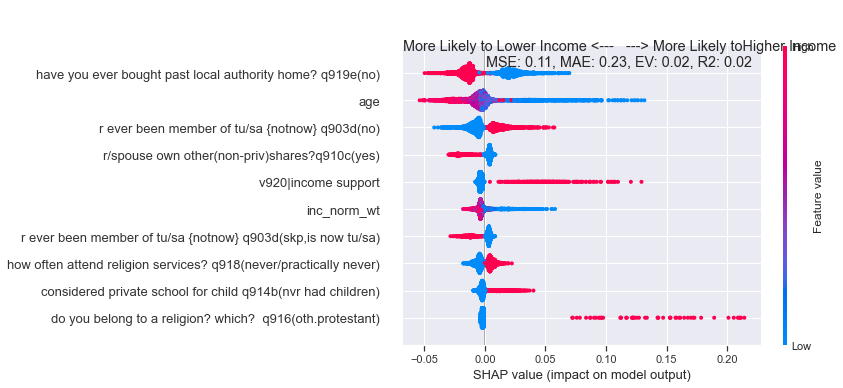

***************************
1997
***************************
MSE: 0.15, MAE: 0.30, EV: 0.15, R2: 0.15


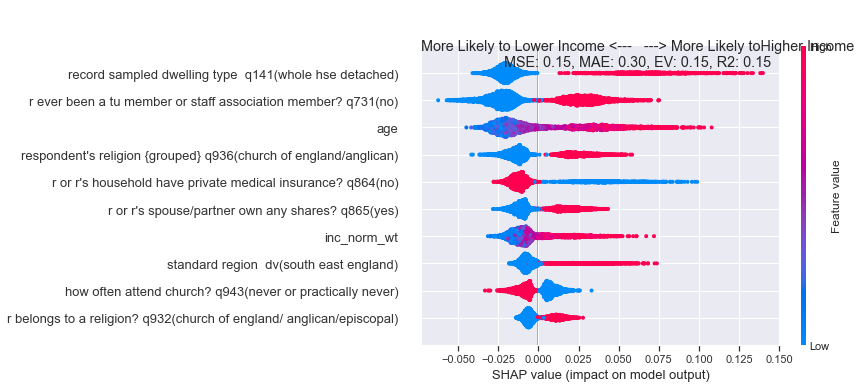

MSE: 0.22, MAE: 0.44, EV: 0.10, R2: 0.10


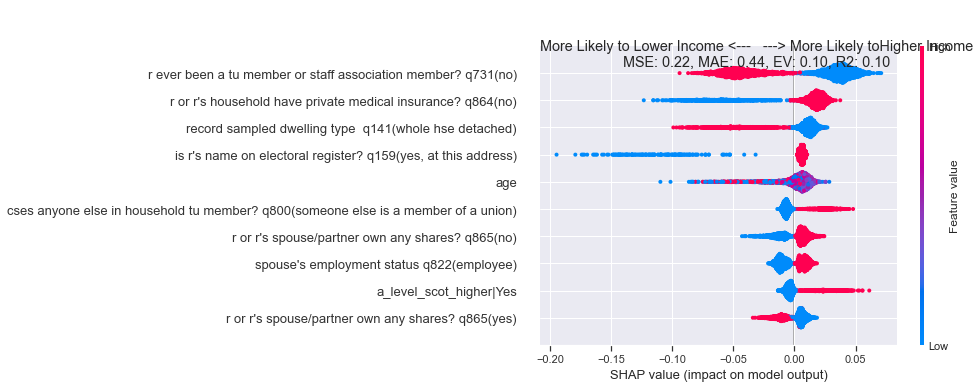

MSE: 0.14, MAE: 0.29, EV: 0.08, R2: 0.08


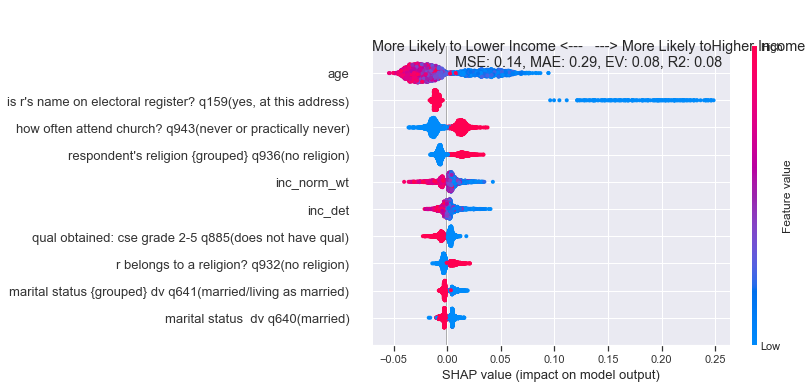

***************************
2001
***************************
MSE: 0.13, MAE: 0.27, EV: 0.11, R2: 0.11


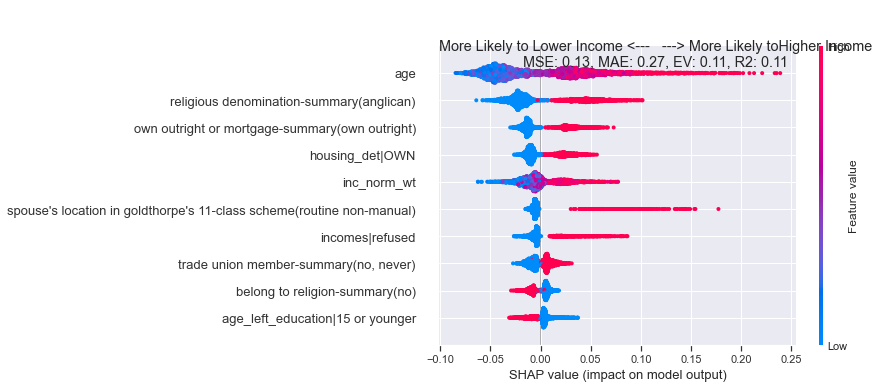

MSE: 0.24, MAE: 0.48, EV: 0.03, R2: 0.03


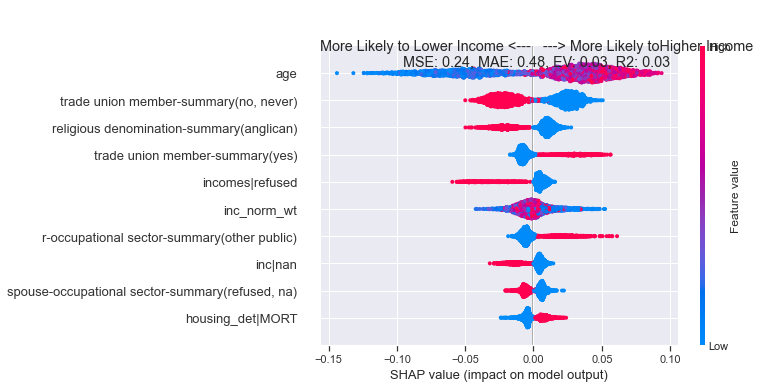

MSE: 0.18, MAE: 0.36, EV: 0.10, R2: 0.10


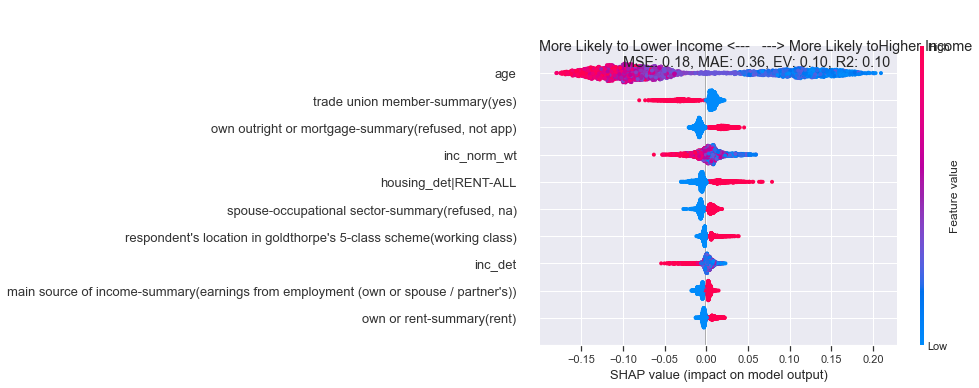

***************************
2005
***************************
MSE: 0.15, MAE: 0.29, EV: 0.15, R2: 0.15


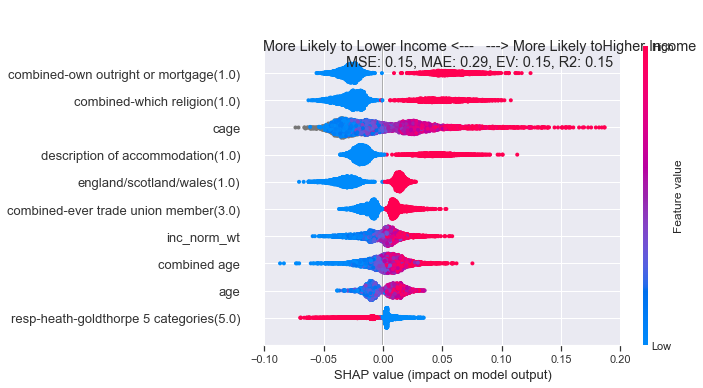

MSE: 0.23, MAE: 0.47, EV: 0.06, R2: 0.06


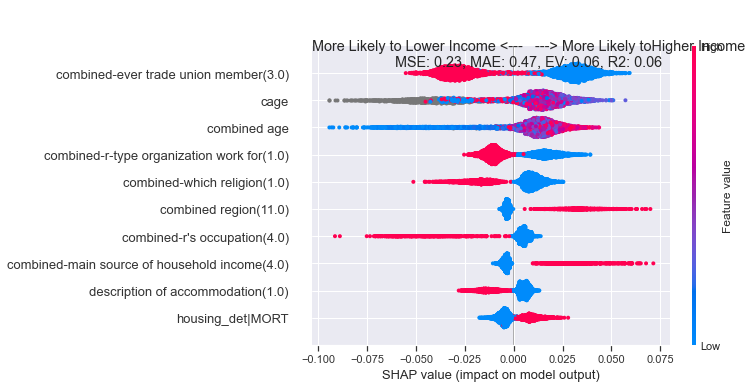

MSE: 0.16, MAE: 0.33, EV: 0.17, R2: 0.16


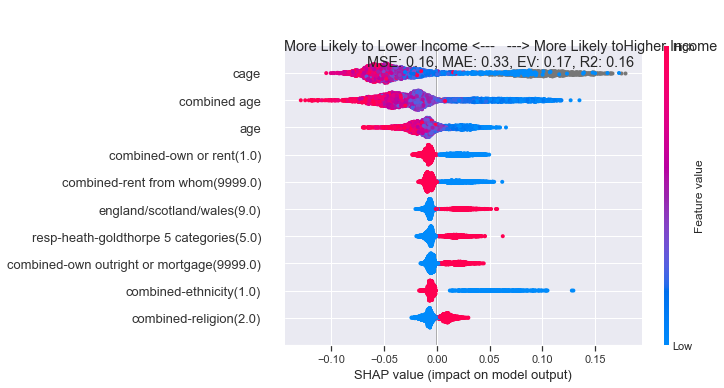

***************************
2010
***************************
MSE: 0.19, MAE: 0.36, EV: 0.12, R2: 0.12


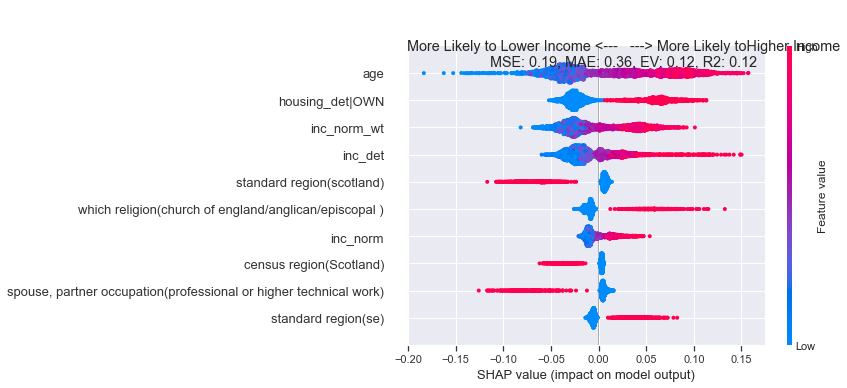

MSE: 0.23, MAE: 0.46, EV: 0.07, R2: 0.07


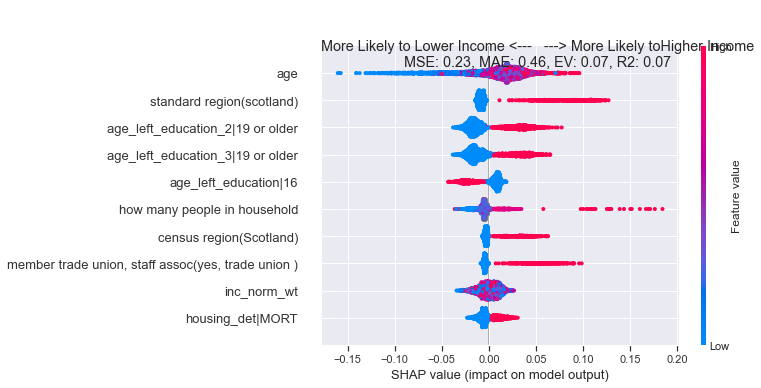

MSE: 0.15, MAE: 0.30, EV: 0.12, R2: 0.12


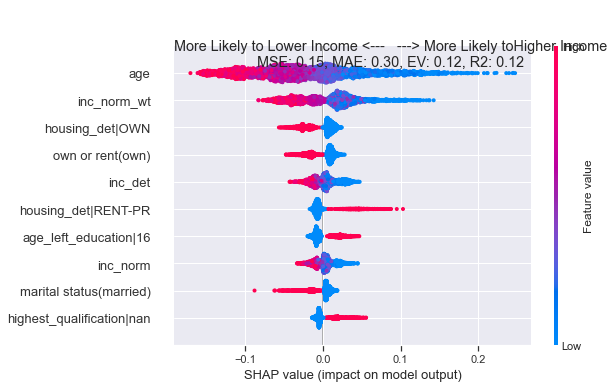

***************************
2015
***************************
MSE: 0.19, MAE: 0.39, EV: 0.18, R2: 0.18


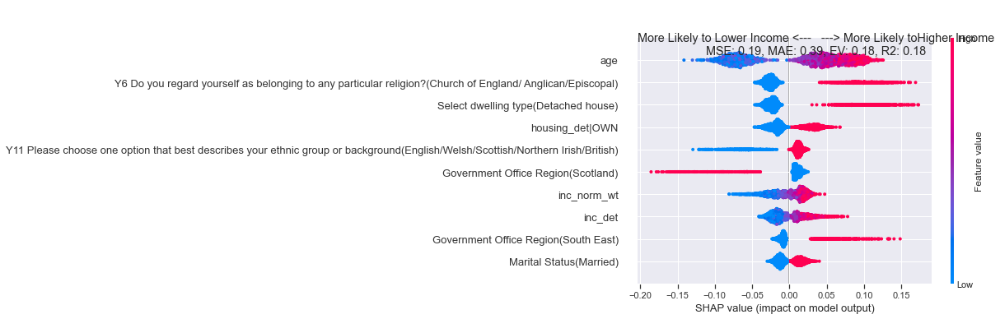

MSE: 0.22, MAE: 0.43, EV: 0.06, R2: 0.06


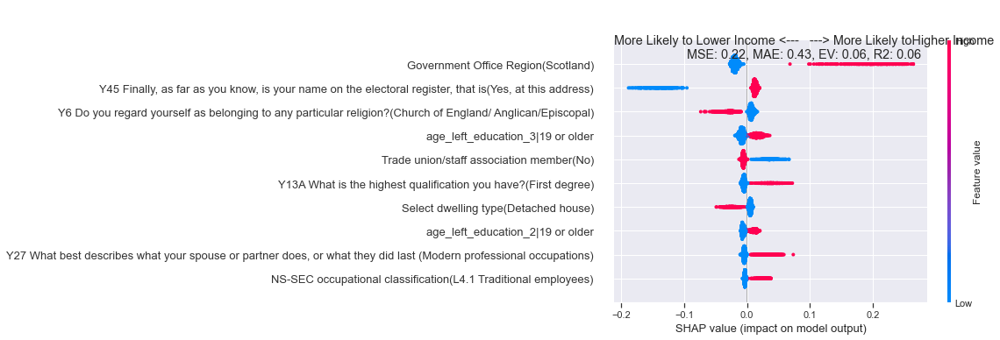

MSE: 0.15, MAE: 0.33, EV: 0.24, R2: 0.22


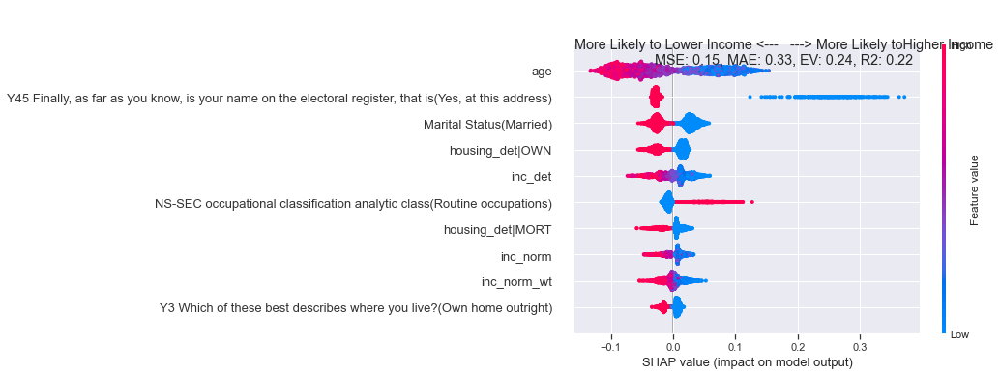

***************************
2017
***************************
MSE: 0.19, MAE: 0.38, EV: 0.16, R2: 0.16


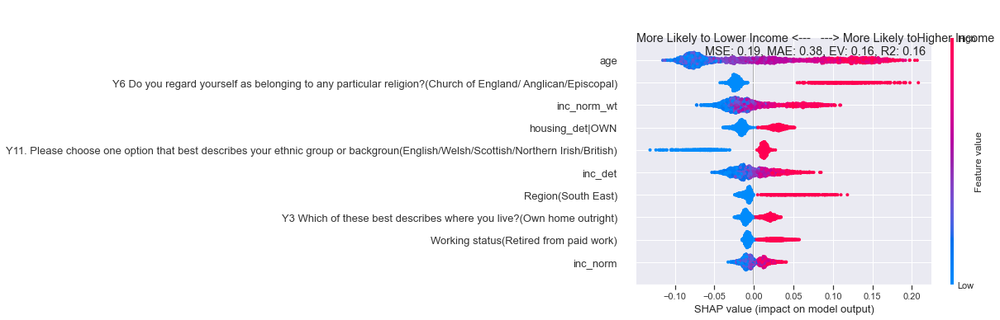

MSE: 0.22, MAE: 0.43, EV: 0.12, R2: 0.11


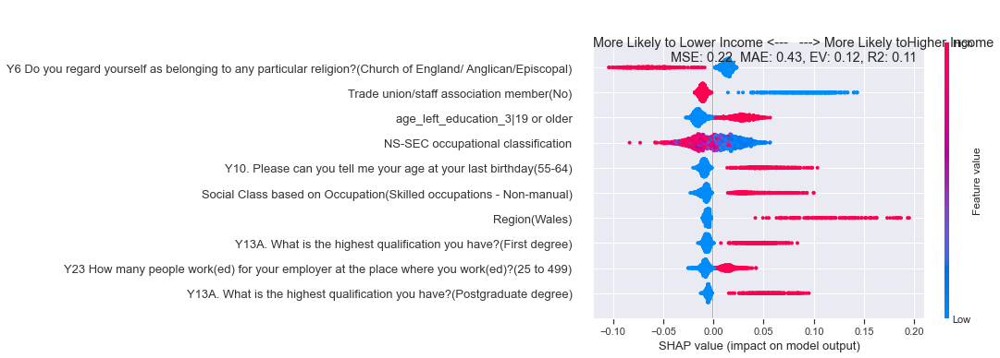

MSE: 0.14, MAE: 0.30, EV: 0.21, R2: 0.19


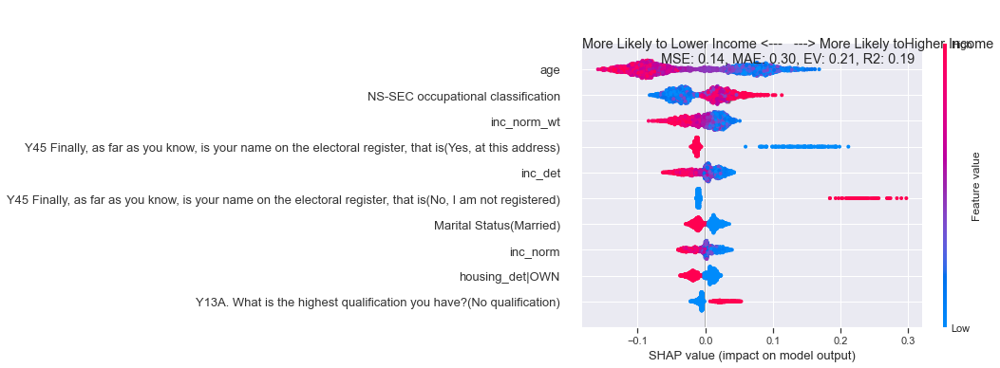

***************************
2019
***************************
MSE: 0.20, MAE: 0.38, EV: 0.15, R2: 0.15


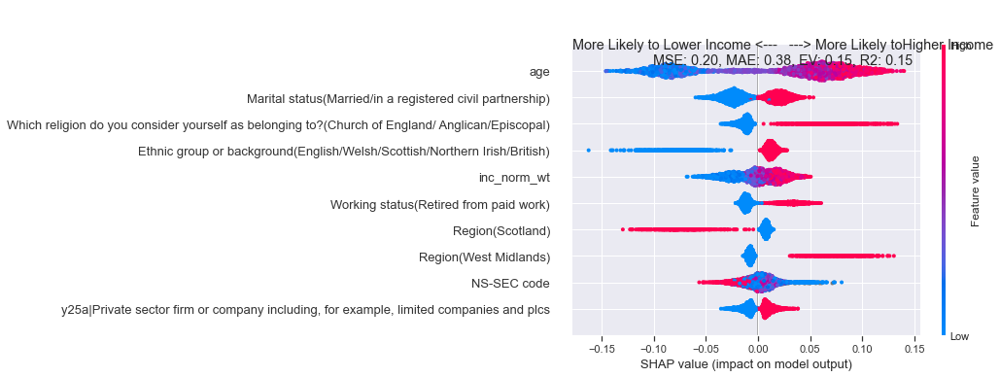

MSE: 0.20, MAE: 0.39, EV: 0.17, R2: 0.16


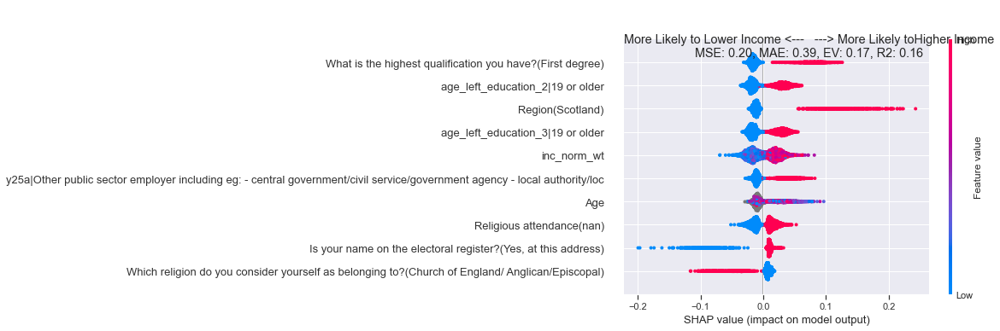

MSE: 0.15, MAE: 0.32, EV: 0.13, R2: 0.08


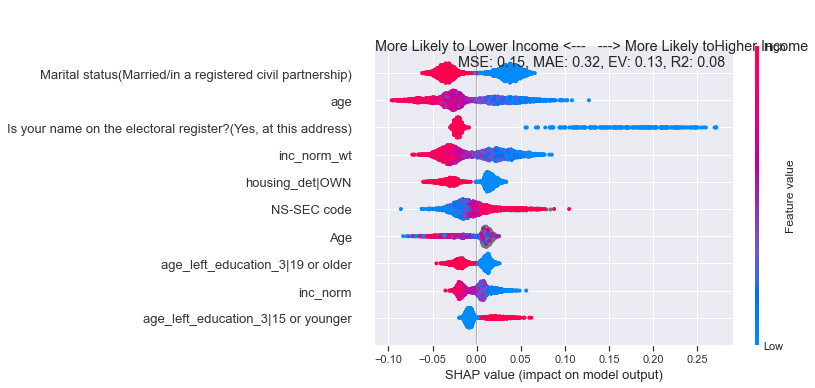

In [308]:
for ge in f2f_harmonised["dataset"].unique()[::-1]:
    print("***************************")
    print(ge)
    print("***************************")
    run_ge_regression(ge,"AuthRight")
    run_ge_regression(ge,"LibLeft")
    run_ge_regression(ge,"DNV")

In [ ]:
# drop 'electoral register' from list of variables!

In [304]:
BES_df_list["1997"]["edqual21"]

0        does not have qual
1       no post school qual
2        does not have qual
3        does not have qual
4       no post school qual
               ...         
3610     does not have qual
3611     does not have qual
3612     does not have qual
3613     does not have qual
3614    no post school qual
Name: edqual21, Length: 3615, dtype: category
Categories (5, object): ['no post school qual' < 'does not have qual' < 'has qualification' < 'don't   know' < 'not     answered']

In [ ]:
### BUG
# 'edqual21' in harm_vars should not be!

In [ ]:
# Ordinary people get their fair share of the nation’s wealth
# There is one law for the rich and one for the poor
# There is no need for strong Trade Unions to protect workers’ rights
# Private enterprise is the best way to solve Britain’s economic problems
# ordinary, rich, strongtu, enterprise

# Young people don’t have enough respect for traditional values
# Censorship is necessary to uphold moral values
# We should be tolerant of those who lead unconventional lifestyles
# For some crime the death penalty is the most appropriate sentence
# People who break the law should be given stiffer sentences
# respect, censorship, unconvent, death, 

In [10]:
# People in Britain should be more tolerant of those who lead unconventional lives
unconvent = {"2019":"f01_10","2017":"f01_10","2015":"f01_10","2010":"cq17_8",
             "2005":"cq16h","2001":"cq19h","1997":"tolerant","1992":"v205e"}
# For some crimes, the death penalty is the most appropriate sentence
death = {"2019":"f01_11","2017":"f01_11",
         #"2015":"", it really missing!
         # death penalty never justified
         "2010":"cq13_1", "2005":"cq12a","2001":"cq15a",
         # great britain should bring back death penalty
         "1997":"deathpen","1992":"v47d",
         # agree/disagree: death penalty for some crimes
         "1987":"v121n",
         # agree/disagree: death penalty for some crimes
         "1983":"q42c",
         # gov should bring back death penalty-q38f
         "1979":"m000134",
#    'v224': 'DEATH PENALTY POLICY',
#    'v225': 'DEATH PENALTY POLICY  66',
#    'v226': 'DEATH PENALTY POLICY  70',
        }

# Ordinary working people get their fair share of the nation's wealth
ordinary = {"2019":"f01_1","2017":"f01_1","2015":"f01_1","2010":"cq17_1",
             "2005":"cq16a","2001":"cq19a","1997":"fairshar","1992":"v204a"}

# There is one law for the rich and one for the poor
rich = {"2019":"f01_2","2017":"f01_2","2015":"f01_2",
        "2010":"cq17_2",
        "2005":"cq16b","2001":"cq19b","1997":"richlaw","1992":"v204b",
        "1987":"v121g"}
# Young people today don't have enough respect for traditional British values
respect = {"2019":"f01_3","2017":"f01_3","2015":"f01_3",
           #young people not enough respect values
        "2010":"cq17_5","2005":"cq16e","2001":"cq19e",
        "1997":"tradvals","1992":"v204d",
        "1987":"v121k"}
# Censorship of films and magazines is necessary to uphold moral standards
censorship = {"2019":"f01_4","2017":"f01_4","2015":"f01_4",
        "2010":"cq17_6",
        "2005":"cq16f","2001":"cq19f","1997":"censor","1992":"v204e",
        "1987":"v121q"}
# There is no need for strong trade unions to protect working conditions and wages
strongtu = {"2019":"f01_5","2017":"f01_5","2015":"f01_5",
        "2010":"cq17_3",
        "2005":"cq16c","2001":"cq19c","1997":"tuntneed","1992":"v204f",
        }

# Private enterprise is the best way to solve Britain's economic problems
enterprise = {"2019":"f01_6","2017":"f01_6","2015":"f01_6",
        "2010":"cq17_4",
        "2005":"cq16d","2001":"cq19d","1997":"privent","1992":"v204g",
        }
#Big business has too much power?
bigbusiness = {"2019":"w12","2017":"w12","2015":"w12",
        "2010":"cq19",
        "2005":"cq18","2001":"cq25","1997":"buspower","1992":"v51b",
        "1987":"v111","1983":"q38b","1979":"m491180",
        "1974_oct":"oct491"}
# 'v248': 'BIG BUSINESS POWER  1963',
#    'v249': 'BIG BUSINESS POWER  1964',
#    'v250': 'BIG BUSINESS POWER  1966',
#    'v251': 'BIG BUSINESS POWER  1970',

# People who break the law should be given stiffer sentences
toughlaw = {"2019":"f01_12","2017":"f01_12",
            #"2015":"f01_12",
           #long prison sentences if break law 
        "2010":"cq13_4",
            #lawbreakers longer prison sentences
        "2005":"cq12d","2001":"cq15d",
            #lawbreakers should get stiffer sentences? q458
        "1997":"stifsent",
            #lawbreakers should get stiffer sentences q47e
        "1992":"v47e",
            #law and order: respondent's view
#         "1987":"v39a",
#         "1983":"q41a",
            #importance in vote: law & order-q21c
#         "1979":"m000075",
            #gone too far-law breakers
#         "1974_oct":"oct451"
           }


In [11]:
f2f_harmonised["unconventional"] = np.nan

ge="2019"
BES_df_list[ge][unconvent[ge]].value_counts().sort_index()
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4}
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "unconventional"] = BES_df_list[ge][unconvent[ge]].replace(replace_dict)
BES_df_list[ge][unconvent[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()



ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "unconventional"] = BES_df_list[ge][unconvent[ge]].replace(replace_dict)
BES_df_list[ge][unconvent[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2015"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "unconventional"] = BES_df_list[ge][unconvent[ge]].replace(replace_dict)
BES_df_list[ge][unconvent[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan}

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "unconventional"] = BES_df_list[ge][unconvent[ge]].replace(replace_dict)
BES_df_list[ge][unconvent[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "unconventional"] = (5-BES_df_list[ge][unconvent[ge]].replace(replace_dict))
(5-BES_df_list[ge][unconvent[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "unconventional"] = BES_df_list[ge][unconvent[ge]].replace(replace_dict)
BES_df_list[ge][unconvent[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "unconventional"] = BES_df_list[ge][unconvent[ge]].replace(replace_dict)
BES_df_list[ge][unconvent[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "unconventional"] = BES_df_list[ge][unconvent[ge]].replace(replace_dict)
# BES_df_list[ge][unconvent[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()



In [12]:
f2f_harmonised["ordinary"] = np.nan

# Ordinary working people get their fair share of the nation's wealth
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan,"can't choose":np.nan}

ge="2019"
# BES_df_list[ge][ordinary[ge]].value_counts().sort_index()
# replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4}
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "ordinary"] = BES_df_list[ge][ordinary[ge]].replace(replace_dict)
BES_df_list[ge][ordinary[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()



ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "ordinary"] = BES_df_list[ge][ordinary[ge]].replace(replace_dict)
BES_df_list[ge][ordinary[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2015"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "ordinary"] = BES_df_list[ge][ordinary[ge]].replace(replace_dict)
BES_df_list[ge][ordinary[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
#                "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
#                9:np.nan,99:np.nan,
#                'not ascertainable':np.nan,'no mailback':np.nan,
#                "strongly agree":4,"strongly disagree":0,
#                'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
#                'no self-completn':np.nan}

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "ordinary"] = BES_df_list[ge][ordinary[ge]].replace(replace_dict)
BES_df_list[ge][ordinary[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "ordinary"] = (5-BES_df_list[ge][ordinary[ge]].replace(replace_dict))
(5-BES_df_list[ge][ordinary[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# # not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "ordinary"] = BES_df_list[ge][ordinary[ge]].replace(replace_dict)
BES_df_list[ge][ordinary[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "ordinary"] = BES_df_list[ge][ordinary[ge]].replace(replace_dict)
BES_df_list[ge][ordinary[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "ordinary"] = BES_df_list[ge][ordinary[ge]].replace(replace_dict)
# BES_df_list[ge][ordinary[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

#87:agree/disagree: workers don't get fair wage
# 74_oct: resp wage fair

In [13]:
# There is one law for the rich and one for the poor
f2f_harmonised["rich"] = np.nan
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan,"can't choose":np.nan,
               "neutral":2,"not answered":np.nan,"dont know":np.nan}

ge="2019"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = BES_df_list[ge][rich[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = BES_df_list[ge][rich[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2015"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = BES_df_list[ge][rich[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = BES_df_list[ge][rich[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = (5-BES_df_list[ge][rich[ge]].replace(replace_dict))
(5-BES_df_list[ge][rich[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# # # not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = BES_df_list[ge][rich[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = BES_df_list[ge][rich[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = BES_df_list[ge][rich[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1987"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "rich"] = BES_df_list[ge][rich[ge]].replace(replace_dict)
# BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()


In [14]:
# Young people today don't have enough respect for traditional British values
f2f_harmonised["respect"] = np.nan
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan,"can't choose":np.nan,
               "neutral":2,"not answered":np.nan,"dont know":np.nan}

ge="2019"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = BES_df_list[ge][respect[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = BES_df_list[ge][respect[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2015"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = BES_df_list[ge][respect[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = BES_df_list[ge][respect[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = (5-BES_df_list[ge][respect[ge]].replace(replace_dict))
(5-BES_df_list[ge][rich[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# # # # not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = BES_df_list[ge][respect[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = BES_df_list[ge][respect[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = BES_df_list[ge][respect[ge]].replace(replace_dict)
BES_df_list[ge][rich[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1987"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "respect"] = BES_df_list[ge][respect[ge]].replace(replace_dict)
# BES_df_list[ge][respect[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()


In [15]:
# Censorship of films and magazines is necessary to uphold moral standards
f2f_harmonised["censorship"] = np.nan
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan,"can't choose":np.nan,
               "neutral":2,"not answered":np.nan,"dont know":np.nan}

ge="2019"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = BES_df_list[ge][censorship[ge]].replace(replace_dict)
BES_df_list[ge][censorship[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = BES_df_list[ge][censorship[ge]].replace(replace_dict)
BES_df_list[ge][censorship[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2015"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = BES_df_list[ge][censorship[ge]].replace(replace_dict)
BES_df_list[ge][censorship[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = BES_df_list[ge][censorship[ge]].replace(replace_dict)
BES_df_list[ge][censorship[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = (5-BES_df_list[ge][censorship[ge]].replace(replace_dict))
(5-BES_df_list[ge][censorship[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# # # # # not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = BES_df_list[ge][censorship[ge]].replace(replace_dict)
BES_df_list[ge][censorship[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = BES_df_list[ge][censorship[ge]].replace(replace_dict)
BES_df_list[ge][censorship[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = BES_df_list[ge][censorship[ge]].replace(replace_dict)
BES_df_list[ge][censorship[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1987"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "censorship"] = BES_df_list[ge][censorship[ge]].replace(replace_dict)
# BES_df_list[ge][censorship[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()


In [16]:
# There is no need for strong trade unions to protect working conditions and wages
f2f_harmonised["strongtu"] = np.nan
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan,"can't choose":np.nan,
               "neutral":2,"not answered":np.nan,"dont know":np.nan}

ge="2019"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = BES_df_list[ge][strongtu[ge]].replace(replace_dict)
BES_df_list[ge][strongtu[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = BES_df_list[ge][strongtu[ge]].replace(replace_dict)
BES_df_list[ge][strongtu[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2015"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = BES_df_list[ge][strongtu[ge]].replace(replace_dict)
BES_df_list[ge][strongtu[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = BES_df_list[ge][strongtu[ge]].replace(replace_dict)
BES_df_list[ge][strongtu[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = (5-BES_df_list[ge][strongtu[ge]].replace(replace_dict))
(5-BES_df_list[ge][strongtu[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# # # # # # not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = BES_df_list[ge][strongtu[ge]].replace(replace_dict)
BES_df_list[ge][strongtu[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = BES_df_list[ge][strongtu[ge]].replace(replace_dict)
BES_df_list[ge][strongtu[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = BES_df_list[ge][strongtu[ge]].replace(replace_dict)
# BES_df_list[ge][strongtu[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# ge="1987"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "strongtu"] = BES_df_list[ge][strongtu[ge]].replace(replace_dict)
# BES_df_list[ge][strongtu[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()


In [17]:
# Private enterprise is the best way to solve Britain's economic problems
f2f_harmonised["enterprise"] = np.nan
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan,"can't choose":np.nan,
               "neutral":2,"not answered":np.nan,"dont know":np.nan}

ge="2019"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = BES_df_list[ge][enterprise[ge]].replace(replace_dict)
BES_df_list[ge][enterprise[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = BES_df_list[ge][enterprise[ge]].replace(replace_dict)
BES_df_list[ge][enterprise[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2015"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = BES_df_list[ge][enterprise[ge]].replace(replace_dict)
BES_df_list[ge][enterprise[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = BES_df_list[ge][enterprise[ge]].replace(replace_dict)
BES_df_list[ge][enterprise[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = (5-BES_df_list[ge][enterprise[ge]].replace(replace_dict))
(5-BES_df_list[ge][enterprise[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# # # # # # # not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = BES_df_list[ge][enterprise[ge]].replace(replace_dict)
BES_df_list[ge][enterprise[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = BES_df_list[ge][enterprise[ge]].replace(replace_dict)
BES_df_list[ge][enterprise[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = BES_df_list[ge][enterprise[ge]].replace(replace_dict)
# BES_df_list[ge][enterprise[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# ge="1987"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "enterprise"] = BES_df_list[ge][enterprise[ge]].replace(replace_dict)
# BES_df_list[ge][enterprise[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()


In [18]:
# #Big business has too much power?
### BINARY QUESTION

# f2f_harmonised["bigbusiness"] = np.nan
# f2f_harmonised.drop("bigbusiness",axis=1,inplace=True)
# replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
#                "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
#                9:np.nan,99:np.nan,
#                'not ascertainable':np.nan,'no mailback':np.nan,
#                "strongly agree":4,"strongly disagree":0,
#                'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
#                'no self-completn':np.nan,"can't choose":np.nan,
#                "neutral":2,"not answered":np.nan,"dont know":np.nan}

# ge="2019"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)
# BES_df_list[ge][bigbusiness[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# ge="2017"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)
# BES_df_list[ge][bigbusiness[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# ge="2015"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)
# BES_df_list[ge][bigbusiness[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# # ge="2010"
# # f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)
# # BES_df_list[ge][bigbusiness[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# # ge="2005"
# # f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = (5-BES_df_list[ge][bigbusiness[ge]].replace(replace_dict))
# # (5-BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# # # # # # # # not so clear direction!

# # ge="2001"
# # f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)
# # BES_df_list[ge][bigbusiness[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# # ge="1997"
# # f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)
# # BES_df_list[ge][bigbusiness[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# # ge="1992"
# # f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)
# # BES_df_list[ge][bigbusiness[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# # ge="1987"
# # f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "bigbusiness"] = BES_df_list[ge][bigbusiness[ge]].replace(replace_dict)
# # BES_df_list[ge][bigbusiness[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()


In [19]:
# People who break the law should be given stiffer sentences
f2f_harmonised["toughlaw"] = np.nan
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan,"can't choose":np.nan,
               "neutral":2,"not answered":np.nan,"dont know":np.nan,
               "not sure either way":2,"don't   know":np.nan
                }

ge="2019"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = BES_df_list[ge][toughlaw[ge]].replace(replace_dict)
BES_df_list[ge][toughlaw[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = BES_df_list[ge][toughlaw[ge]].replace(replace_dict)
BES_df_list[ge][toughlaw[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# ge="2015"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = BES_df_list[ge][toughlaw[ge]].replace(replace_dict)
# BES_df_list[ge][toughlaw[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = BES_df_list[ge][toughlaw[ge]].replace(replace_dict)
BES_df_list[ge][toughlaw[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = (5-BES_df_list[ge][toughlaw[ge]].replace(replace_dict))
(5-BES_df_list[ge][toughlaw[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()
# # # # # # not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = BES_df_list[ge][toughlaw[ge]].replace(replace_dict)
BES_df_list[ge][toughlaw[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = BES_df_list[ge][toughlaw[ge]].replace(replace_dict)
BES_df_list[ge][toughlaw[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = BES_df_list[ge][toughlaw[ge]].replace(replace_dict)
# BES_df_list[ge][toughlaw[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# ge="1987"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "toughlaw"] = BES_df_list[ge][toughlaw[ge]].replace(replace_dict)
# BES_df_list[ge][toughlaw[ge]].replace(replace_dict).value_counts(dropna=False)#.sort_index()


In [20]:
# For some crimes, the death penalty is the most appropriate sentence
f2f_harmonised["death"] = np.nan
replace_dict = {"Not stated":np.nan,"Don't know":np.nan,"Strongly disagree":0,"Disagree":1,"Neither agree nor disagree":2,"Agree":3,"Strongly agree":4,
               "not stated":np.nan,"agree strongly":4,"agree":3,"neither agree nor disagree":2,'disagree':1,'disagree strongly':0,
               9:np.nan,99:np.nan,
               'not ascertainable':np.nan,'no mailback':np.nan,
               "strongly agree":4,"strongly disagree":0,
               'no self-completion':np.nan,"can't   choose":np.nan,'not     answered':np.nan,'neither':2,
               'no self-completn':np.nan,"can't choose":np.nan,
               "neutral":2,"not answered":np.nan,"dont know":np.nan,
               "not sure either way":2,"don't   know":np.nan,
                "v impt shd be done":4,"fairly impt should":3,"doesn't matter":2,"fairly impt shouldnt":1,"v impt should not":0,
                0:np.nan,"dk":np.nan,
                }

ge="2019"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = BES_df_list[ge][death[ge]].replace(replace_dict)
BES_df_list[ge][death[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = BES_df_list[ge][death[ge]].replace(replace_dict)
BES_df_list[ge][death[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# ge="2015"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = BES_df_list[ge][death[ge]].replace(replace_dict)
# BES_df_list[ge][death[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = (4-BES_df_list[ge][death[ge]].replace(replace_dict))
(4-BES_df_list[ge][death[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = (BES_df_list[ge][death[ge]].replace(replace_dict)-1)
(BES_df_list[ge][death[ge]].replace(replace_dict)-1).value_counts(dropna=False).sort_index()
# # # # # # # not so clear direction!

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = (4-BES_df_list[ge][death[ge]].replace(replace_dict))
(4-BES_df_list[ge][death[ge]].replace(replace_dict)).value_counts(dropna=False).sort_index()

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = BES_df_list[ge][death[ge]].replace(replace_dict)
BES_df_list[ge][death[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = BES_df_list[ge][death[ge]].replace(replace_dict)
BES_df_list[ge][death[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

ge="1987"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = BES_df_list[ge][death[ge]].replace(replace_dict)
# BES_df_list[ge][death[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()

# ge="1983"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = BES_df_list[ge][death[ge]].replace(replace_dict)
# BES_df_list[ge][death[ge]]#.replace(replace_dict).value_counts(dropna=False)#.sort_index()
## down to agree/disagree binary!
# gov should bring back death penalty-q38f
# ge="1979"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge, "death"] = BES_df_list[ge][death[ge]].replace(replace_dict)
# BES_df_list[ge][death[ge]].replace(replace_dict).value_counts(dropna=False).sort_index()


In [ ]:
# left(-|,)right
# libauth': 'libertarian-authoritarian (traditional values/censor) dv'

In [213]:
[(ge,{k:v for k,v in BES_label_list[ge].items() if  re.search("welfare".lower(),v.lower())}) for ge in f2f_harmonised["dataset"].unique()]

[('2019',
  {'w15_1': "If welfare wasn't so generous, people would learn to stand on their own two feet"}),
 ('2017',
  {'w15_1': "If welfare benefits weren't so generous, people would learn to stand on their ow"}),
 ('2015',
  {'w15_1': "If welfare benefits weren't so generous, people would learn to stand on their ow",
   'w15_2': 'The welfare state encourages people to stop helping each other',
   'cses_q7_h': 'CSES_Q7h Thinking about public expenditure on WELFARE BENEFITS, should there be '}),
 ('2010', {}),
 ('2005', {}),
 ('2001', {}),
 ('1997',
  {'scpwelf': 'scottish parliament improve standard of social welfare? q622'}),
 ('1992', {'v50a': 'welfare benefits available today?   q50a'}),
 ('1987',
  {'v40a': "welfare: respondent's view",
   'v40b': 'welfare: con view',
   'v40c': 'welfare: lab view',
   'v40d': 'welfare: alliance view',
   'v43a': 'gone too far: welfare benefits',
   'v101g': 'proud of: british health and welfare system',
   'v121h': 'agree/disagree: welfare - peo

In [77]:
# BES_label_list["1997"]
BES_label_list["1974_feb"]

{'studyid': 'studyid',
 'feb001': 'respondent serial',
 'feb002': 'deck 01',
 'feb003': 'length of interview',
 'feb004': 'attention to newspapers',
 'feb005': 'attention to television',
 'feb006': 'difference between parties',
 'feb007': 'con keep-break promises',
 'feb008': 'lab keep-break promises',
 'feb009': 'con divide or unite',
 'feb010': 'lab divide or unite',
 'feb011': 'con bloody-minded',
 'feb012': 'lab bloody-minded',
 'feb013': 'con good for classes',
 'feb014': 'lab good for classes',
 'feb015': 'con extreme-moderate',
 'feb016': 'lab extreme-moderate',
 'feb017': 'con capable-not capable',
 'feb018': 'lab capable-not capable',
 'feb019': 'con stands firm-gives way',
 'feb020': 'lab stands firm-gives way',
 'feb021': 'cared which party won',
 'feb022': 'election help solve problems',
 'feb023': 'election gave people facts',
 'feb024': 'interest in politics',
 'feb025': 'con handled rising prices',
 'feb026': 'lab would have handled prices',
 'feb027': 'importance of pri

In [13]:
ge = "1970"
harm_vars = ["AuthRight"]
target_var = "AuthRight"
harm_vars = harm_vars + [target_var]
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Lower Income","Higher Income"]
var_stub = target_var
min_features = 10
drop_vars = []
drop_std_thresh = 0

alg = get_xgboost_alg(classification_problem=False)
demo_var_only=False
dependence_plots=False

# find variables with no coverage/variation in focal instances (mask)
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=dependence_plots,drop_vars=drop_vars,demo_var_only=demo_var_only)

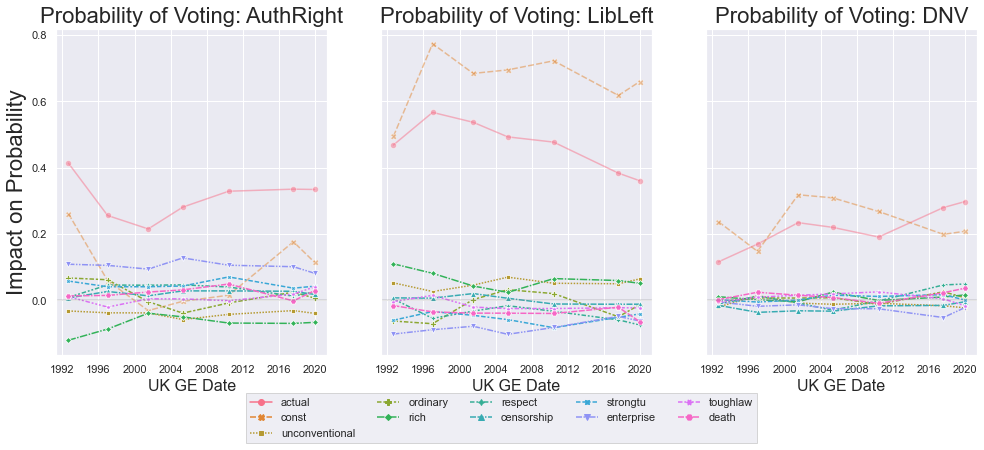

In [21]:
val_list = ['unconventional', 'ordinary', 'rich',
       'respect', 'censorship', 'strongtu', 'enterprise', 'toughlaw', 'death']
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"], val_list, figsize=(16.5, 6),  sharey=True, drop_first=True,
            mask = mask,
            ge_range=['2019', '2017', '2010', '2005', '2001', '1997', '1992'])

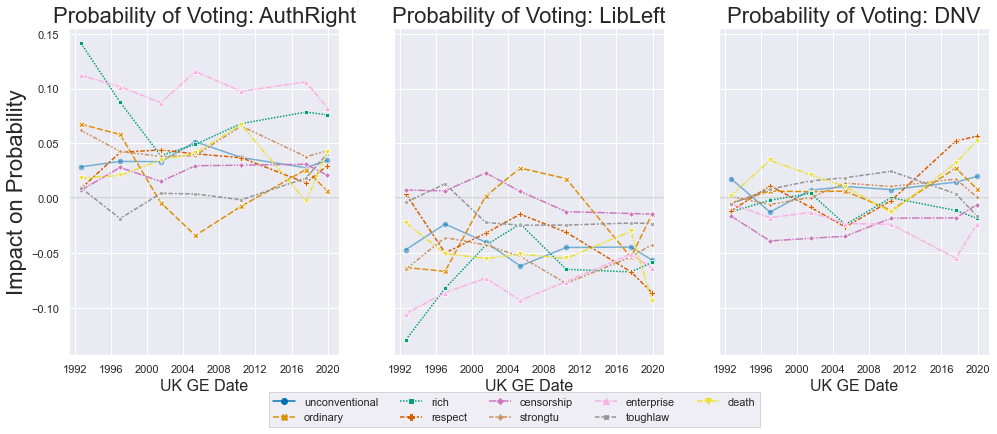

In [72]:
val_list = ['unconventional', 'ordinary', 'rich',
       'respect', 'censorship', 'strongtu', 'enterprise', 'toughlaw', 'death']
mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"], val_list, figsize=(16.5, 6),  sharey=True, variance_scaled=True,hide_const=True,add_actual=False,
            mask = mask,
            ge_range=['2019', '2017', '2010', '2005', '2001', '1997', '1992'])

In [ ]:
# TO DO:
# find correlations for all these new variables




In [38]:
f2f_harmonised.groupby("dataset")[val_list].corr().dropna().loc["1992"].replace(1,np.nan).abs().max()

unconventional    0.167237
ordinary          0.425107
rich              0.425107
respect           0.304763
censorship        0.304763
strongtu          0.350778
enterprise        0.356415
toughlaw          0.396499
death             0.396499
dtype: float64

In [39]:
f2f_harmonised.groupby("dataset")[val_list].corr().dropna().loc["1997"].replace(1,np.nan).abs().max()

unconventional    0.198581
ordinary          0.389943
rich              0.389943
respect           0.294683
censorship        0.294683
strongtu          0.337479
enterprise        0.328766
toughlaw          0.418131
death             0.418131
dtype: float64

In [40]:
f2f_harmonised.groupby("dataset")[val_list].corr().dropna().loc["2001"].replace(1,np.nan).abs().max()

unconventional    0.247237
ordinary          0.329023
rich              0.329023
respect           0.328274
censorship        0.328274
strongtu          0.282203
enterprise        0.282203
toughlaw          0.259478
death             0.247237
dtype: float64

In [41]:
f2f_harmonised.groupby("dataset")[val_list].corr().dropna().loc["2005"].replace(1,np.nan).abs().max()

unconventional    0.238138
ordinary          0.336152
rich              0.336152
respect           0.325949
censorship        0.325949
strongtu          0.308818
enterprise        0.308818
toughlaw          0.310574
death             0.241836
dtype: float64

In [42]:
f2f_harmonised.groupby("dataset")[val_list].corr().dropna().loc["2010"].replace(1,np.nan).abs().max()

unconventional    0.236700
ordinary          0.386137
rich              0.386137
respect           0.337622
censorship        0.308413
strongtu          0.327199
enterprise        0.327199
toughlaw          0.337622
death             0.236700
dtype: float64

In [44]:
f2f_harmonised.groupby("dataset")[val_list].corr().dropna().loc["2017"].replace(1,np.nan).abs().max()

unconventional    0.171160
ordinary          0.304798
rich              0.304798
respect           0.450978
censorship        0.372135
strongtu          0.302712
enterprise        0.302712
toughlaw          0.454411
death             0.454411
dtype: float64

In [45]:
f2f_harmonised.groupby("dataset")[val_list].corr().dropna().loc["2019"].replace(1,np.nan).abs().max()

unconventional    0.228022
ordinary          0.354613
rich              0.354613
respect           0.468911
censorship        0.321704
strongtu          0.292903
enterprise        0.292903
toughlaw          0.470278
death             0.470278
dtype: float64

In [48]:
f2f_harmonised[val_list].corr()

,unconventional,ordinary,rich,respect,censorship,strongtu,enterprise,toughlaw,death
unconventional,1.000000,-0.060149,0.054219,-0.163725,-0.150387,-0.113399,-0.058740,-0.154897,-0.207696
ordinary,-0.060149,1.000000,-0.360195,0.037537,0.069259,0.267284,0.257137,0.033049,0.044923
rich,0.054219,-0.360195,1.000000,0.125800,0.018260,-0.172849,-0.222870,0.101480,0.056094
respect,-0.163725,0.037537,0.125800,1.000000,0.309675,0.123827,0.103157,0.342680,0.285269
censorship,-0.150387,0.069259,0.018260,0.309675,1.000000,0.100775,0.063382,0.246308,0.172986
strongtu,-0.113399,0.267284,-0.172849,0.123827,0.100775,1.000000,0.297992,0.121292,0.119217
enterprise,-0.058740,0.257137,-0.222870,0.103157,0.063382,0.297992,1.000000,0.060797,0.094687
toughlaw,-0.154897,0.033049,0.101480,0.342680,0.246308,0.121292,0.060797,1.000000,0.362235
death,-0.207696,0.044923,0.056094,0.285269,0.172986,0.119217,0.094687,0.362235,1.000000


In [ ]:
# +ordinary, -rich, +strongtu, +enterprise
# -unconventional, respect, censorship, toughlaw, death

In [52]:
f2f_harmonised["rich"] = 4-f2f_harmonised["rich"]
f2f_harmonised["unconventional"] = 4-f2f_harmonised["unconventional"]

In [65]:
f2f_harmonised["ec_left_right"] = (f2f_harmonised[["ordinary","rich","strongtu","enterprise"]].mean(axis=1)*4)
f2f_harmonised["soc_lib_auth"] = (f2f_harmonised[["respect","censorship","toughlaw","death"]].mean(axis=1)*4)

In [66]:
f2f_harmonised[val_list].corrwith(f2f_harmonised["ec_left_right"])

unconventional    0.106990
ordinary          0.700610
rich              0.732762
respect           0.023666
censorship        0.065118
strongtu          0.650238
enterprise        0.657394
toughlaw          0.035324
death             0.033250
dtype: float64

In [67]:
f2f_harmonised[val_list].corrwith(f2f_harmonised["soc_lib_auth"])

unconventional    0.232908
ordinary          0.064658
rich             -0.103672
respect           0.705546
censorship        0.652385
strongtu          0.156015
enterprise        0.108617
toughlaw          0.687499
death             0.735793
dtype: float64

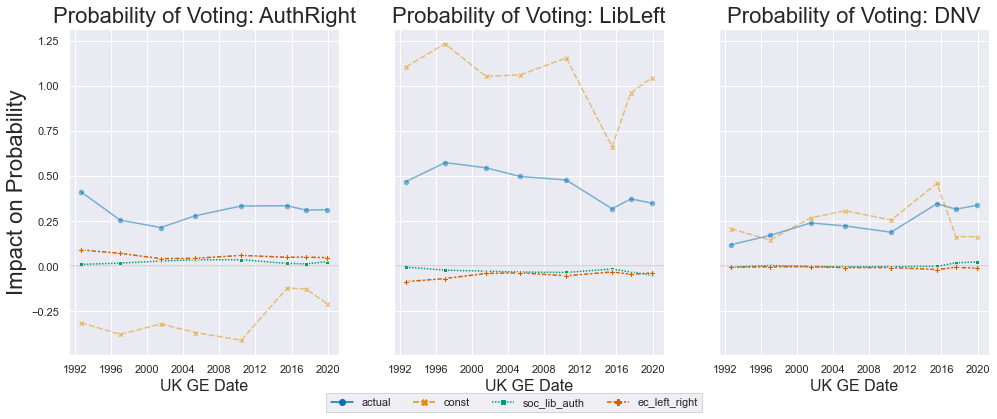

In [70]:
val_list = ['soc_lib_auth','ec_left_right']
mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"], val_list, figsize=(16.5, 6),  sharey=True, drop_first=True,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992'])

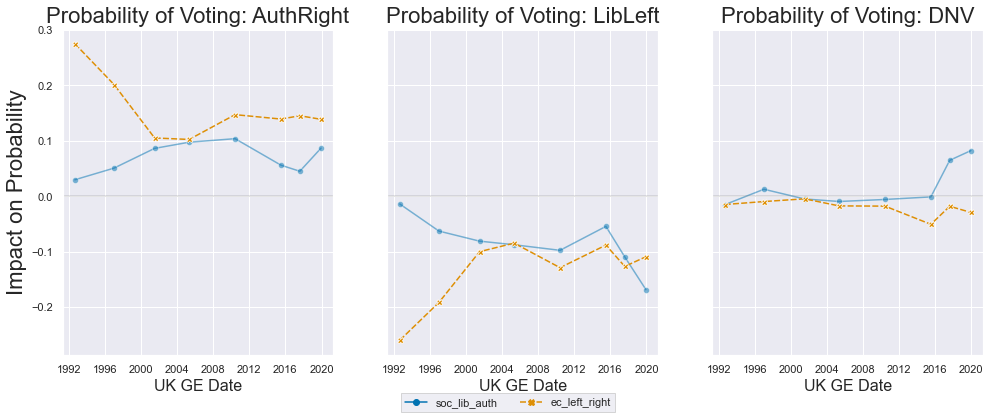

In [71]:
val_list = ['soc_lib_auth','ec_left_right']
mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"], val_list, figsize=(16.5, 6),   sharey=True, variance_scaled=True,hide_const=True,add_actual=False,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992'])

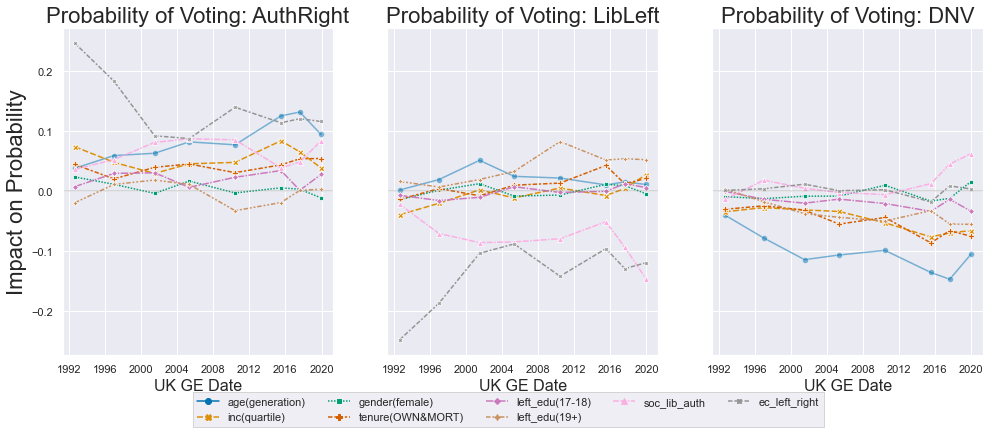

In [76]:
val_list = ['soc_lib_auth','ec_left_right']
mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)


plot_OLS_set(["AuthRight","LibLeft","DNV"], ["generation","inc(quartile)","gender_complete","housing","age_left_education_3",'soc_lib_auth','ec_left_right'],
             dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_18",
                          "age_left_education_3_19 or older",'soc_lib_auth','ec_left_right'],
             drop_first=False, figsize=(16.5, 6),  sharey=True, variance_scaled=True,hide_const=True,add_actual=False,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992'])

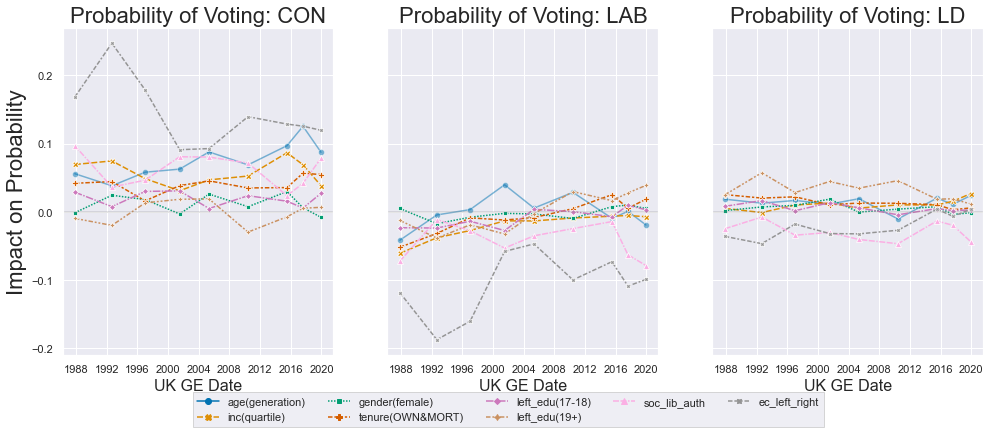

In [79]:
val_list = ['soc_lib_auth','ec_left_right']
mask = f2f_harmonised["vote_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)


plot_OLS_set(["CON","LAB","LD"], ["generation","inc(quartile)","gender_complete","housing","age_left_education_3",'soc_lib_auth','ec_left_right'],
             dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_18",
                          "age_left_education_3_19 or older",'soc_lib_auth','ec_left_right'],
             drop_first=False, figsize=(16.5, 6),  sharey=True, variance_scaled=True,hide_const=True,add_actual=False,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992', '1987'])

In [78]:
f2f_harmonised.groupby("dataset")[val_list].apply(lambda x:x.notnull().sum())

,soc_lib_auth,ec_left_right
dataset,,
1959,0,0
1964,0,0
1966,0,0
1970,0,0
1974_feb,0,0
1974_oct,0,0
1979,0,0
1983,0,0
1987,3368,3391


In [80]:
bigval_list = ['unconventional', 'ordinary', 'rich',
       'respect', 'censorship', 'strongtu', 'enterprise', 'toughlaw', 'death']
f2f_harmonised.groupby("dataset")[bigval_list].apply(lambda x:x.notnull().sum())

,unconventional,ordinary,rich,respect,censorship,strongtu,enterprise,toughlaw,death
dataset,,,,,,,,,
1959,0,0,0,0,0,0,0,0,0
1964,0,0,0,0,0,0,0,0,0
1966,0,0,0,0,0,0,0,0,0
1970,0,0,0,0,0,0,0,0,0
1974_feb,0,0,0,0,0,0,0,0,0
1974_oct,0,0,0,0,0,0,0,0,0
1979,0,0,0,0,0,0,0,0,0
1983,0,0,0,0,0,0,0,0,0
1987,0,0,3391,3351,3356,0,0,0,3360


***************************
1987
***************************
soc_lib_auth
MSE: 7.86, MAE: 2.17, EV: 0.20, R2: 0.20


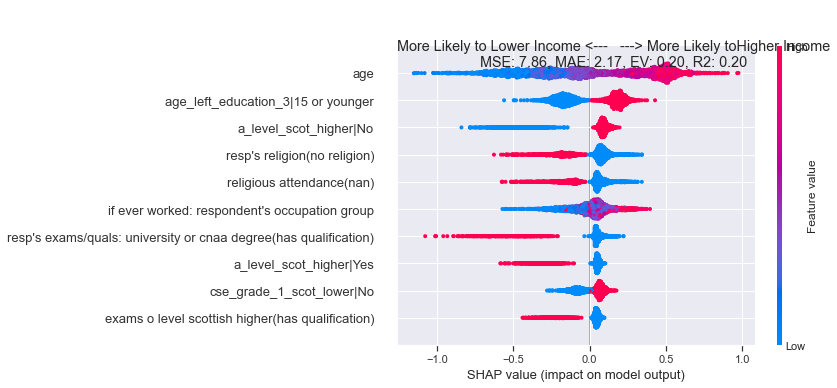

ec_left_right
MSE: 18.31, MAE: 3.54, EV: 0.15, R2: 0.15


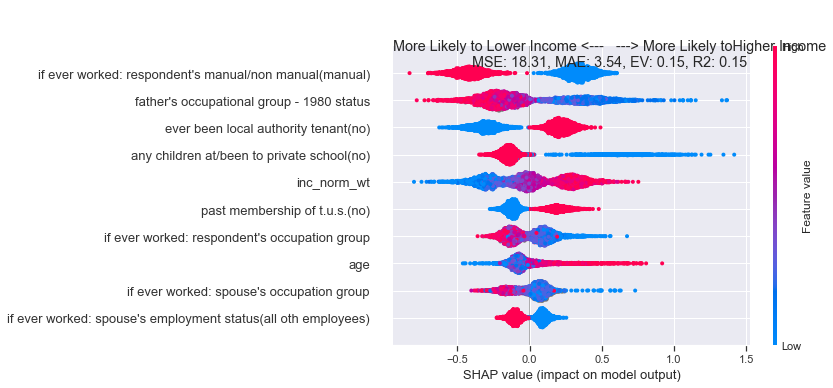

***************************
1992
***************************
soc_lib_auth
MSE: 7.22, MAE: 2.14, EV: 0.17, R2: 0.17


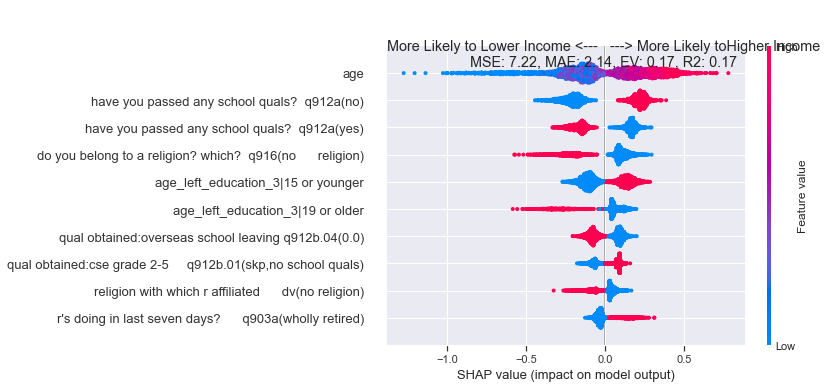

ec_left_right
MSE: 7.61, MAE: 2.21, EV: 0.19, R2: 0.19


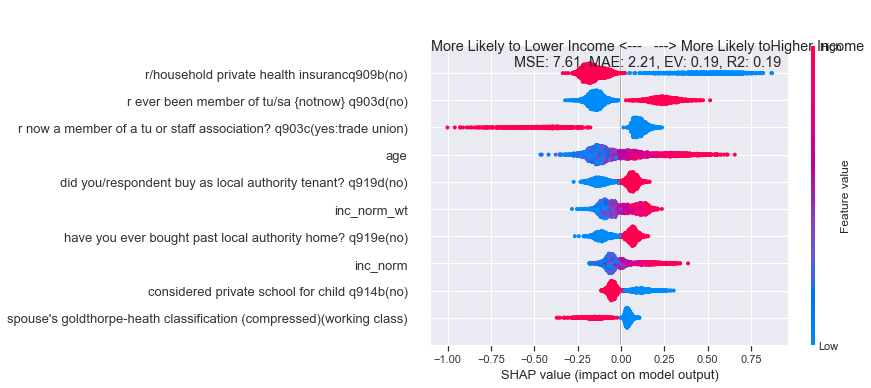

***************************
1997
***************************
soc_lib_auth
MSE: 7.34, MAE: 2.17, EV: 0.20, R2: 0.19


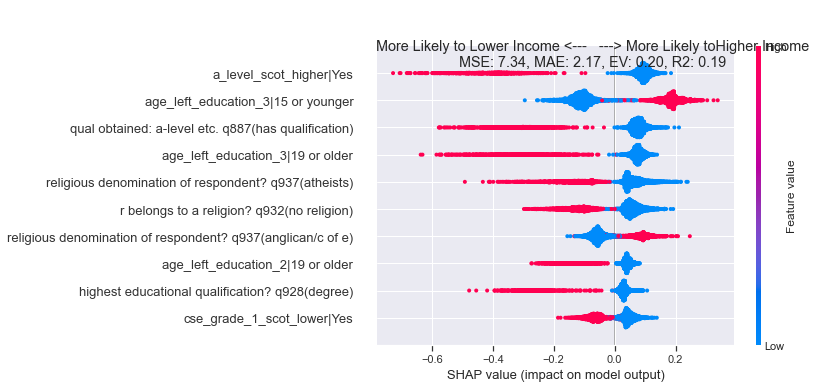

ec_left_right
MSE: 6.73, MAE: 2.05, EV: 0.15, R2: 0.15


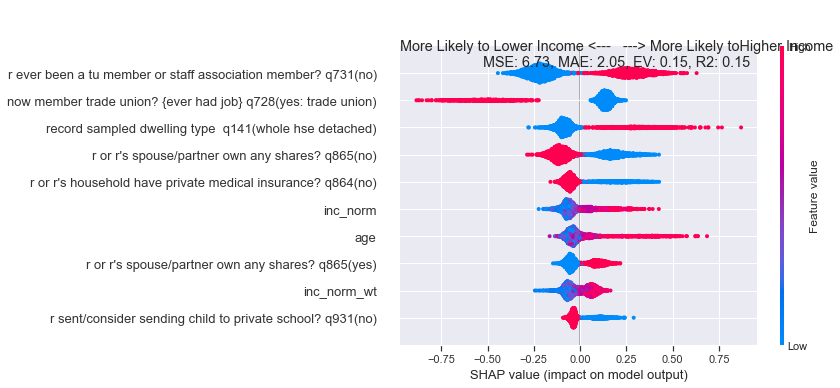

***************************
2001
***************************
soc_lib_auth
MSE: 7.88, MAE: 2.24, EV: 0.11, R2: 0.11


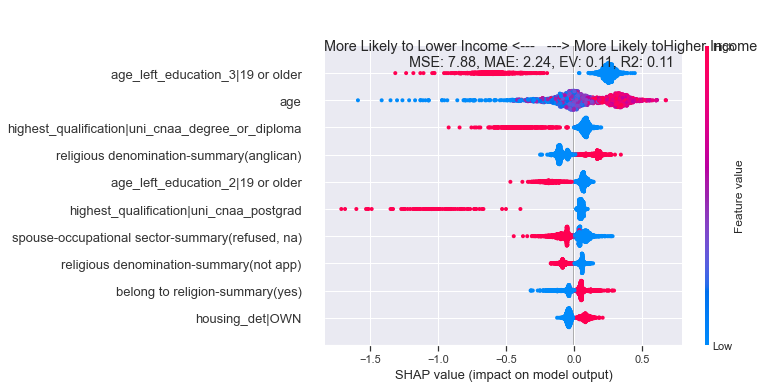

ec_left_right
MSE: 5.94, MAE: 1.89, EV: 0.08, R2: 0.08


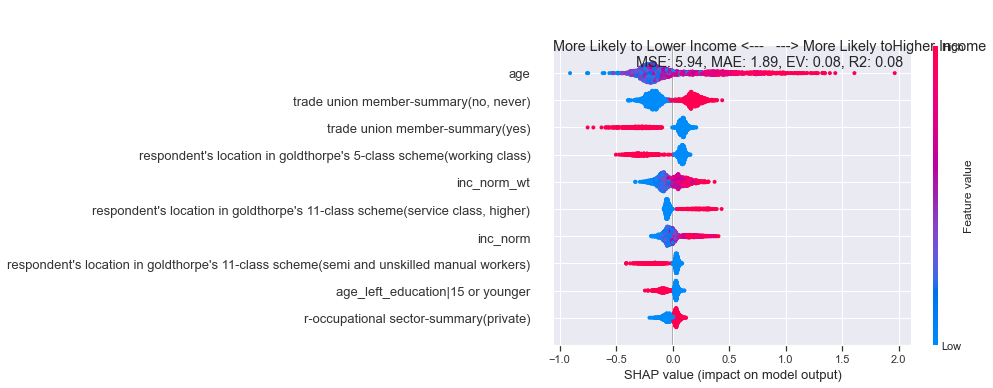

***************************
2005
***************************
soc_lib_auth
MSE: 6.59, MAE: 2.02, EV: 0.14, R2: 0.14


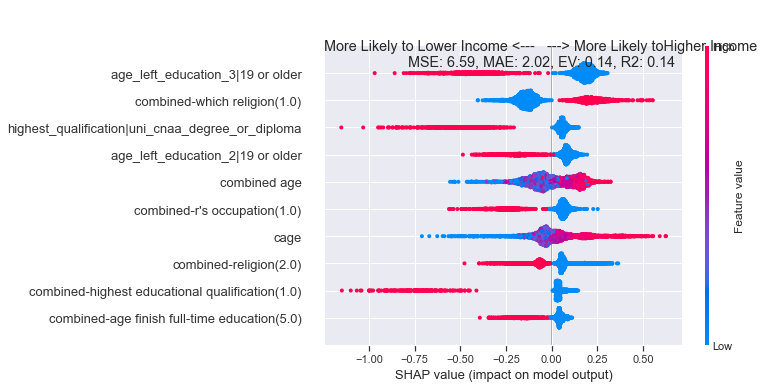

ec_left_right
MSE: 5.29, MAE: 1.79, EV: 0.08, R2: 0.08


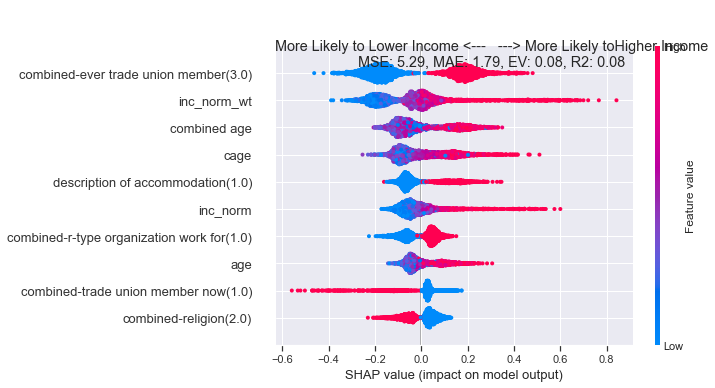

***************************
2010
***************************
soc_lib_auth
MSE: 7.78, MAE: 2.20, EV: 0.08, R2: 0.08


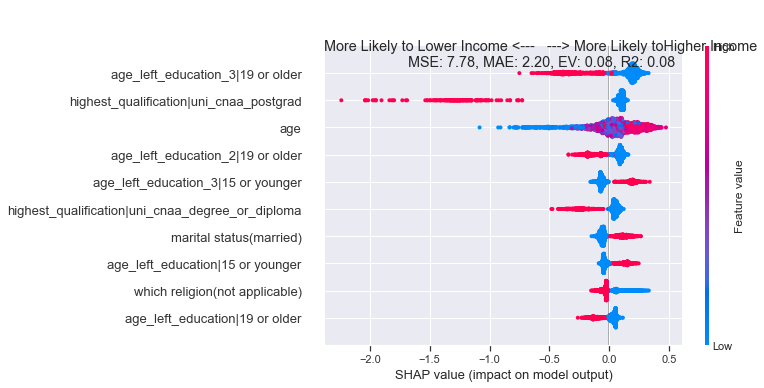

ec_left_right
MSE: 5.65, MAE: 1.89, EV: 0.10, R2: 0.10


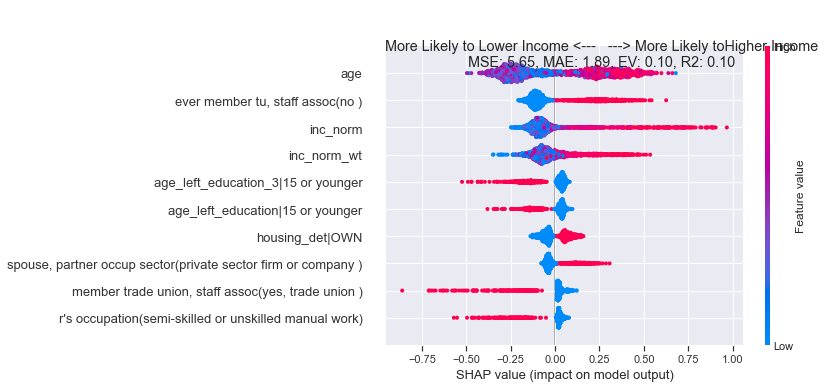

***************************
2015
***************************
soc_lib_auth
MSE: 12.06, MAE: 2.82, EV: 0.09, R2: 0.09


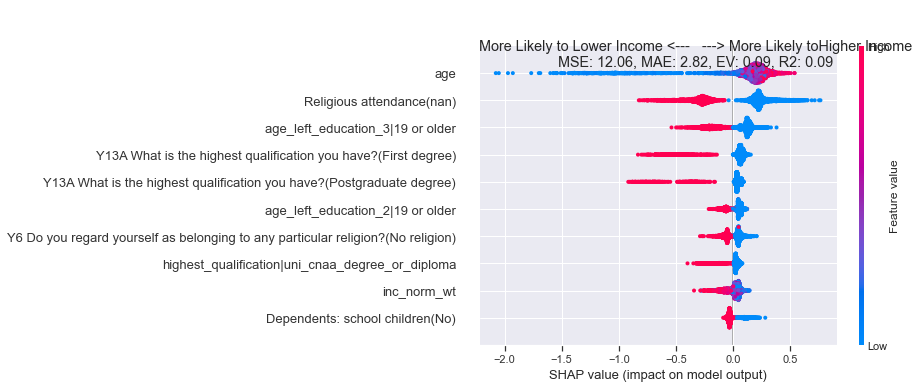

ec_left_right
MSE: 7.13, MAE: 2.14, EV: 0.11, R2: 0.11


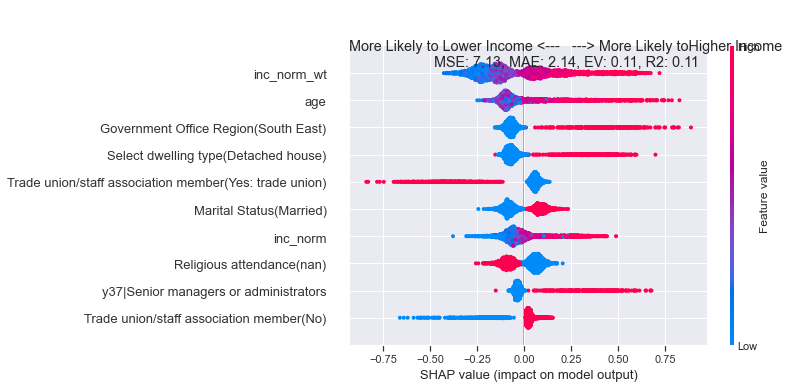

***************************
2017
***************************
soc_lib_auth
MSE: 9.66, MAE: 2.50, EV: 0.22, R2: 0.21


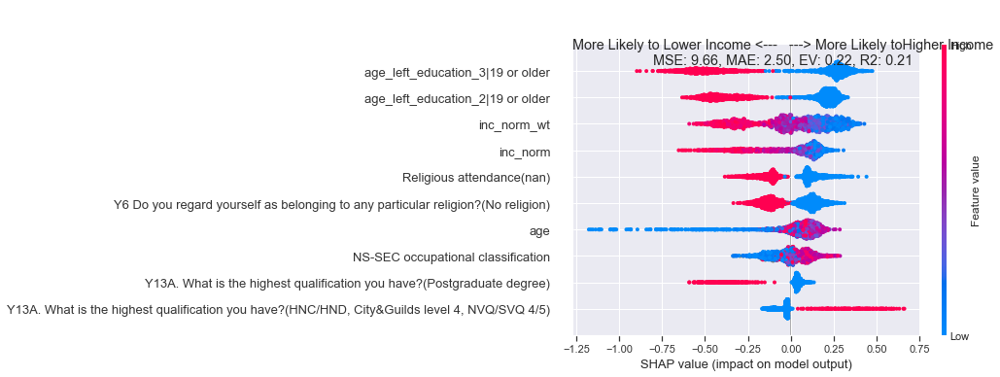

ec_left_right
MSE: 7.77, MAE: 2.22, EV: 0.10, R2: 0.10


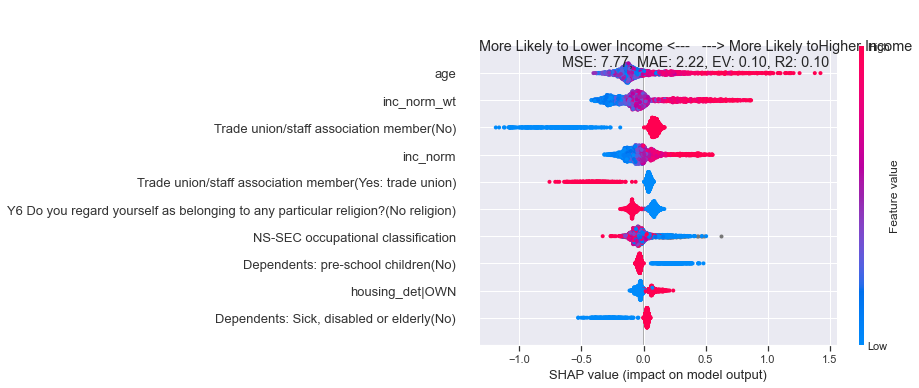

***************************
2019
***************************
soc_lib_auth
MSE: 9.71, MAE: 2.50, EV: 0.22, R2: 0.22


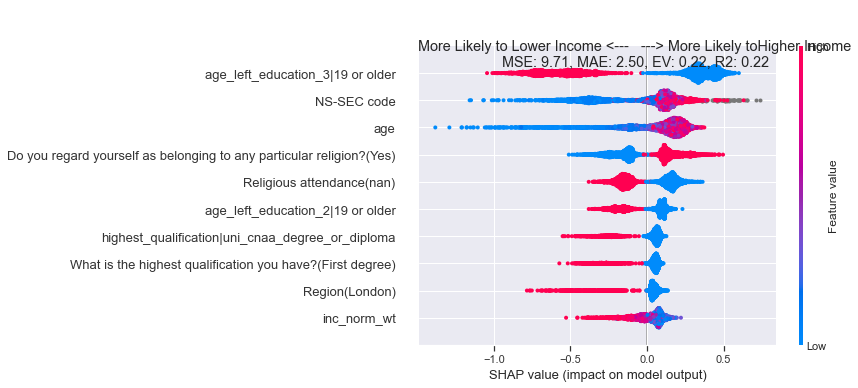

ec_left_right
MSE: 8.03, MAE: 2.29, EV: 0.09, R2: 0.09


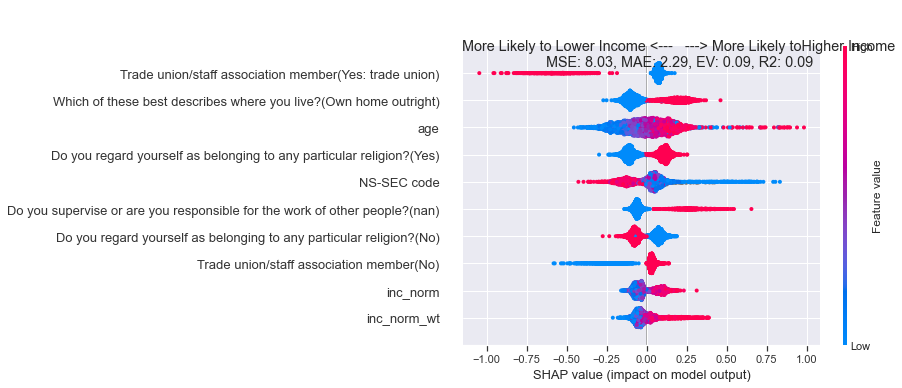

In [92]:
generic_cols = f2f_harmonised.columns
for ge in ['1987','1992', '1997', '2001', '2005', '2010', '2015',
       '2017', '2019']:
    print("***************************")
    print(ge)
    print("***************************")
    print("soc_lib_auth")
    print("===========================")
    run_ge_regression(ge,"soc_lib_auth")
    print("ec_left_right")
    print("===========================")
    run_ge_regression(ge,"ec_left_right")

***************************
1987
***************************
soc_lib_auth
MSE: 4.57, MAE: 1.66, EV: 0.54, R2: 0.54


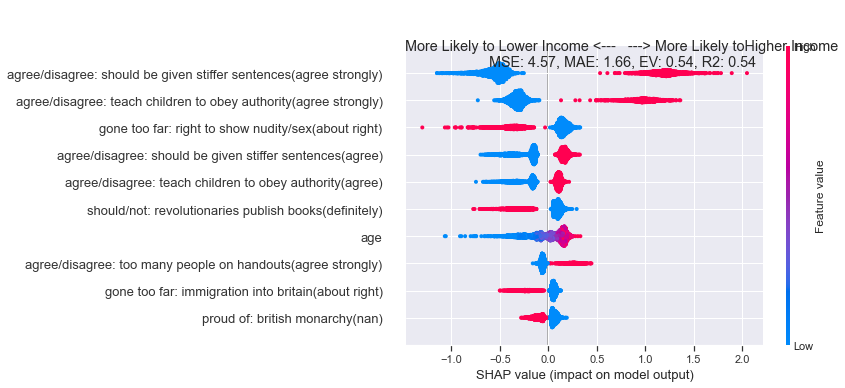

ec_left_right
MSE: 12.36, MAE: 2.68, EV: 0.43, R2: 0.43


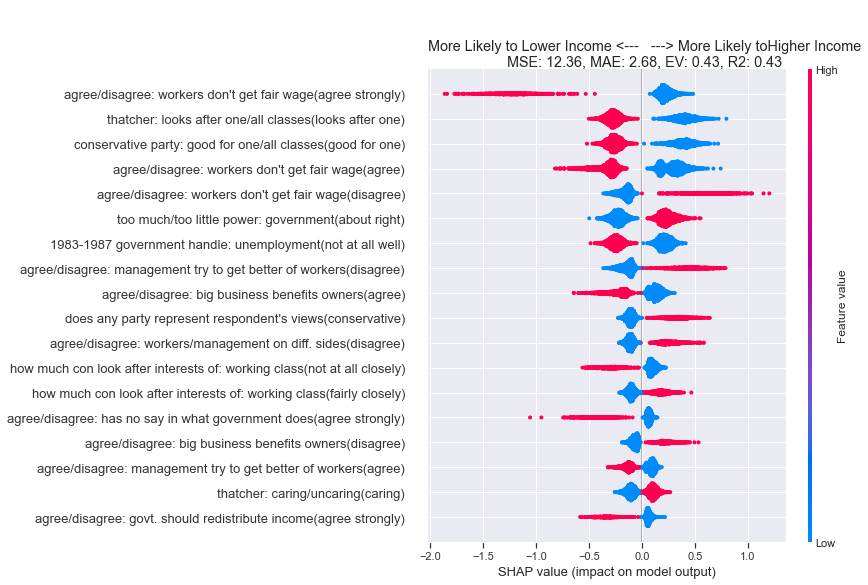

***************************
1992
***************************
soc_lib_auth
MSE: 5.20, MAE: 1.81, EV: 0.40, R2: 0.40


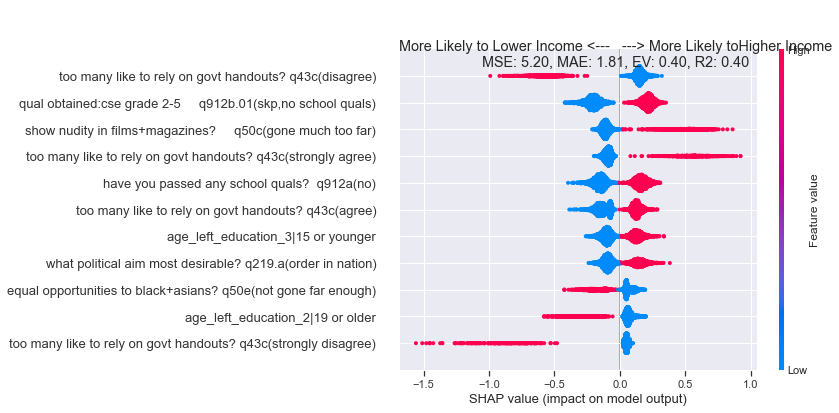

ec_left_right
MSE: 3.78, MAE: 1.54, EV: 0.60, R2: 0.60


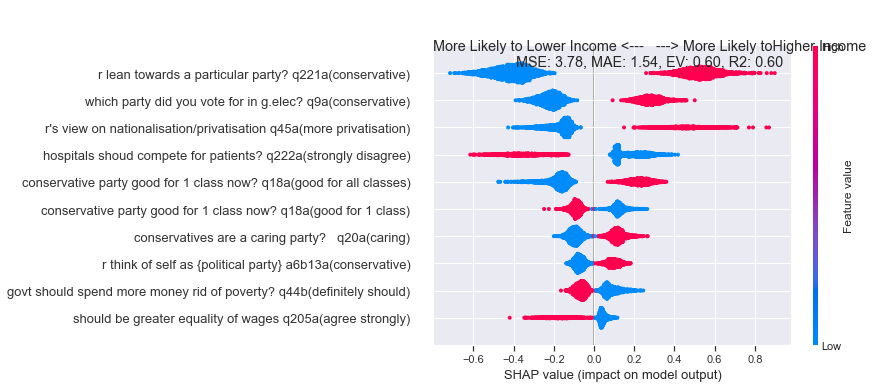

***************************
1997
***************************
soc_lib_auth
MSE: 4.84, MAE: 1.74, EV: 0.47, R2: 0.47


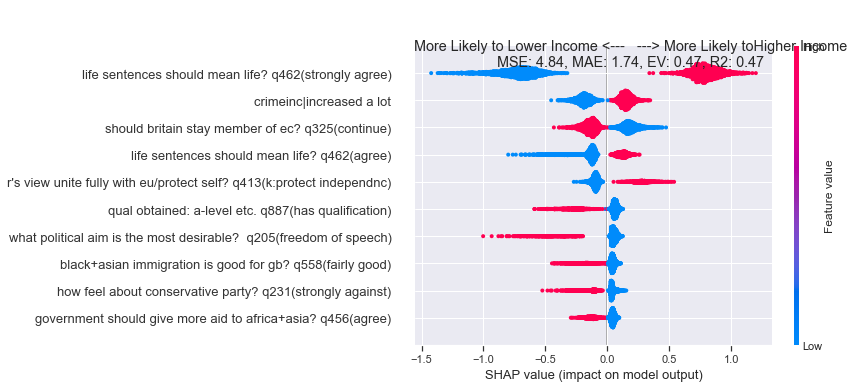

ec_left_right
MSE: 1.71, MAE: 0.92, EV: 0.78, R2: 0.78


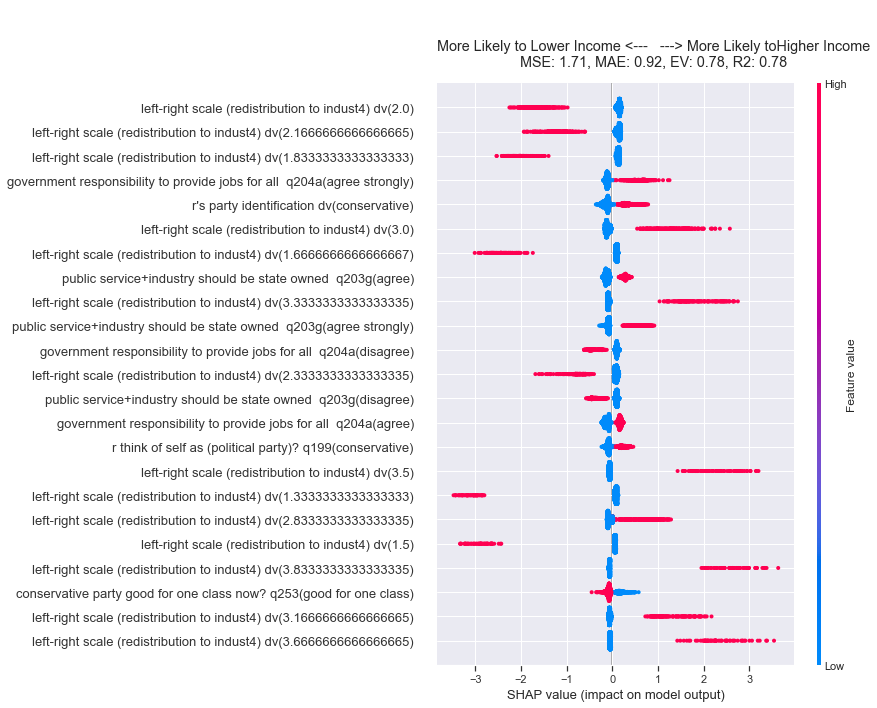

***************************
2001
***************************
soc_lib_auth
MSE: 5.59, MAE: 1.89, EV: 0.37, R2: 0.37


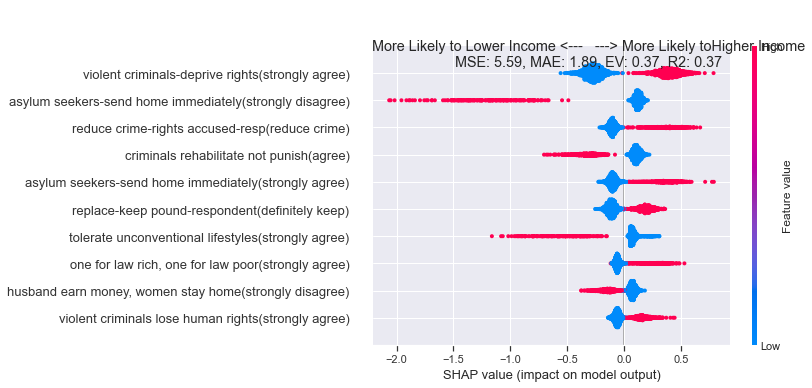

ec_left_right
MSE: 4.61, MAE: 1.62, EV: 0.28, R2: 0.28


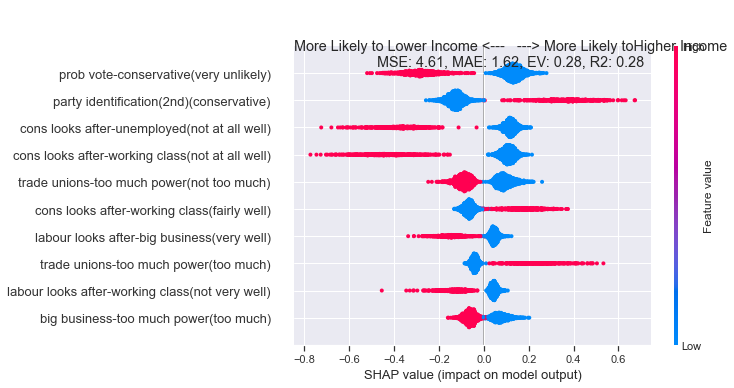

***************************
2005
***************************
soc_lib_auth
MSE: 4.30, MAE: 1.64, EV: 0.44, R2: 0.44


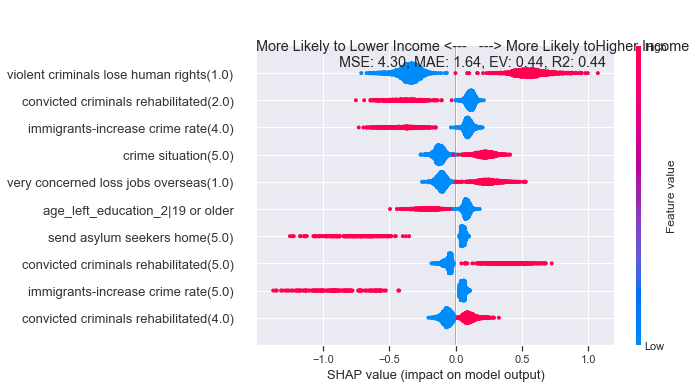

ec_left_right
MSE: 3.92, MAE: 1.53, EV: 0.32, R2: 0.32


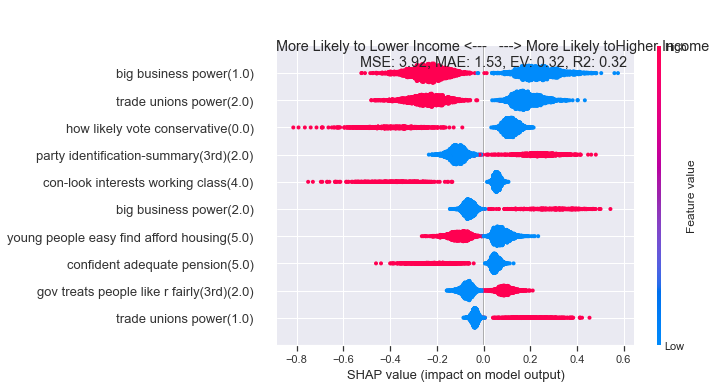

***************************
2010
***************************
soc_lib_auth
MSE: 5.41, MAE: 1.82, EV: 0.36, R2: 0.36


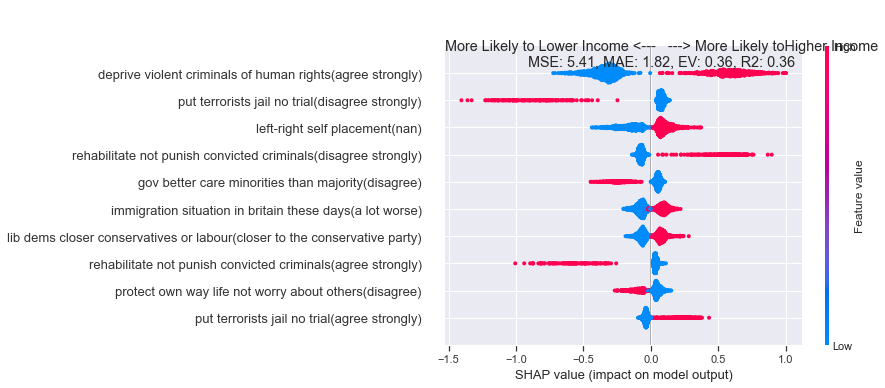

ec_left_right
MSE: 3.62, MAE: 1.50, EV: 0.42, R2: 0.42


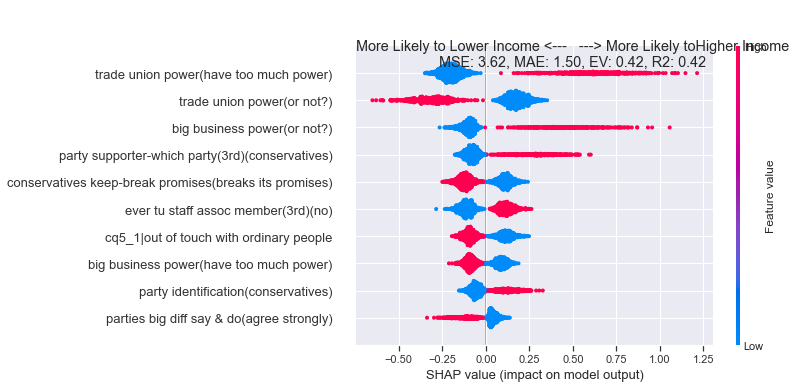

***************************
2015
***************************
soc_lib_auth
MSE: 10.32, MAE: 2.57, EV: 0.22, R2: 0.22


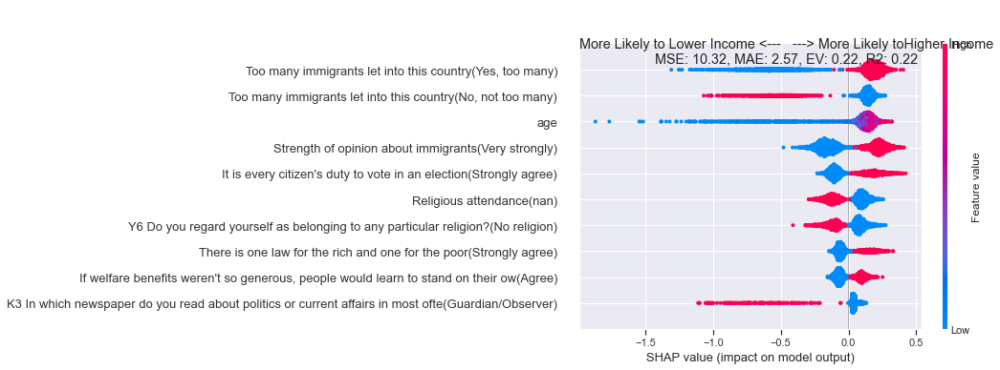

ec_left_right
MSE: 5.04, MAE: 1.79, EV: 0.37, R2: 0.37


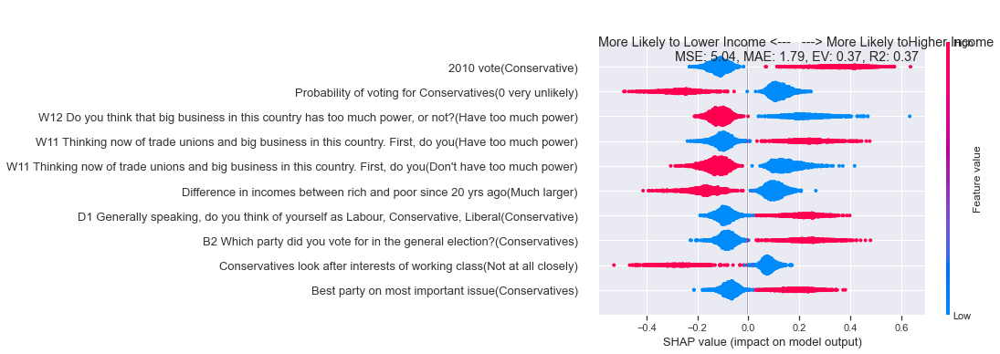

***************************
2017
***************************
soc_lib_auth
MSE: 6.85, MAE: 2.02, EV: 0.44, R2: 0.44


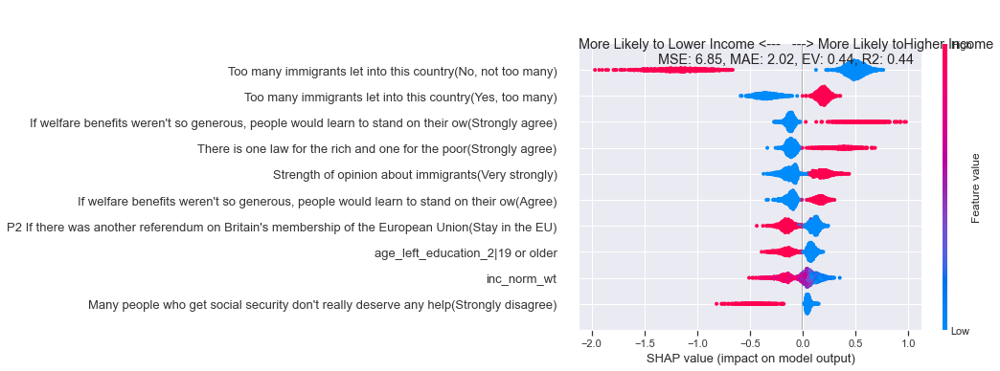

ec_left_right
MSE: 5.44, MAE: 1.84, EV: 0.37, R2: 0.37


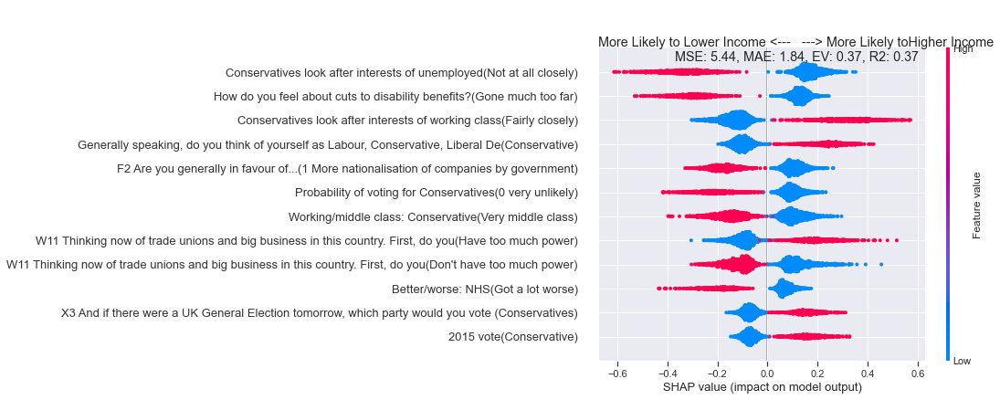

***************************
2019
***************************
soc_lib_auth
MSE: 6.26, MAE: 1.96, EV: 0.50, R2: 0.50


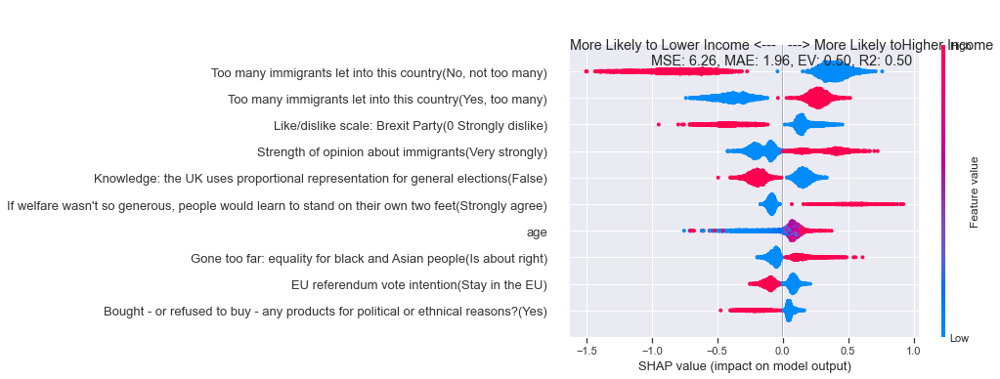

ec_left_right
MSE: 4.73, MAE: 1.71, EV: 0.46, R2: 0.46


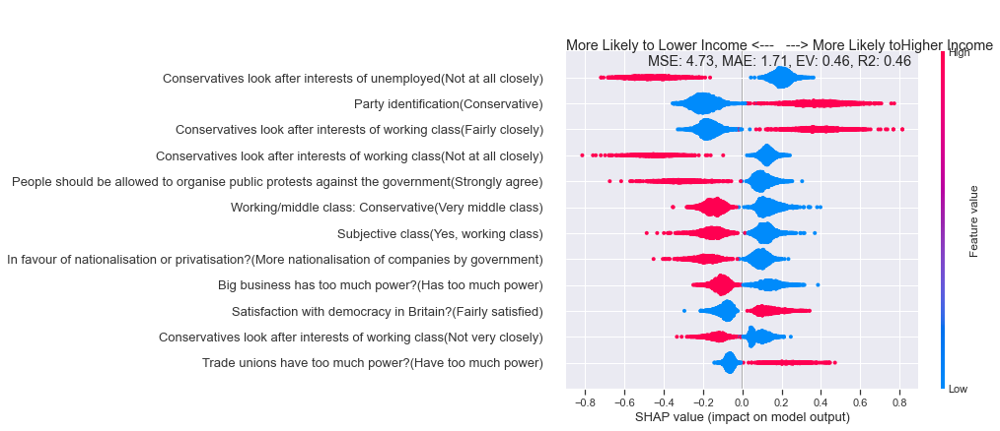

In [103]:
# run_ge_regression(ge,target_var,demo_var_only=True)
generic_cols = f2f_harmonised.columns
for ge in ['1987','1992', '1997', '2001', '2005', '2010', '2015',
       '2017', '2019']:
    print("***************************")
    print(ge)
    print("***************************")
    print("soc_lib_auth")
    print("===========================")
    dict_list = death,toughlaw,censorship,respect
    run_ge_regression(ge,"soc_lib_auth", demo_var_only=False,drop_vars=[x[ge] for x in dict_list if ge in x.keys()])
    print("ec_left_right")
    print("===========================")
    dict_list = ordinary,rich,strongtu,enterprise
    run_ge_regression(ge,"ec_left_right",demo_var_only=False,drop_vars=[x[ge] for x in dict_list if ge in x.keys()])
    
    


In [171]:
f2f_harmonised["soc_lib_auth_complete"] = f2f_harmonised["soc_lib_auth"]
f2f_harmonised["ec_left_right_complete"] = f2f_harmonised["ec_left_right"]
var_dict = {}

MSE: 4.57, MAE: 1.66, EV: 0.54, R2: 0.54


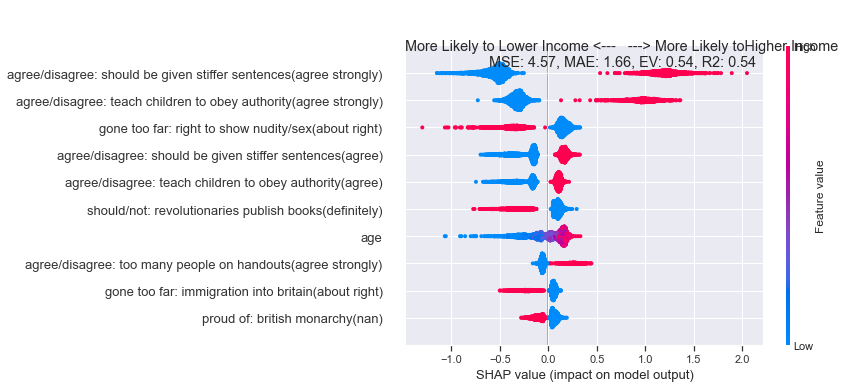

MSE: 12.36, MAE: 2.68, EV: 0.43, R2: 0.43


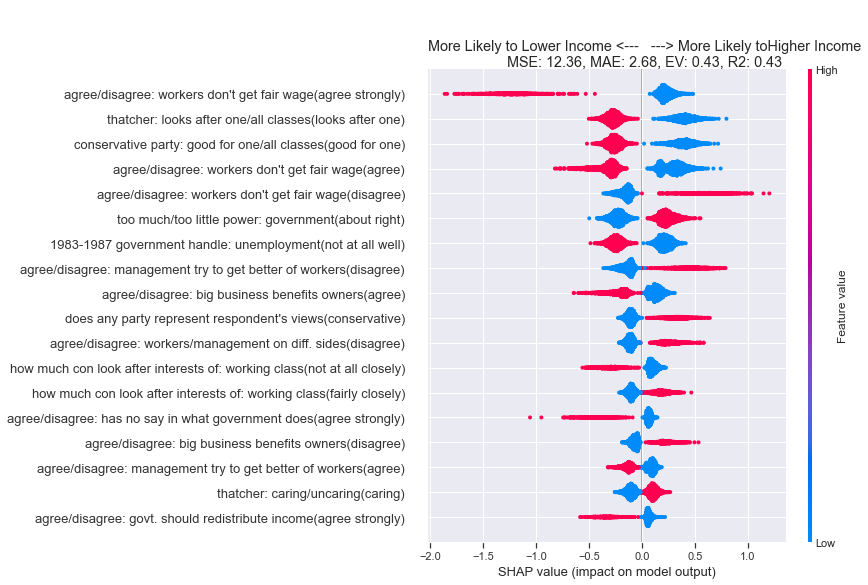

MSE: 5.20, MAE: 1.81, EV: 0.40, R2: 0.40


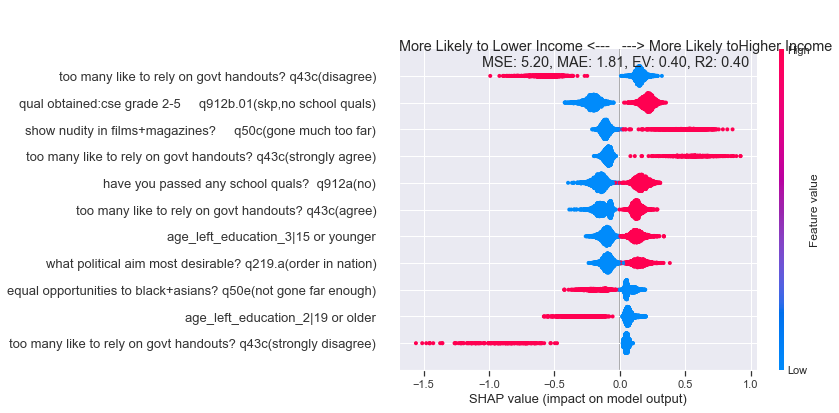

MSE: 3.78, MAE: 1.54, EV: 0.60, R2: 0.60


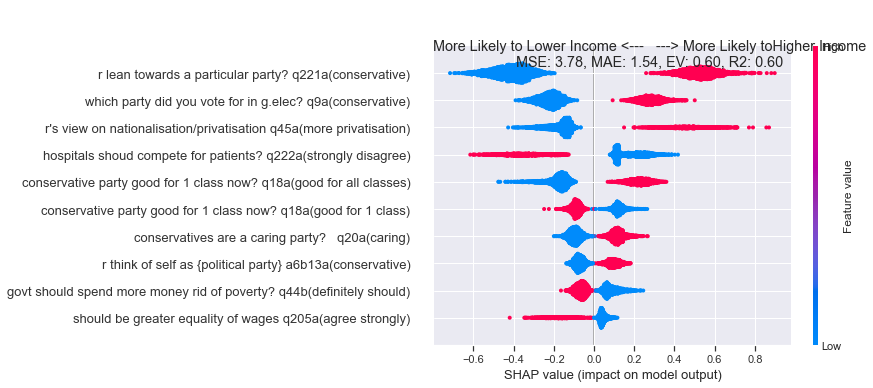

MSE: 4.84, MAE: 1.74, EV: 0.47, R2: 0.47


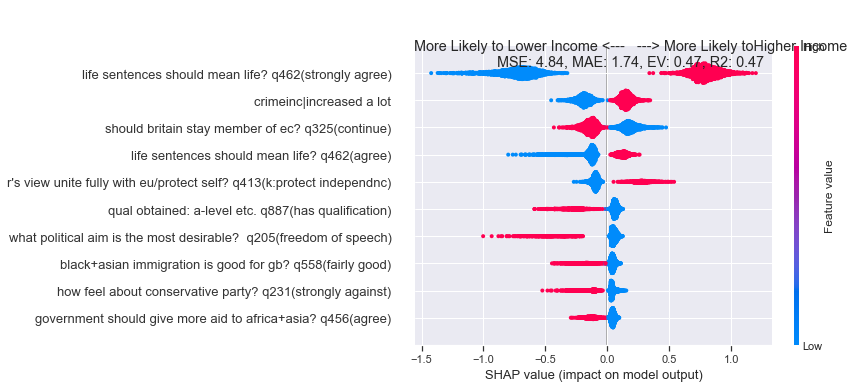

MSE: 1.71, MAE: 0.92, EV: 0.78, R2: 0.78


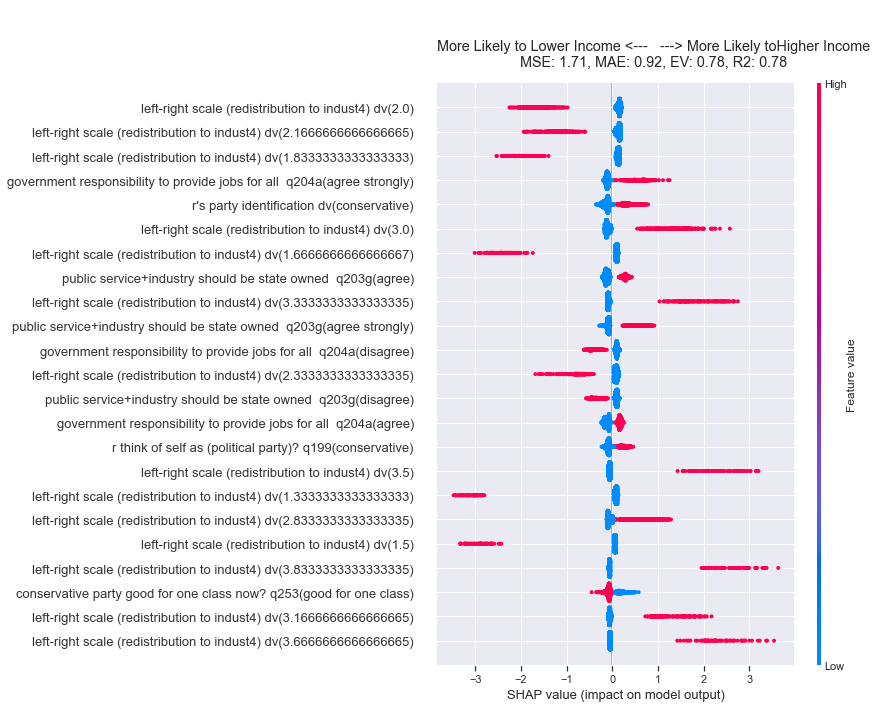

MSE: 5.59, MAE: 1.89, EV: 0.37, R2: 0.37


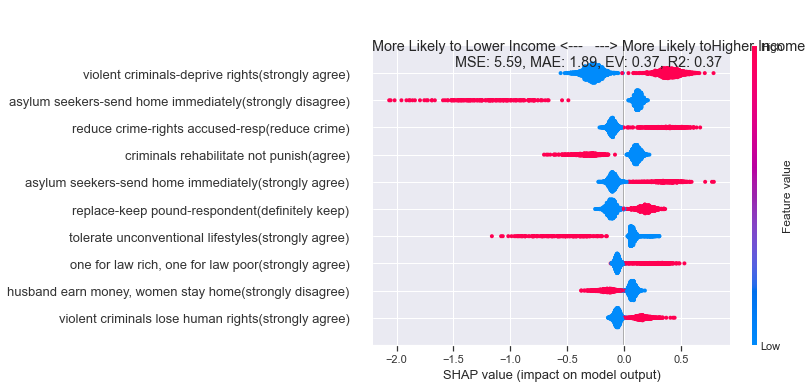

MSE: 4.61, MAE: 1.62, EV: 0.28, R2: 0.28


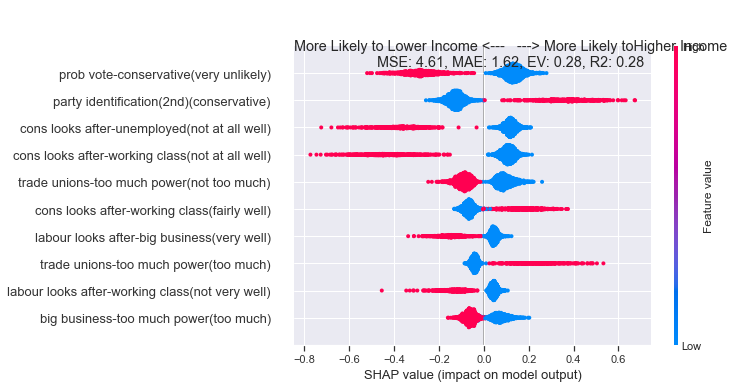

MSE: 4.27, MAE: 1.64, EV: 0.44, R2: 0.44


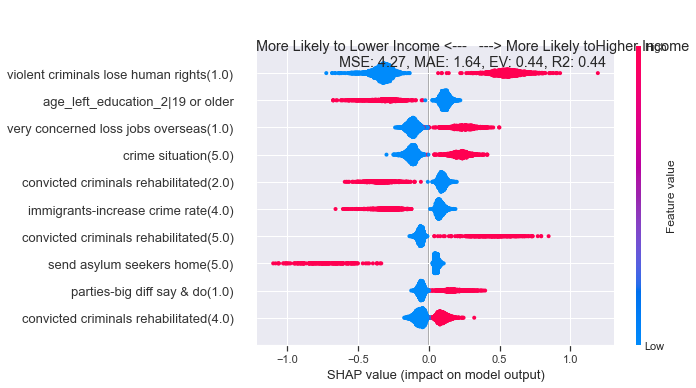

MSE: 3.89, MAE: 1.52, EV: 0.32, R2: 0.32


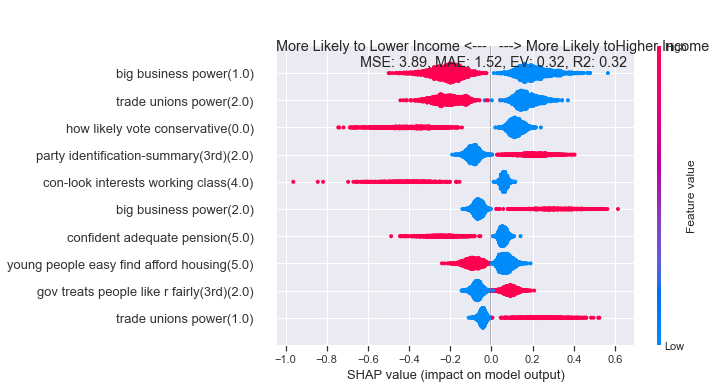

MSE: 5.41, MAE: 1.82, EV: 0.36, R2: 0.36


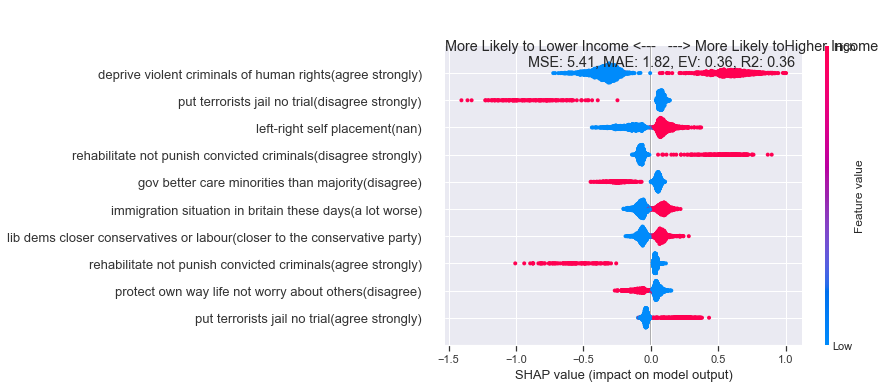

MSE: 3.62, MAE: 1.50, EV: 0.42, R2: 0.42


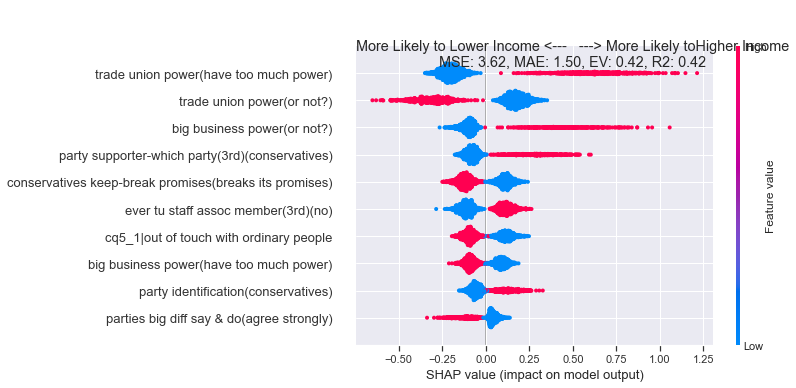

MSE: 10.32, MAE: 2.57, EV: 0.22, R2: 0.22


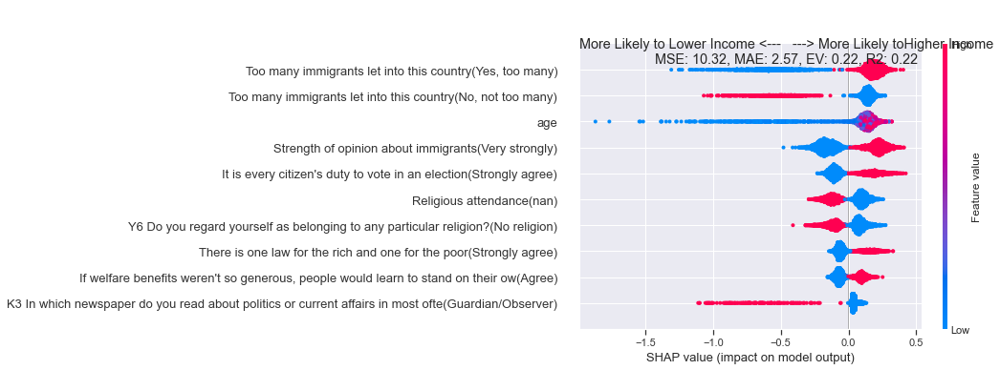

MSE: 5.04, MAE: 1.79, EV: 0.37, R2: 0.37


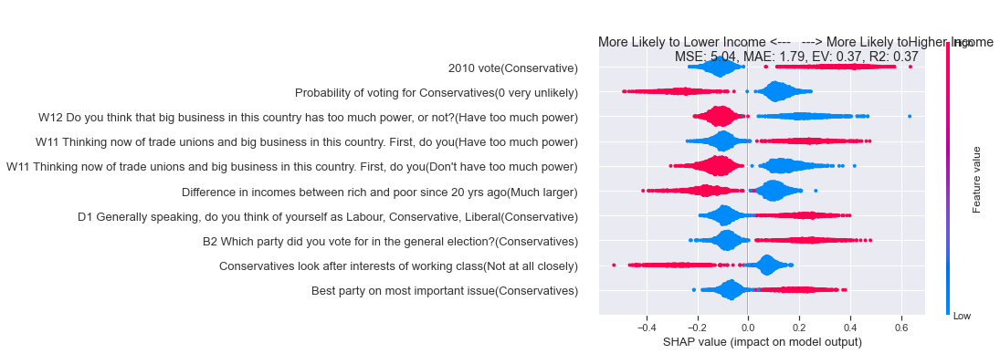

MSE: 6.58, MAE: 1.98, EV: 0.47, R2: 0.46


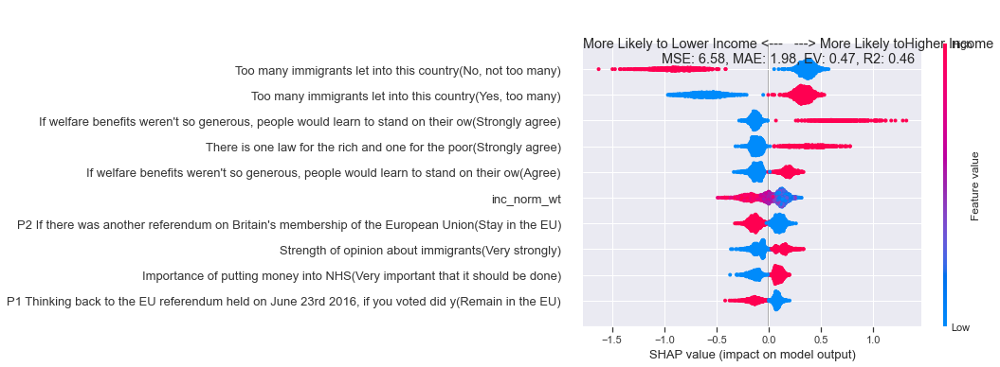

MSE: 5.34, MAE: 1.81, EV: 0.38, R2: 0.38


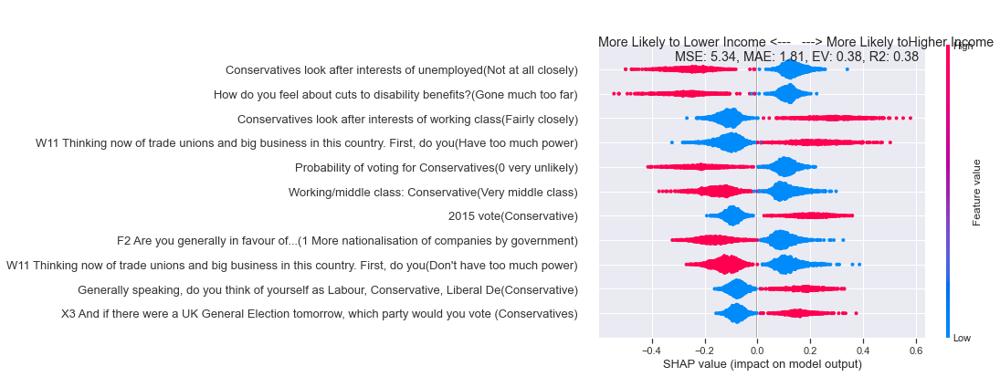

MSE: 6.25, MAE: 1.96, EV: 0.50, R2: 0.50


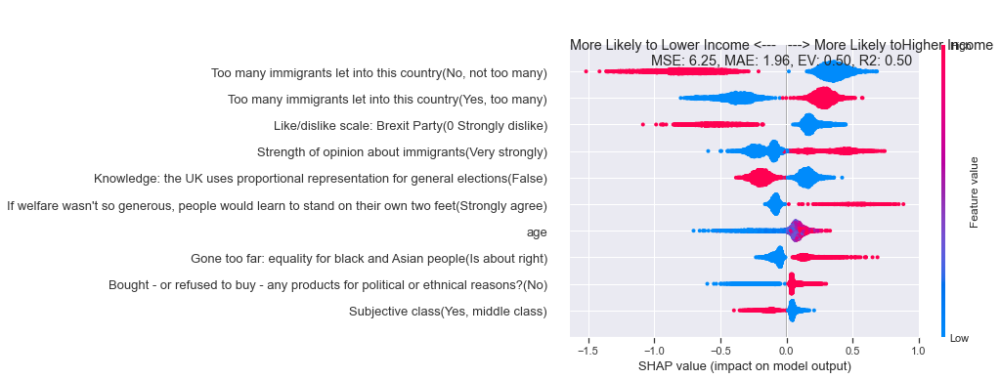

MSE: 4.78, MAE: 1.72, EV: 0.46, R2: 0.46


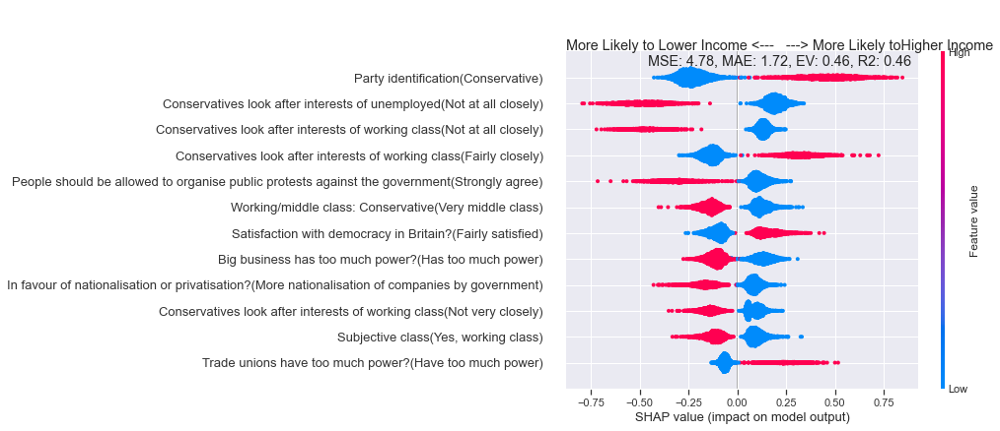

In [172]:
for ge in ['1987','1992', '1997', '2001', '2005', '2010', '2015',
       '2017', '2019']:
    dict_list = death,toughlaw,censorship,respect
    predictions,shap_values,train_columns = run_ge_regression(ge,"soc_lib_auth", demo_var_only=False,
                                                drop_vars=[x[ge] for x in dict_list if ge in x.keys()], get_predictions=True)
    ge_mask = (f2f_harmonised["dataset"]==ge)
    f2f_harmonised.loc[ge_mask&f2f_harmonised["soc_lib_auth"].isnull(),
                       "soc_lib_auth_complete"] = predictions[f2f_harmonised[ge_mask]["soc_lib_auth"].isnull()]
    var_dict[(ge,"soc_lib_auth")]= pd.DataFrame(shap_values,columns=train_columns).abs().mean().sort_values().replace(0,np.nan).dropna().tail(100)
    
    dict_list = ordinary,rich,strongtu,enterprise
    predictions,shap_values,train_columns = run_ge_regression(ge,"ec_left_right", demo_var_only=False,
                                                drop_vars=[x[ge] for x in dict_list if ge in x.keys()], get_predictions=True)
    ge_mask = (f2f_harmonised["dataset"]==ge)
    f2f_harmonised.loc[ge_mask&f2f_harmonised["ec_left_right"].isnull(),
                       "ec_left_right_complete"] = predictions[f2f_harmonised[ge_mask]["ec_left_right"].isnull()]
    var_dict[(ge,"ec_left_right")]= pd.DataFrame(shap_values,columns=train_columns).abs().mean().sort_values().replace(0,np.nan).dropna().tail(100)
    

In [156]:
train_columns,shap_values.shape

(Index(['Total number of dwellings', 'wt_sel_wt', 'Total number of households',
        'wt_demog_cses', 'age', 'wt_vote_f2f', 'inc_det', 'gender_complete',
        'Including yourself, how many adults aged 18 and over currently live in your hous',
        'NS-SEC code',
        ...
        'Contacted at home during 2019 GE campaign: SNP(No)',
        'Contacted at home during 2019 GE campaign: SNP(Yes)',
        'Contacted at home during 2019 GE campaign: SNP(nan)',
        'Contacted by independent candidate: None(No)',
        'Contacted by independent candidate: None(Yes)',
        'Contacted by independent candidate: None(nan)',
        'More trustworthy / confident they know what they`re doing(Not stated)',
        'More trustworthy / confident they know what they`re doing(No)',
        'More trustworthy / confident they know what they`re doing(Yes)',
        'More trustworthy / confident they know what they`re doing(nan)'],
       dtype='object', length=12735),
 (3489, 12735))

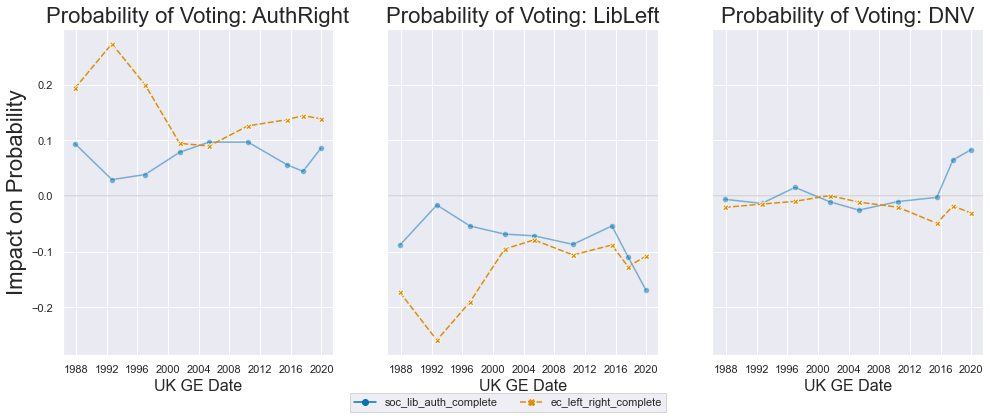

In [176]:
val_list = ['soc_lib_auth_complete','ec_left_right_complete']
mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"],
#              ["generation","inc(quartile)","gender_complete","housing","age_left_education_3",
              ['soc_lib_auth_complete','ec_left_right_complete'],
#              dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_18",
#                           "age_left_education_3_19 or older",'soc_lib_auth','ec_left_right'],
             drop_first=False, figsize=(16.5, 6),  sharey=True, variance_scaled=True,hide_const=True,add_actual=False,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992','1987'])

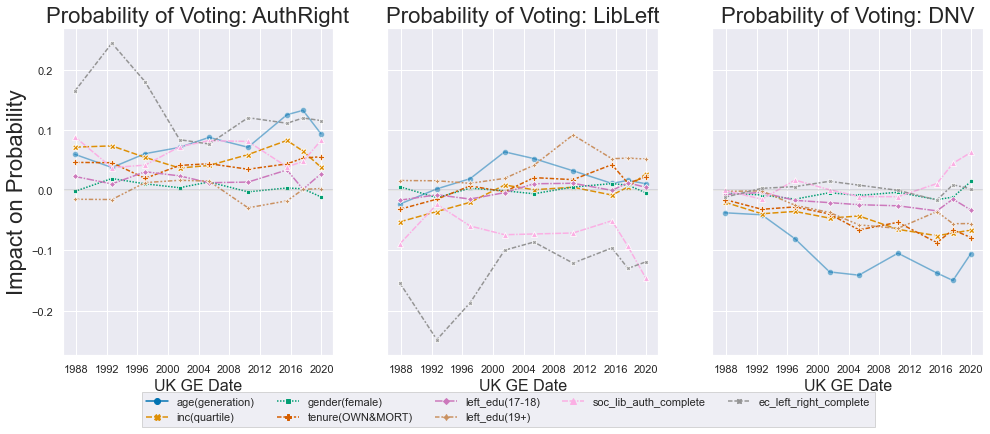

In [178]:
val_list = ['soc_lib_auth_complete','ec_left_right_complete']
mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"],
             ["generation","inc(quartile)","gender_complete","housing","age_left_education_3",
              'soc_lib_auth_complete','ec_left_right_complete'],
             dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_18",
                          "age_left_education_3_19 or older",'soc_lib_auth_complete','ec_left_right_complete'],
             drop_first=False, figsize=(16.5, 6),  sharey=True, variance_scaled=True,hide_const=True,add_actual=False,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992','1987'])

In [192]:
pd.Series([x.split("(")[0].split("|")[0] for x in flatten([v.index for k,v in var_dict.items()])]).value_counts()[50:].head(50)

gov treats people like r fairly                                                     5
M1 On the whole, are you satisfied or dissatisfied with the way that democracy w    5
Subjective class                                                                    5
Politicians ignore the issues I really care about                                   5
what political aim is the most desirable?  q205                                     4
agree/disagree: parties interested in votes not opinions                            4
govt should introduce stricter laws on tus? q46a                                    4
Govt spend less on foreign aid?                                                     4
Govt's responsibility to provide a job for everyone who wants one                   4
immigrants-increase crime rate                                                      4
confident adequate pension                                                          4
violent criminals-deprive rights                      

In [174]:
# f2f_harmonised.groupby("dataset")["ec_left_right_complete"].apply(lambda x: x.isnull().sum())

dataset
1959        2922
1964        2922
1966        2922
1970        2922
1974_feb    2462
1974_oct    2365
1979        1893
1983        3955
1987           0
1992           0
1997           0
2001           0
2005           0
2010           0
2015           0
2017           0
2019           0
Name: ec_left_right_complete, dtype: int64

In [152]:
[BES_df_list

(3489, 12735)

In [119]:
predictions.round().astype(int).describe()#.hist(bins=16)

count    3946.000000
mean        9.682717
std         2.723636
min         1.000000
25%         8.000000
50%        10.000000
75%        12.000000
max        16.000000
dtype: float64

In [124]:
predictions.describe()

count    3946.000000
mean        9.690369
std         2.705047
min         1.020069
25%         8.050548
50%        10.206683
75%        11.653536
max        15.760727
dtype: float64

In [123]:
f2f_harmonised["soc_lib_auth"].describe()

count    26623.000000
mean        10.338867
std          3.208763
min          0.000000
25%          8.000000
50%         11.000000
75%         12.000000
max         16.000000
Name: soc_lib_auth, dtype: float64

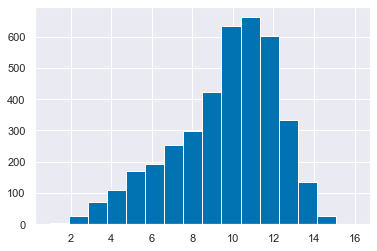

In [129]:
predictions.round().astype(int).hist(bins=16)

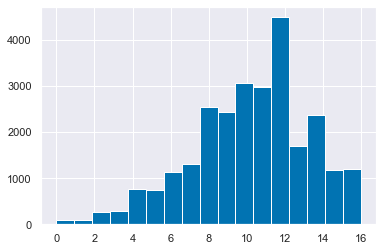

In [133]:
f2f_harmonised["soc_lib_auth"].hist(bins=17)

In [ ]:
BES_df_list["1970"]["v224"].value_counts().sort_index()

In [20]:
BES_df_list["1970"]["v225"].value_counts().sort_index()

0.0       2
1.0    1601
5.0     360
8.0     840
9.0     119
Name: v225, dtype: int64

In [21]:
BES_df_list["1970"]["v226"].value_counts().sort_index()

0.0       5
1.0     959
3.0     151
5.0     212
8.0    1567
9.0      28
Name: v226, dtype: int64

In [33]:
death_penalty = BES_df_list["1970"][["v224","v225","v226"]].replace({0:np.nan,8:np.nan,9:np.nan,1:0,3:.5,5:1}).mean(axis=1)
death_penalty.value_counts(dropna=False)
#.isnull().sum(axis=1).value_counts()

0.000000    1910
1.000000     393
0.500000     197
NaN          118
0.333333     116
0.166667      57
0.250000      54
0.666667      43
0.750000      24
0.833333      10
dtype: int64

In [45]:
df_pred.corrwith(death_penalty,drop=True).dropna().sort_values().head(20)

DEATH PENALTY POLICY(1.0)       -0.568851
DEATH PENALTY POLICY  66(1.0)   -0.495921
DEATH PENALTY POLICY  70(1.0)   -0.297546
CON PARTY ANTI MR5  1966 (4)    -0.242389
3RD ADDITIONAL PROBLEM63        -0.203257
CON PARTY PRO MR5   1963 (3)    -0.185118
PRO-WILSON MR5      1964 (4)    -0.181919
INDEX OF IMMIG FEELING66(1.0)   -0.134861
IMMIG OPIN STRENGTH 1966(1.0)   -0.133008
IMMIGRANT POLICY    1966(1.0)   -0.128365
LAB PARTY PRO MR5   1966 (3)    -0.126689
PRO-GRIMOND MR5     1963 (3)    -0.122683
ATTIT CON-LAB OBJECTS 64        -0.122655
PRO-LAB RESPONSES   1966(0.0)   -0.122126
IMP CAMPAIGN ISSUES 1966 (3)    -0.121961
KIND OF SCHOOL(5.0)             -0.120402
IMMIGRANT POLICY    1963(1.0)   -0.120333
ATTIT CON-LAB OBJECTS 70        -0.119068
LAB PARTY PRO MR5   1970 (2)    -0.118340
PRO-HOME MR5        1964 (3)    -0.114172
dtype: float64

In [46]:
BES_label_list["1970"]

{'v1': 'STUDY NUMBER - 7250',
 'v2': 'RESPONDENT NUMBER',
 'v3': 'QUESTIONNAIRE NUMBER  64',
 'v4': 'QUESTIONNAIRE NUMBER  66',
 'v5': 'QUESTIONNAIRE NUMBER  70',
 'v6': 'ROTATION SCHEME     1963',
 'v7': 'QUESTIONNAIRE COLOR 1964',
 'v8': 'QUESTIONNAIRE COLOR 1966',
 'v9': 'QUESTIONNAIRE COLOR 1970',
 'v10': '63 CROSS-SECTION FILTER',
 'v11': '64 ELECTORATE FILTER',
 'v12': '64 ELECTORATE WEIGHTS',
 'v13': '66 ELECTORATE FILTER',
 'v14': '66 ELECTORATE WEIGHTS',
 'v15': '63&70 PANEL FILTER',
 'v16': '63&70 PANEL WEIGHTS',
 'v17': '63&64&70 PANEL FILTER',
 'v18': '63&66&70 PANEL FILTER',
 'v19': '63&64&66&70 PANEL FILTER',
 'v20': '63&64&66&70 PANEL WEIGHT',
 'v21': '64&70 PANEL FILTER',
 'v22': '64&70 PANEL WEIGHTS',
 'v23': '64&66&70 PANEL FILTER',
 'v24': '66&70 PANEL FILTER',
 'v25': '66&70 PANEL WEIGHTS',
 'v26': '63&66 PANEL FILTER',
 'v27': '63&64&66 PANEL FILTER',
 'v28': '63&64 PANEL FILTER',
 'v29': '64&66 PANEL FILTER',
 'v30': '64&66 PANEL WEIGHTS',
 'v31': 'CONSTITUENCY NU

In [ ]:
#  'v193': '1ST ADDITIONAL PROBLEM63',
#  'v194': '2ND ADDITIONAL PROBLEM63',
#  'v195': '3RD ADDITIONAL PROBLEM63',
#  'v196': '4TH ADDITIONAL PROBLEM63',

## think these should be nominal

In [ ]:
################# Factor Analysis - can we find lib-auth/left-right axes directly?

In [364]:
ge = "2019"
harm_vars = ["wt"]
#"wt","age","housing_det","vote_complete","inc_det"
target_var = "wt"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Lower Income","Higher Income"]
var_stub = "wt"
min_features = 10
drop_vars = []
drop_std_thresh = 0

alg = get_xgboost_alg(classification_problem=False)

# find variables with no coverage/variation in focal instances (mask)
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=False)

In [365]:
df_pred =df_pred.dropna(axis=1)

In [366]:
df_pred = df_pred.drop(search(df_pred,"(nan)").index,axis=1)#,df_pred.shape
df_pred = df_pred.drop(search(df_pred,"Contact|b01").index,axis=1)
df_pred = df_pred.drop(search(df_pred,"(Don't know)").index,axis=1)
df_pred = df_pred.drop(search(df_pred,"(Not stated)").index,axis=1)
df_pred = df_pred.drop(search(df_pred,"Main survey mode|CSES survey mode|Who else was present").index,axis=1)
df_pred = df_pred.drop(search(df_pred,"Conservative|Labour|party|Party").index,axis=1)

In [371]:
decomp_index = df_pred.index
decomp_columns = df_pred.columns
clean_feature_set_std = StandardScaler().fit_transform(df_pred.values )
decomp_std = pd.DataFrame(   clean_feature_set_std,
                             columns = df_pred.columns,
                             index   = df_pred.index      )

In [372]:
%%time
# 5 mins
## RUN (some variant of) PCA (potentially v slow!)
n_components = decomp_std.shape[1]
n_components = 4
# (svd_solver='full', n_components='mle',whiten=True)
# decomp = PCA(n_components = n_components,svd_solver='full')
# decomp = FastICA(algorithm='deflation', fun='exp', fun_args=None, max_iter=1000,
#     n_components=None, random_state=None, tol=0.07, w_init=None, whiten=False) # 2h 1min 4s "fast"
# decomp = SparsePCA(n_components=n_components, alpha=2,max_iter=1000,n_jobs=4,tol=1e-10, verbose=True) # 5min
#
# alpha=2 -> 1hr

decomp = FactorAnalysis(svd_method = 'lapack',n_components = n_components) ## ~10s ,n_components=30 -> 1.5 hrs
decomp_method = str(decomp).split("(")[0] 
# ,n_components=30

X_r = decomp.fit_transform(decomp_std)

BES_decomp = pd.DataFrame(   X_r,
                             columns = range(0,n_components),
                             index   = decomp_index)


Wall time: 40min 28s


In [373]:
output_folder = "E:\\BES_analysis_data\\output\\"
Treatment = "BES f2f Factor Extraction"
output_subfolder = output_folder + Treatment + os.sep
if not os.path.exists( output_subfolder ):
    os.makedirs( output_subfolder )

In [374]:
import pickle

load_suff = "FactorAnalysis"
save = True # False => Load

if save & ( 'decomp' in globals() ): # SAVE    ##( 'decomp' not in globals() )
    decomp_method = str(decomp).split("(")[0] 
    subdir = output_subfolder + decomp_method
    fname = subdir+ os.sep + decomp_method
    # create dir, save decomp object, BES_decomp, BES_std    
    if not os.path.exists(subdir): os.makedirs(subdir)
    with open(fname+".pkl", "wb") as f: pickle.dump( decomp, f )


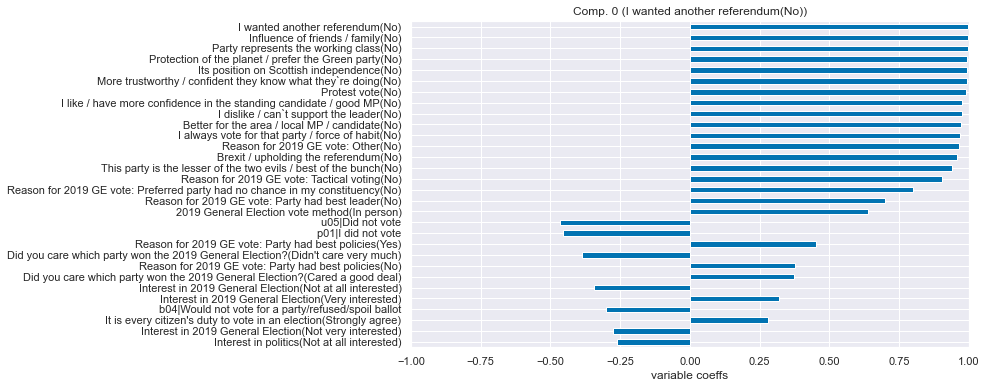

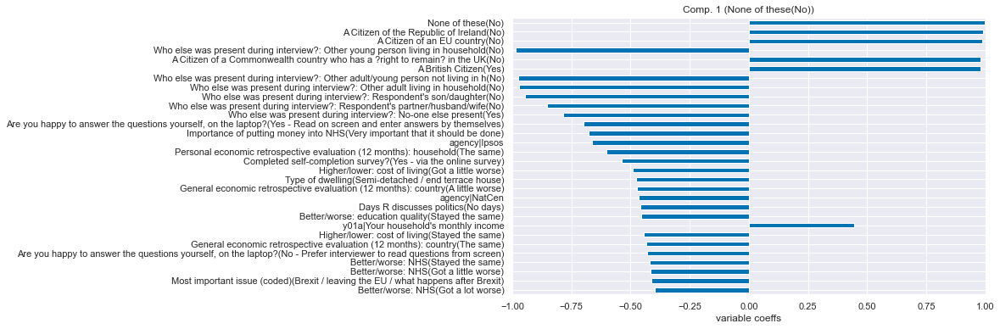

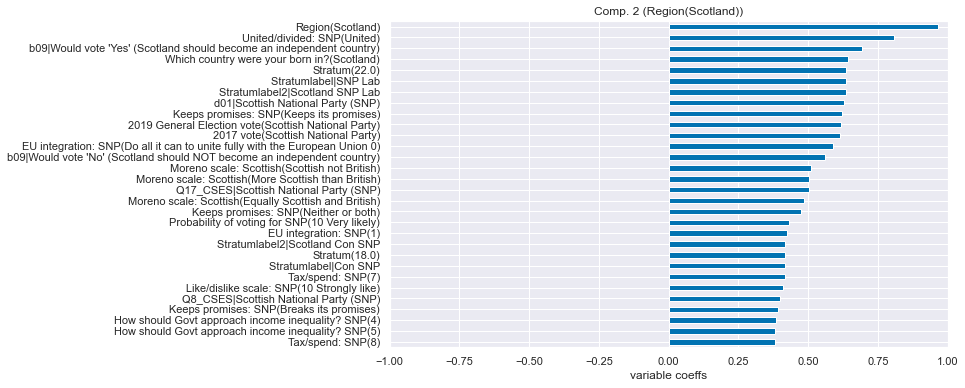

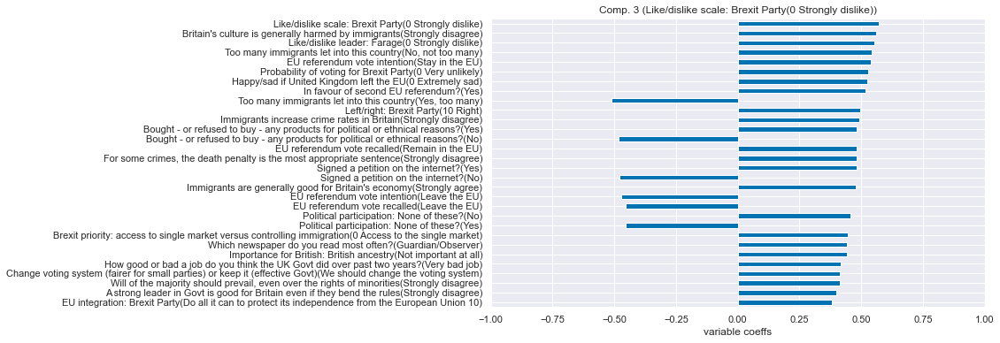

In [375]:
(BES_decomp, comp_labels, comp_dict) = display_components(n_components, decomp,
                                                          decomp_columns, BES_decomp, manifest=None, 
                                                          save_folder = subdir,  
                                                          show_first_x_comps= 10, show_histogram = False)

In [ ]:
##

In [ ]:
# # run_ge_regression(ge,target_var,demo_var_only=True)
# generic_cols = f2f_harmonised.columns
# for ge in ['1987','1992', '1997', '2001', '2005', '2010', '2015',
#        '2017', '2019']:
#     print("***************************")
#     print(ge)
#     print("***************************")
#     print("soc_lib_auth")
#     print("===========================")
#     dict_list = death,toughlaw,censorship,respect
#     run_ge_regression(ge,"soc_lib_auth", demo_var_only=False,drop_vars=[x[ge] for x in dict_list if ge in x.keys()])
#     print("ec_left_right")
#     print("===========================")
#     dict_list = ordinary,rich,strongtu,enterprise
#     run_ge_regression(ge,"ec_left_right",demo_var_only=False,drop_vars=[x[ge] for x in dict_list if ge in x.keys()])
    
    


In [ ]:
# run_ge_regression(ge,"ec_left_right",demo_var_only=True)

AuthRight
***************************
1987
***************************
MSE: 0.17, MAE: 0.34, EV: 0.30, R2: 0.30


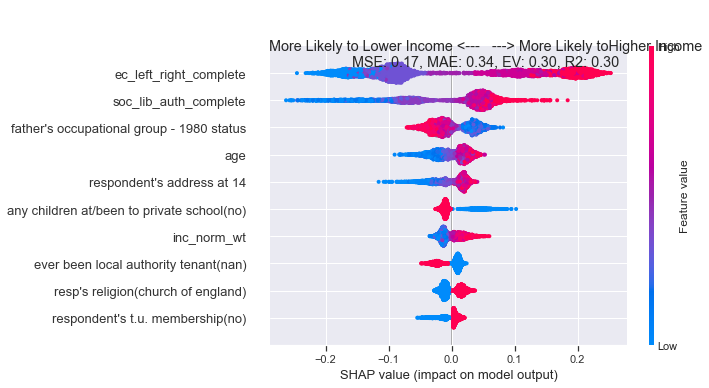

***************************
1992
***************************
MSE: 0.14, MAE: 0.30, EV: 0.38, R2: 0.38


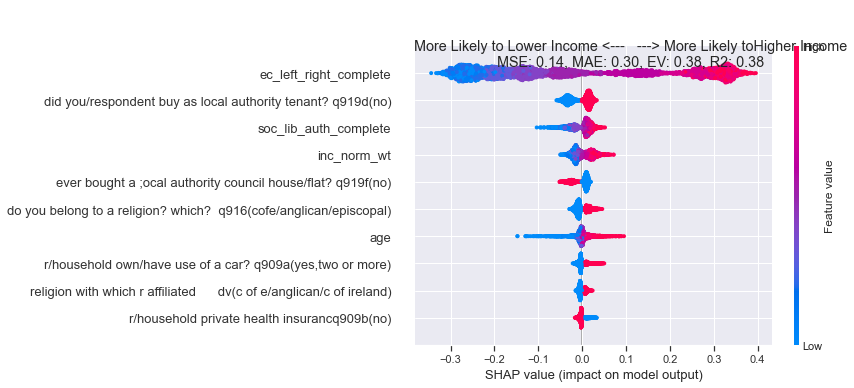

***************************
1997
***************************
MSE: 0.12, MAE: 0.26, EV: 0.30, R2: 0.30


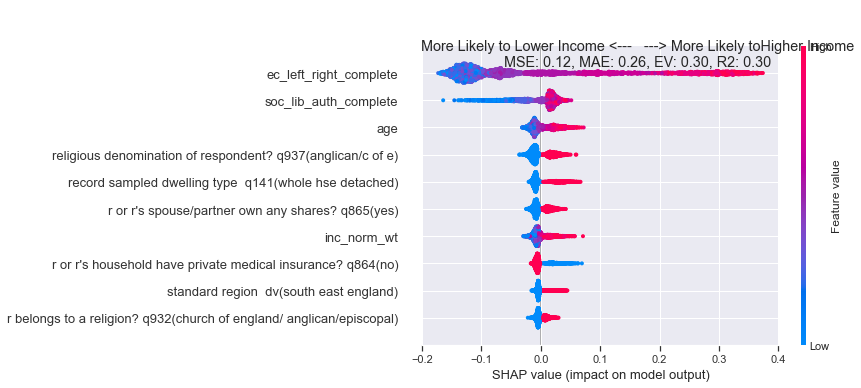

***************************
2001
***************************
MSE: 0.12, MAE: 0.24, EV: 0.21, R2: 0.21


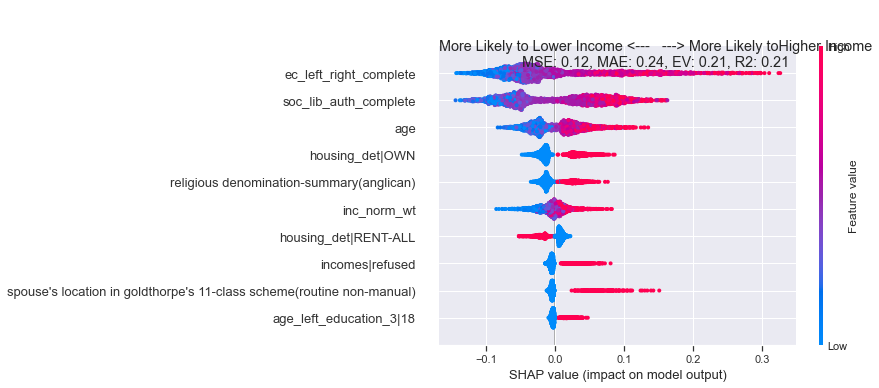

***************************
2005
***************************
MSE: 0.14, MAE: 0.28, EV: 0.19, R2: 0.19


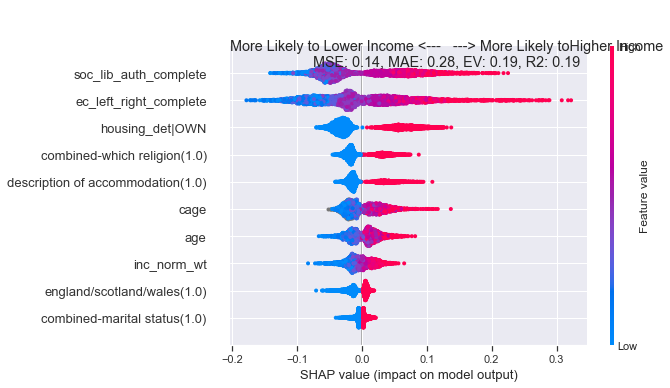

***************************
2010
***************************
MSE: 0.16, MAE: 0.33, EV: 0.24, R2: 0.24


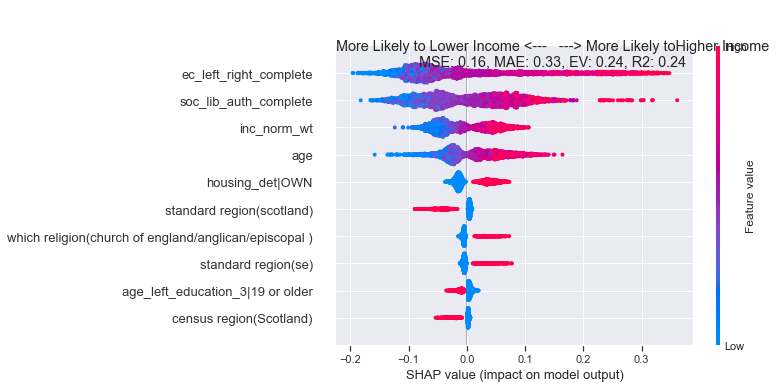

***************************
2015
***************************
MSE: 0.18, MAE: 0.36, EV: 0.23, R2: 0.23


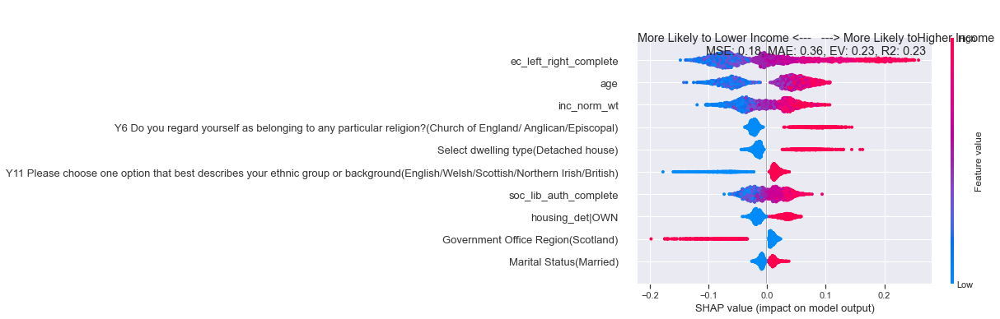

***************************
2017
***************************
MSE: 0.16, MAE: 0.33, EV: 0.28, R2: 0.28


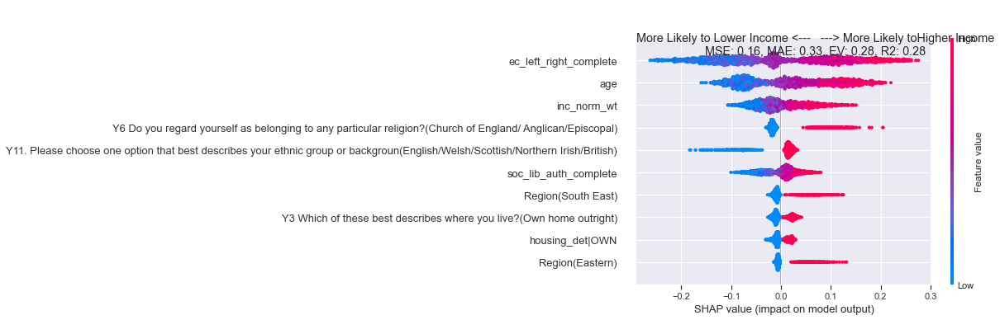

***************************
2019
***************************
MSE: 0.17, MAE: 0.35, EV: 0.27, R2: 0.26


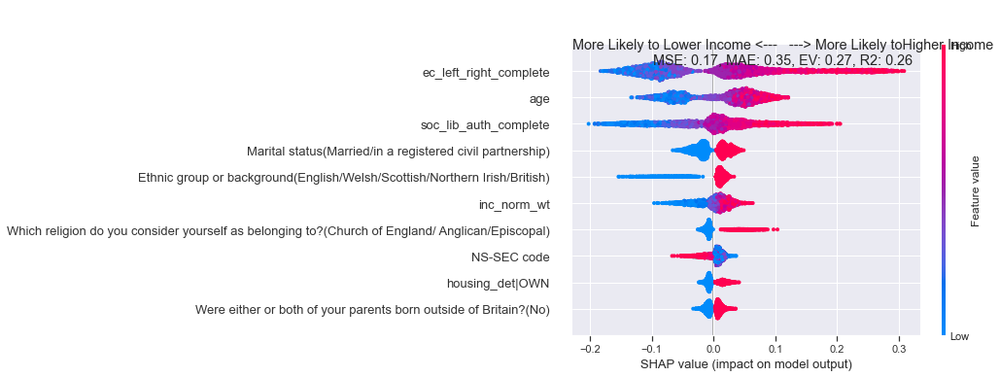

LibLeft
***************************
1987
***************************
MSE: 0.19, MAE: 0.40, EV: 0.22, R2: 0.22


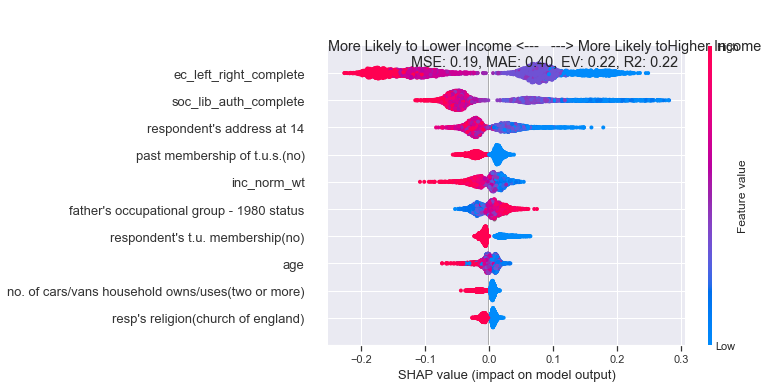

***************************
1992
***************************
MSE: 0.17, MAE: 0.35, EV: 0.31, R2: 0.31


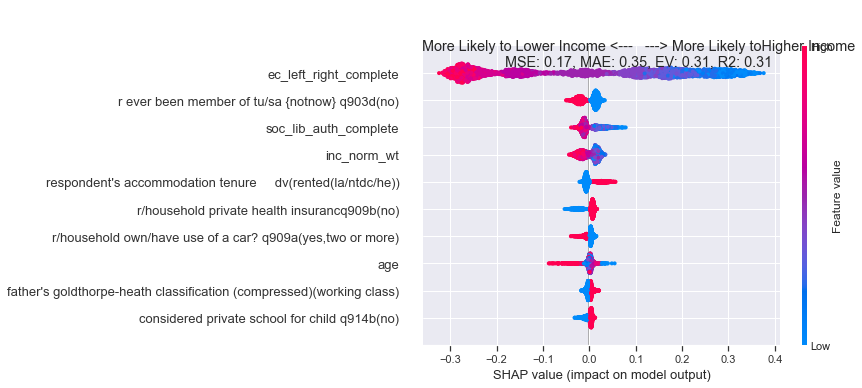

***************************
1997
***************************
MSE: 0.19, MAE: 0.39, EV: 0.21, R2: 0.21


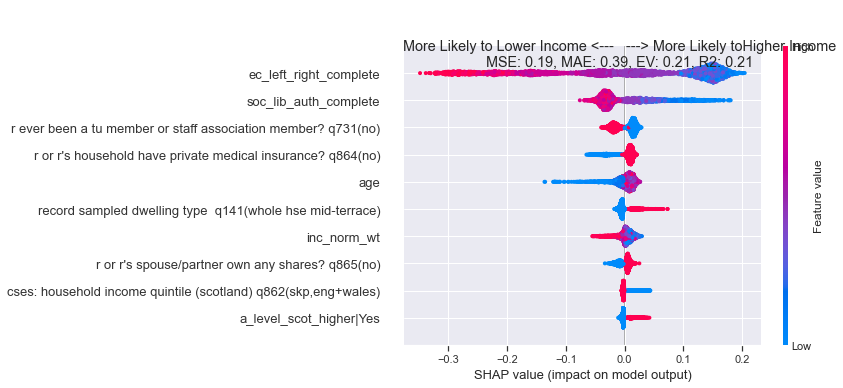

***************************
2001
***************************
MSE: 0.23, MAE: 0.45, EV: 0.09, R2: 0.09


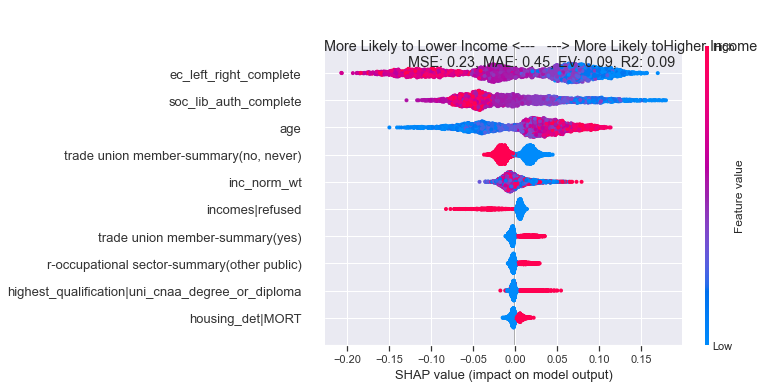

***************************
2005
***************************
MSE: 0.23, MAE: 0.45, EV: 0.09, R2: 0.09


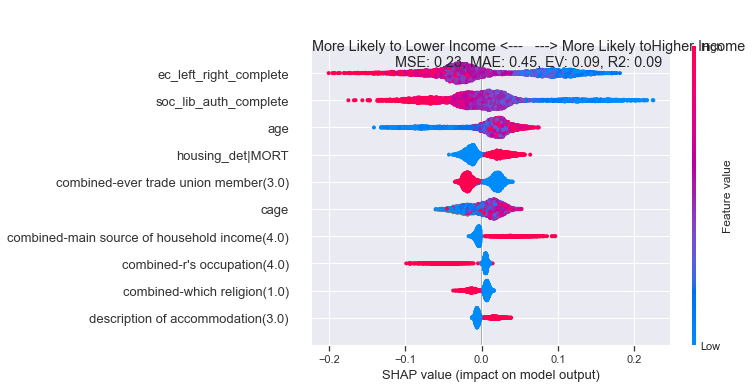

***************************
2010
***************************
MSE: 0.21, MAE: 0.42, EV: 0.16, R2: 0.16


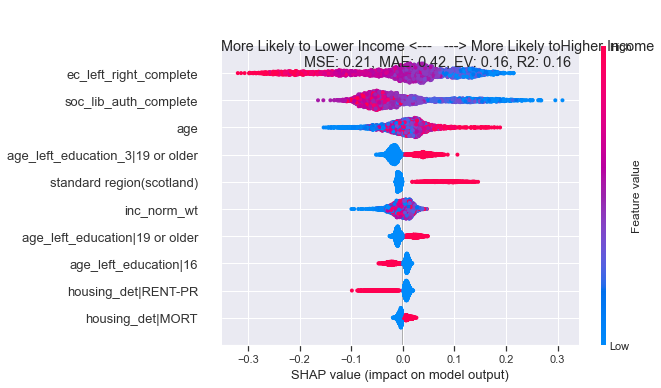

***************************
2015
***************************
MSE: 0.21, MAE: 0.42, EV: 0.09, R2: 0.09


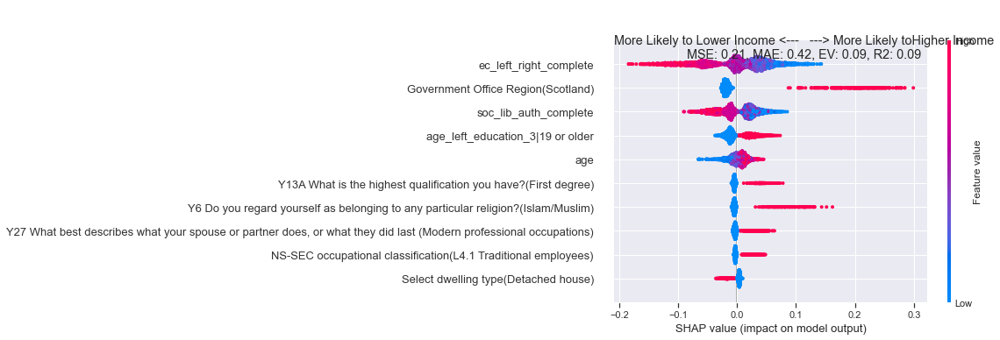

***************************
2017
***************************
MSE: 0.20, MAE: 0.40, EV: 0.18, R2: 0.18


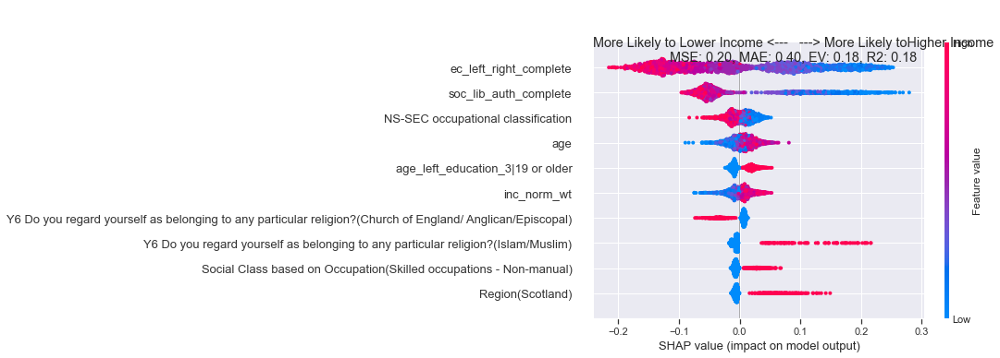

***************************
2019
***************************
MSE: 0.17, MAE: 0.34, EV: 0.32, R2: 0.30


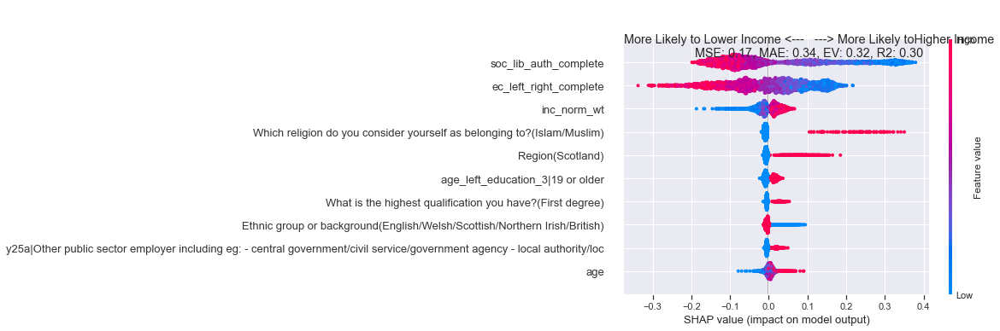

DNV
***************************
1987
***************************
MSE: 0.12, MAE: 0.25, EV: 0.03, R2: 0.02


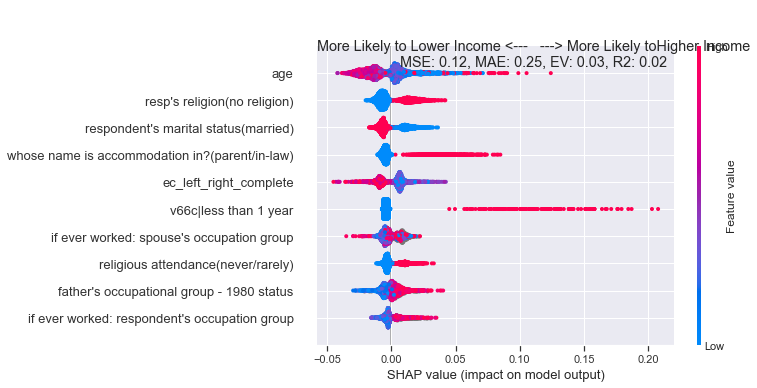

***************************
1992
***************************
MSE: 0.11, MAE: 0.23, EV: 0.03, R2: 0.03


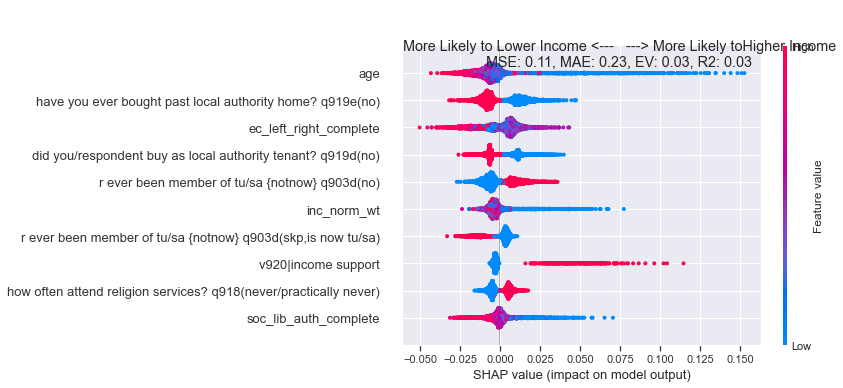

***************************
1997
***************************
MSE: 0.14, MAE: 0.28, EV: 0.08, R2: 0.08


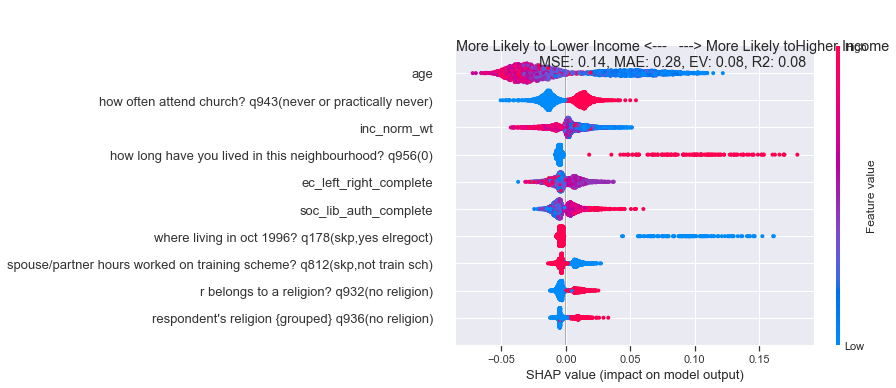

***************************
2001
***************************
MSE: 0.18, MAE: 0.36, EV: 0.09, R2: 0.09


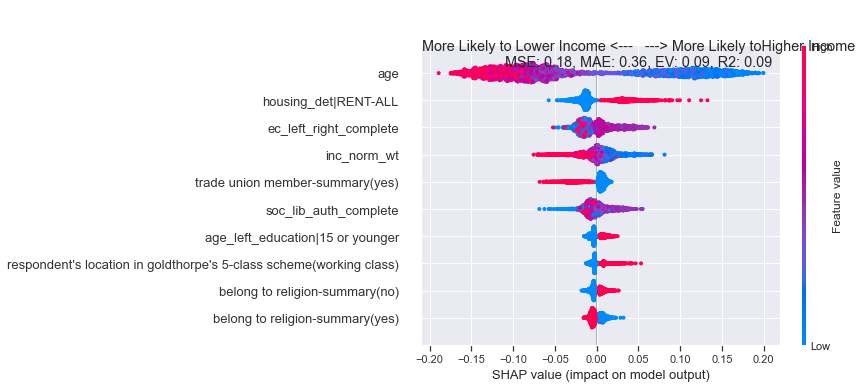

***************************
2005
***************************
MSE: 0.16, MAE: 0.33, EV: 0.16, R2: 0.16


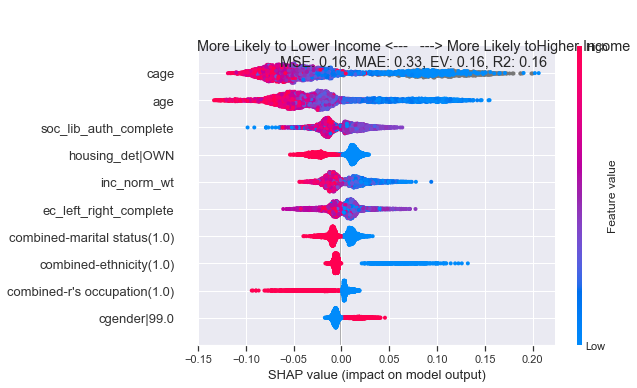

***************************
2010
***************************
MSE: 0.15, MAE: 0.29, EV: 0.13, R2: 0.13


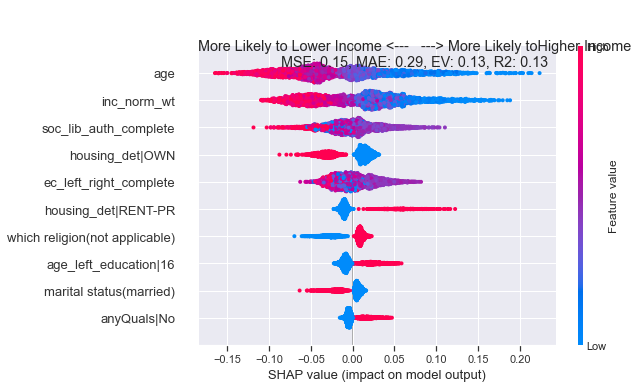

***************************
2015
***************************
MSE: 0.16, MAE: 0.34, EV: 0.18, R2: 0.17


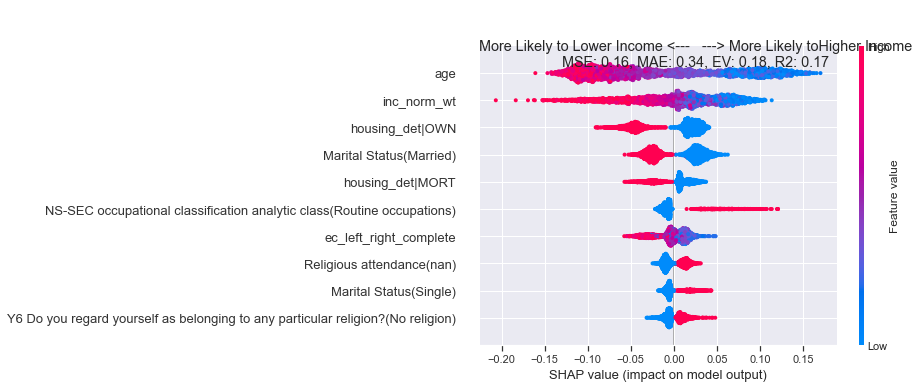

***************************
2017
***************************
MSE: 0.14, MAE: 0.31, EV: 0.18, R2: 0.16


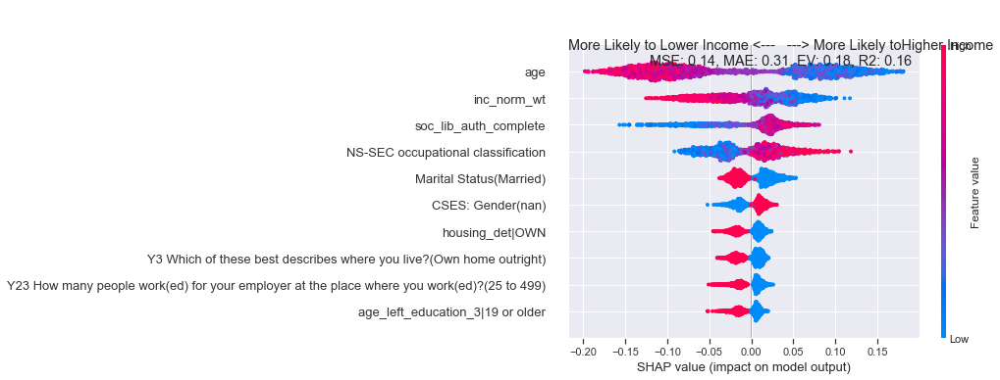

***************************
2019
***************************
MSE: 0.15, MAE: 0.31, EV: 0.09, R2: 0.05


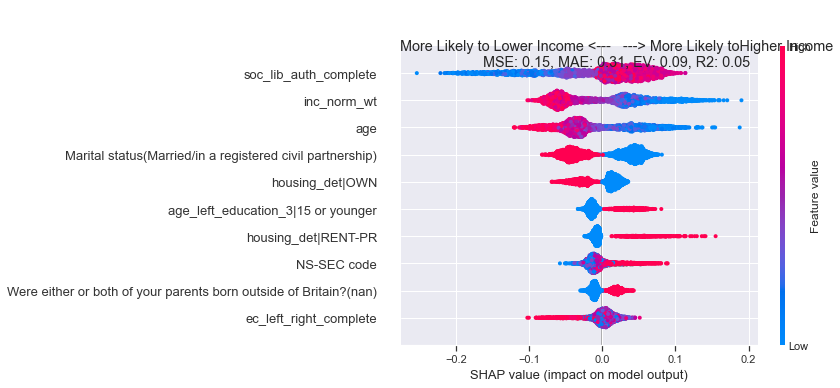

In [286]:
generic_cols = f2f_harmonised.columns
drop_vars = ['y45',
 'y46a',
 'Q24_CSES',
 'y45',
 'y45',
 'bq11a',
 'bq11b',
 'bq11c',
 'bq11d',
 'bq11e',
 'bq11',
 'tq77',
 'tq79a',
 'tq79b',
 'tq79c',
 'bq7',
 'elregon',
 'elregnot',
 'elregtxt','aq65_2',
 'bq93_2',
 'zq93_2',
 'aq50b',
 'bq79b',
 'tq79b',
 'owner91',
 'owner',
 'aq40b',
 'bq74b',
 'morts','aq65_1', 'aq50a', 'bq79a', 'tq79a', 'aq40a', 'bq74a', 'owns', 'v919b','y03','cgender']
for target in ["AuthRight","LibLeft","DNV"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in ['1987','1992', '1997', '2001', '2005', '2010', '2015',
           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars)

In [ ]:
# add harmonised regions for 1974 forwards!

In [380]:
flatten( [([k for k,v in BES_label_list[ge].items() if  re.search("gender",v)]) for ge in f2f_harmonised["dataset"].unique()] )

['aq62',
 'bq88',
 'cq41',
 'zq88',
 'aq69',
 'bq76',
 'tq76',
 'cgender',
 'consex05',
 'labsex05',
 'ldsex05',
 'consex01',
 'labsex01',
 'ldsex01',
 'consex97',
 'ldsex97',
 'labsex97',
 'natsex97',
 'dq66',
 'labsex01',
 'consex01',
 'ldsex01',
 'consex97',
 'labsex97',
 'ldsex97',
 'natsex97',
 'agender',
 'agewgthc',
 'genwgthc',
 'awgtgb',
 'bq104',
 'bagewgt',
 'bgenwgt',
 'bpanwgt',
 'genall',
 'genoctwt',
 'ageoctmw',
 'postoctw',
 'mgenwgt',
 'magewgt',
 'mailwgt',
 'rsexage',
 'arf8b',
 'rsexage']

In [295]:
# f2f_harmonised[["soc_lib_auth","ec_left_right","vote_complete_simple","dataset","wt_norm"]]\
#     .groupby("dataset").apply(lambda x: pd.crosstab(x["soc_lib_auth"],x["vote_complete_simple"],values=x["wt_norm"],aggfunc=sum))

In [405]:

# ge = "2019"
# ge_mask = f2f_harmonised["dataset"]==ge
# df = f2f_harmonised[[val,"vote_complete_simple","wt_norm"]][ge_mask]
# # pd.crosstab(df[val],df["vote_complete_simple"],values=df["wt_norm"],aggfunc=sum)


val = "soc_lib_auth_complete"
soc_lib = f2f_harmonised[[val,"vote_complete_simple","dataset","wt_norm"]].groupby(["vote_complete_simple","dataset"])\
    .apply(lambda x: weighted_mean(list(zip(x[val],x["wt_norm"])))).reset_index()

val = "ec_left_right_complete"
ec_left = f2f_harmonised[[val,"vote_complete_simple","dataset","wt_norm"]].groupby(["vote_complete_simple","dataset"])\
    .apply(lambda x: weighted_mean(list(zip(x[val],x["wt_norm"])))).reset_index()

soc_lib.columns = ["vote","ge","soc_lib_auth"]
soc_lib["ec_left_right"] = ec_left[0]
soc_lib = soc_lib.dropna()

In [407]:
soc_lib["sample_size"] = f2f_harmonised[[val,"vote_complete_simple","dataset"]].dropna().groupby("dataset")["vote_complete_simple"].apply(lambda x: x.value_counts()).loc[soc_lib[["vote","ge"]].apply(lambda x: (x["ge"],x["vote"]),axis=1)].values

In [410]:
temp = f2f_harmonised[["soc_lib_auth_complete","ec_left_right_complete","dataset","wt_norm"]].groupby("dataset")\
    .apply(lambda x: weighted_mean(list(zip(x["soc_lib_auth_complete"],x["wt_norm"])))).reset_index()

temp.columns = ["ge","soc_lib_auth"]

temp["ec_left_right"] = f2f_harmonised[["soc_lib_auth_complete","ec_left_right_complete","dataset","wt_norm"]].groupby("dataset")\
    .apply(lambda x: weighted_mean(list(zip(x["ec_left_right_complete"],x["wt_norm"])))).values

temp = temp.dropna()
temp["vote"] = "ELEC"
temp["sample_size"] = 30000

soc_lib = soc_lib.append(temp)

In [414]:
temp

,ge,soc_lib_auth,ec_left_right,vote,sample_size
8,1987,10.758869,6.102339,ELEC,30000
9,1992,10.542998,6.834754,ELEC,30000
10,1997,10.985752,6.247966,ELEC,30000
11,2001,9.659142,6.310457,ELEC,30000
12,2005,10.241490,6.393737,ELEC,30000
13,2010,9.786895,6.575284,ELEC,30000
14,2015,10.274504,5.968680,ELEC,30000
15,2017,9.968894,6.026436,ELEC,30000
16,2019,9.741418,5.817512,ELEC,30000


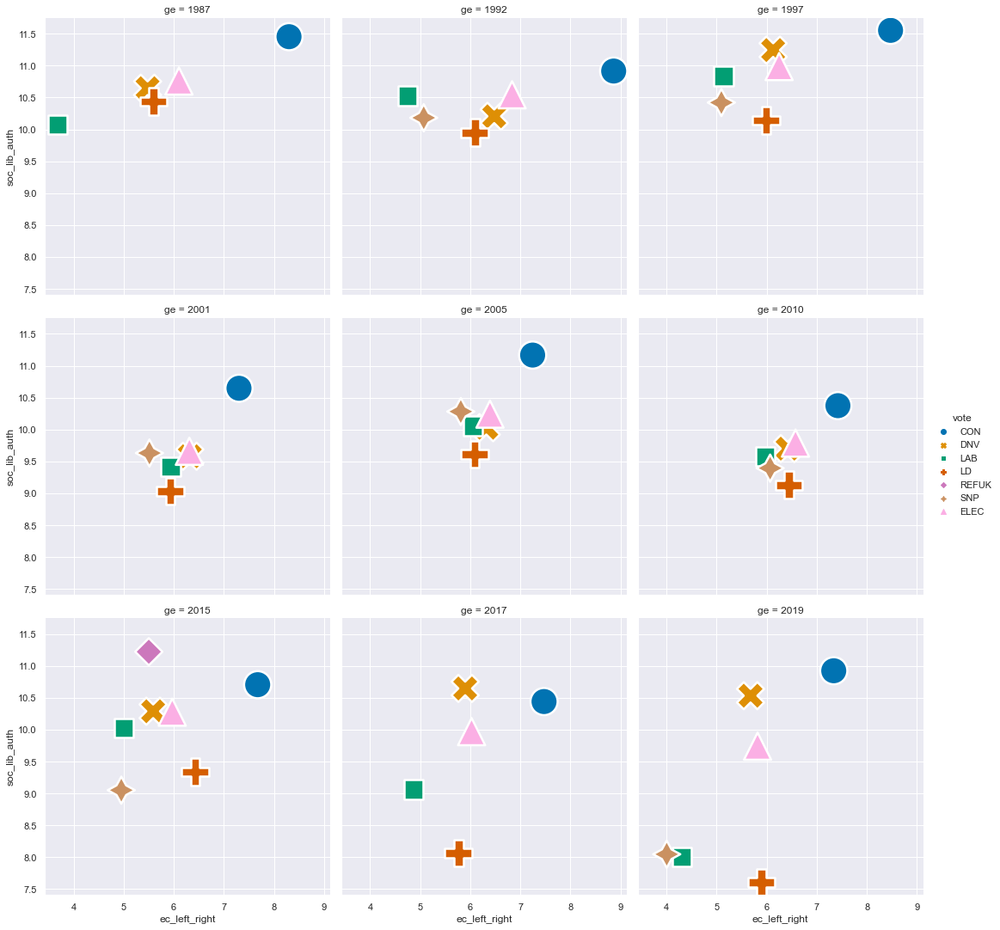

In [413]:
min_sample_size=100
sample_size_mask = soc_lib["sample_size"]>=min_sample_size

sns.relplot(
    data=soc_lib.loc[sample_size_mask], x="ec_left_right", y="soc_lib_auth",
    col="ge", hue="vote", style="vote",
    kind="scatter", col_wrap=3,s=1000,
);

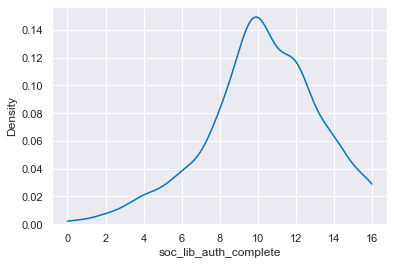

In [422]:
# f2f_harmonised["soc_lib_auth_complete"].hist(bins=10)
sns.kdeplot(f2f_harmonised["soc_lib_auth_complete"],cut=0,bw=.25)

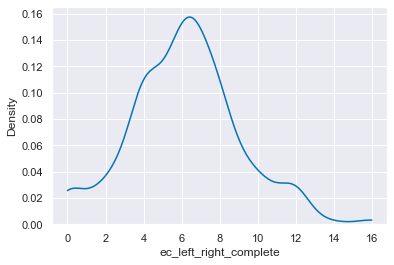

In [423]:
sns.kdeplot(f2f_harmonised["ec_left_right_complete"],cut=0,bw=.25)

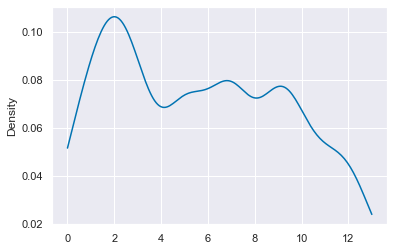

In [440]:
sns.kdeplot( pd.qcut(f2f_harmonised["ec_left_right_complete"],q=20,duplicates='drop').cat.codes.replace(-1,np.nan), bw=.25,cut=0 )

In [437]:
tmp = pd.qcut(f2f_harmonised["ec_left_right_complete"],q=20,duplicates='drop').cat.codes.replace(-1,np.nan)
tmp.value_counts().sort_index()

0.0     1705
1.0     2716
2.0     4074
3.0     2979
4.0      673
5.0     3557
6.0      998
7.0     4031
8.0      524
9.0     3670
10.0    1700
11.0    1314
12.0    2004
13.0     423
dtype: int64

In [438]:
tmp.mean()

5.687104847207587

MSE: 0.17, MAE: 0.34, EV: 0.27, R2: 0.26


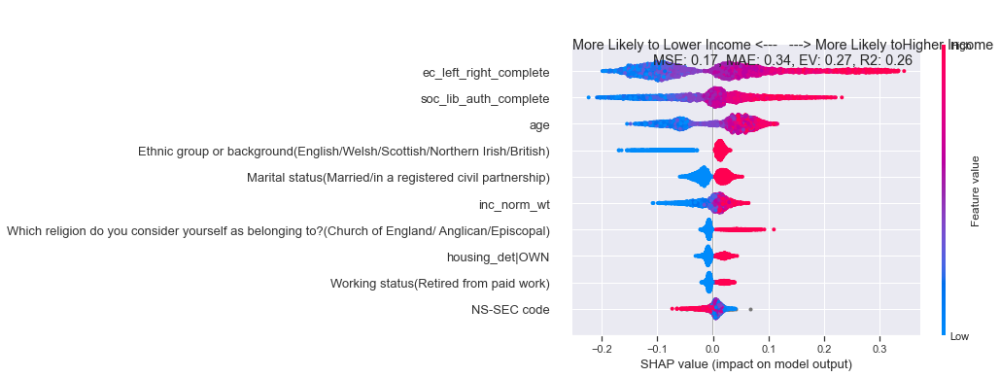

<Figure size 1152x720 with 0 Axes>

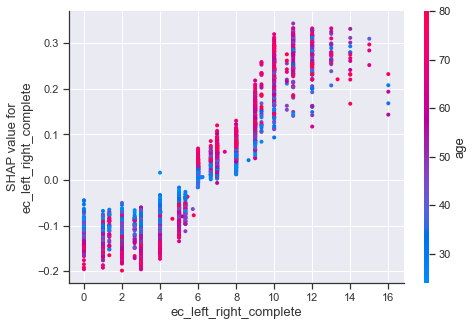

<Figure size 1152x720 with 0 Axes>

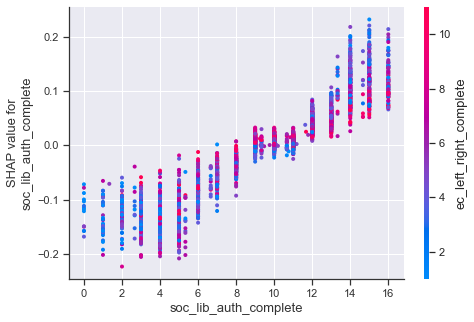

<Figure size 1152x720 with 0 Axes>

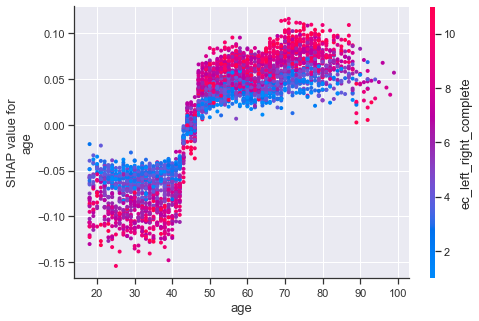

<Figure size 1152x720 with 0 Axes>

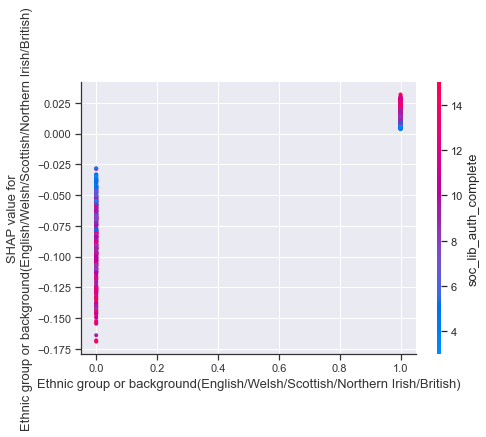

<Figure size 1152x720 with 0 Axes>

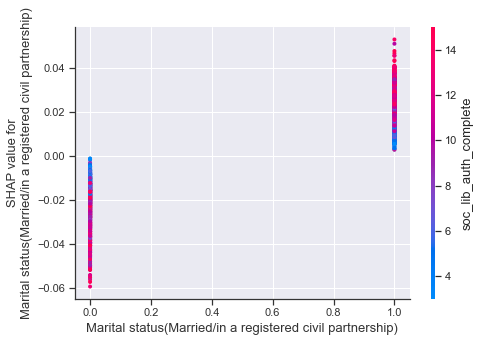

<Figure size 1152x720 with 0 Axes>

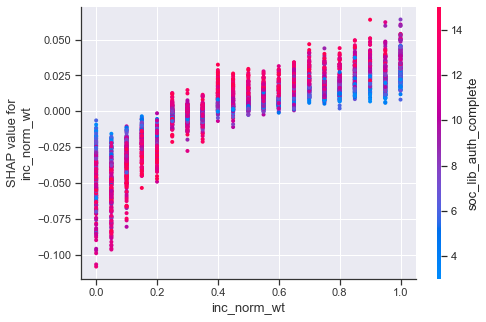

<Figure size 1152x720 with 0 Axes>

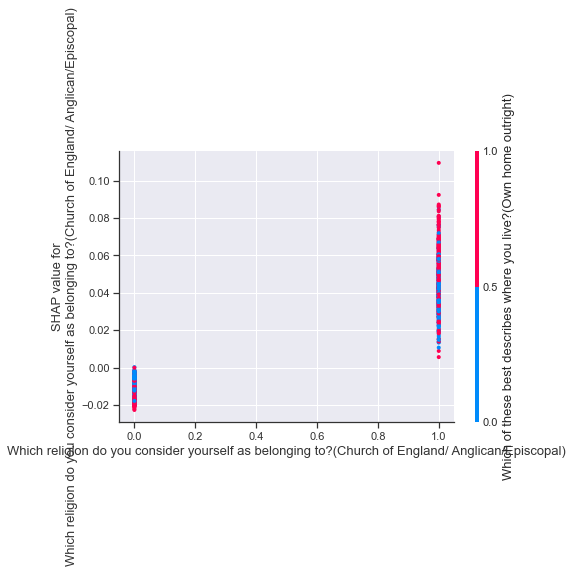

<Figure size 1152x720 with 0 Axes>

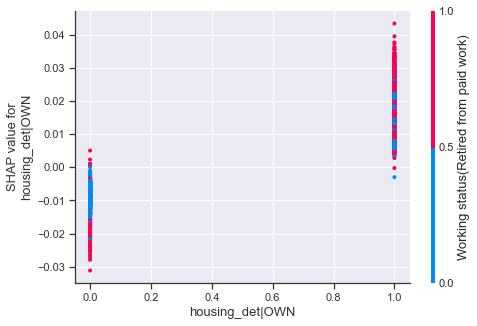

<Figure size 1152x720 with 0 Axes>

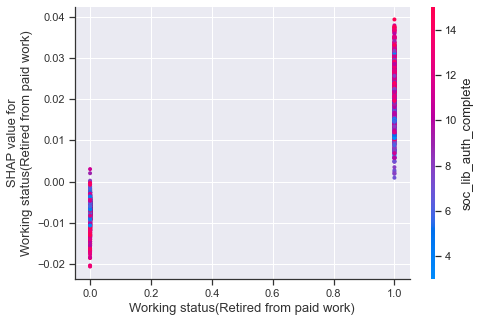

<Figure size 1152x720 with 0 Axes>

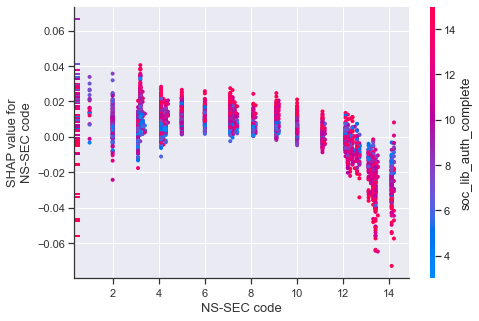

In [385]:
ge = "2019"
target = "AuthRight"
drop_vars = []
run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars,dependence_plots=True)

In [441]:
## try to get value variables

ge = "2019"
harm_vars = ["wt"]
#"wt","age","housing_det","vote_complete","inc_det"
target_var = "wt"
target_var_replace_dict = {}
target_var_drop_list = []
target_var_title_pair = ["Lower Income","Higher Income"]
var_stub = "wt"
min_features = 10
drop_vars = []
drop_std_thresh = 0

alg = get_xgboost_alg(classification_problem=False)

# find variables with no coverage/variation in focal instances (mask)
df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=True,drop_vars=drop_vars,demo_var_only=False)

In [486]:
corrs = df_pred.corrwith(f2f_harmonised[f2f_harmonised["dataset"]==ge]["soc_lib_auth_complete"])

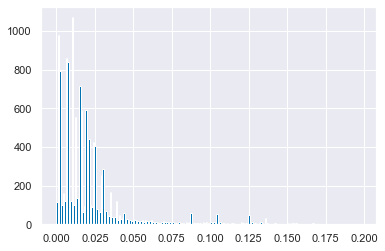

In [449]:
corrs.abs()[corrs.abs()<.2].hist(bins=200)

In [500]:
pd.Series([x.split("(")[0].split("|")[0] for x in corrs[corrs.abs()>.17].sort_values().index if x.split("(")[0].split("|")[0] not in political_vars]).value_counts()

Young people today don't have enough respect for traditional British values         5
Censorship of films and magazines is necessary to uphold moral standards            4
People who break the law should be given stiffer sentences                          4
If welfare wasn't so generous, people would learn to stand on their own two feet    3
Govt spend less on foreign aid?                                                     3
Gone too far: equality for gay and lesbian people                                   2
Importance for British: Follow customs and traditions                               2
Importance for British: Born here                                                   2
Change voting system                                                                2
Gone too far: equality for black and Asian people                                   2
Minorities should adapt to customs and traditions of Britain                        2
Too many immigrants let into this country             

In [459]:
corrs = df_pred.corrwith(f2f_harmonised[f2f_harmonised["dataset"]==ge]["AuthRight"])

In [479]:
auth_right_corrs = pd.Series([x.split("(")[0].split("|")[0] for x in corrs[corrs.abs()>.35].sort_values().index]).value_counts().index

In [472]:
corrs = df_pred.corrwith(f2f_harmonised[f2f_harmonised["dataset"]==ge]["LibLeft"])

In [484]:
lib_left_corrs = pd.Series([x.split("(")[0].split("|")[0] for x in corrs[corrs.abs()>.35].sort_values().index]).value_counts().index

In [ ]:
# Too many immigrants let into this country

In [499]:
political_vars = list(set(list(auth_right_corrs)+list(lib_left_corrs)))
political_vars.remove("Too many immigrants let into this country")
political_vars = political_vars + ["Bought - or refused to buy - any products for political or ethnical reasons?",
                                  "Signed a petition on the internet?",
                                  "Taken part in a public demonstration?",
                                  "What is the highest qualification you have?",
                                  "Education level ","Education level",
                                  "Political participation: None of these?",
                                  "Brexit priority: access to single market versus controlling immigration",
                                  "Given any money to a political party, organisation or cause?",
                                  "Tax/spend: Brexit Party",
                                  "Left-right self-placement",
                                  "Which newspaper do you read most often?",
                                  "How good or bad a job do you think the UK Govt did over past two years?",
                                  "NS-SEC code ","NS-SEC code",
                                  "Left/right: Brexit Party",
                                  "EU integration: Brexit Party",
                                  "Probability of voting for Brexit Party",
                                  "Tax/spend: Conservative Party",
                                  "Like/dislike leader: Corbyn",
                                  "Like/dislike scale: Greens",
                                  "Conservatives look after interests of trade unions",
                                  "Conservatives look after interests of black people and Asians",
                                  "Interest in 2019 General Election",
                                  "Interest in politics",
                                  "Knowledge: the UK uses proportional representation for general elections",
                                  "Subjective class",
                                  "Subjective class of family growing up?",
                                  "Do you regard yourself as belonging to any particular religion?",
                                  "Do you have any educational or work-related qualifications?",
                                  "Do you use Twitter?",
                                  "Which religion do you consider yourself as belonging to?",
                                  "Labour look after interests of middle class",  
                                  "Religious attendance",
                                  "Best party on most important issue",
                                  "Like/dislike scale: Labour", 
                                  "United/divided: Liberal Democrats",

                                  ]

In [ ]:
## load extra harmonised variables

In [38]:
region = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\region.zip", compression='zip')
subjClass = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\subjClass.zip", compression='zip')
tumember = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\tumember.zip", compression='zip')
married = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\married_cols.zip", compression='zip')
ethnic = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\ethnic_cols.zip", compression='zip')
relig = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\relig_cols.zip", compression='zip')

In [39]:
f2f_harmonised[region.columns+"_harm"] = region.apply(lambda x: x.astype('category'))
f2f_harmonised[subjClass.columns] = subjClass#.apply(lambda x: x.astype('category'))
f2f_harmonised[tumember.columns] = tumember.apply(lambda x: x.astype('category'))
f2f_harmonised[married.columns] = married.apply(lambda x: x.astype('category'))
f2f_harmonised[ethnic.columns] = ethnic.apply(lambda x: x.astype('category'))
f2f_harmonised[relig.columns] = relig.apply(lambda x: x.astype('category'))

In [40]:
# f2f_harmonised[relig.columns[0]].cat.set_categories(f2f_harmonised[relig.columns[0]].value_counts().index, ordered=True)
var_list = [region.columns+"_harm"] + [tumember.columns] + [married.columns] + [ethnic.columns] + [relig.columns]
var_list = flatten(var_list)
f2f_harmonised[var_list] = f2f_harmonised[var_list].apply(lambda x: 
                            x.cat.reorder_categories( list(f2f_harmonised[x.name].value_counts().index), ordered=True))
# var_list

In [13]:
f2f_harmonised[var_list[5]].value_counts()

WhiteBritish        20541
WhiteEuropean       12811
White                7393
WhiteOther            437
AsianIndian           398
Other                 242
AsianPakistani        219
BlackAfrican          219
WhiteIrish            170
BlackCaribbean        162
AsianOther             86
Black                  84
AsianBangladeshi       76
MixedOther             65
White&Asian            65
Asian                  63
White&BlackCarib       59
Coloured               56
AsianChinese           54
BlackAfric&Carib       40
White&BlackAfric       33
AsianSouth             33
BlackOther             28
AsianArab              19
OtherIncChinese        10
WhiteGypsy              6
WhitePolish             5
AsianEast               2
PossNonCaucasian        1
Name: ethnic_det, dtype: int64

In [41]:
generic_cols = f2f_harmonised.columns
harm_vars = ["wt","age","housing_det",
#                                   "inc_det","inc",
                 #,"bloc_complete"
#                  'gender', 
                                  'gender_complete', 'age_left_education',
#            'age_left_education_2', 
                                  'age_left_education_3', 'anyQuals',
           'rsa_or_city_and_guilds', 'overseas_other_postschl', 'overseas_degree',
           'other_academic_vocational', 'other_tech_business',
           'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
           'trade_appenticeship', 'nursing', 'teachers_training',
           'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
           'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
           'rsa_other_commercial', 'school_cert_or_matric',
           'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
           'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
           'professional_qualification', 'spec_qual_gained_at_work',
           'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
           'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5', 
           'att_university', 'att_commercial_training',
           'att_polytech_or_techcollege', 'att_night_school',
           'att_non_voc_training', 'att_other', 'att_art_school',
           'att_college_of_commerce', 'att_teacher_training',
           'att_trade_military_apprent', 'att_tech_college_teacher_nursing',
           'att_tech_or_occ_training', 'att_summer_schl_corresp_courses',
           'att_NoFE', 'att_forces_training', 'school_type', 'school_selective',
           'school_fees', 'school_fees_when', 'school_where', 'school_type_2','inc_norm_wt',
           'region_harm',  'tumember',
           'tumember_det', 'marital', 'marital_det','ethnic_det','relig_det',
#               'ec_left_right_complete','soc_lib_auth_complete','subjClass'
            ]

ed_vars = ['anyQuals', 'rsa_or_city_and_guilds', 'overseas_other_postschl',
       'overseas_degree', 'other_academic_vocational', 'other_tech_business',
       'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
       'trade_appenticeship', 'nursing', 'teachers_training',
       'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
       'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
       'rsa_other_commercial', 'school_cert_or_matric',
       'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
       'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
       'professional_qualification', 'spec_qual_gained_at_work',
       'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
       'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5',
       'att_university', 'att_commercial_training',
       'att_polytech_or_techcollege', 'att_night_school',
       'att_non_voc_training', 'att_other', 'att_art_school',
       'att_college_of_commerce', 'att_teacher_training',
       'att_trade_military_apprent', 'att_tech_college_teacher_nursing',
       'att_tech_or_occ_training', 'att_summer_schl_corresp_courses',
       'att_NoFE', 'att_forces_training', 'school_type', 'school_selective',
       'school_fees', 'school_fees_when', 'school_where', 'school_type_2']
f2f_harmonised[ ed_vars ] = f2f_harmonised[ ed_vars ].astype('category')

AuthRight
***************************
1959
***************************
MSE: 0.18, MAE: 0.36, EV: 0.22, R2: 0.21


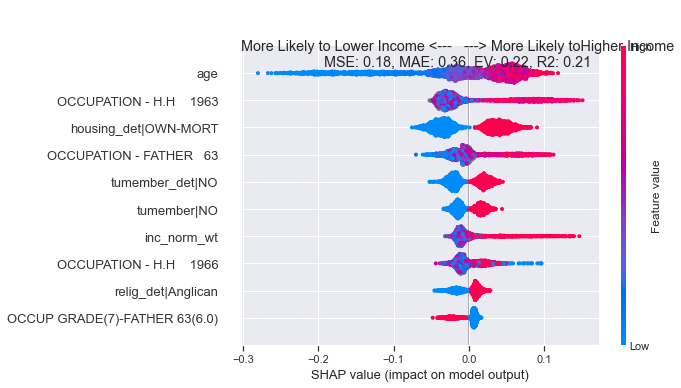

***************************
1964
***************************
MSE: 0.19, MAE: 0.40, EV: 0.19, R2: 0.19


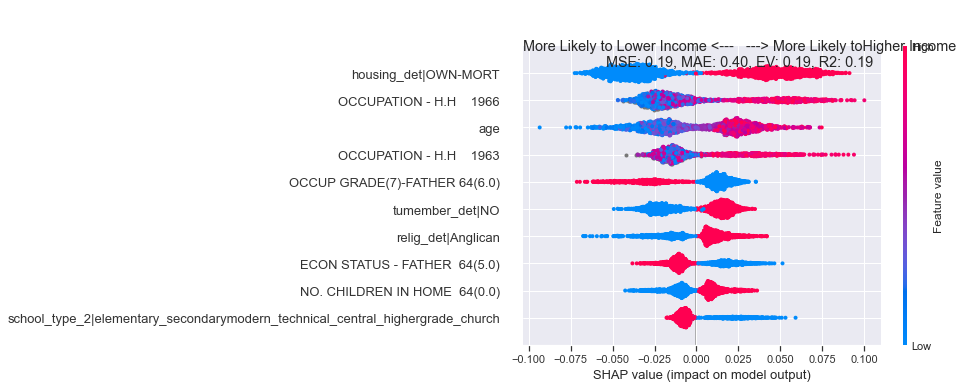

***************************
1966
***************************
MSE: 0.19, MAE: 0.39, EV: 0.16, R2: 0.16


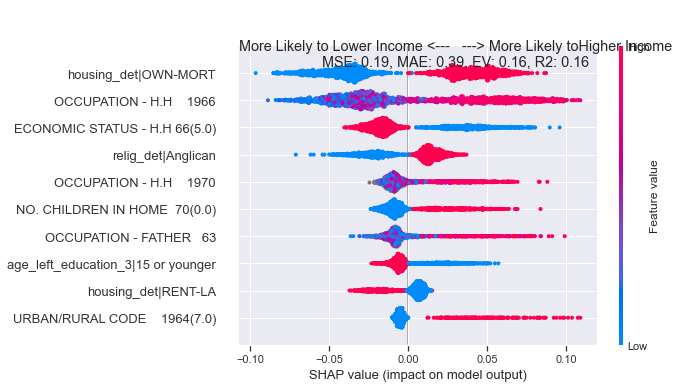

***************************
1970
***************************
MSE: 0.22, MAE: 0.44, EV: 0.08, R2: 0.08


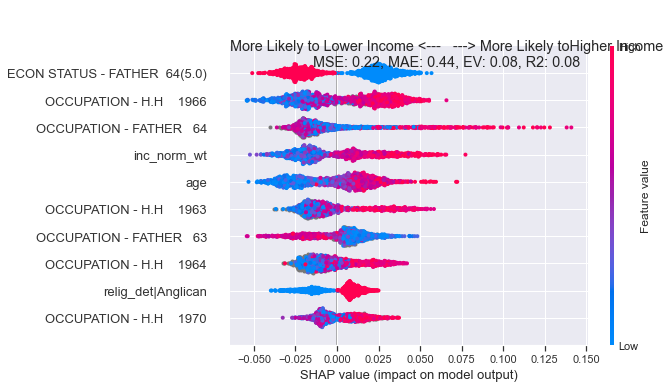

***************************
1974_oct
***************************
MSE: 0.18, MAE: 0.37, EV: 0.14, R2: 0.14


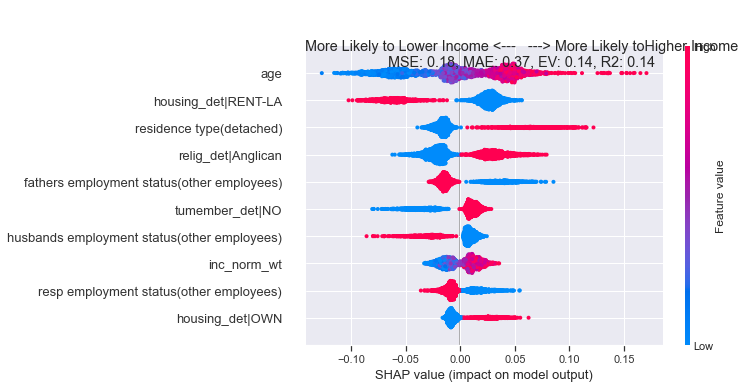

***************************
1974_feb
***************************
MSE: 0.19, MAE: 0.38, EV: 0.15, R2: 0.14


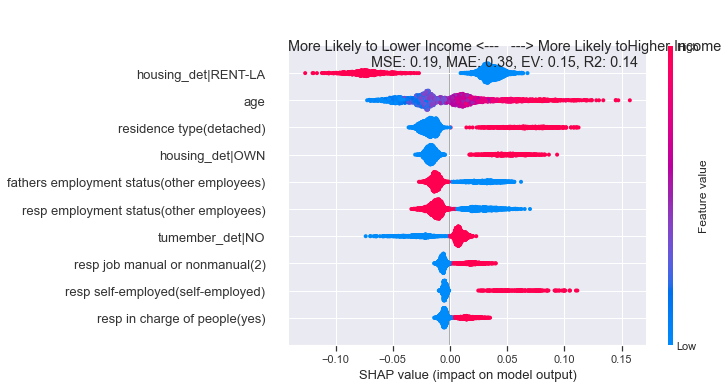

***************************
1979
***************************
MSE: 0.21, MAE: 0.41, EV: 0.14, R2: 0.13


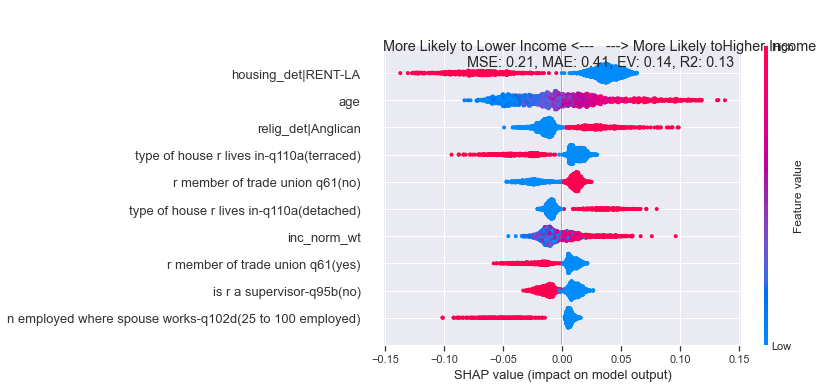

***************************
1983
***************************
MSE: 0.20, MAE: 0.41, EV: 0.13, R2: 0.13


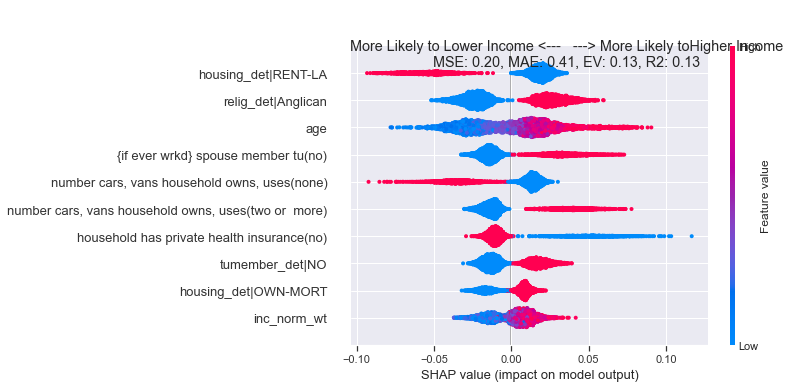

***************************
1987
***************************
MSE: 0.19, MAE: 0.38, EV: 0.21, R2: 0.21


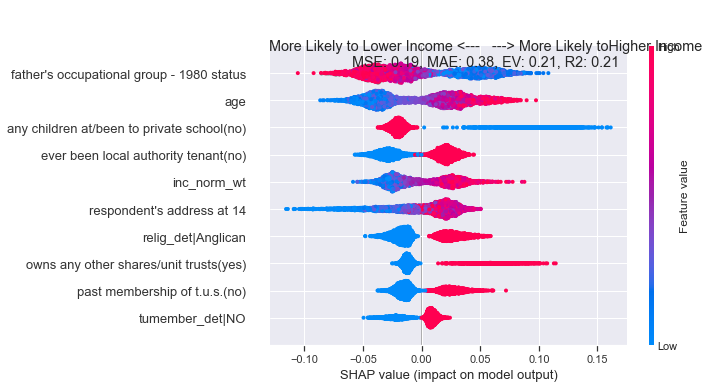

***************************
1992
***************************
MSE: 0.18, MAE: 0.37, EV: 0.22, R2: 0.22


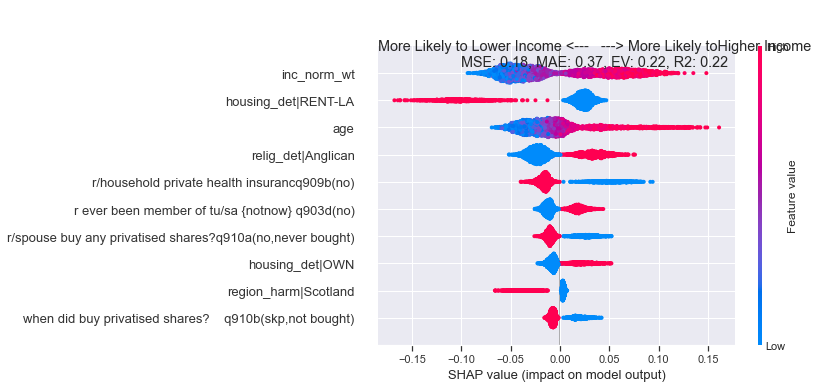

***************************
1997
***************************
MSE: 0.15, MAE: 0.30, EV: 0.16, R2: 0.16


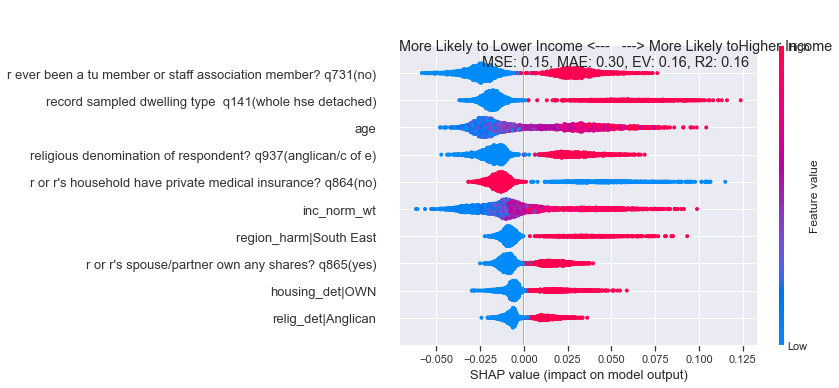

***************************
2001
***************************
MSE: 0.13, MAE: 0.28, EV: 0.12, R2: 0.11


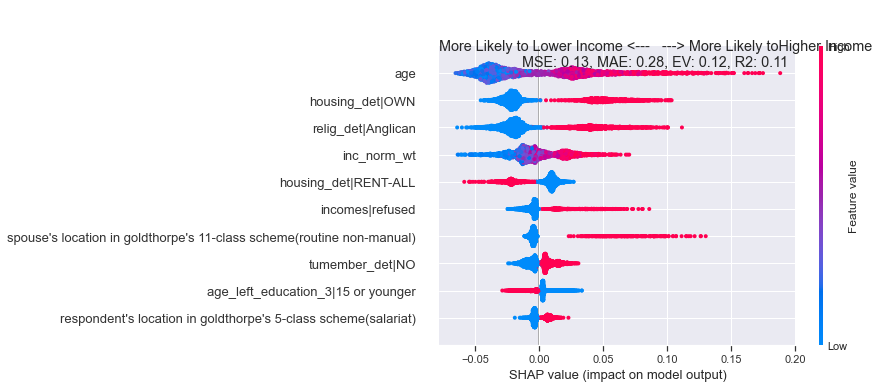

***************************
2005
***************************
MSE: 0.15, MAE: 0.31, EV: 0.14, R2: 0.14


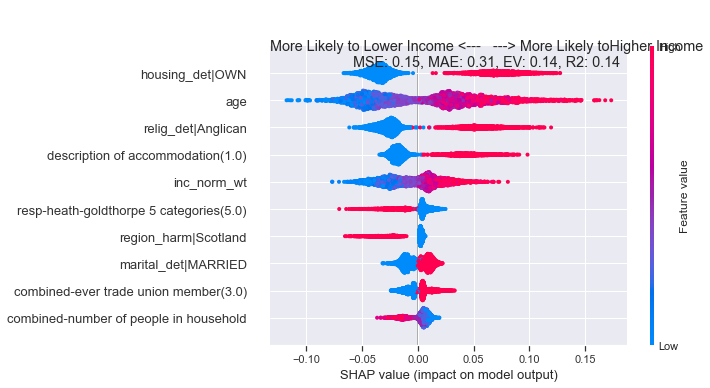

***************************
2010
***************************
MSE: 0.18, MAE: 0.37, EV: 0.13, R2: 0.13


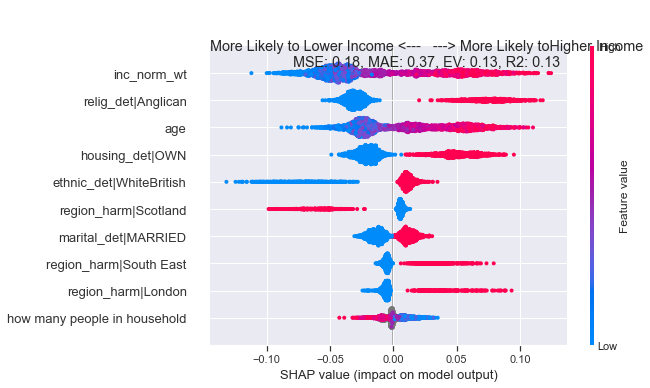

***************************
2015
***************************
MSE: 0.19, MAE: 0.39, EV: 0.17, R2: 0.17


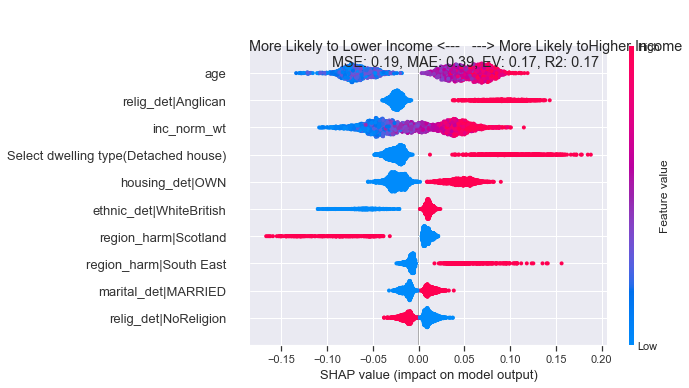

***************************
2017
***************************
MSE: 0.19, MAE: 0.38, EV: 0.17, R2: 0.17


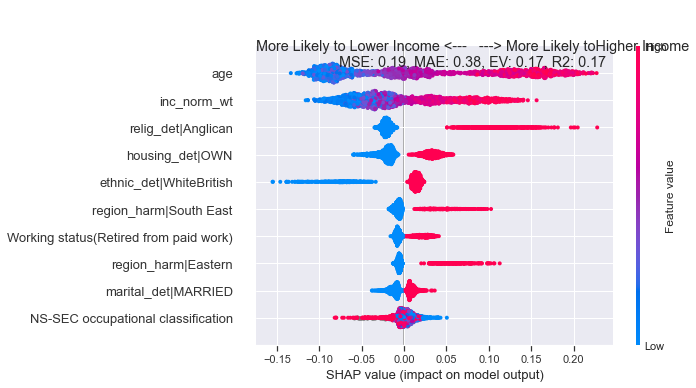

***************************
2019
***************************
MSE: 0.20, MAE: 0.38, EV: 0.17, R2: 0.16


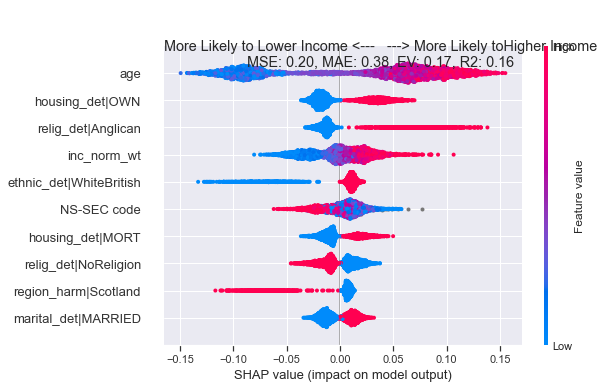

LibLeft
***************************
1959
***************************
MSE: 0.18, MAE: 0.36, EV: 0.22, R2: 0.22


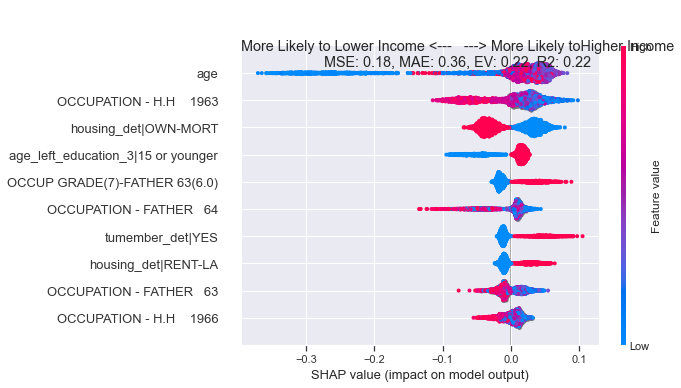

***************************
1964
***************************
MSE: 0.21, MAE: 0.42, EV: 0.15, R2: 0.15


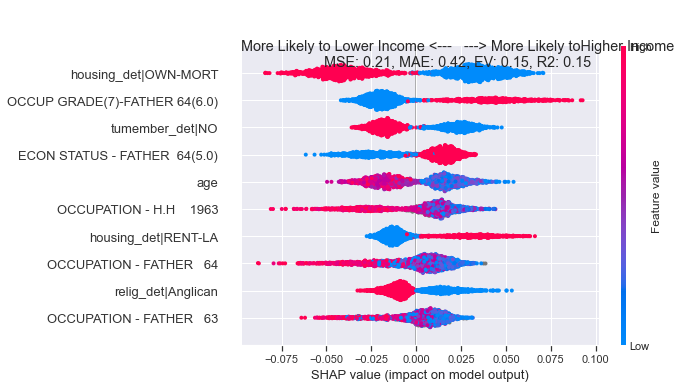

***************************
1966
***************************
MSE: 0.23, MAE: 0.45, EV: 0.10, R2: 0.10


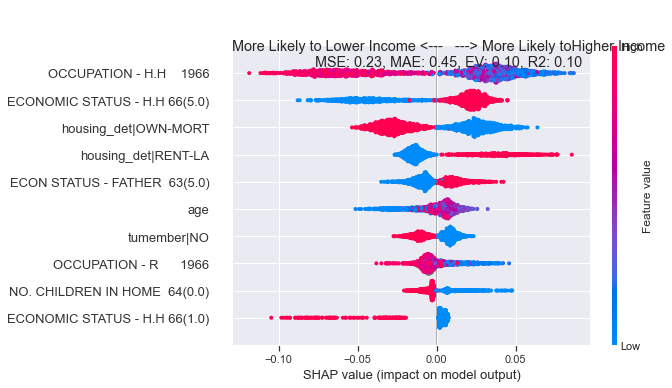

***************************
1970
***************************
MSE: 0.22, MAE: 0.43, EV: 0.09, R2: 0.09


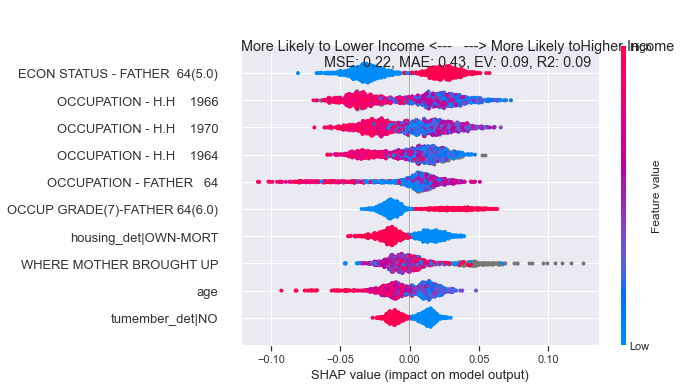

***************************
1974_oct
***************************
MSE: 0.22, MAE: 0.45, EV: 0.12, R2: 0.12


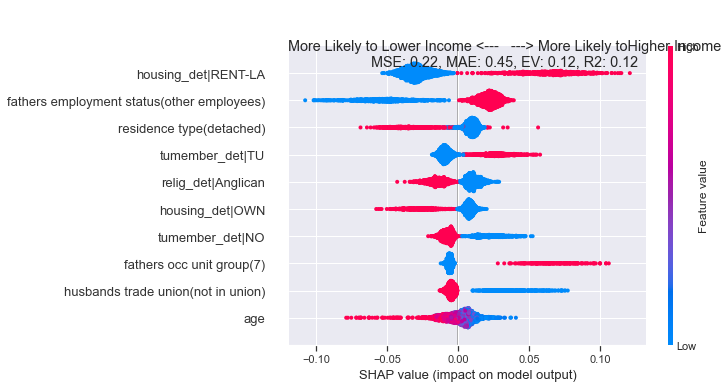

***************************
1974_feb
***************************
MSE: 0.22, MAE: 0.43, EV: 0.13, R2: 0.13


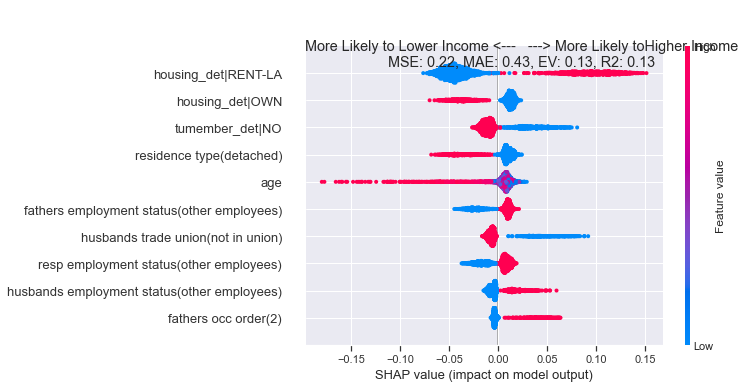

***************************
1979
***************************
MSE: 0.23, MAE: 0.46, EV: 0.07, R2: 0.07


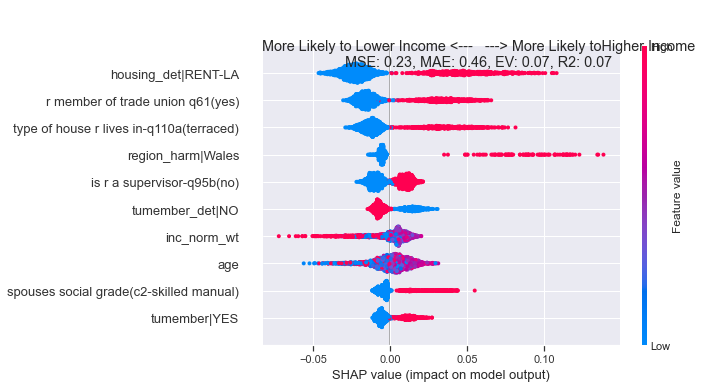

***************************
1983
***************************
MSE: 0.23, MAE: 0.44, EV: 0.08, R2: 0.08


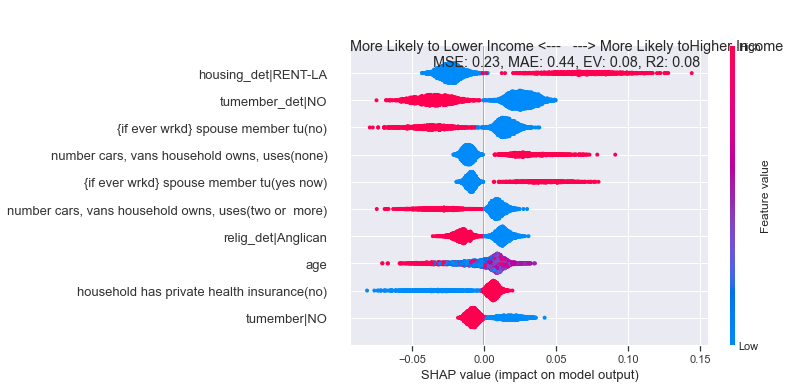

***************************
1987
***************************
MSE: 0.22, MAE: 0.44, EV: 0.13, R2: 0.13


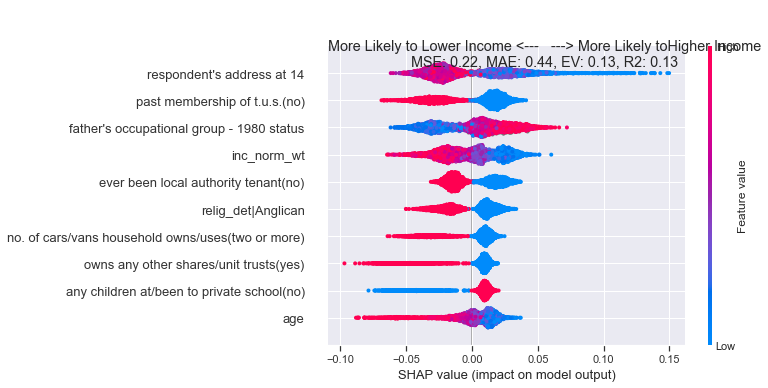

***************************
1992
***************************
MSE: 0.21, MAE: 0.42, EV: 0.15, R2: 0.15


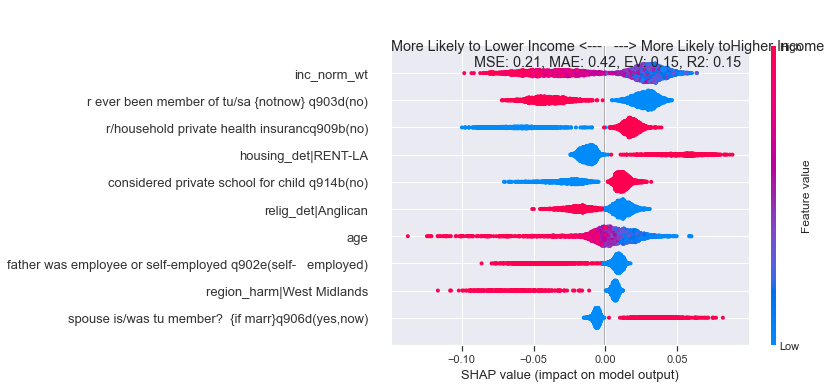

***************************
1997
***************************
MSE: 0.22, MAE: 0.44, EV: 0.09, R2: 0.09


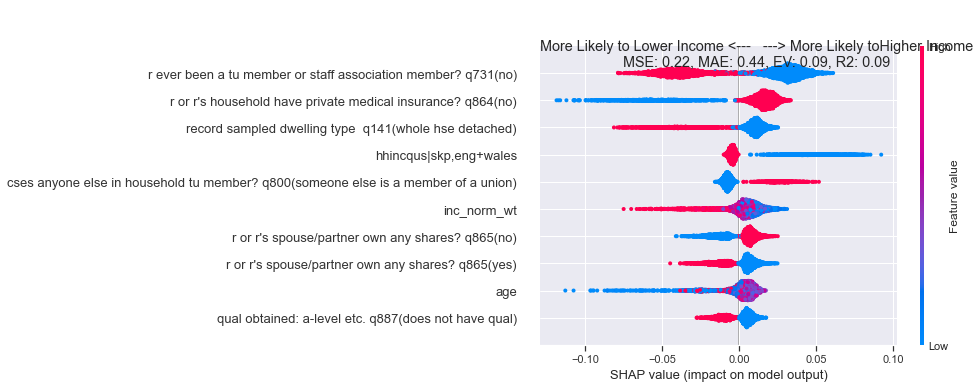

***************************
2001
***************************
MSE: 0.24, MAE: 0.48, EV: 0.04, R2: 0.04


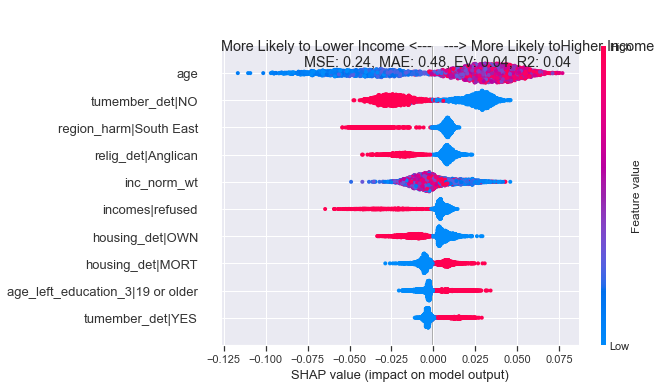

***************************
2005
***************************
MSE: 0.24, MAE: 0.46, EV: 0.05, R2: 0.05


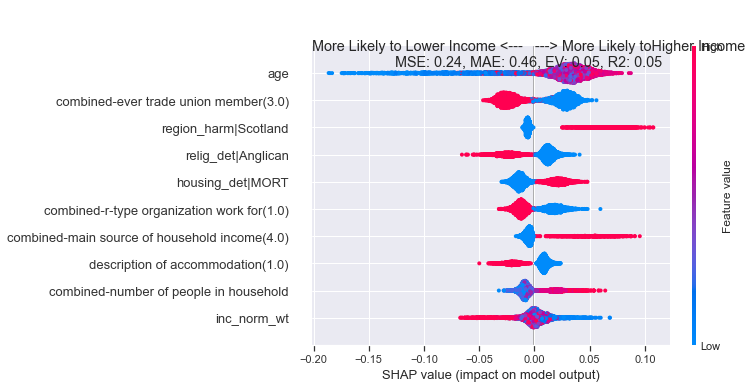

***************************
2010
***************************
MSE: 0.23, MAE: 0.46, EV: 0.09, R2: 0.09


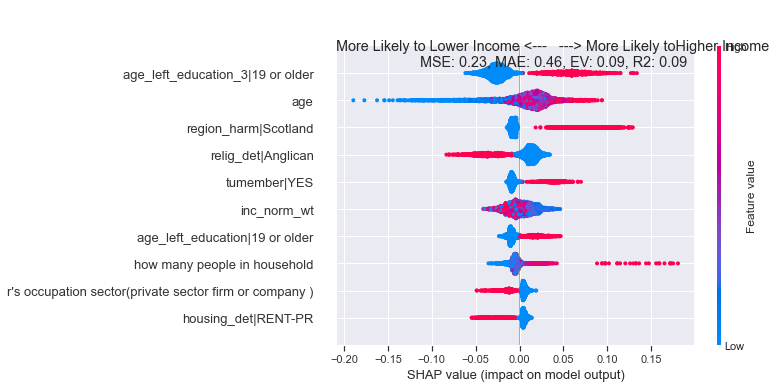

***************************
2015
***************************
MSE: 0.22, MAE: 0.44, EV: 0.05, R2: 0.05


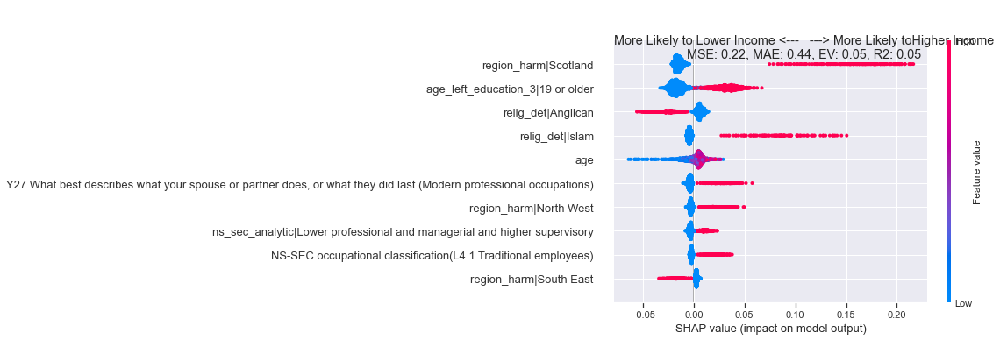

***************************
2017
***************************
MSE: 0.22, MAE: 0.44, EV: 0.10, R2: 0.09


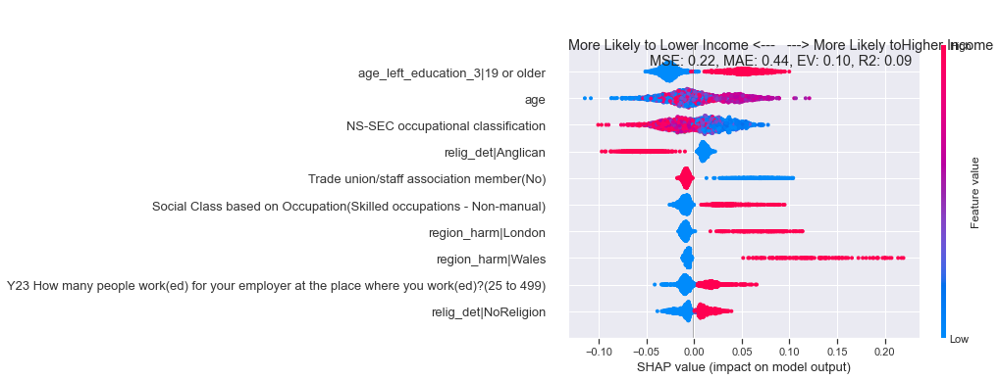

***************************
2019
***************************
MSE: 0.20, MAE: 0.40, EV: 0.17, R2: 0.16


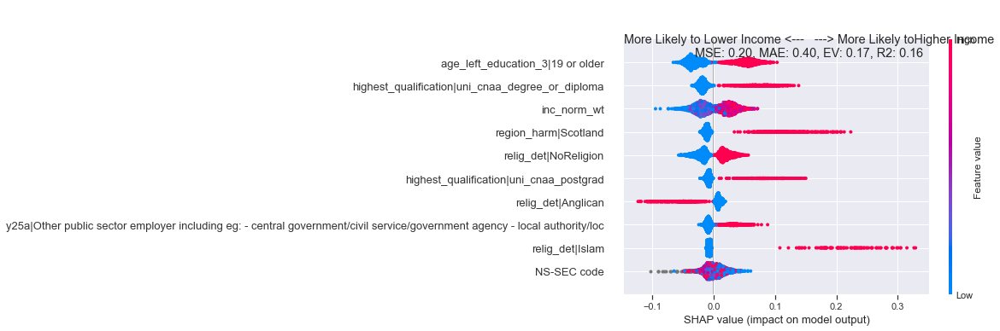

DNV
***************************
1959
***************************
MSE: 0.11, MAE: 0.22, EV: 0.11, R2: 0.11


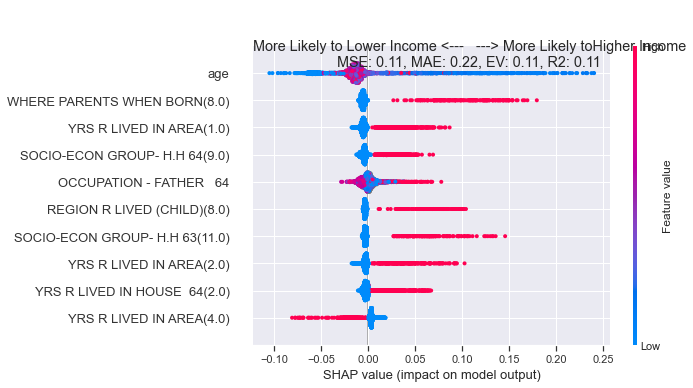

***************************
1964
***************************
MSE: 0.10, MAE: 0.21, EV: -0.03, R2: -0.03


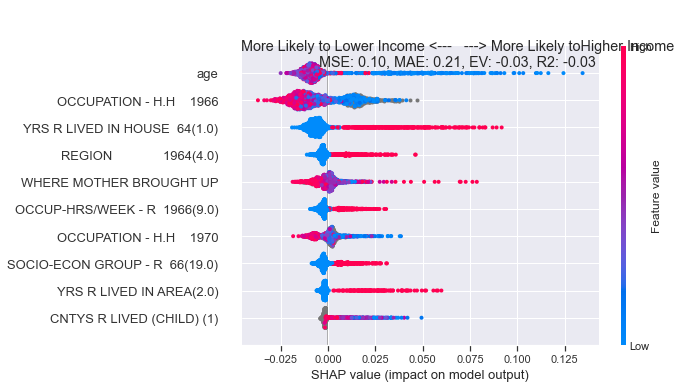

***************************
1966
***************************
MSE: 0.12, MAE: 0.24, EV: 0.05, R2: 0.05


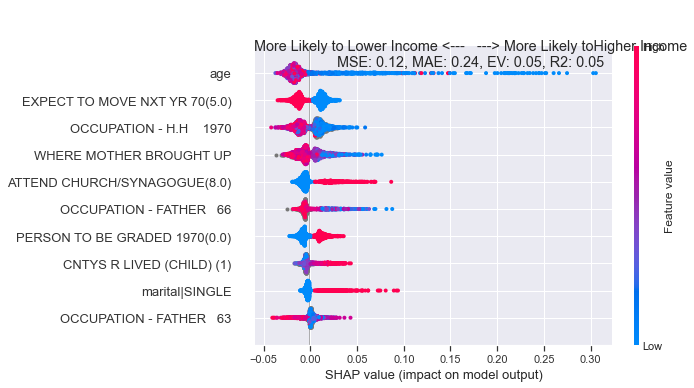

***************************
1970
***************************
MSE: 0.14, MAE: 0.28, EV: -0.02, R2: -0.02


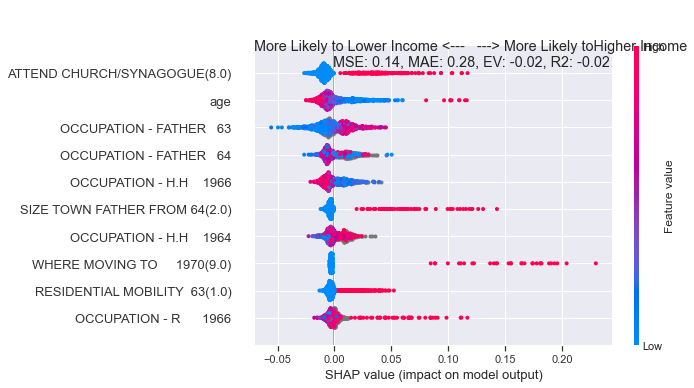

***************************
1974_oct
***************************
MSE: 0.12, MAE: 0.26, EV: 0.04, R2: 0.04


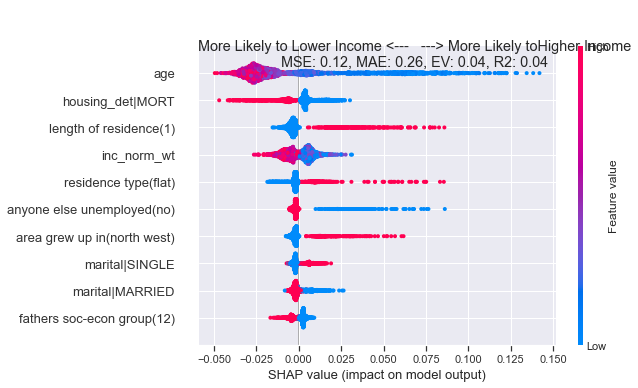

***************************
1974_feb
***************************
MSE: 0.11, MAE: 0.21, EV: 0.02, R2: 0.01


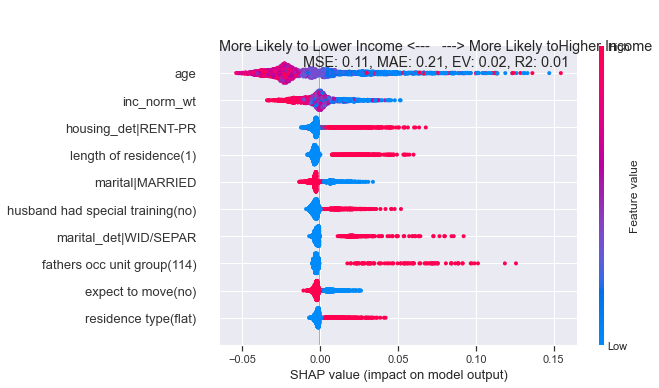

***************************
1979
***************************
MSE: 0.12, MAE: 0.25, EV: 0.04, R2: 0.04


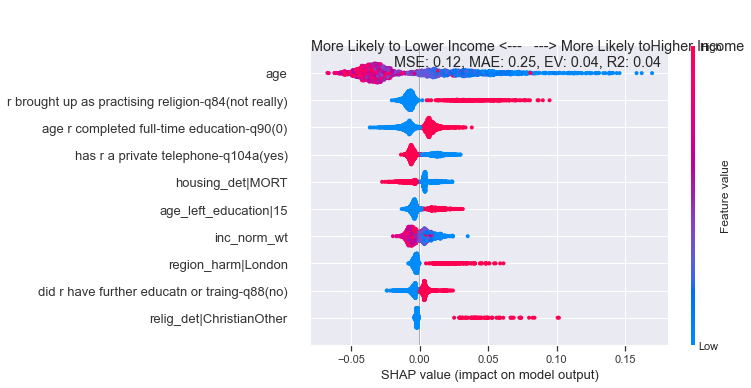

***************************
1983
***************************
MSE: 0.14, MAE: 0.27, EV: 0.01, R2: 0.01


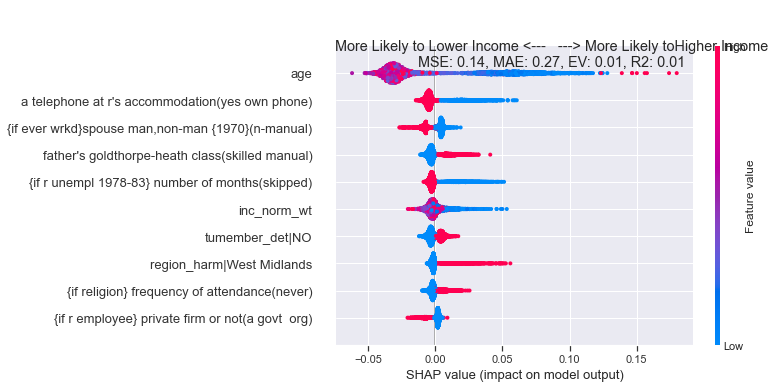

***************************
1987
***************************
MSE: 0.12, MAE: 0.24, EV: 0.03, R2: 0.03


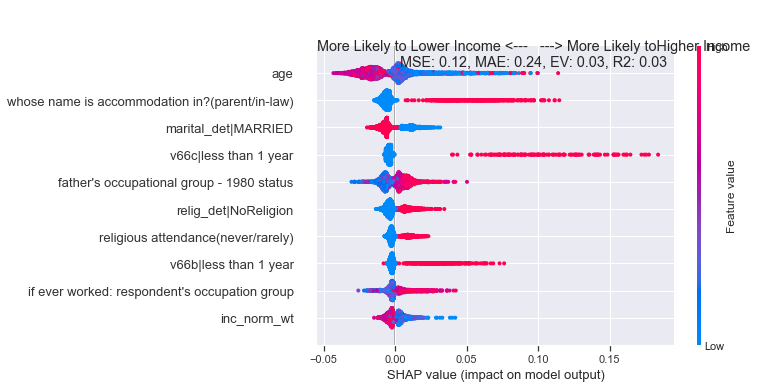

***************************
1992
***************************
MSE: 0.11, MAE: 0.23, EV: 0.02, R2: 0.02


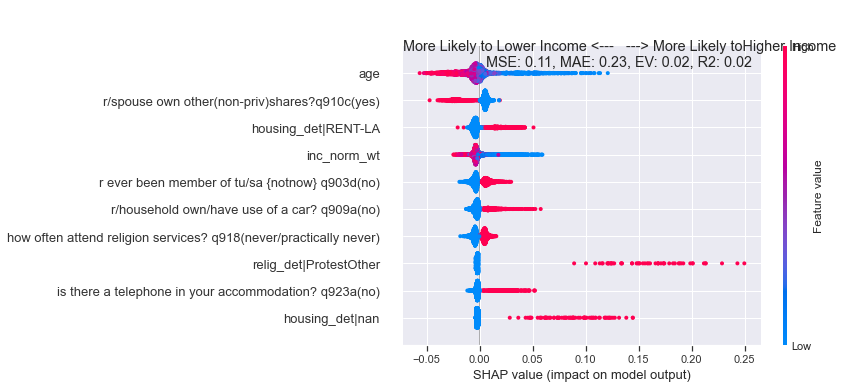

***************************
1997
***************************
MSE: 0.14, MAE: 0.28, EV: 0.08, R2: 0.08


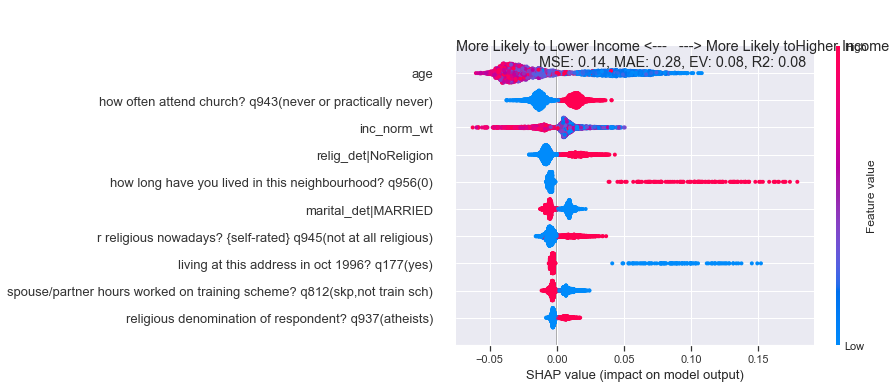

***************************
2001
***************************
MSE: 0.18, MAE: 0.36, EV: 0.09, R2: 0.09


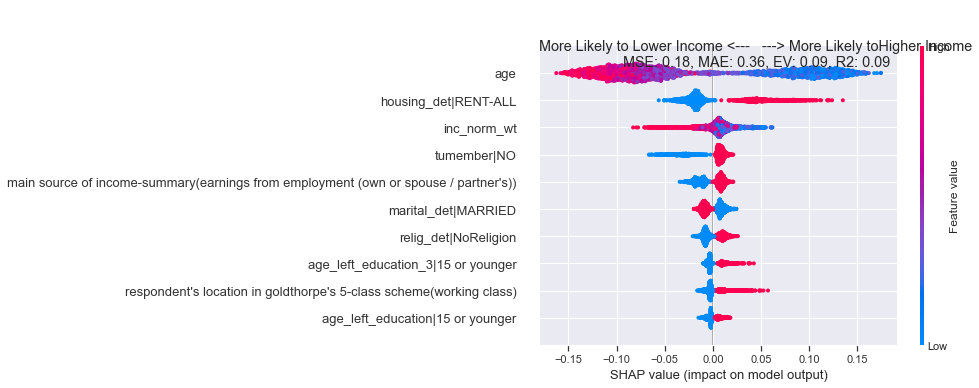

***************************
2005
***************************
MSE: 0.17, MAE: 0.34, EV: 0.14, R2: 0.14


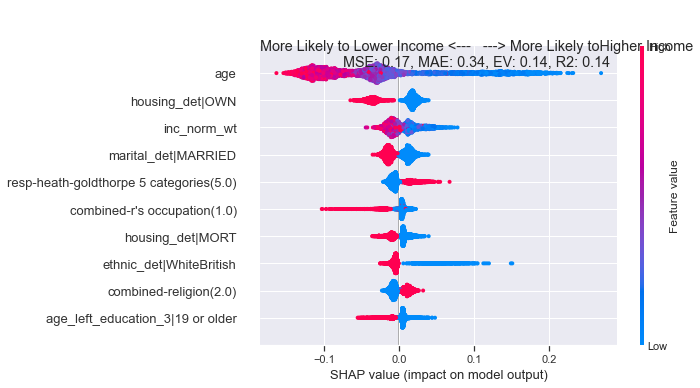

***************************
2010
***************************
MSE: 0.15, MAE: 0.30, EV: 0.14, R2: 0.14


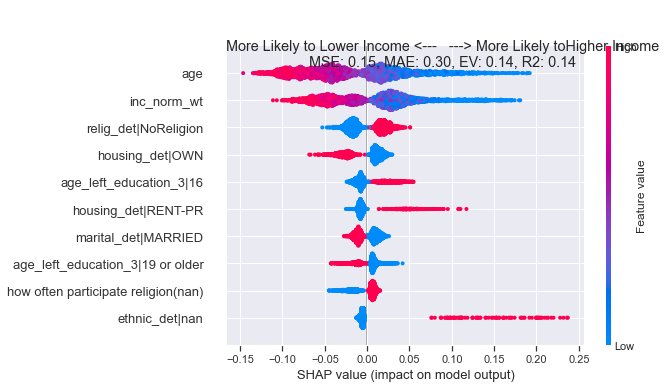

***************************
2015
***************************
MSE: 0.16, MAE: 0.33, EV: 0.19, R2: 0.18


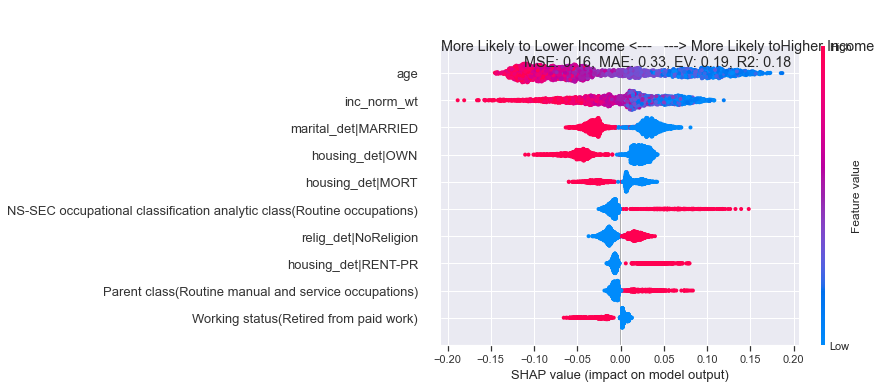

***************************
2017
***************************
MSE: 0.15, MAE: 0.31, EV: 0.16, R2: 0.14


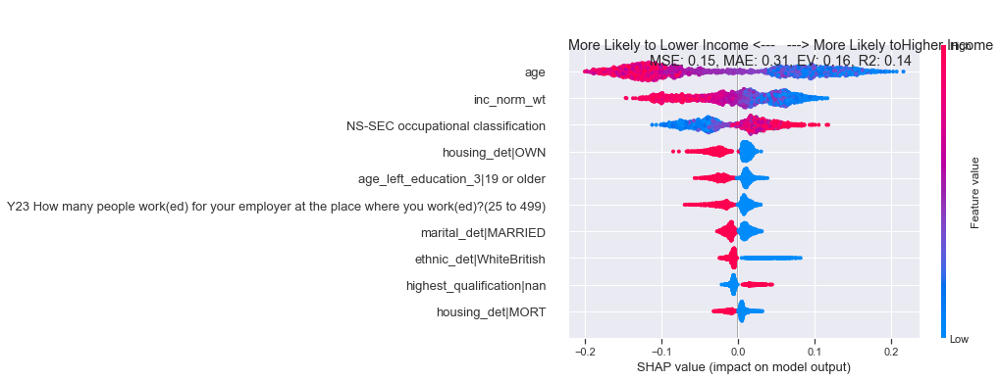

***************************
2019
***************************
MSE: 0.15, MAE: 0.32, EV: 0.10, R2: 0.05


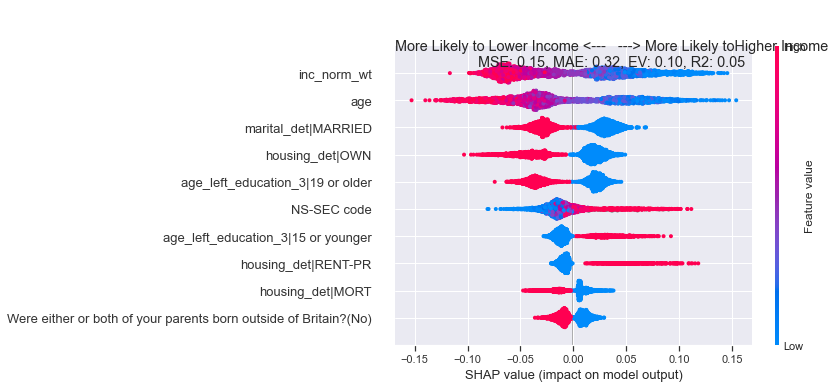

In [24]:
generic_cols = f2f_harmonised.columns
drop_vars = ['y45',
 'y46a',
 'Q24_CSES',
 'y45',
 'y45',
 'bq11a',
 'bq11b',
 'bq11c',
 'bq11d',
 'bq11e',
 'bq11',
 'tq77',
 'tq79a',
 'tq79b',
 'tq79c',
 'bq7',
 'elregon',
 'elregnot',
 'elregtxt','aq65_2',
 'bq93_2',
 'zq93_2',
 'aq50b',
 'bq79b',
 'tq79b',
 'owner91',
 'owner',
 'aq40b',
 'bq74b',
 'morts','aq65_1', 'aq50a', 'bq79a', 'tq79a', 'aq40a', 'bq74a', 'owns', 'v919b','y03','cgender',
'feb245','oct245',
'tenure2','q65e','m187a282','v915','v916','v917','v851','v852','m184239','feb184','oct184','v853','v854','q65c','m187a280',
'aq38','rage','v938','v939','v940','v941','v1212','v1213','v937','v1208','v1209','v1210','v1211','v942','v943','v944','v945',
'bgor','zgor','stregion','arfe','region','m071300','feb071','oct071','gor','pregion','agor','agorx','aregion','bregion','tregion','dq2','stregion',
'y26','aq64','bq90','zq90','aq49','bq78','tq78','aq39','bq73','marstat2','marstat','married','v906a','v51a','q54a','m200262','feb200','feb200','oct200','v933','v934','v935','v936'
'Q23_CSES','q24_cses','q25_cses',
'cesw','cage',
'm187a280','m187a281','feb187','feb188','oct187a','feb189','aq65_2','bq93_2','zq93_2','aq50b','bq79b','tq79b','aq40b','bq74b','morts', 
'v919e','v1215','v1216','v1217','v1218','education','trades','v53a','v919d','v919f','edlevel','y10_banded',
'hhincqui','hhinquis','hhinquie','[if ever worked] r member of trade union',
"y11","zq101","tq108","ethns","raceori2","v915a","v58a","q64a","m000317","v285","v284","v283", #ethnicity
'y06b','y06','zq106_2','tq83b','wreligs','religion','v916','v59a','q63a','m495234','oct495','v920','religsum','religs',#religion
'y07','tenure1','tenure2','q52c',
            ]
for target in ["AuthRight","LibLeft","DNV"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in f2f_harmonised["dataset"].unique()[::-1]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars, harm_vars=harm_vars)

In [17]:
[(ge,{k:v for k,v in BES_label_list[ge].items() if  re.search("if ever worked".lower(),v.lower())}) for ge in f2f_harmonised["dataset"].unique()]
# 

[('2019', {}),
 ('2017', {}),
 ('2015', {}),
 ('2010', {}),
 ('2005', {}),
 ('2001', {}),
 ('1997',
  {'rsupman': 'r manager, foreman, supervisor? [if ever worked] q736'}),
 ('1992', {}),
 ('1987',
  {'v50a1': "if ever worked: respondent's occupation group",
   'v50a2': "if ever worked: respondent's employment status",
   'v50a3': "if ever worked: respondent's socio-economic group",
   'v50a4a': "if ever worked: respondent's social class",
   'v50a4b': "if ever worked: respondent's manual/non manual",
   'v50g': "if ever worked: no. of employees at r's work",
   'v50a5': "if ever worked: respondent's heath-goldthorpe class",
   'v50d': 'if ever worked: no. of people respondent supervises',
   'v50e': 'if ever worked: respondent employee or self-employed',
   'v50f': 'if ever worked: type of org. respondent works for',
   'v50h': "if ever worked: no. of employees at respondent's work",
   'v50i': "if ever worked: respondent's job full-time/part-time",
   'v52a1': "if ever worked: spouse

In [582]:
 f2f_harmonised.columns[-88:-36]

Index(['anyQuals', 'rsa_or_city_and_guilds', 'overseas_other_postschl',
       'overseas_degree', 'other_academic_vocational', 'other_tech_business',
       'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
       'trade_appenticeship', 'nursing', 'teachers_training',
       'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
       'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
       'rsa_other_commercial', 'school_cert_or_matric',
       'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
       'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
       'professional_qualification', 'spec_qual_gained_at_work',
       'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
       'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5',
       'att_university', 'att_commercial_training',
       'att_polytech_or_techcollege', 'att_night_school',
       'att_non_voc_training', 'att_other', 'att_art_school',
       'att_college_of_com

anyQuals                             object
rsa_or_city_and_guilds               object
overseas_other_postschl              object
overseas_degree                      object
other_academic_vocational            object
other_tech_business                  object
higher_onc_ond_bec_tec               object
ordinary_gen_onc_ond_bec_tec         object
trade_appenticeship                  object
nursing                              object
teachers_training                    object
city_and_guilds_cert_part1           object
city_and_guilds_full_tech            object
city_and_guilds_advanced_final       object
city_and_guilds_craft_ordinary       object
rsa_other_commercial                 object
school_cert_or_matric                object
uni_cnaa_degree_or_diploma           object
os_schl_leav_qual                    object
a_level_scot_higher                  object
cse_grade_1_scot_lower               object
cse_grade_2_5                        object
professional_qualification      

In [519]:
flatten( [[k for k,v in BES_label_list[ge].items() if  re.search("marital|region|own|rent|income|age|".lower(),v.lower())] for ge in f2f_harmonised["dataset"].unique()] )

['finalserialno',
 'agency',
 'Y10A',
 'Y10B1',
 'Y10B2',
 'Y10B3',
 'Y10B4',
 'Y10B5',
 'a01',
 'a01_code',
 'a02',
 'a03',
 'm02_1',
 'm02_2',
 'm02_3',
 'm02_4',
 'm02_5',
 'm02_6',
 'b01',
 'b02',
 'b04',
 'b05',
 'b0601',
 'b0602',
 'b0603',
 'b0604',
 'b0605',
 'b0606',
 'b0607',
 'b0608',
 'b0609',
 'b0610',
 'b0611',
 'b0612',
 'b0613',
 'b0614',
 'b0615',
 'b0616',
 'b0617',
 'b0618',
 'b0619',
 'b06a',
 'b07',
 'b09',
 'b12_1',
 'b12_2',
 'b12_3',
 'b12_4',
 'b12_5',
 'b12_6',
 'b13_1',
 'b13_2',
 'b13_3',
 'b13_4',
 'b13_5',
 'b13_6',
 'c01',
 'c02_1',
 'c02_2',
 'c02_3',
 'c02_4',
 'd01',
 'd02',
 'd03',
 'd04',
 'f01_1',
 'f01_2',
 'f01_3',
 'f01_4',
 'f01_5',
 'f01_6',
 'f01_7',
 'f01_8',
 'f01_9',
 'f01_10',
 'f01_11',
 'f01_12',
 'f2',
 'f3',
 'e01',
 'g01_1',
 'g01_2',
 'g01_3',
 'g01_4',
 'g01_5',
 'g01_6',
 'g01_7',
 'g01_8',
 'h01',
 'i01_1',
 'i01_2',
 'i01_3',
 'i01_4',
 'i01_5',
 'i01_6',
 'i01_7',
 'i01_8',
 'j05',
 'j06',
 'j01',
 'j08',
 'j10',
 'j11',
 'j12',

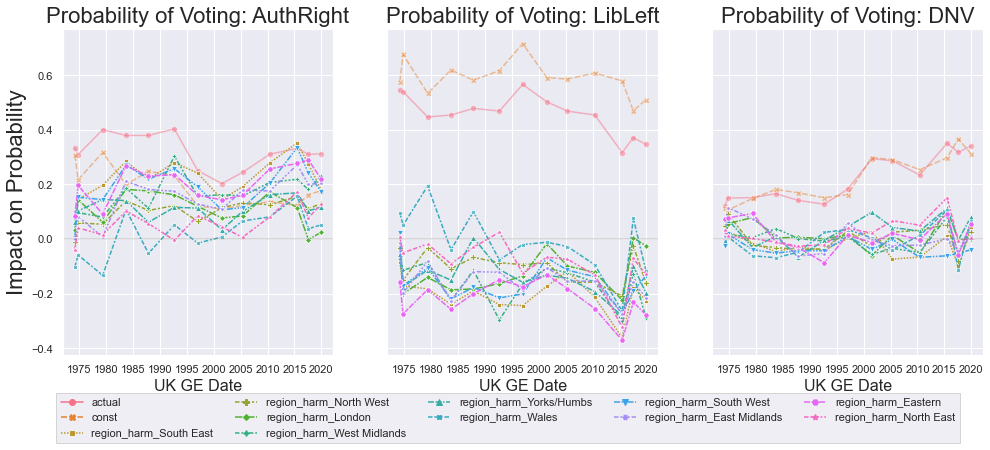

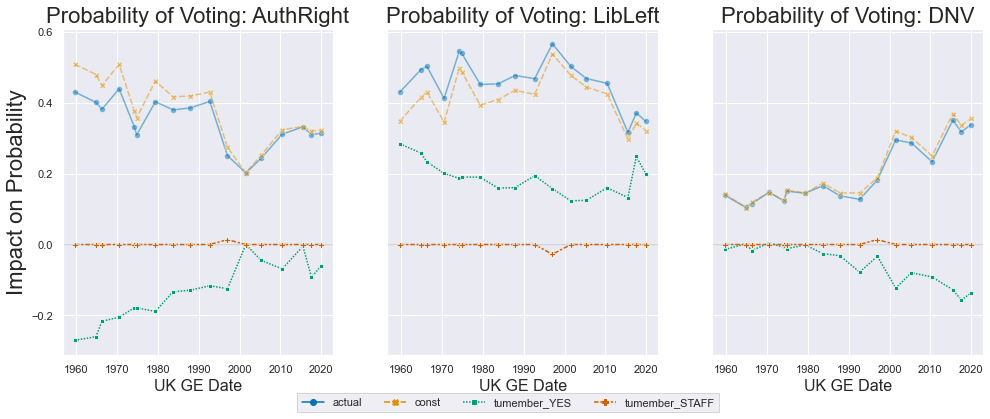

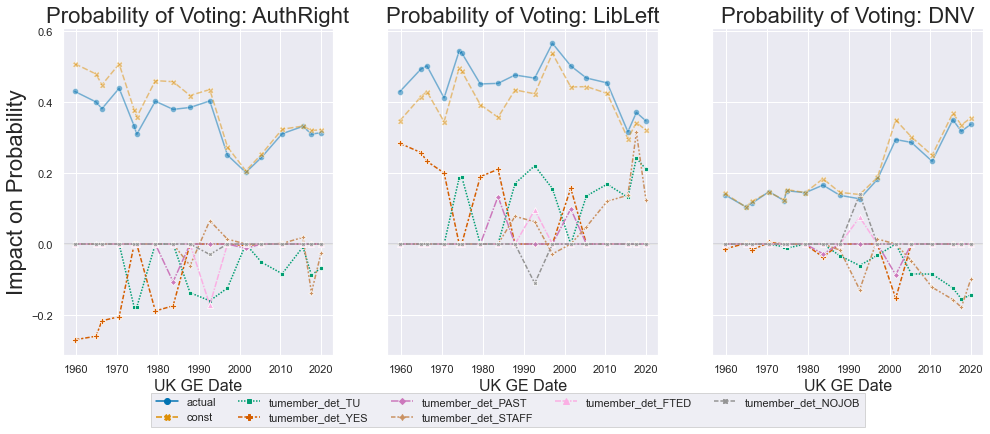

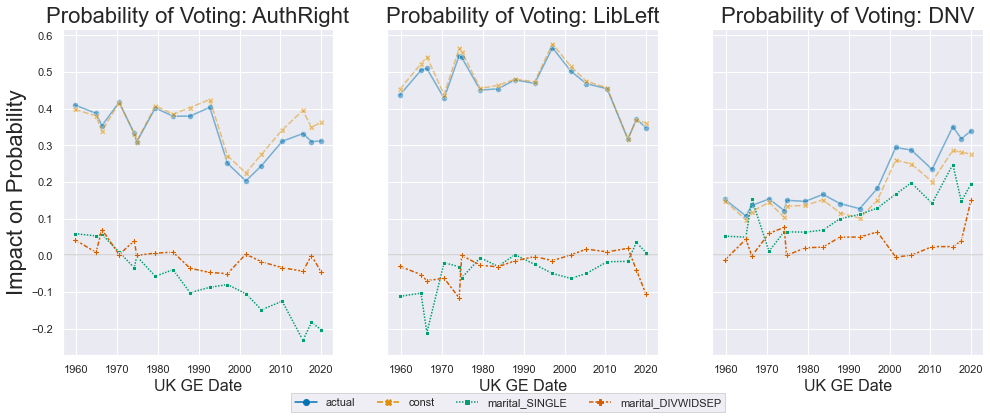

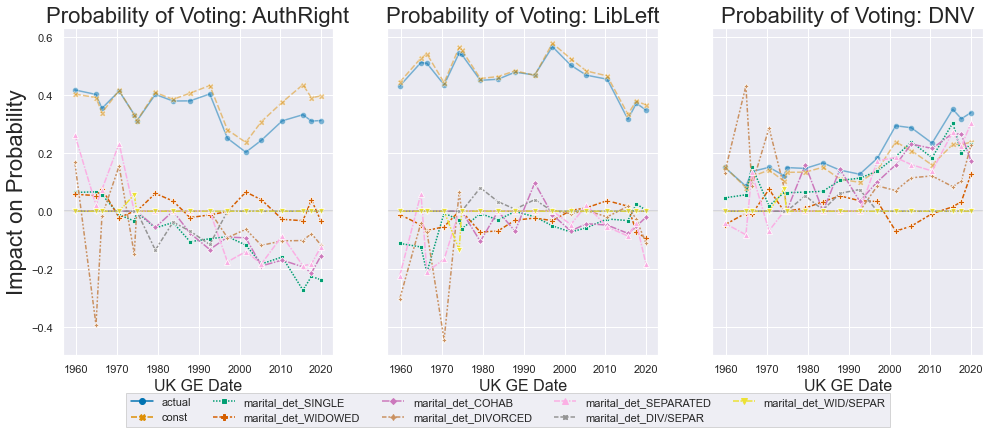

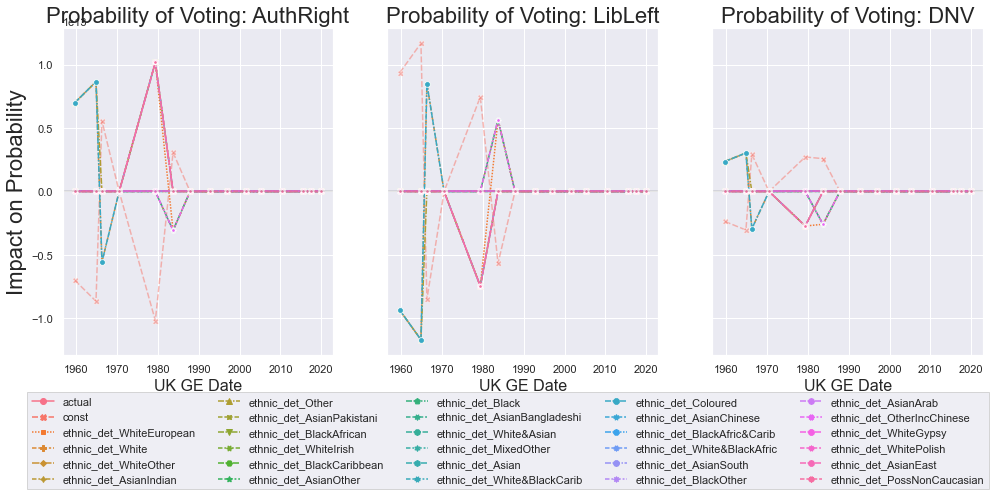

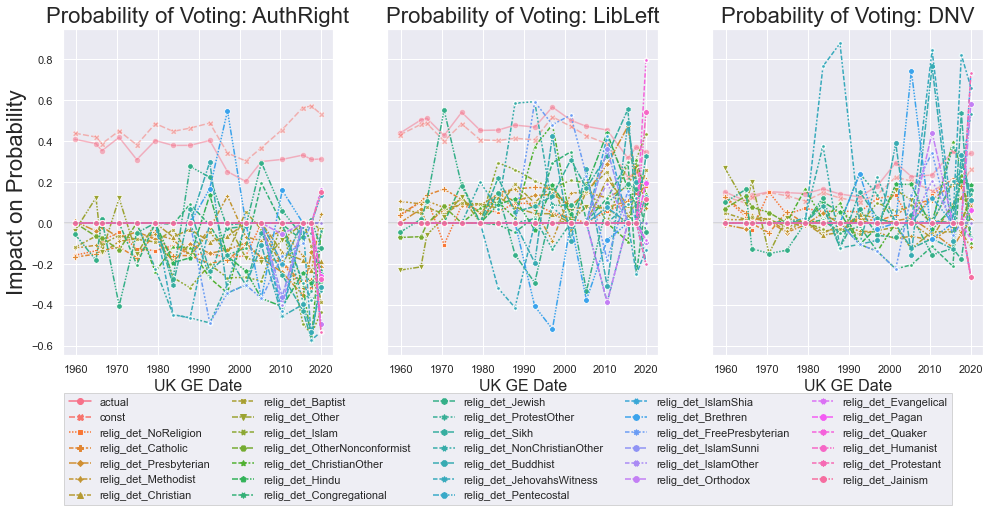

In [59]:
for val in ['region_harm',  'tumember',
           'tumember_det', 'marital', 'marital_det','ethnic_det','relig_det',]:
    val_list = [val]
    mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)
    
    plot_OLS_set(["AuthRight","LibLeft","DNV"],
    #              ["generation","inc(quartile)","gender_complete","housing","age_left_education_3",
                  val_list,
    #              dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_18",
    #                           "age_left_education_3_19 or older",'soc_lib_auth','ec_left_right'],
                 drop_first=True, figsize=(16.5, 6),  sharey=True, variance_scaled=False,hide_const=False,add_actual=True,
                mask = mask,
                ge_range=f2f_harmonised["dataset"][mask].unique()
                )

In [35]:
f2f_harmonised["region_harm"].value_counts()

Scotland         6432
South East       6295
North West       4360
London           3728
West Midlands    3524
Yorks/Humbs      3447
Wales            3120
South West       3110
East Midlands    2642
Eastern          2260
North East       2125
Name: region_harm, dtype: int64

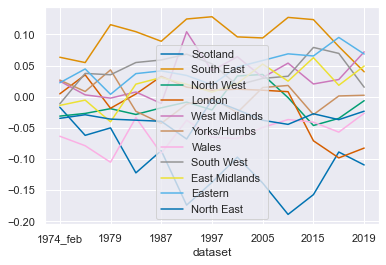

In [18]:
f2f_harmonised[["dataset","region_harm","AuthRight"]].groupby("dataset").apply(lambda x: pd.get_dummies( x["region_harm"] ).corrwith( x["AuthRight"] )).plot()

In [37]:
f2f_harmonised[["dataset",target_var,focal_var]]\
    .groupby("dataset").apply(lambda x: pd.get_dummies( x[target_var] ).corrwith( x[focal_var] ))

,Anglican,NoReligion,Catholic,Presbyterian,Methodist,Christian,Baptist,Other,Islam,OtherNonconformist,...,FreePresbyterian,IslamSunni,IslamOther,Orthodox,Evangelical,Pagan,Quaker,Humanist,Protestant,Jainism
dataset,,,,,,,,,,,,,,,,,,,,,
1959,0.061250,-0.049100,-0.083502,0.034960,-0.037263,NaN,-0.018003,-0.000462,NaN,0.016483,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1964,0.092721,-0.049809,-0.092340,0.008973,-0.029827,NaN,-0.008107,-0.015378,NaN,-0.002946,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1966,0.085943,-0.035247,-0.076453,0.012666,-0.052549,NaN,-0.008432,-0.015774,NaN,-0.007810,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1970,0.071613,-0.034977,-0.060220,0.000933,-0.058505,NaN,-0.004401,0.014715,NaN,0.004835,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1974_feb,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1974_oct,0.131522,-0.086015,-0.065486,0.015426,-0.001823,NaN,-0.001868,-0.027419,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1979,0.117489,-0.087814,0.027369,0.003471,0.014630,NaN,-0.001628,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1983,0.129668,-0.050731,-0.068652,-0.058006,-0.005860,0.001028,0.009014,NaN,-0.024680,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1987,0.147444,-0.101772,-0.049974,-0.009200,-0.029420,0.012873,-0.020085,NaN,-0.045044,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
output_folder = "E:\\BES_analysis_data\\output\\"
Treatment = "BES f2f Factor Extraction"
output_subfolder = output_folder + Treatment + os.sep
if not os.path.exists( output_subfolder ):
    os.makedirs( output_subfolder )

focal_var = "AuthRight"
target_var ="relig_det"
df_simp = f2f_harmonised[["dataset",target_var,focal_var]]\
    .groupby("dataset").apply(lambda x: pd.get_dummies( x[target_var] ).corrwith( x[focal_var] )).dropna()
    
decomp_index = df_simp.index
decomp_columns = df_simp.columns
clean_feature_set_std = StandardScaler().fit_transform(df_simp.values )
decomp_std = pd.DataFrame(   clean_feature_set_std,
                             columns = df_simp.columns,
                             index   = df_simp.index      )

# %%time
# 5 mins
## RUN (some variant of) PCA (potentially v slow!)
n_components = decomp_std.shape[1]
n_components = 8
# (svd_solver='full', n_components='mle',whiten=True)
decomp = PCA(n_components = n_components,svd_solver='full')
# decomp = FastICA(algorithm='deflation', fun='exp', fun_args=None, max_iter=1000,
#     n_components=None, random_state=None, tol=0.07, w_init=None, whiten=False) # 2h 1min 4s "fast"
# decomp = SparsePCA(n_components=n_components, alpha=2,max_iter=1000,n_jobs=4,tol=1e-10, verbose=True) # 5min
#
# alpha=2 -> 1hr

# decomp = FactorAnalysis(svd_method = 'lapack',n_components = n_components) ## ~10s ,n_components=30 -> 1.5 hrs
decomp_method = str(decomp).split("(")[0] 
# ,n_components=30

X_r = decomp.fit_transform(decomp_std)

BES_decomp = pd.DataFrame(   X_r,
                             columns = range(0,n_components),
                             index   = decomp_index)

import pickle
# treatdir = BES_data_folder+Treatment
# subdir = BES_data_folder+Treatment+decomp_method
load_suff = "FactorAnalysis"
save = True # False => Load

if save & ( 'decomp' in globals() ): # SAVE    ##( 'decomp' not in globals() )
    decomp_method = str(decomp).split("(")[0] 
    subdir = output_subfolder + decomp_method
    fname = subdir+ os.sep + decomp_method
    # create dir, save decomp object, BES_decomp, BES_std    
    if not os.path.exists(subdir): os.makedirs(subdir)
    with open(fname+".pkl", "wb") as f: pickle.dump( decomp, f )
        
(BES_decomp, comp_labels, comp_dict) = display_components(n_components, decomp,
                                                          decomp_columns, BES_decomp, manifest=None, 
                                                          save_folder = subdir,  
                                                          show_first_x_comps= 10, show_histogram = False)

ValueError: Found array with 0 sample(s) (shape=(0, 32)) while a minimum of 1 is required by StandardScaler.

In [25]:
pd.Series(decomp.noise_variance_,index=df_simp.columns)

Scotland         0.004735
South East       0.023674
North West       0.123561
London           0.018512
West Midlands    0.039806
Yorks/Humbs      0.040406
Wales            0.083143
South West       0.029036
East Midlands    0.061515
Eastern          0.235405
North East       0.142967
dtype: float64

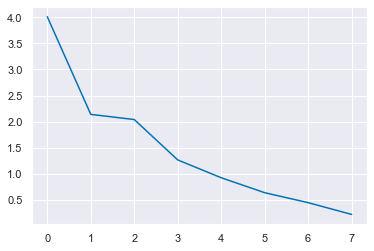

In [29]:
plt.plot( decomp.explained_variance_ )

In [ ]:
### bah - too many gaps for this to be useful!

In [43]:
generic_cols = f2f_harmonised.columns
harm_vars = ["wt","age","housing_det",
                                  'gender_complete', 
#              'age_left_education',
                                  'age_left_education_3',
             'inc_norm_wt',
#            'region_harm',  'tumember',
#            'tumember_det', 'marital', 'marital_det','ethnic_det',
             'relig_det',
            ]

AuthRight
***************************
1959
***************************
MSE: 0.18, MAE: 0.37, EV: 0.19, R2: 0.19


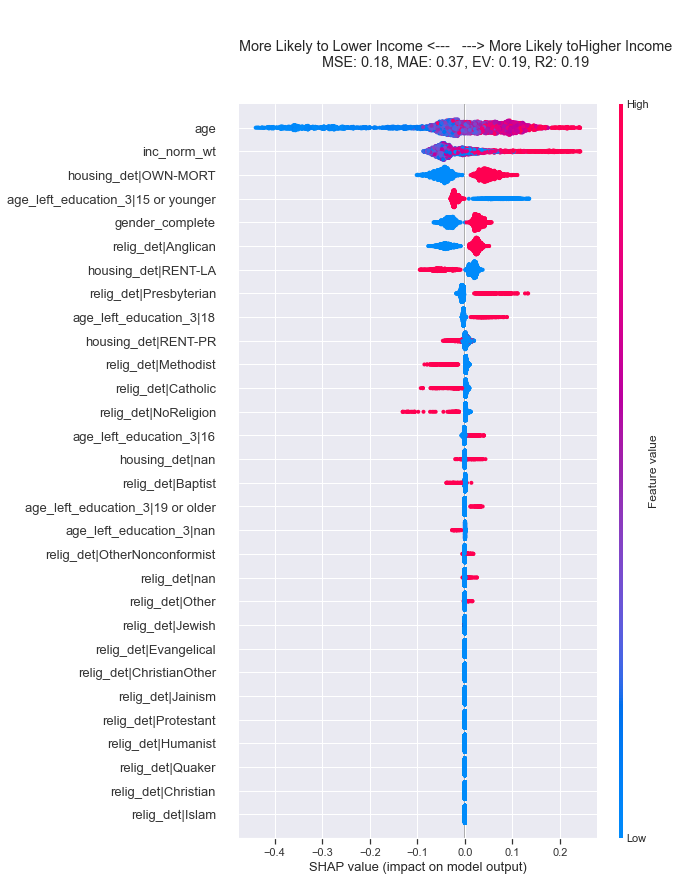

***************************
1964
***************************
MSE: 0.21, MAE: 0.42, EV: 0.11, R2: 0.11


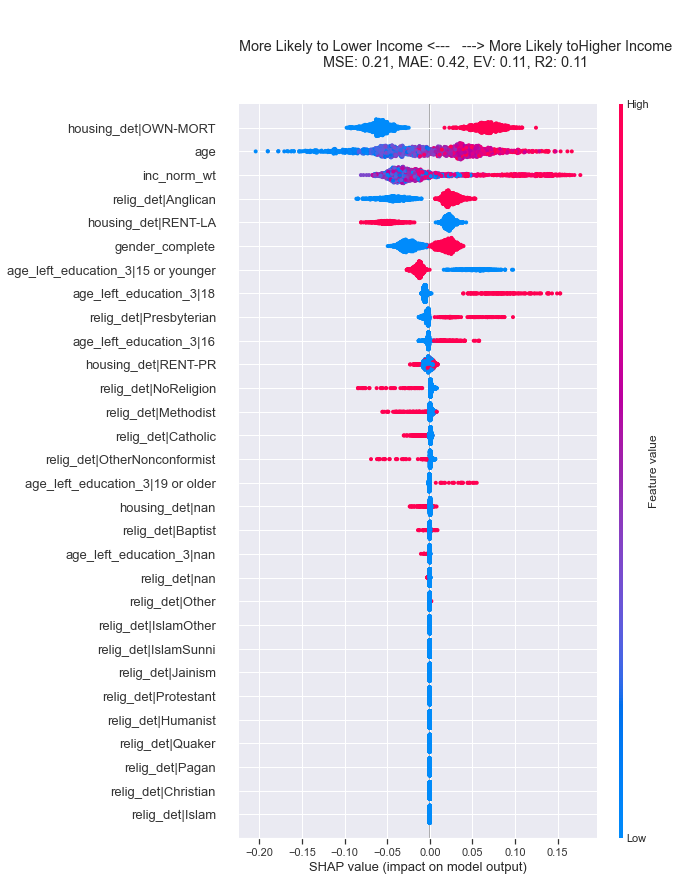

***************************
1966
***************************
MSE: 0.20, MAE: 0.41, EV: 0.12, R2: 0.12


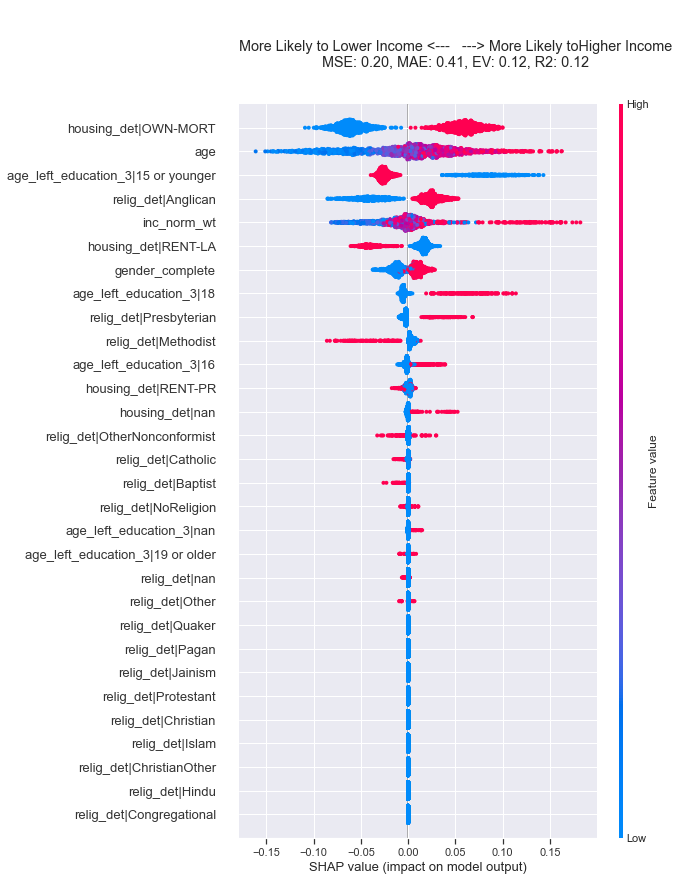

***************************
1970
***************************
MSE: 0.24, MAE: 0.47, EV: 0.03, R2: 0.03


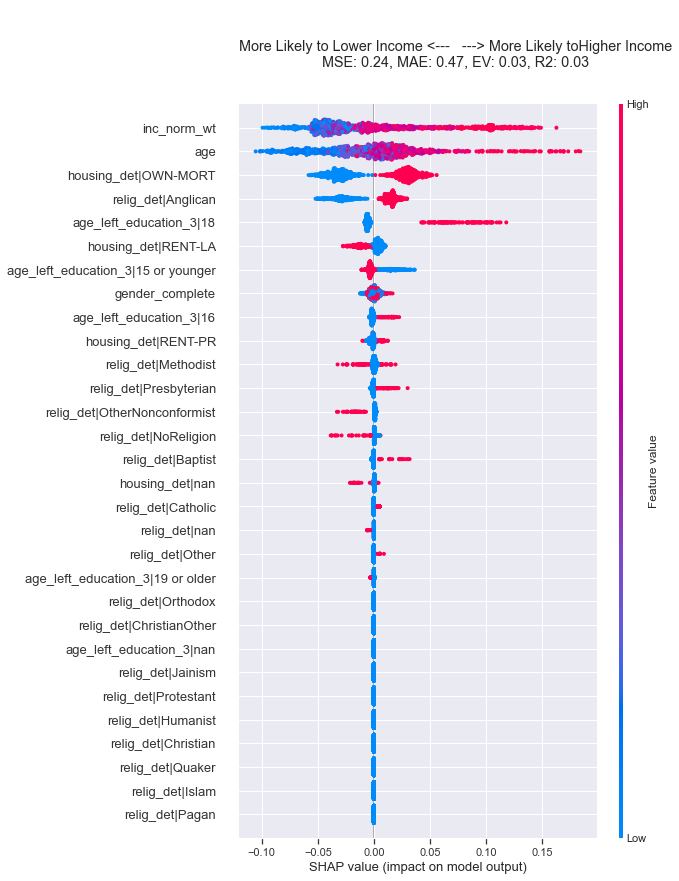

***************************
1974_oct
***************************
MSE: 0.20, MAE: 0.39, EV: 0.08, R2: 0.08


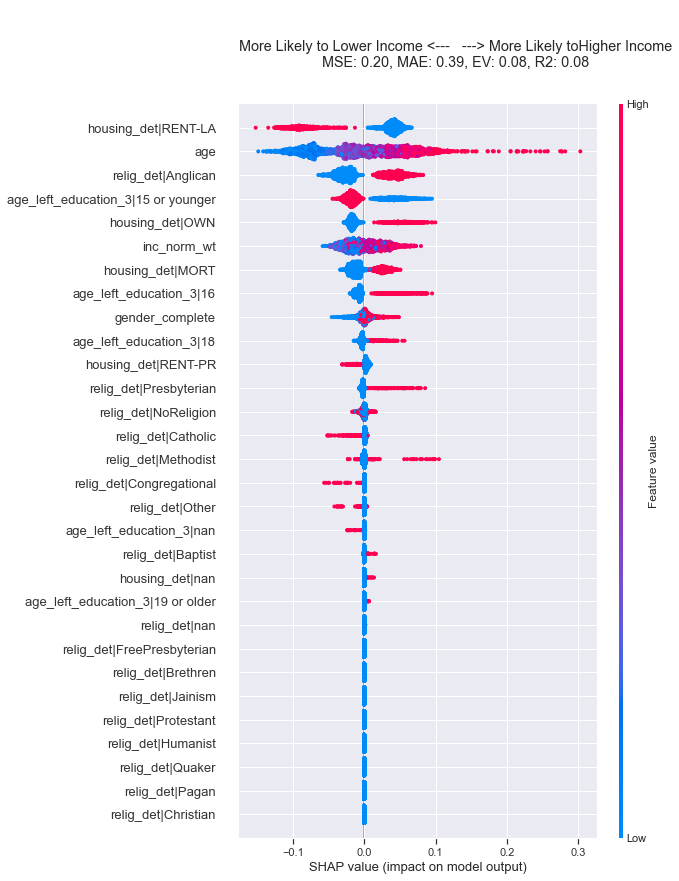

***************************
1974_feb
***************************
MSE: 0.20, MAE: 0.41, EV: 0.08, R2: 0.08


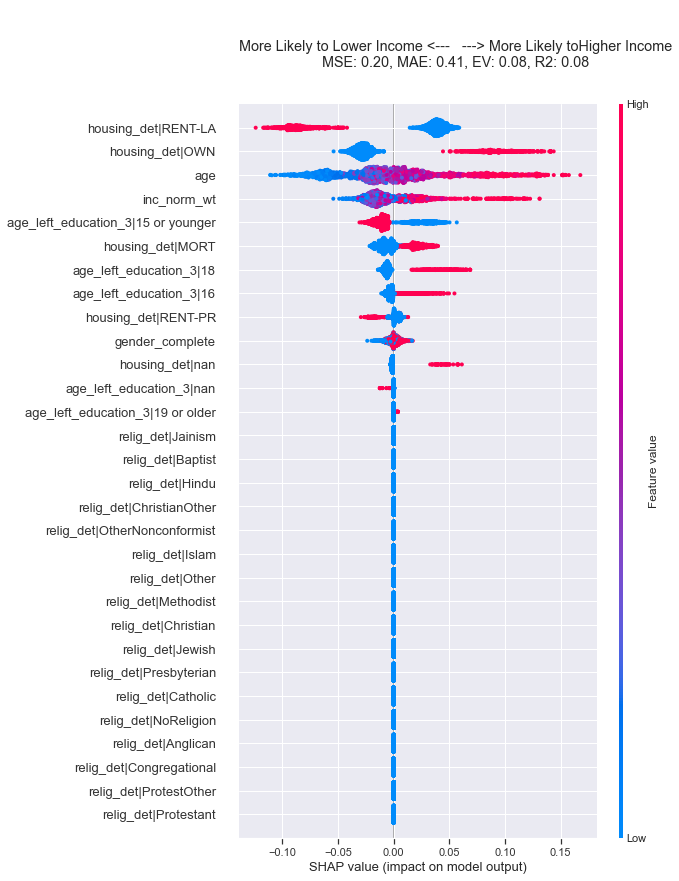

***************************
1979
***************************
MSE: 0.22, MAE: 0.45, EV: 0.07, R2: 0.06


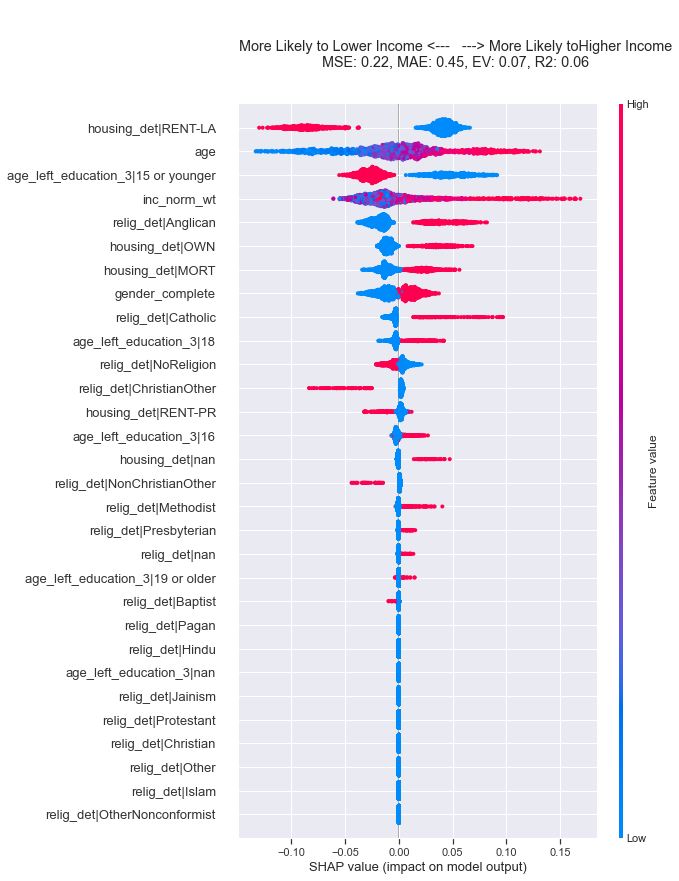

***************************
1983
***************************
MSE: 0.21, MAE: 0.43, EV: 0.09, R2: 0.09


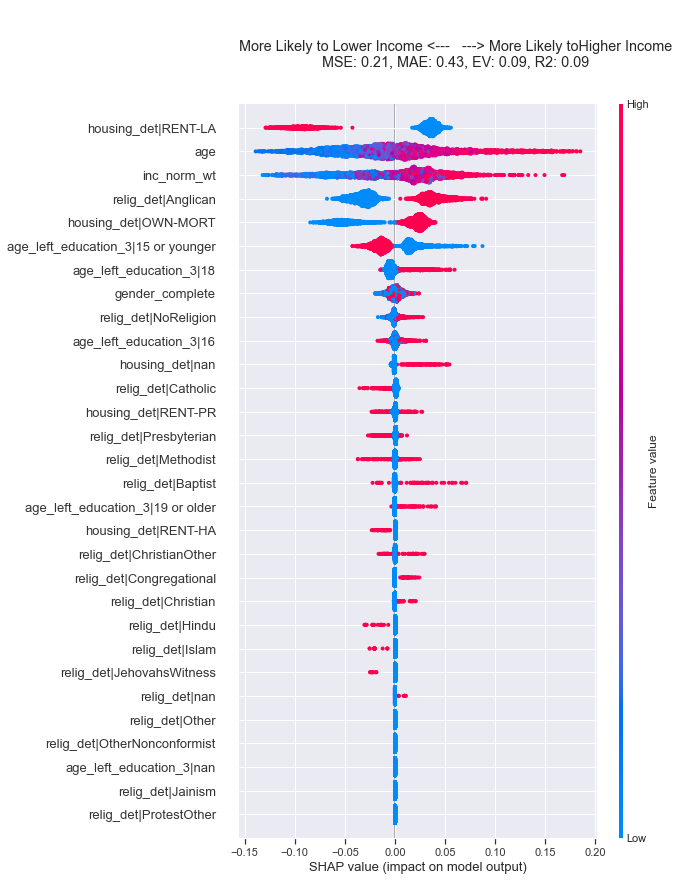

***************************
1987
***************************
MSE: 0.21, MAE: 0.42, EV: 0.12, R2: 0.12


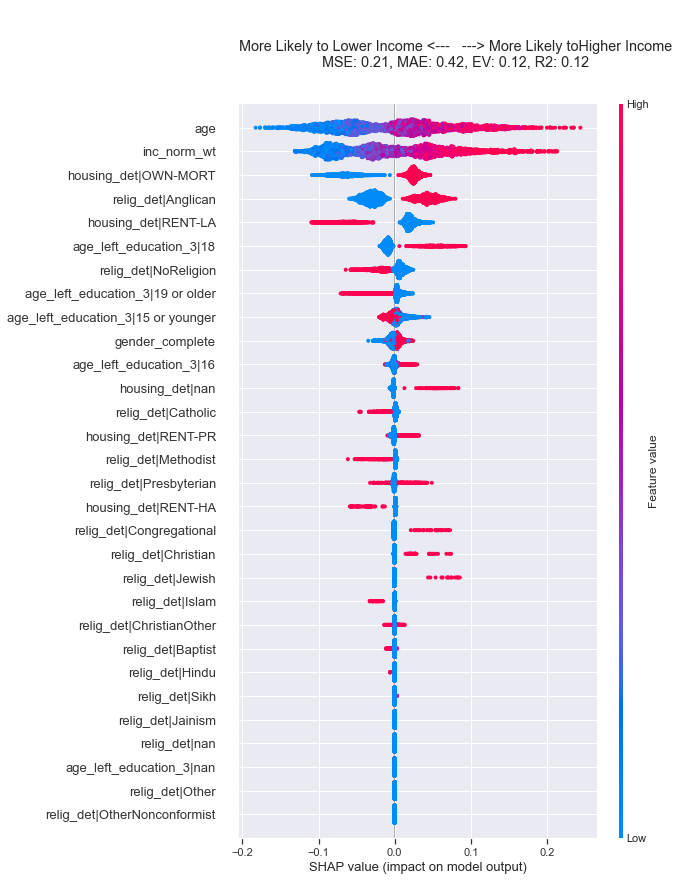

***************************
1992
***************************
MSE: 0.20, MAE: 0.40, EV: 0.14, R2: 0.14


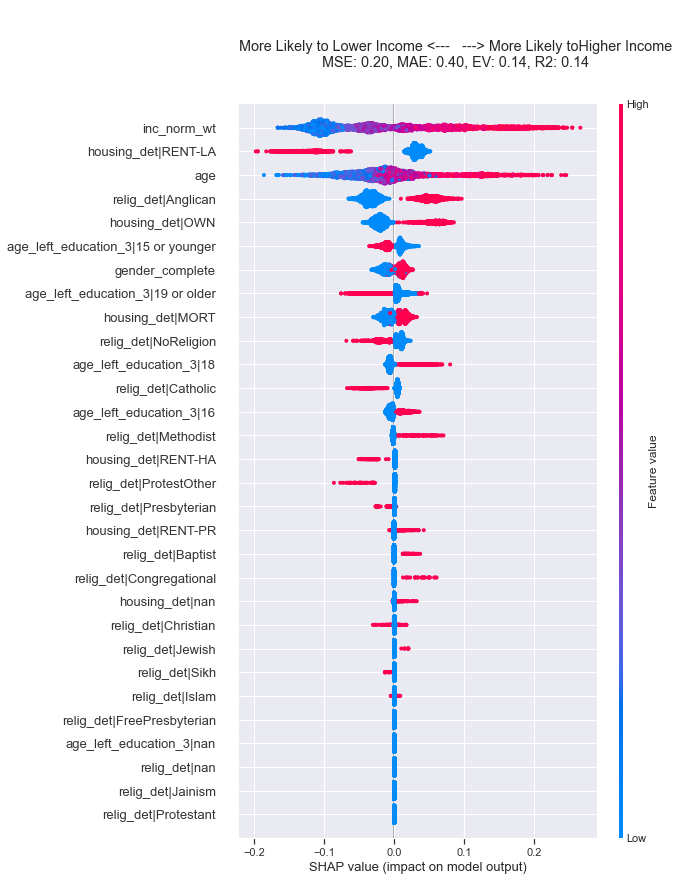

***************************
1997
***************************
MSE: 0.16, MAE: 0.32, EV: 0.12, R2: 0.11


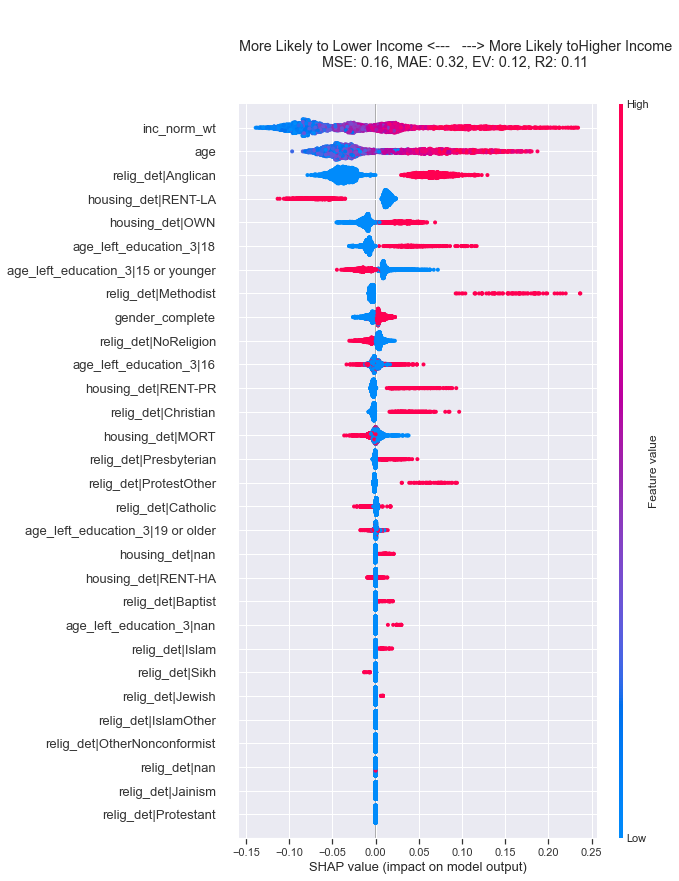

***************************
2001
***************************
MSE: 0.14, MAE: 0.30, EV: 0.09, R2: 0.08


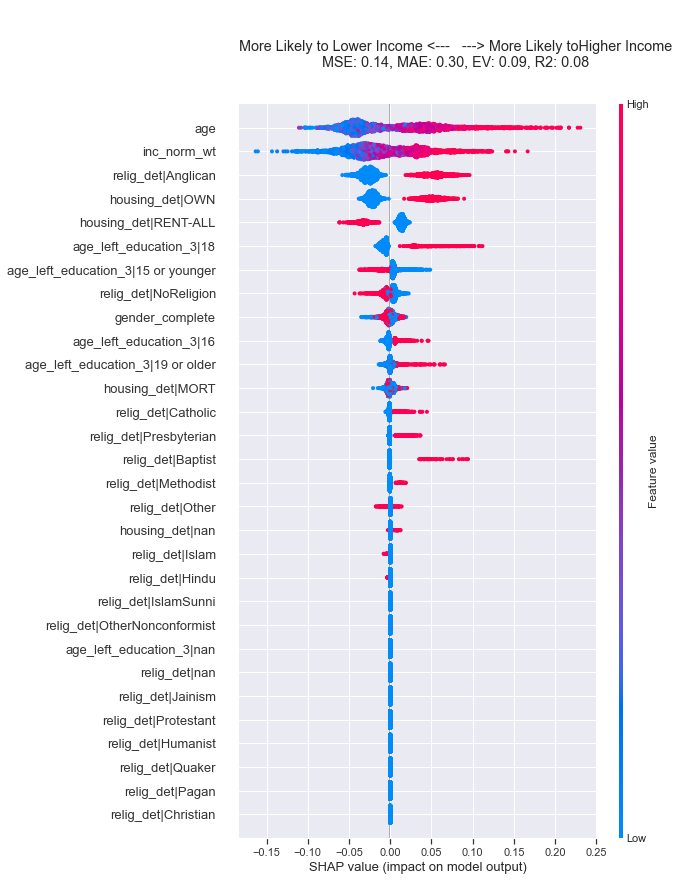

***************************
2005
***************************
MSE: 0.16, MAE: 0.33, EV: 0.10, R2: 0.09


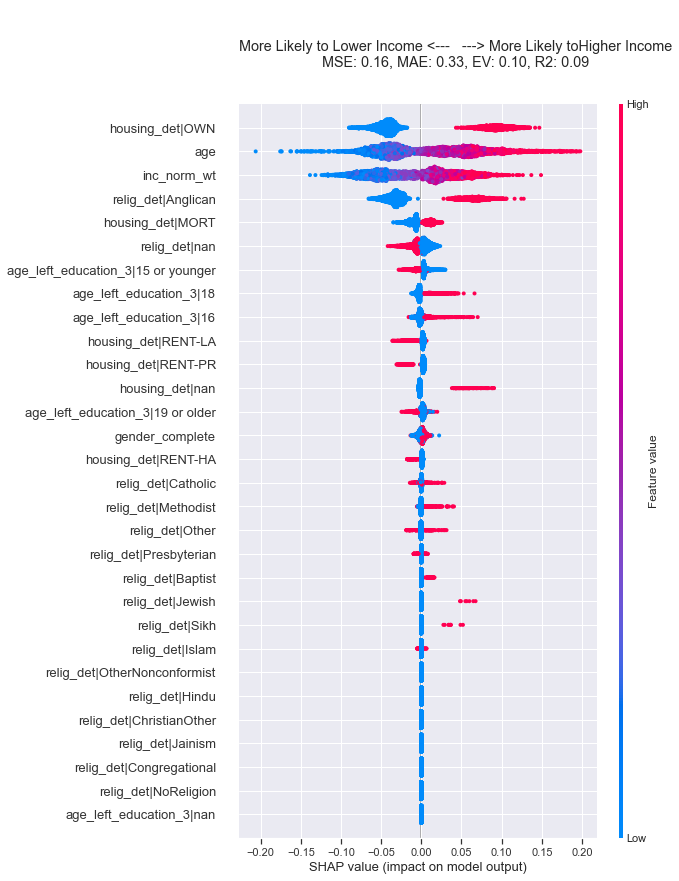

***************************
2010
***************************
MSE: 0.19, MAE: 0.39, EV: 0.08, R2: 0.08


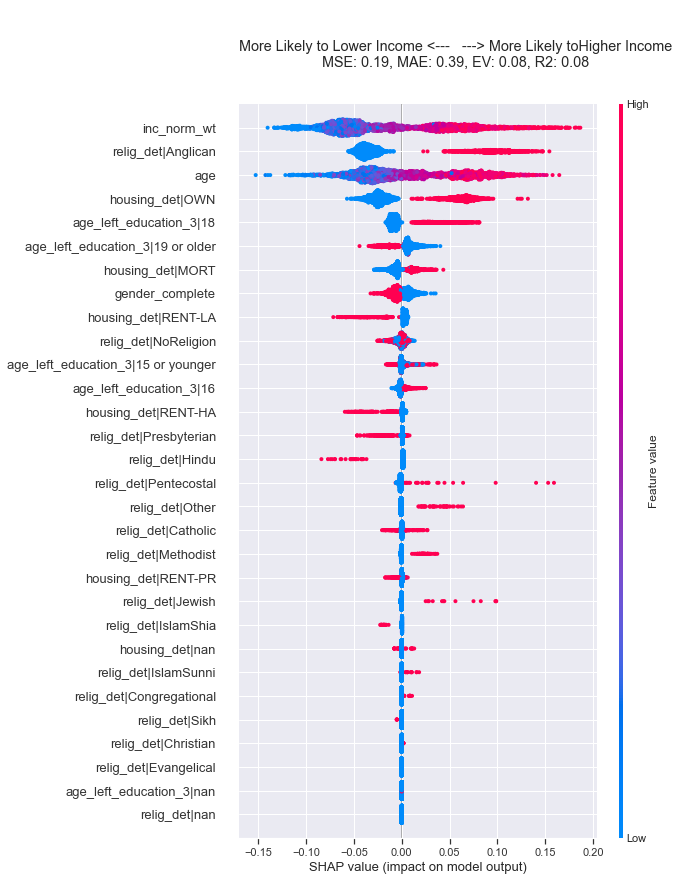

***************************
2015
***************************
MSE: 0.20, MAE: 0.40, EV: 0.14, R2: 0.14


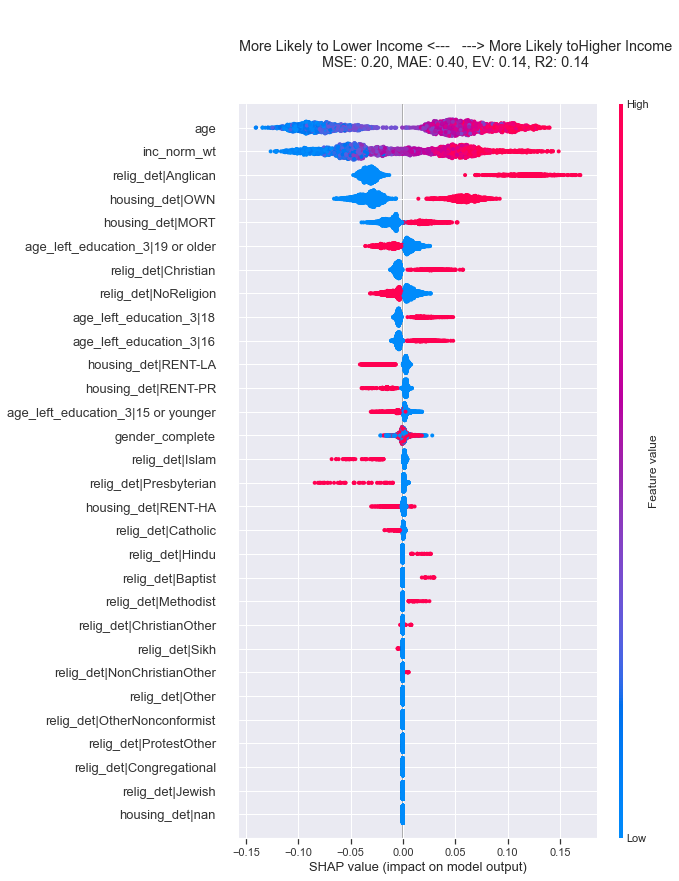

***************************
2017
***************************
MSE: 0.19, MAE: 0.38, EV: 0.14, R2: 0.14


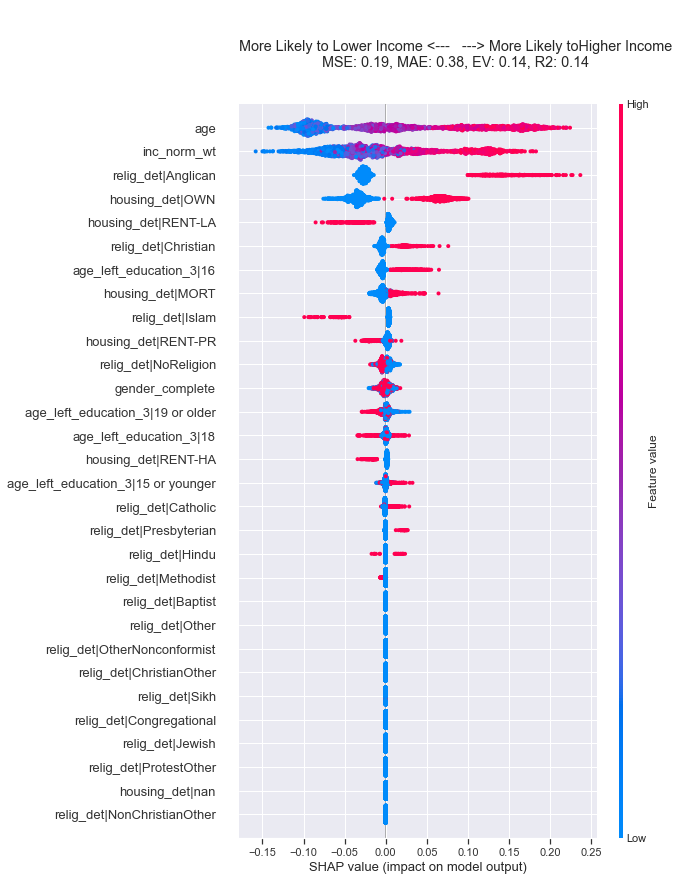

***************************
2019
***************************
MSE: 0.21, MAE: 0.41, EV: 0.12, R2: 0.11


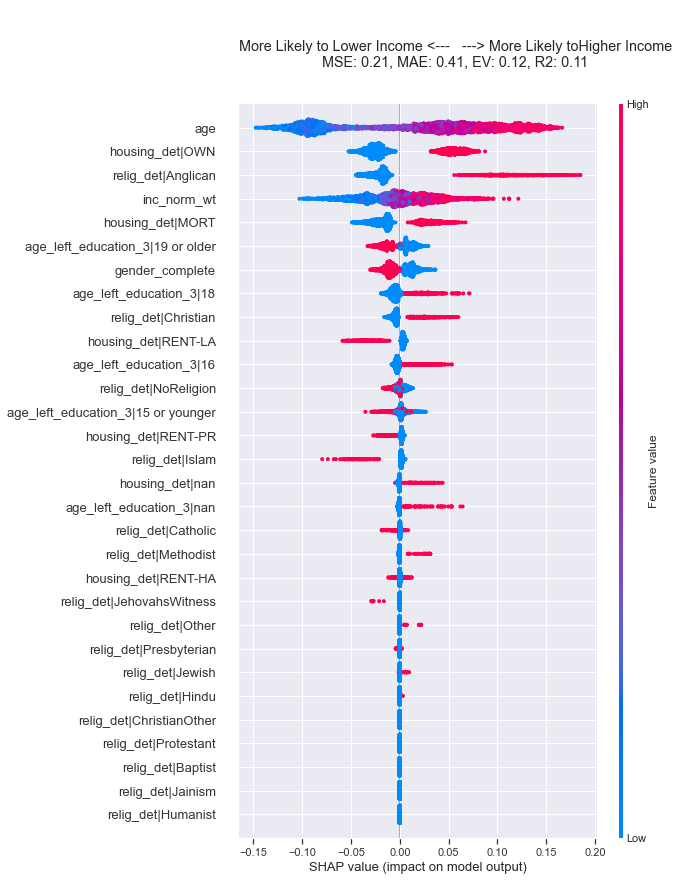

LibLeft
***************************
1959
***************************
MSE: 0.19, MAE: 0.39, EV: 0.18, R2: 0.18


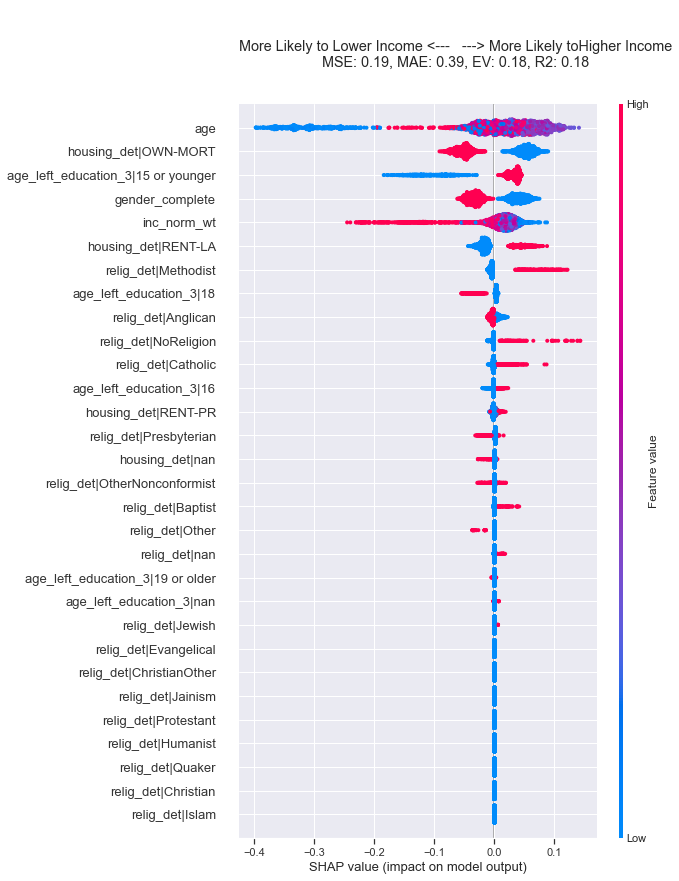

***************************
1964
***************************
MSE: 0.23, MAE: 0.46, EV: 0.08, R2: 0.08


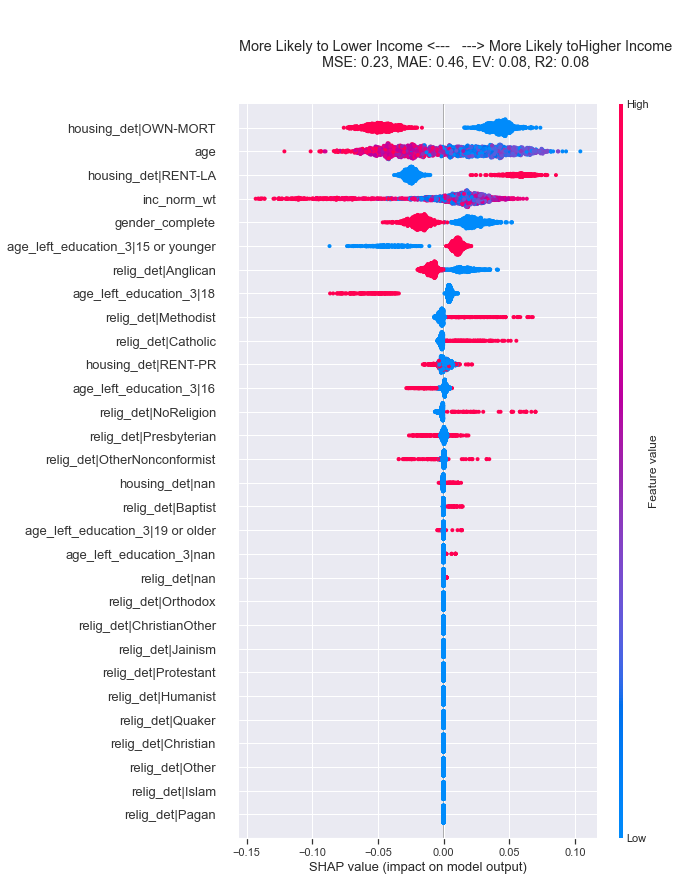

***************************
1966
***************************
MSE: 0.23, MAE: 0.46, EV: 0.07, R2: 0.07


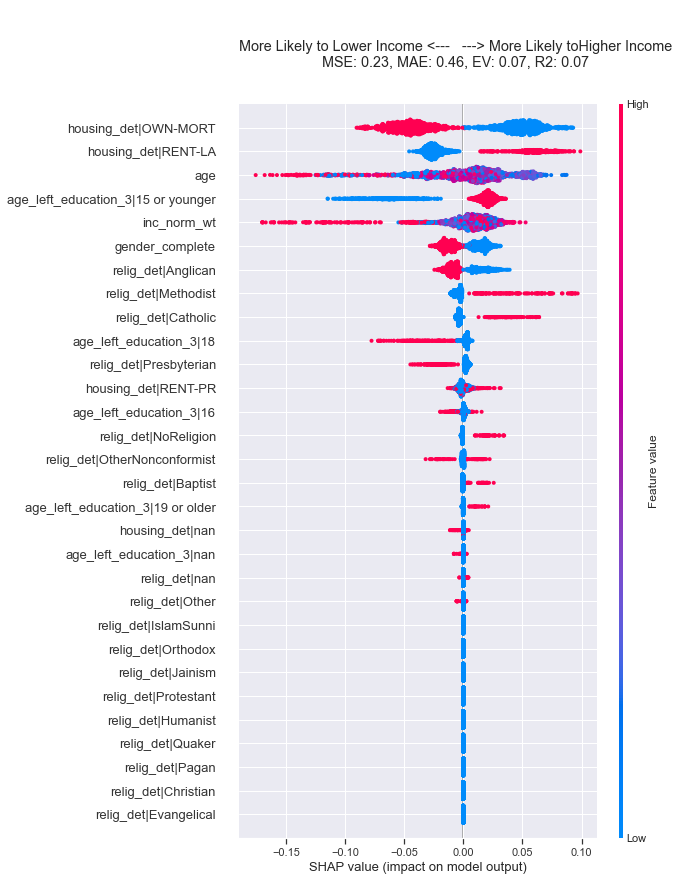

***************************
1970
***************************
MSE: 0.24, MAE: 0.48, EV: 0.02, R2: 0.02


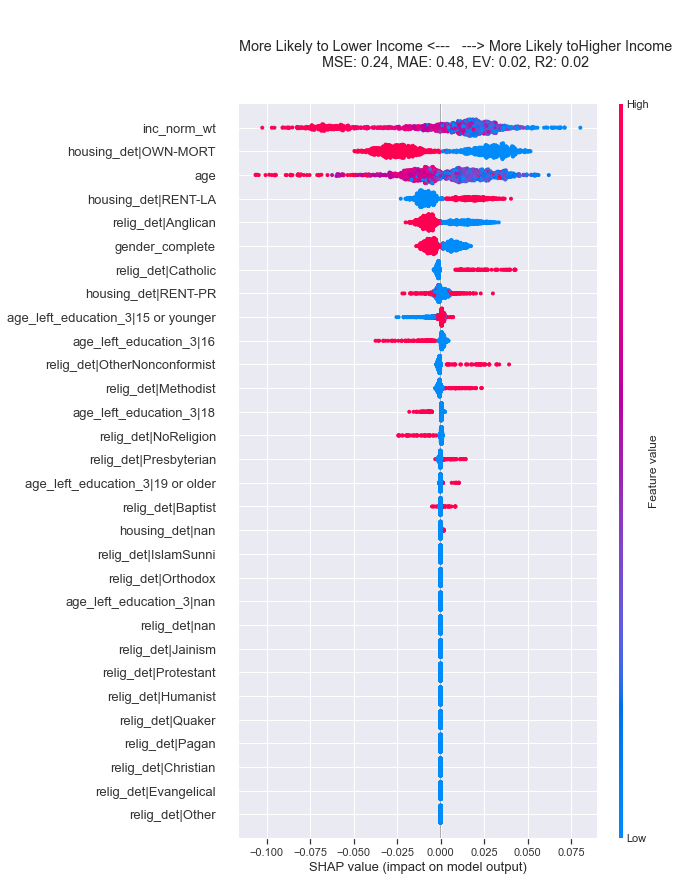

***************************
1974_oct
***************************
MSE: 0.24, MAE: 0.48, EV: 0.05, R2: 0.05


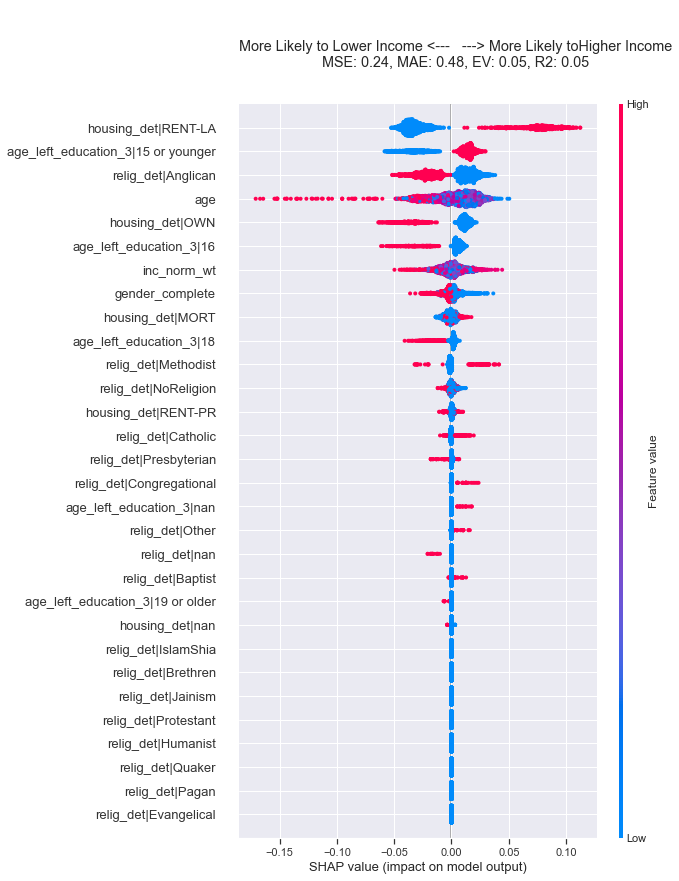

***************************
1974_feb
***************************
MSE: 0.23, MAE: 0.46, EV: 0.07, R2: 0.07


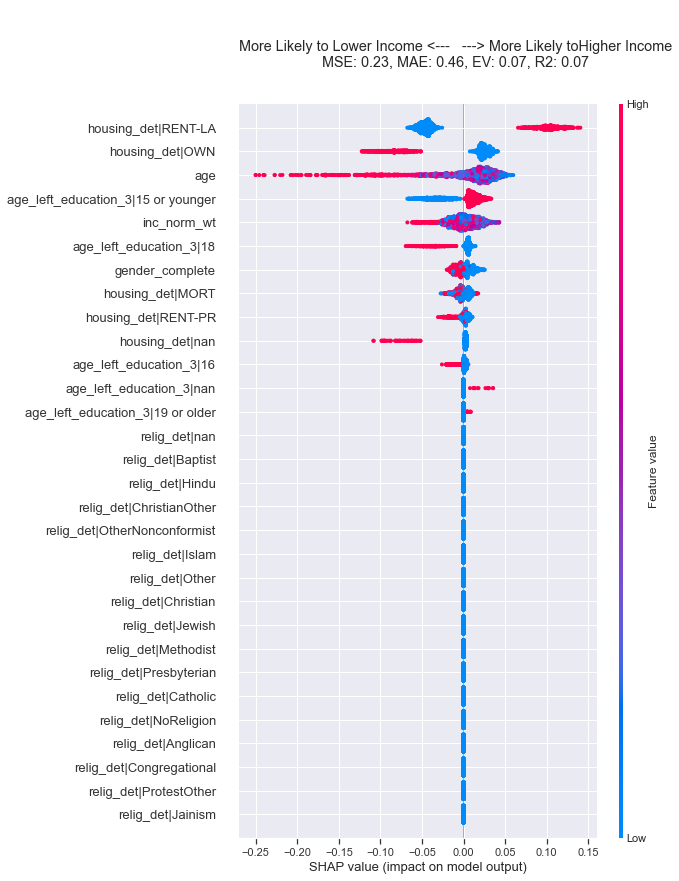

***************************
1979
***************************
MSE: 0.24, MAE: 0.49, EV: 0.01, R2: 0.01


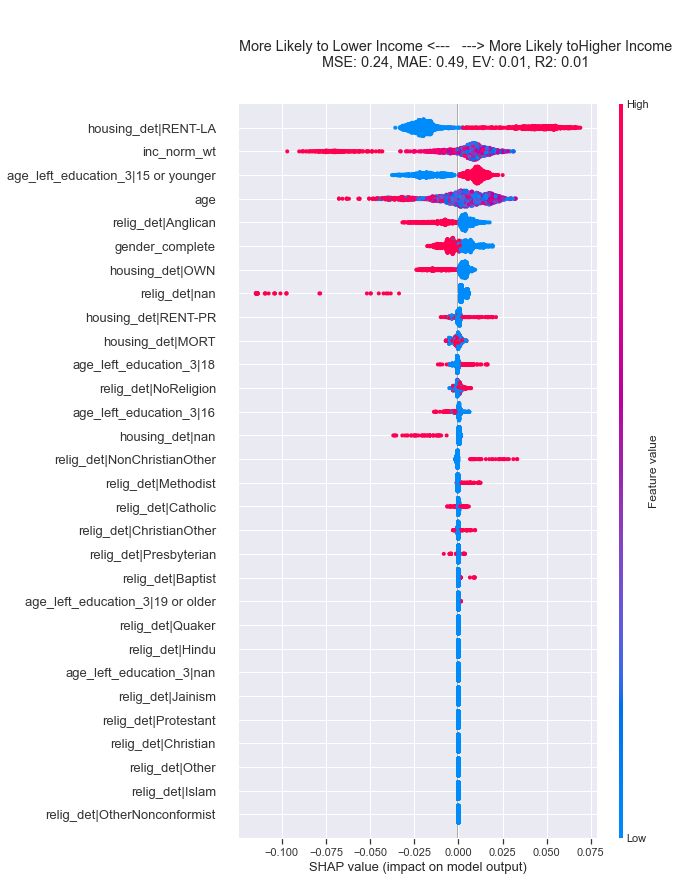

***************************
1983
***************************
MSE: 0.24, MAE: 0.48, EV: 0.04, R2: 0.04


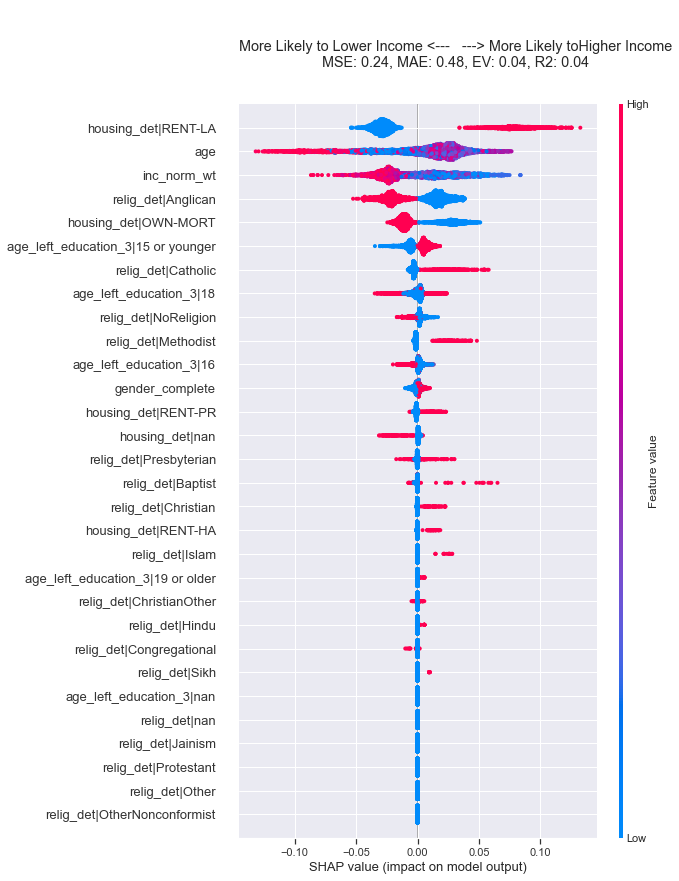

***************************
1987
***************************
MSE: 0.23, MAE: 0.46, EV: 0.08, R2: 0.08


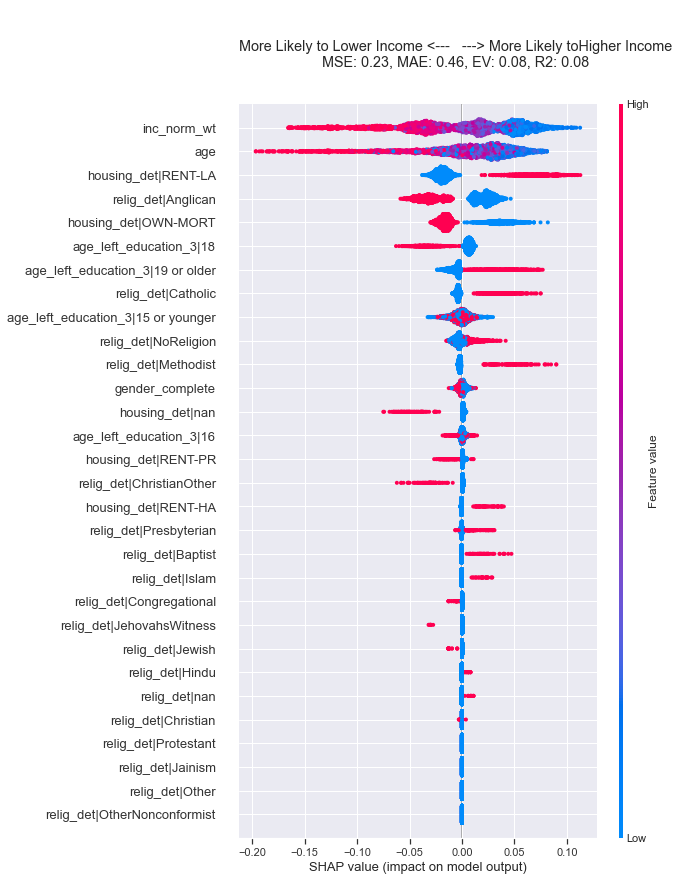

***************************
1992
***************************
MSE: 0.23, MAE: 0.47, EV: 0.07, R2: 0.07


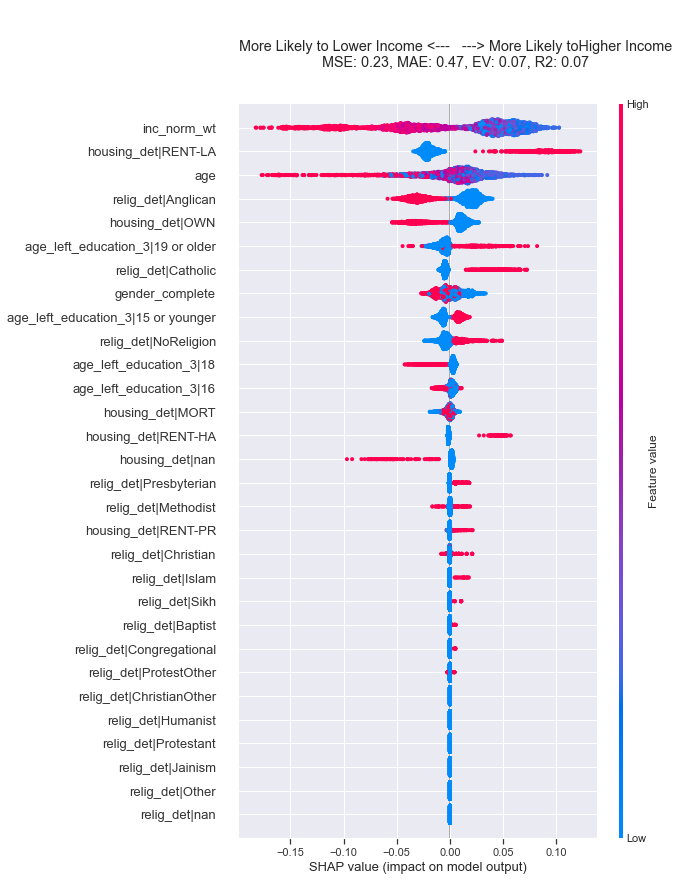

***************************
1997
***************************
MSE: 0.24, MAE: 0.47, EV: 0.03, R2: 0.03


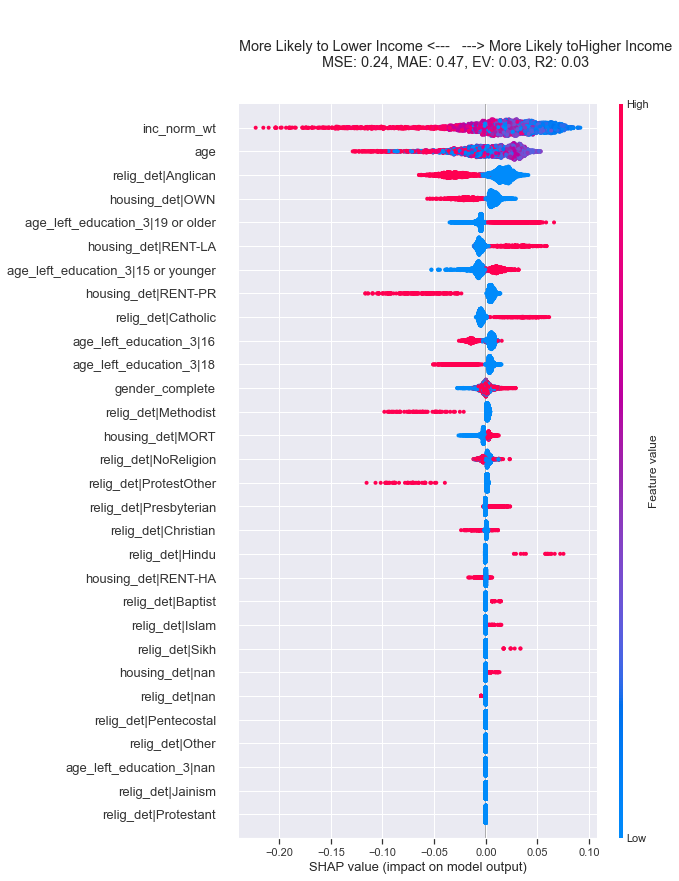

***************************
2001
***************************
MSE: 0.24, MAE: 0.48, EV: 0.04, R2: 0.04


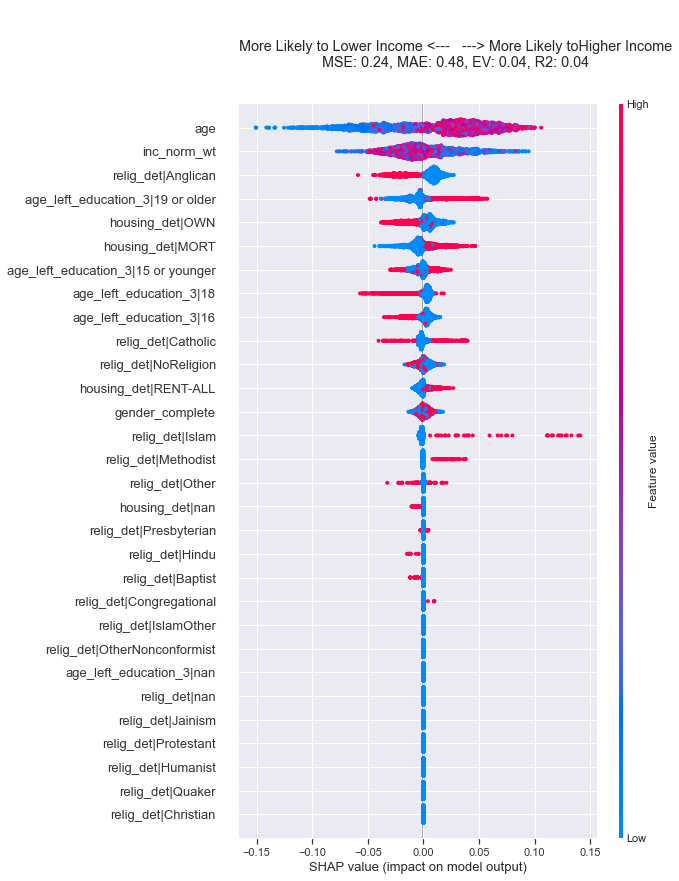

***************************
2005
***************************
MSE: 0.24, MAE: 0.48, EV: 0.03, R2: 0.03


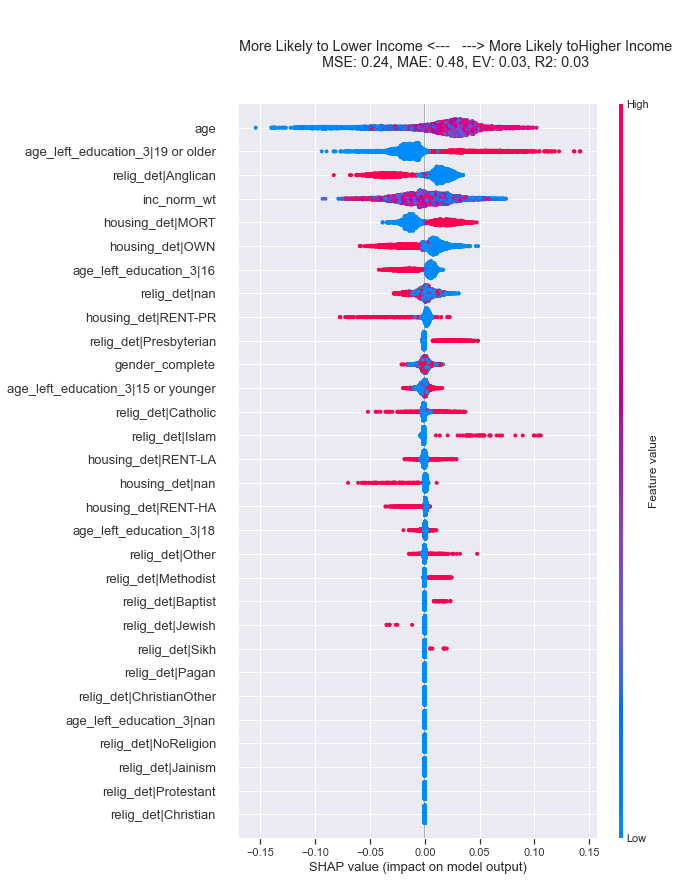

***************************
2010
***************************
MSE: 0.24, MAE: 0.48, EV: 0.04, R2: 0.04


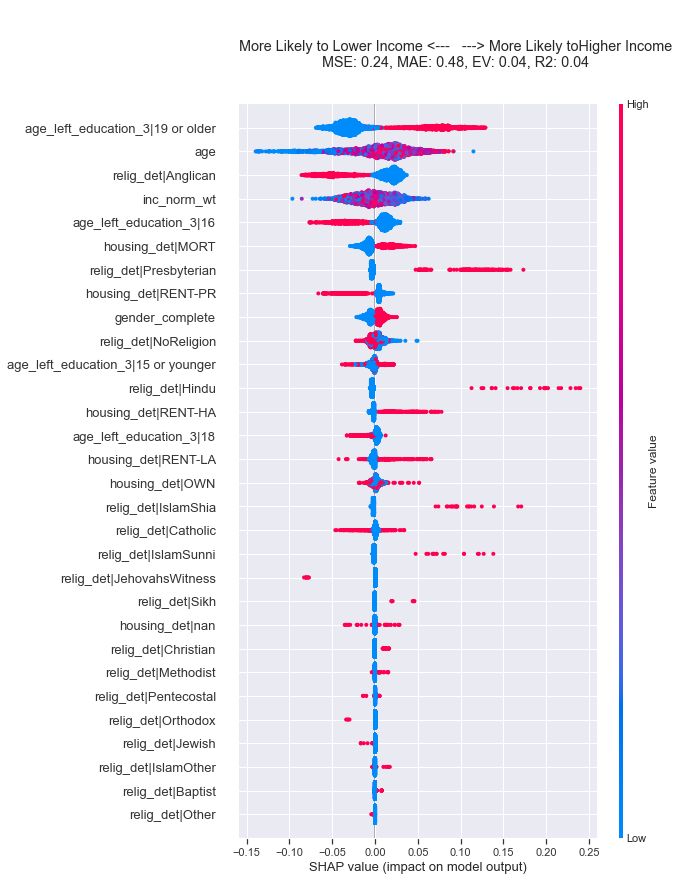

***************************
2015
***************************
MSE: 0.22, MAE: 0.44, EV: 0.03, R2: 0.03


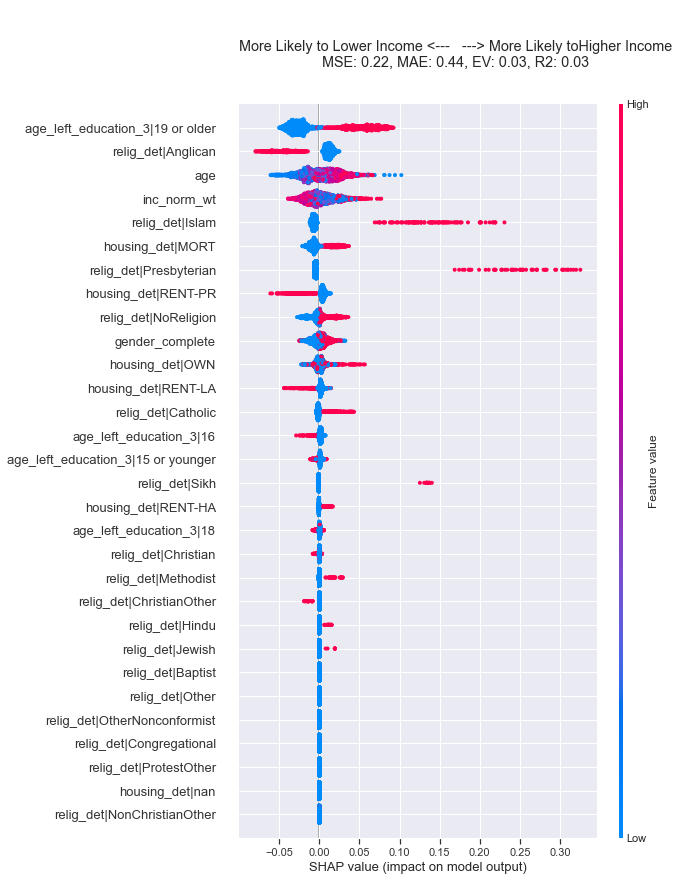

***************************
2017
***************************
MSE: 0.24, MAE: 0.47, EV: 0.04, R2: 0.04


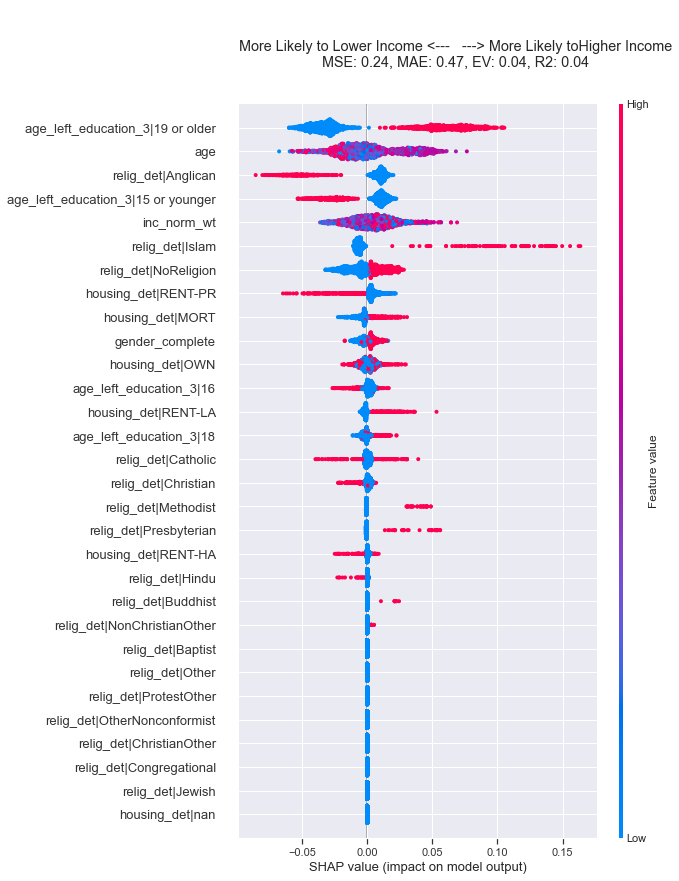

***************************
2019
***************************
MSE: 0.22, MAE: 0.44, EV: 0.10, R2: 0.09


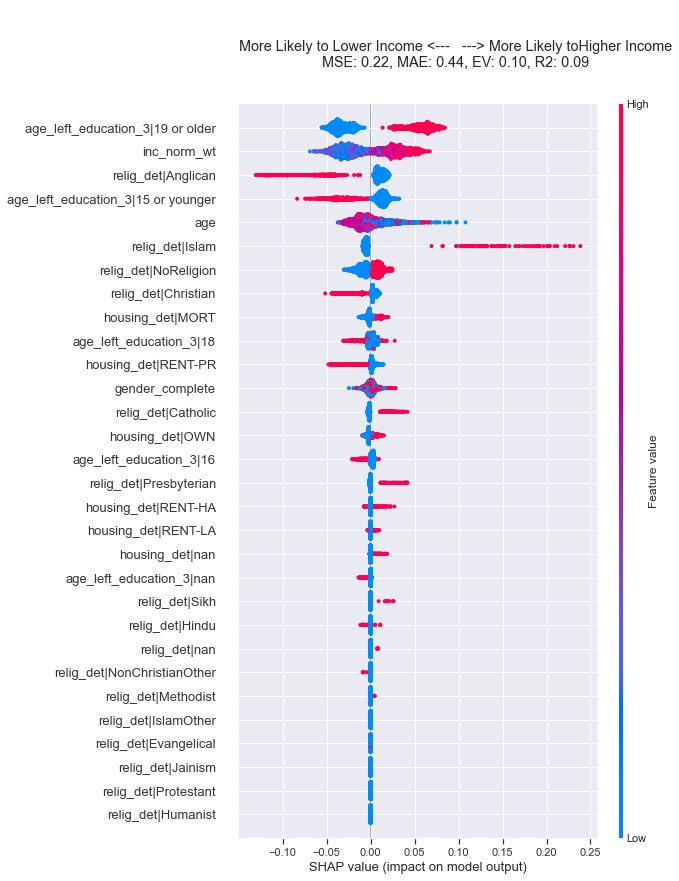

DNV
***************************
1959
***************************
MSE: 0.11, MAE: 0.24, EV: 0.07, R2: 0.06


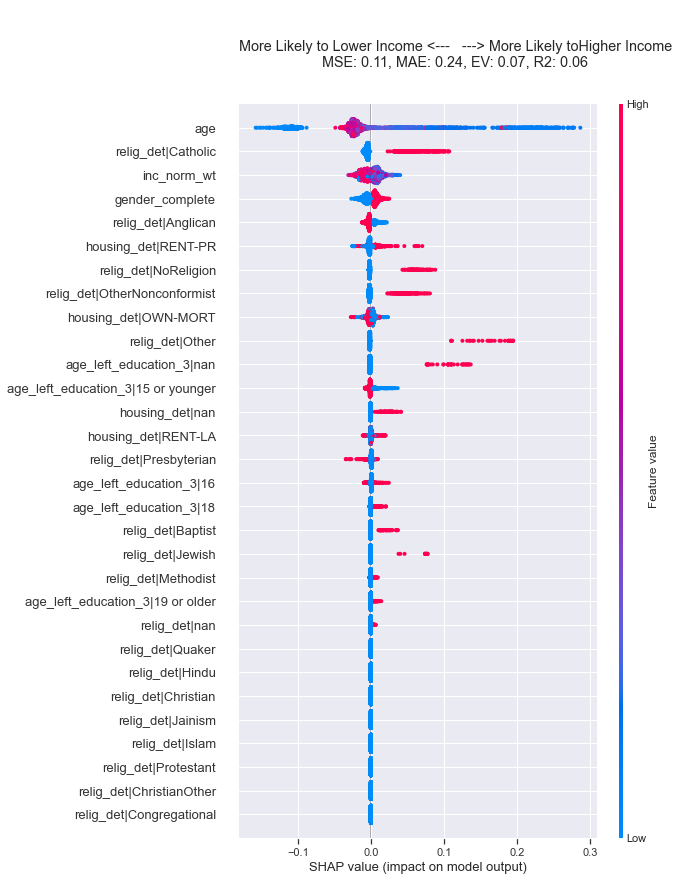

***************************
1964
***************************
MSE: 0.10, MAE: 0.21, EV: -0.02, R2: -0.03


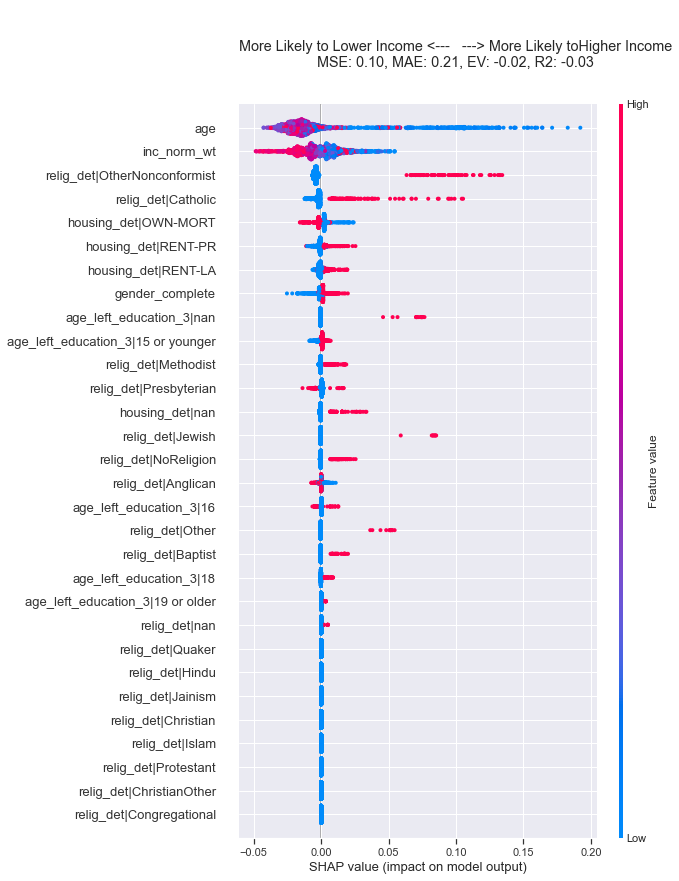

***************************
1966
***************************
MSE: 0.12, MAE: 0.24, EV: 0.04, R2: 0.04


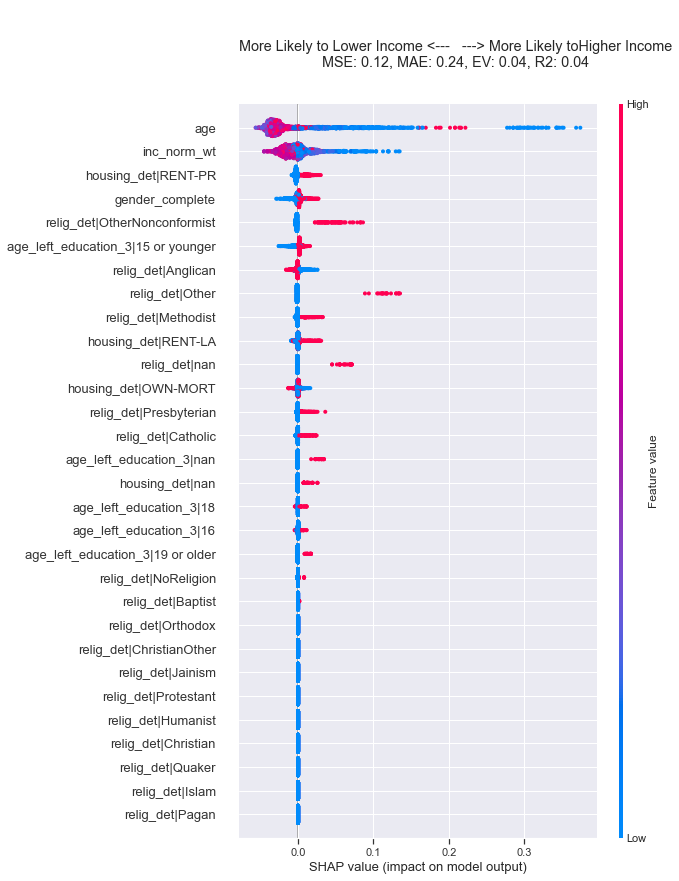

***************************
1970
***************************
MSE: 0.14, MAE: 0.29, EV: -0.01, R2: -0.02


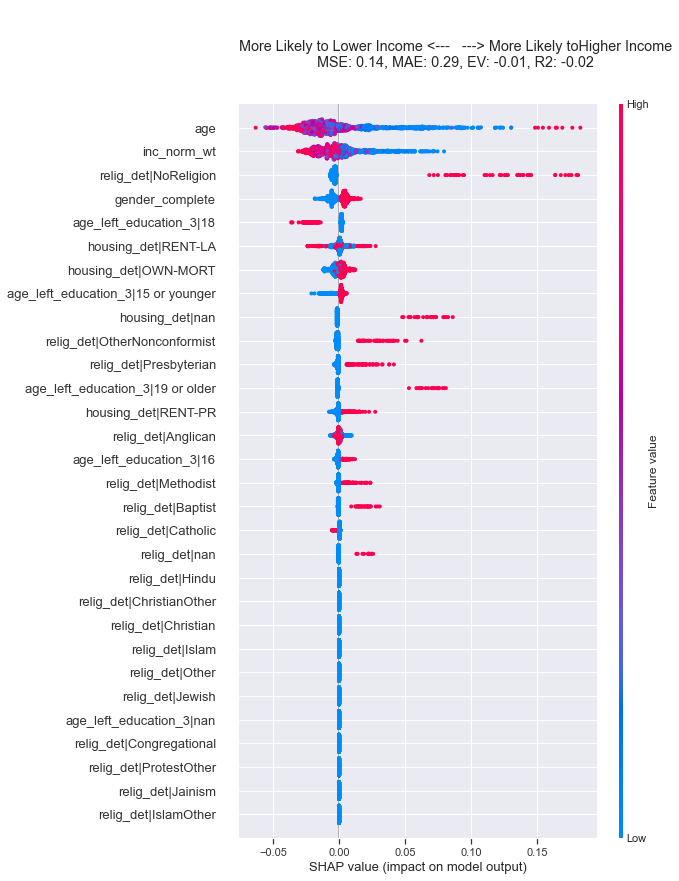

***************************
1974_oct
***************************
MSE: 0.12, MAE: 0.25, EV: 0.04, R2: 0.03


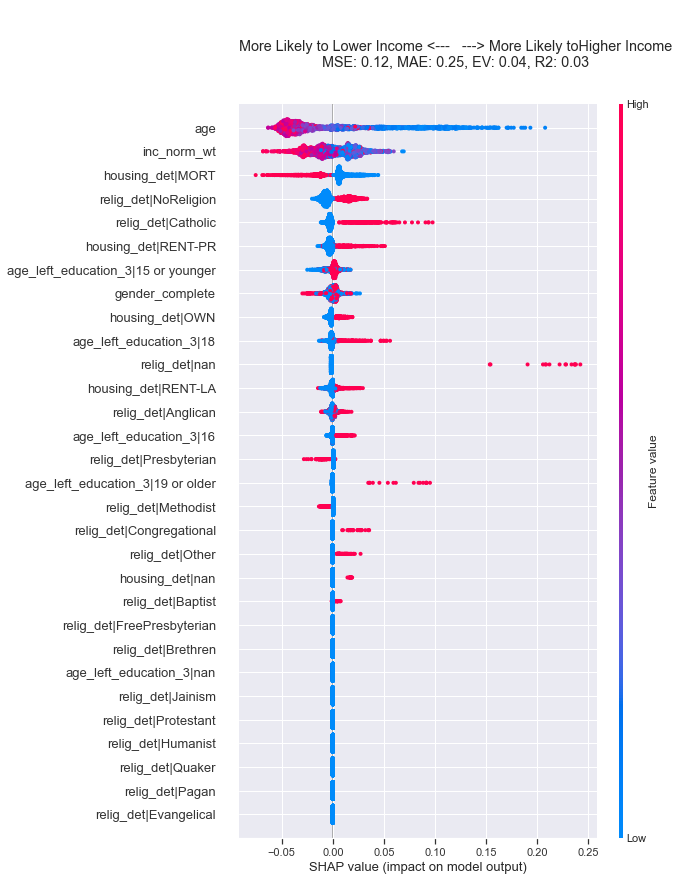

***************************
1974_feb
***************************
MSE: 0.11, MAE: 0.22, EV: 0.02, R2: 0.01


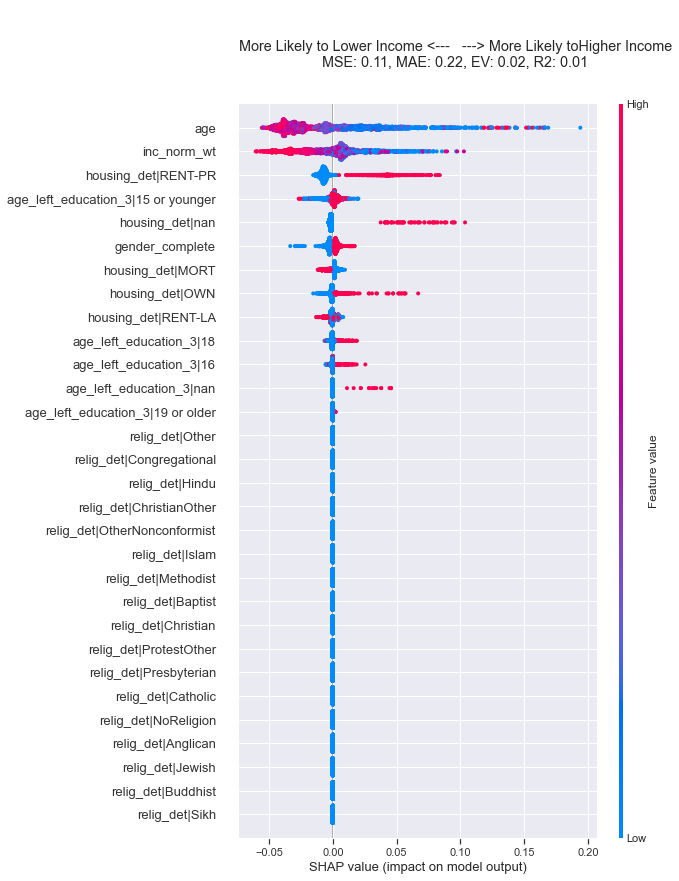

***************************
1979
***************************
MSE: 0.12, MAE: 0.25, EV: 0.07, R2: 0.07


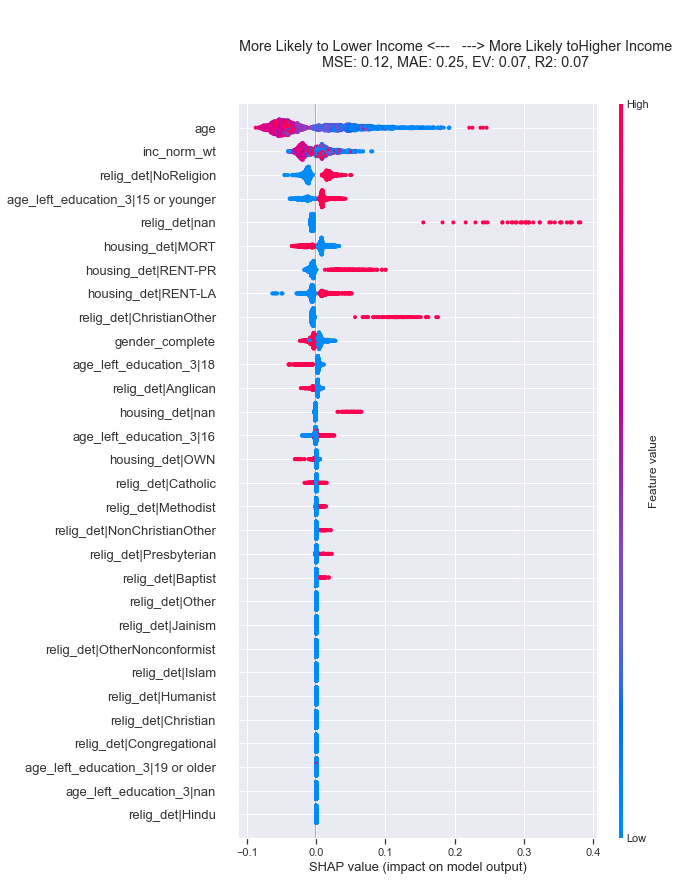

***************************
1983
***************************
MSE: 0.14, MAE: 0.28, EV: 0.02, R2: 0.02


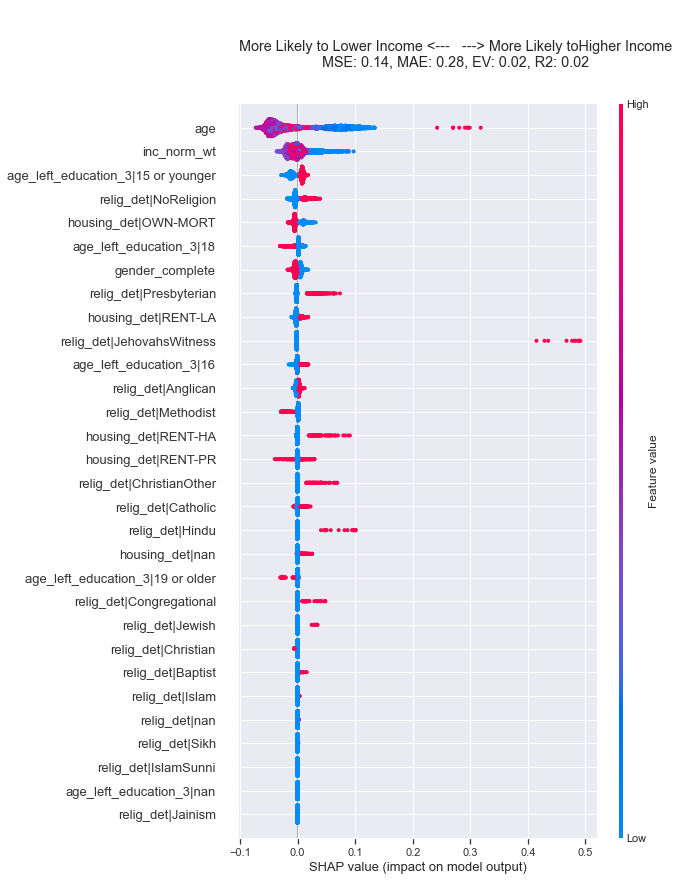

***************************
1987
***************************
MSE: 0.12, MAE: 0.25, EV: 0.03, R2: 0.03


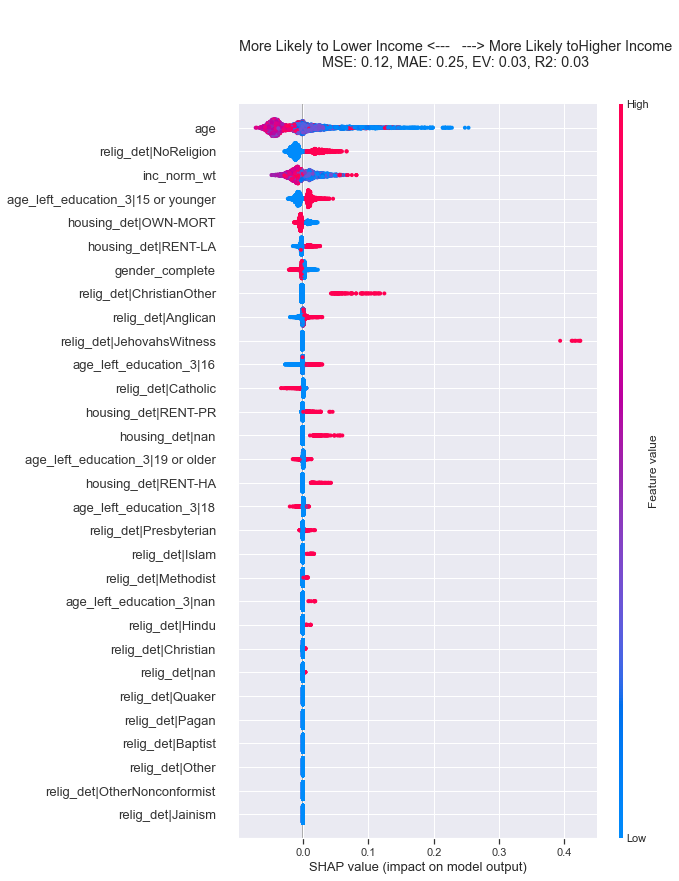

***************************
1992
***************************
MSE: 0.11, MAE: 0.24, EV: 0.04, R2: 0.03


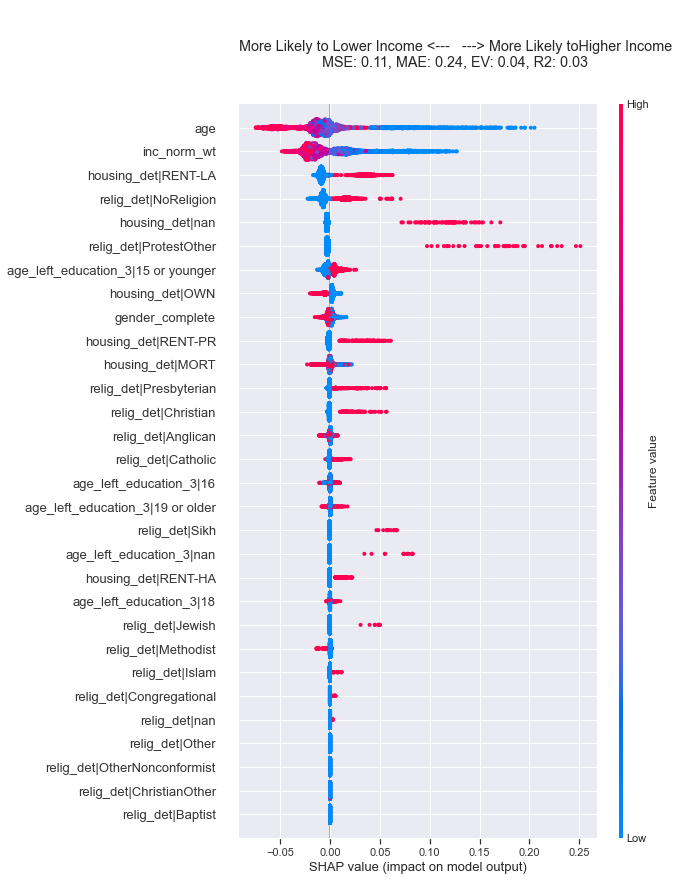

***************************
1997
***************************
MSE: 0.14, MAE: 0.29, EV: 0.05, R2: 0.05


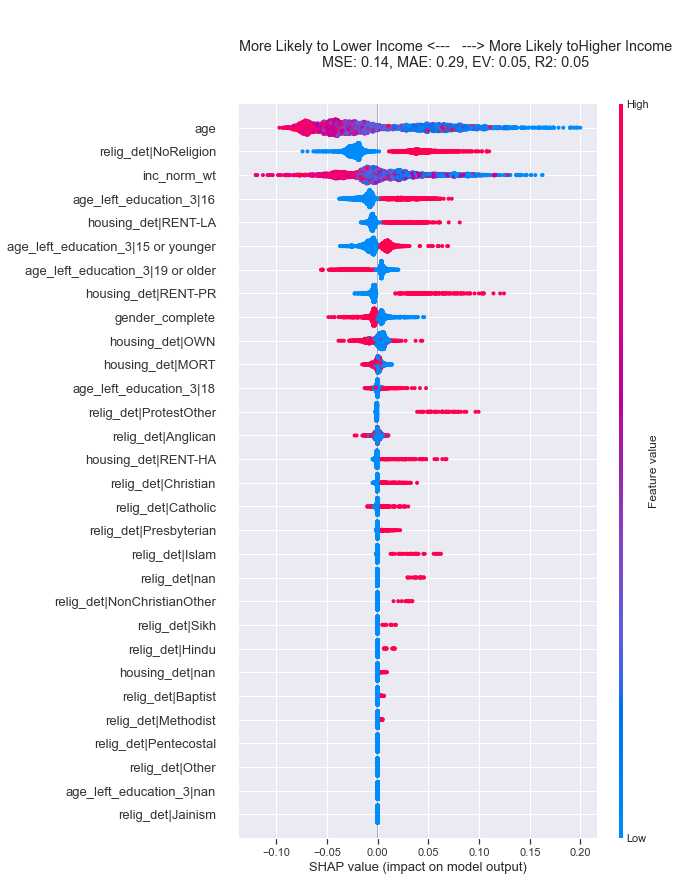

***************************
2001
***************************
MSE: 0.18, MAE: 0.37, EV: 0.10, R2: 0.10


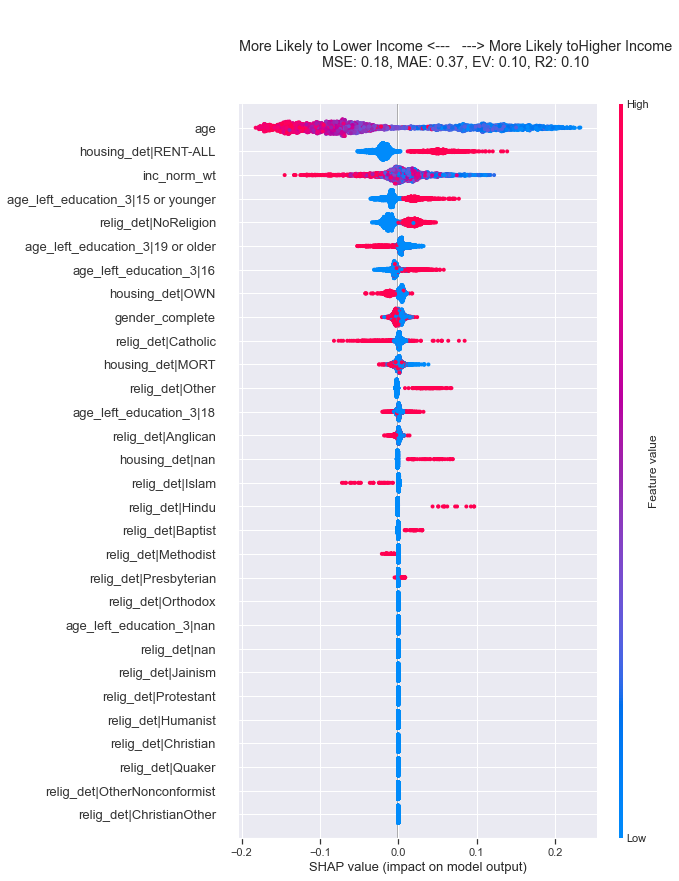

***************************
2005
***************************
MSE: 0.17, MAE: 0.35, EV: 0.13, R2: 0.12


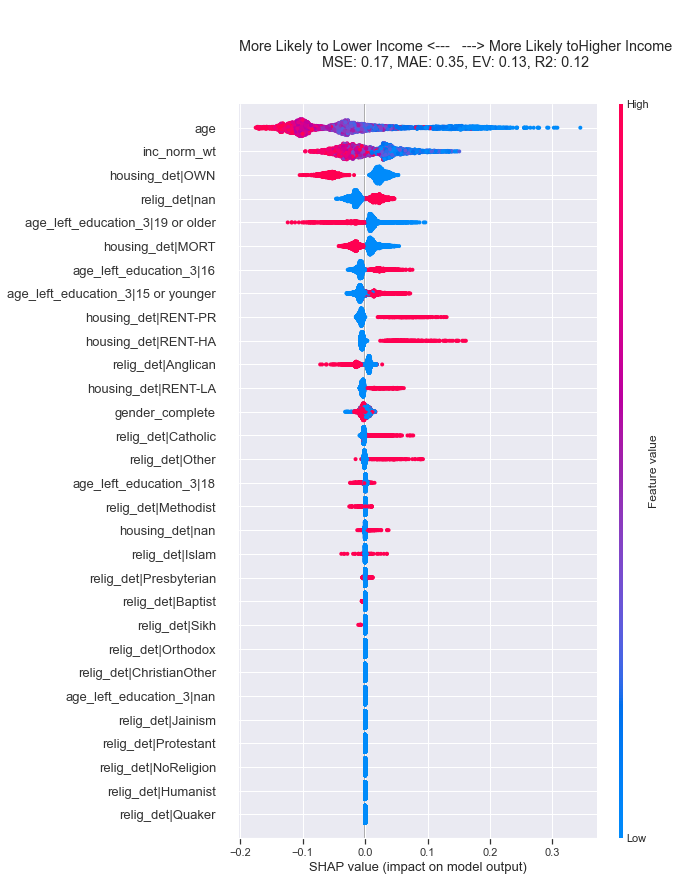

***************************
2010
***************************
MSE: 0.15, MAE: 0.31, EV: 0.12, R2: 0.12


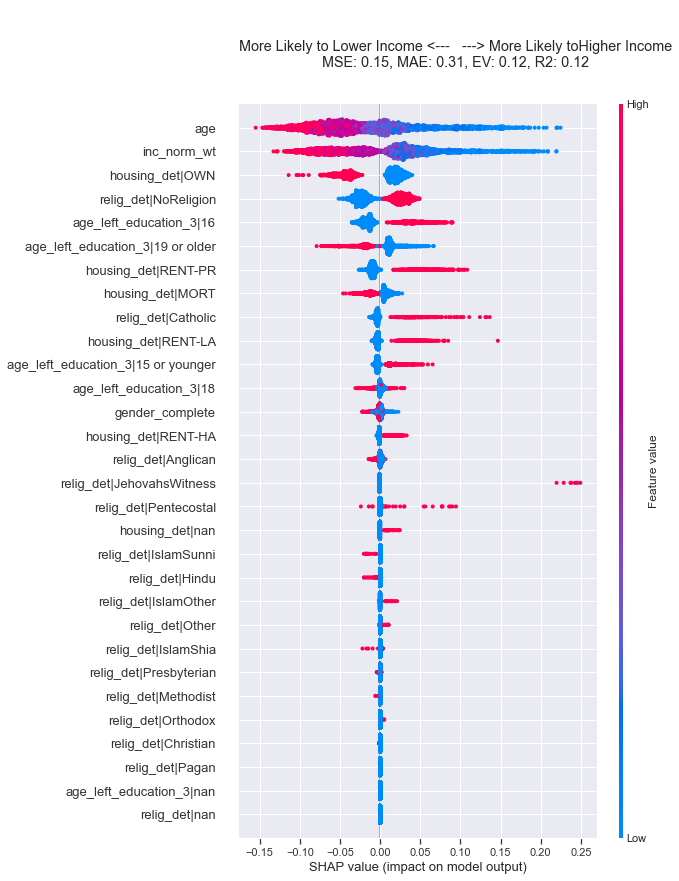

***************************
2015
***************************
MSE: 0.17, MAE: 0.34, EV: 0.17, R2: 0.15


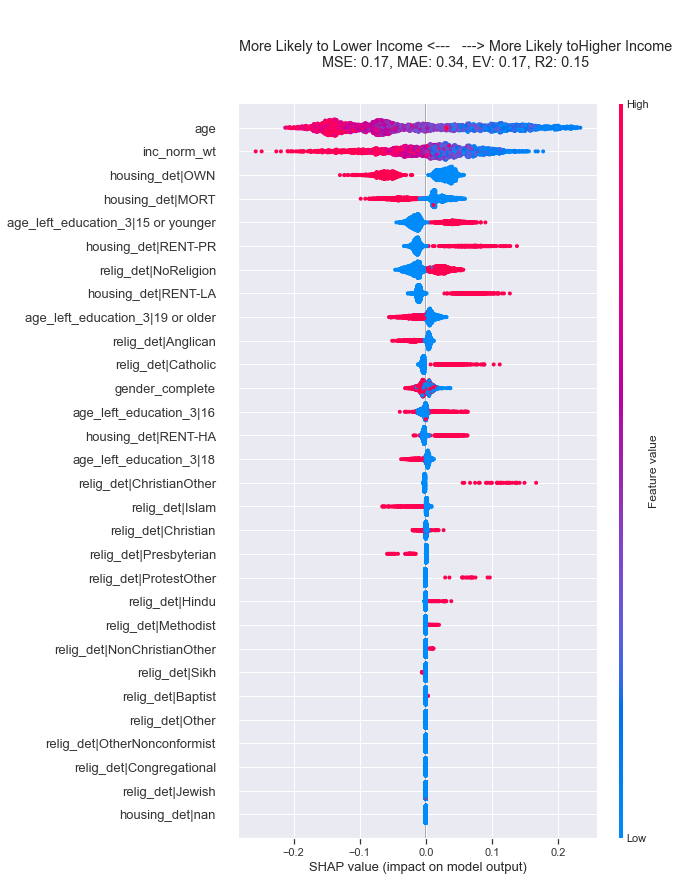

***************************
2017
***************************
MSE: 0.15, MAE: 0.32, EV: 0.14, R2: 0.12


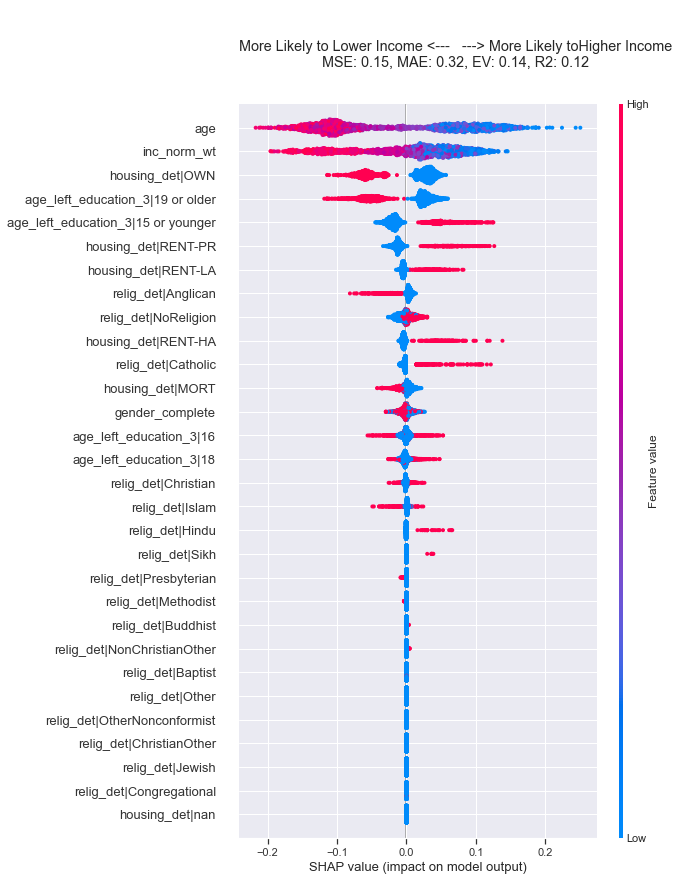

***************************
2019
***************************
MSE: 0.16, MAE: 0.33, EV: 0.10, R2: 0.04


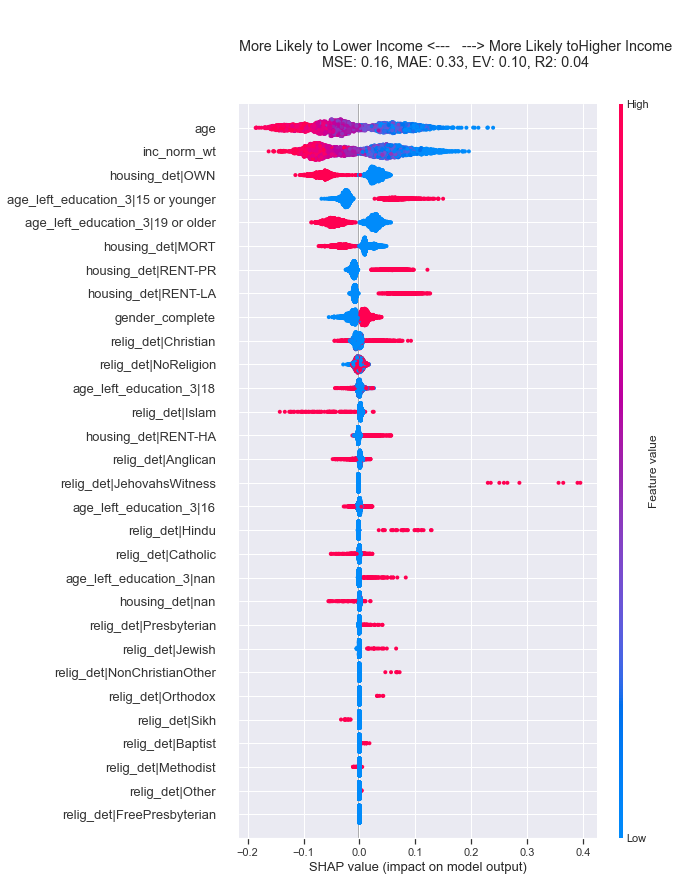

In [50]:
generic_cols = f2f_harmonised.columns
drop_vars = []
for target in ["AuthRight","LibLeft","DNV"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in f2f_harmonised["dataset"].unique()[::-1]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=False, drop_vars = drop_vars, harm_vars=harm_vars,
                          harmonised_only=True,min_features=30)

In [ ]:
# Anglican***, Presbyterian, NoReligion, Catholic, Methodist, Baptist,
# maybe "Christian" (from 1997), Islam (from 2015)

# Lib Left (Meth + oth non-conform, Catholic, NoReligion)
    # NonChristianOther, Methodist switched by 1997, Catholic neutral/disp by 
    # Islam (from 2001!), big Hindu + in 2010 only,
    # Presbyterian from 2005 (presume -> SNP)
    
# DNV
    # Catholic, NoReligion (vhigh in 1970), NonConformist, Other, OtherNonConformist
    # Jehovah's Witnesses,ProtestOther,

AuthRight
***************************
1959
***************************
MSE: 0.19, MAE: 0.38, EV: 0.18, R2: 0.18


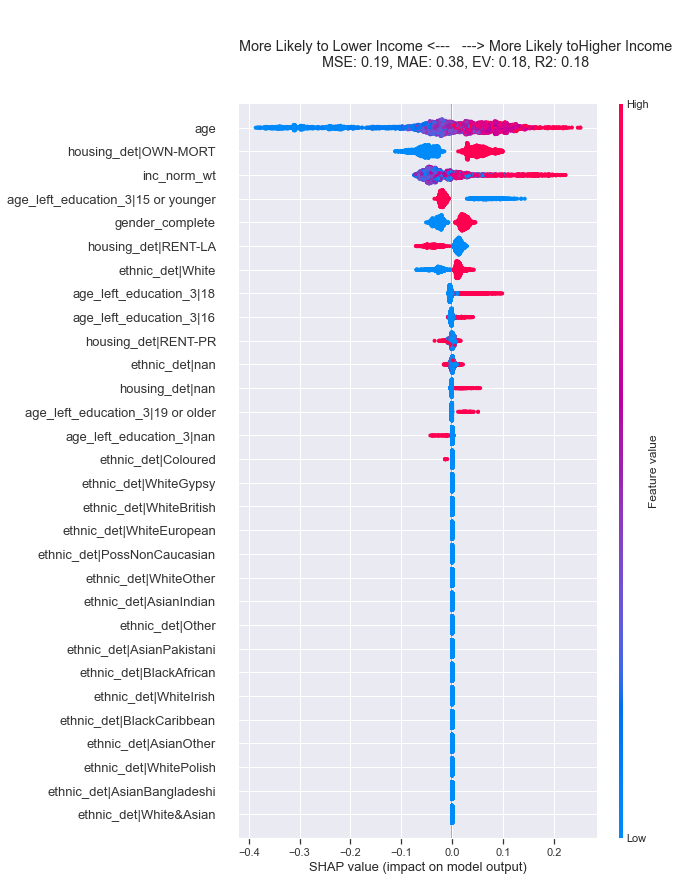

***************************
1964
***************************
MSE: 0.22, MAE: 0.43, EV: 0.10, R2: 0.10


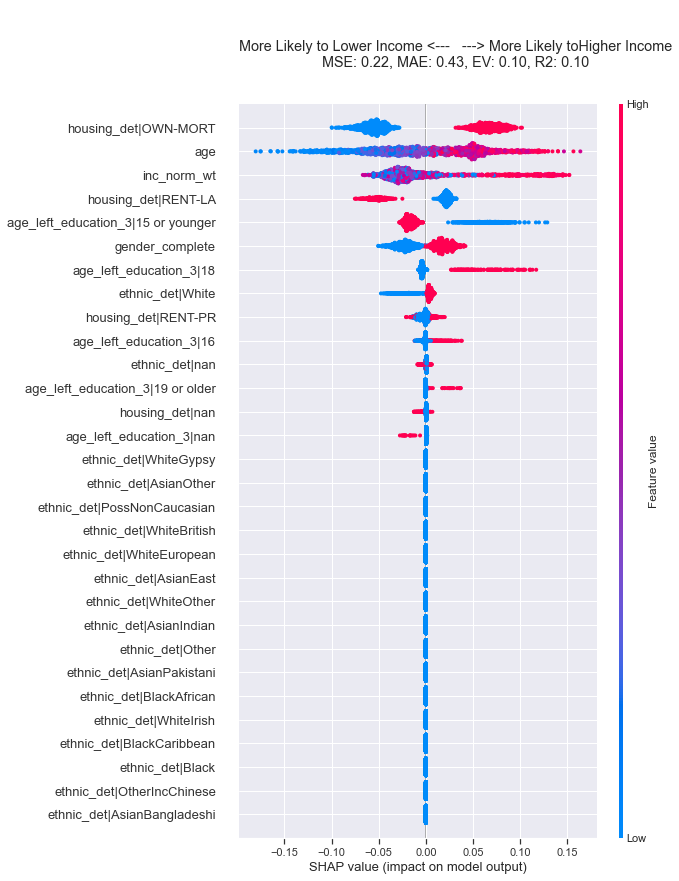

***************************
1966
***************************
MSE: 0.20, MAE: 0.41, EV: 0.11, R2: 0.11


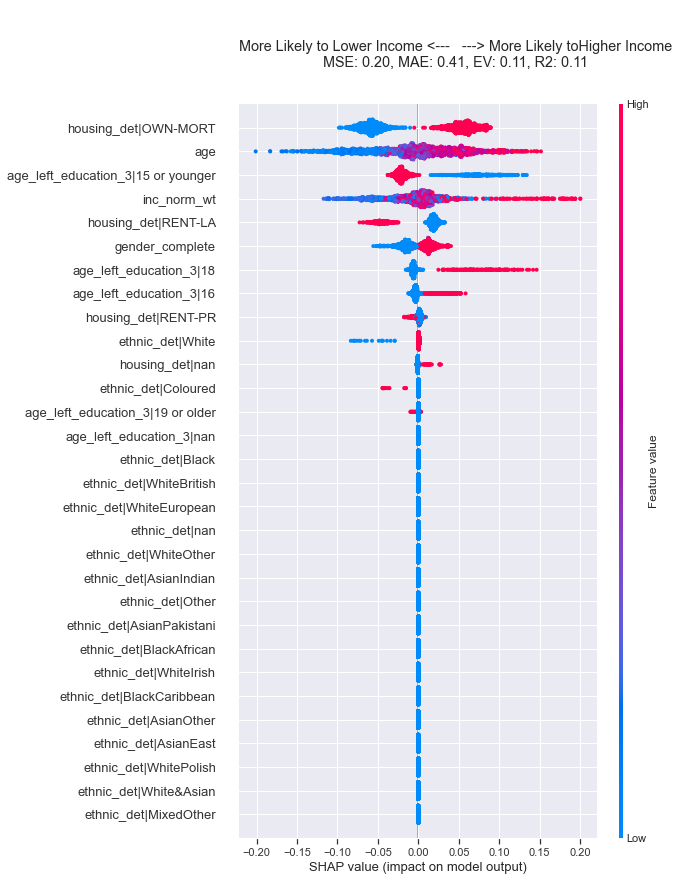

***************************
1970
***************************
MSE: 0.24, MAE: 0.47, EV: 0.02, R2: 0.02


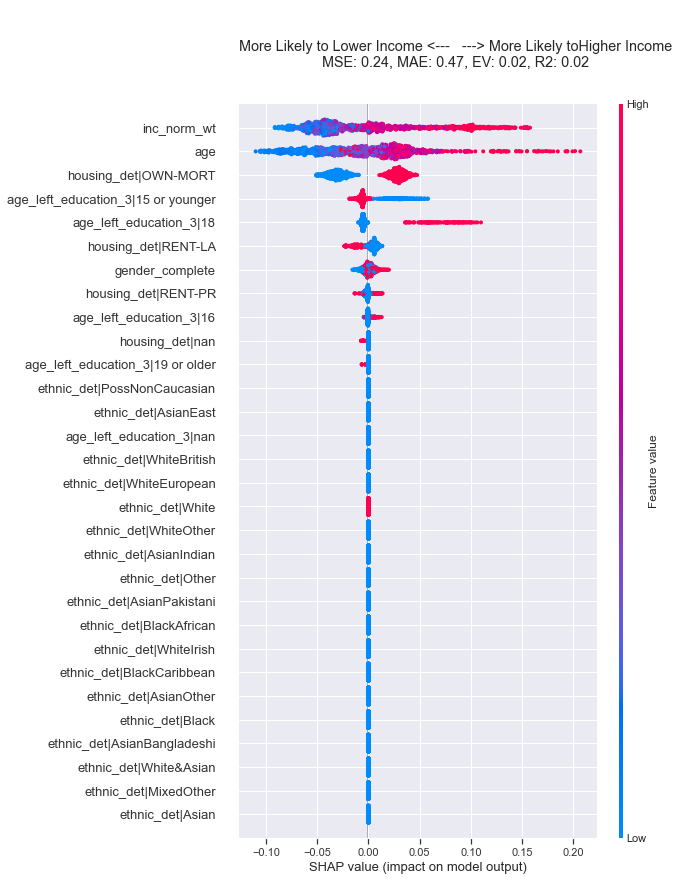

***************************
1974_oct
***************************
MSE: 0.20, MAE: 0.40, EV: 0.08, R2: 0.08


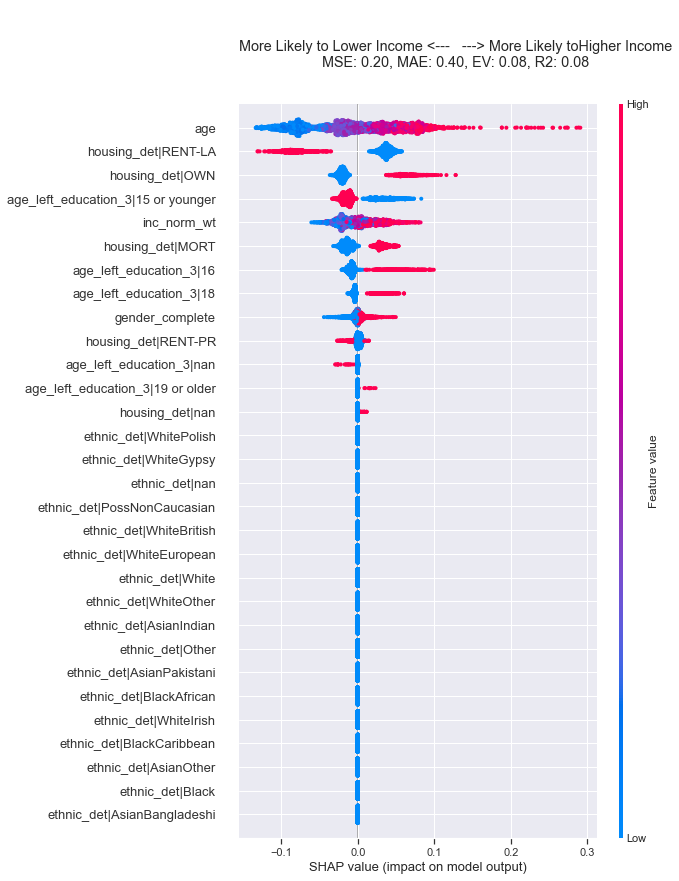

***************************
1974_feb
***************************
MSE: 0.20, MAE: 0.41, EV: 0.08, R2: 0.08


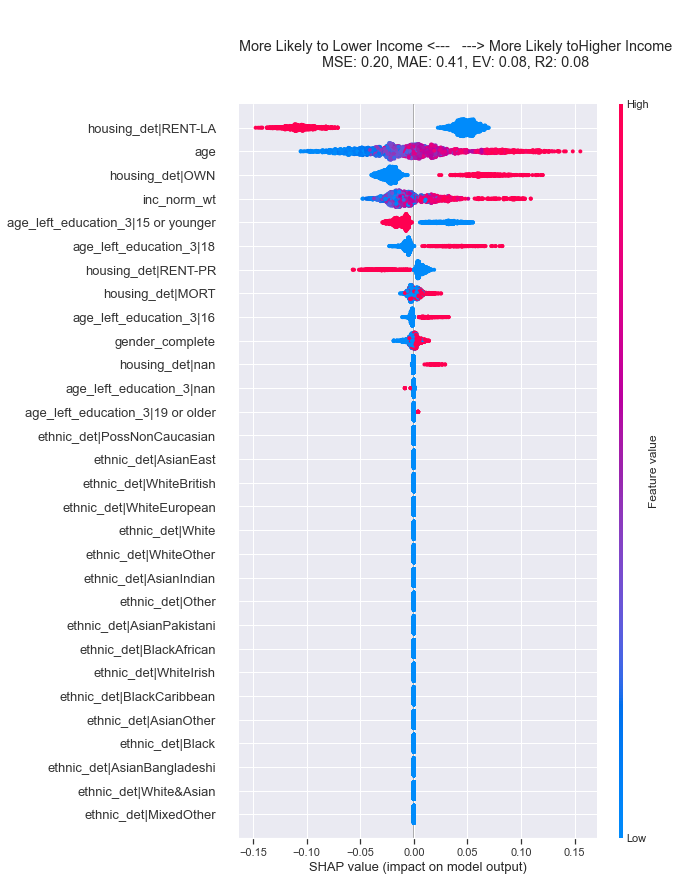

***************************
1979
***************************
MSE: 0.22, MAE: 0.45, EV: 0.08, R2: 0.08


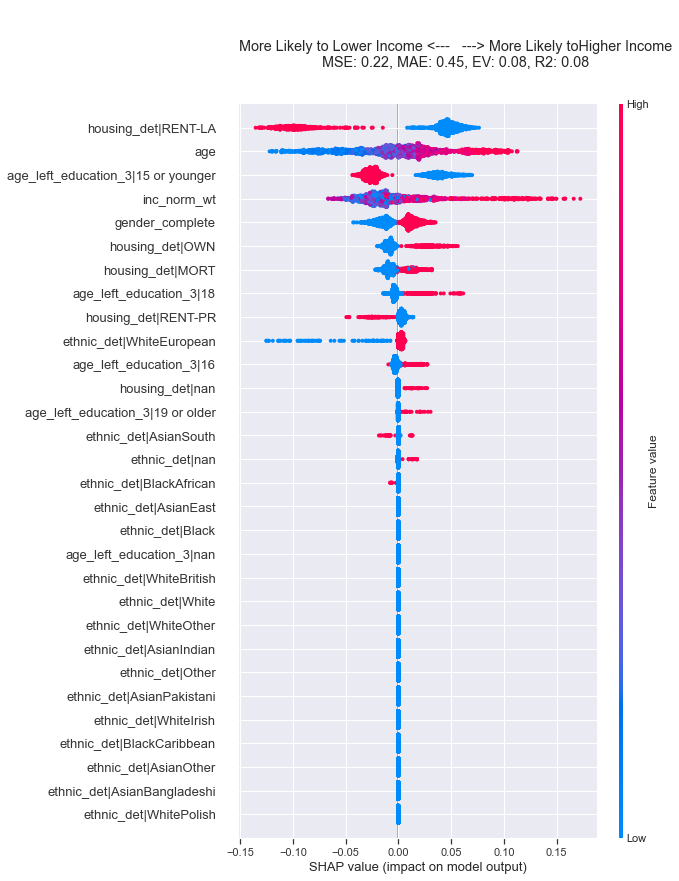

***************************
1983
***************************
MSE: 0.22, MAE: 0.43, EV: 0.08, R2: 0.08


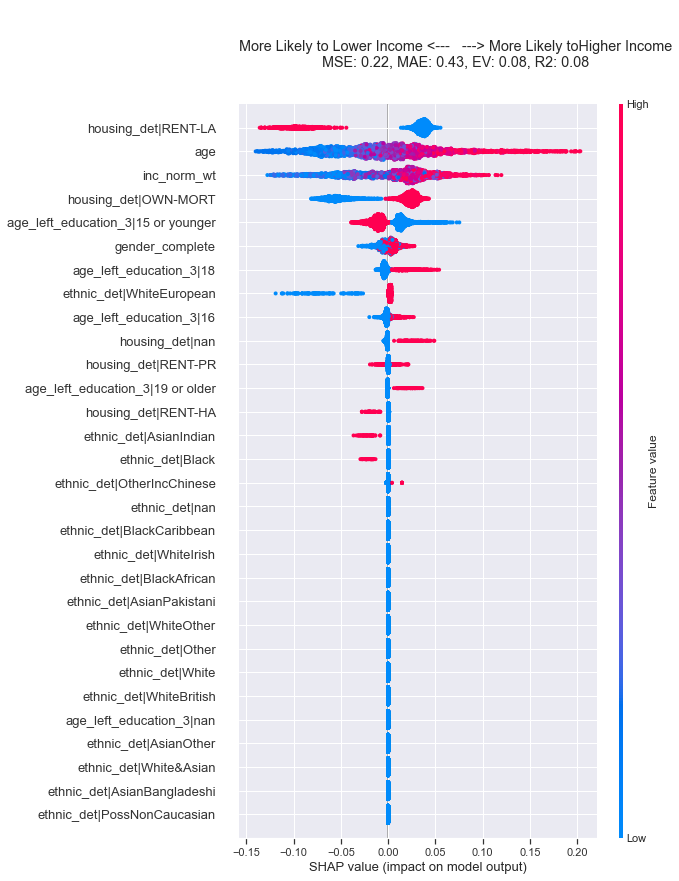

***************************
1987
***************************
MSE: 0.21, MAE: 0.43, EV: 0.10, R2: 0.10


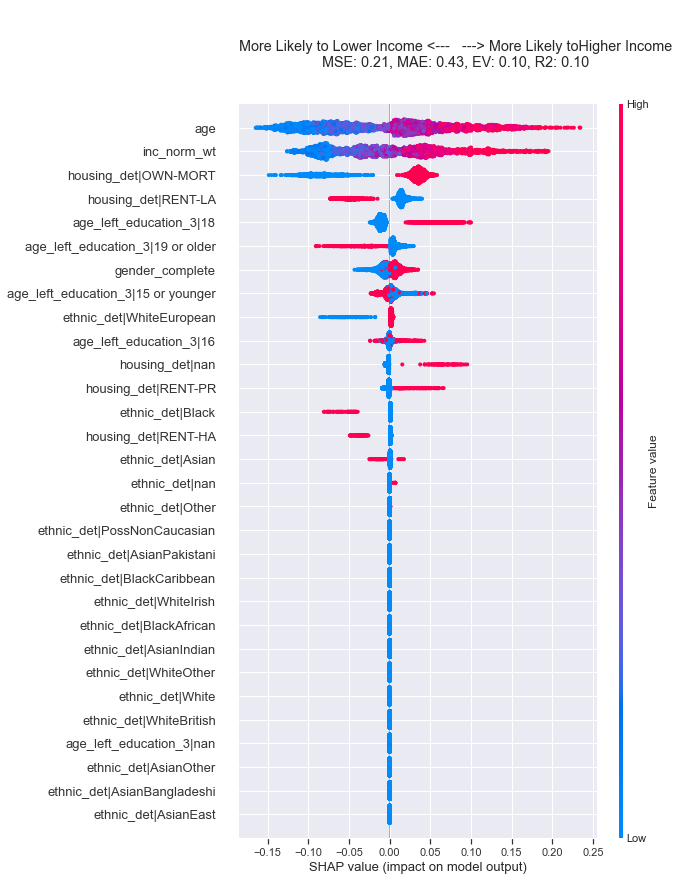

***************************
1992
***************************
MSE: 0.20, MAE: 0.41, EV: 0.13, R2: 0.13


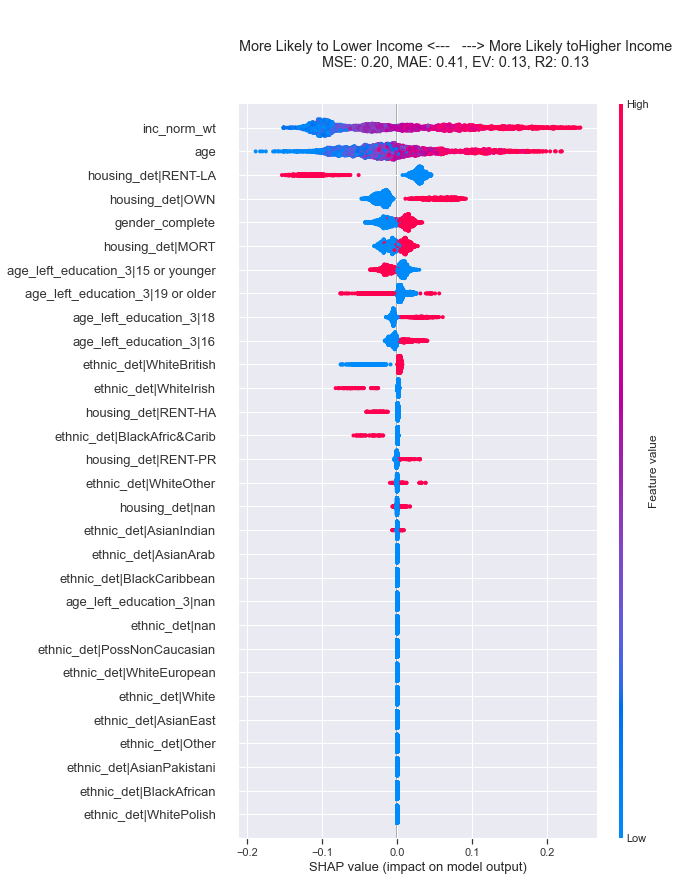

***************************
1997
***************************
MSE: 0.16, MAE: 0.33, EV: 0.10, R2: 0.10


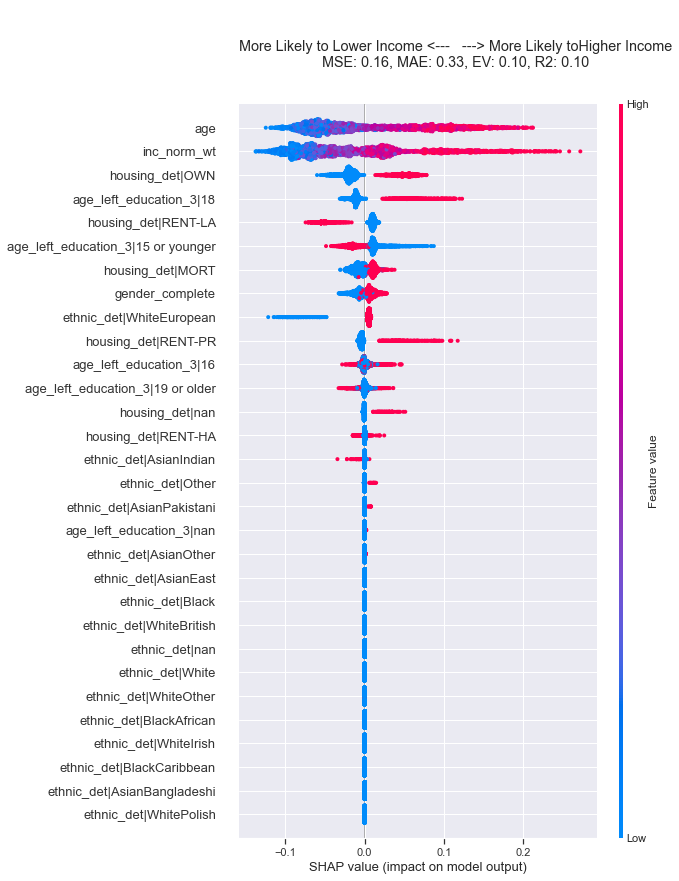

***************************
2001
***************************
MSE: 0.14, MAE: 0.31, EV: 0.07, R2: 0.05


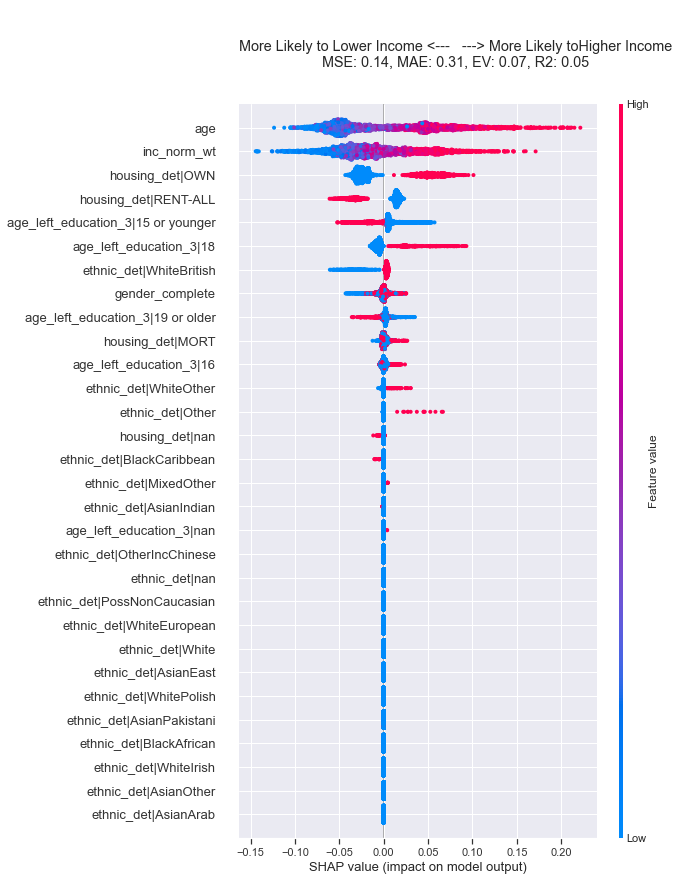

***************************
2005
***************************
MSE: 0.16, MAE: 0.34, EV: 0.08, R2: 0.07


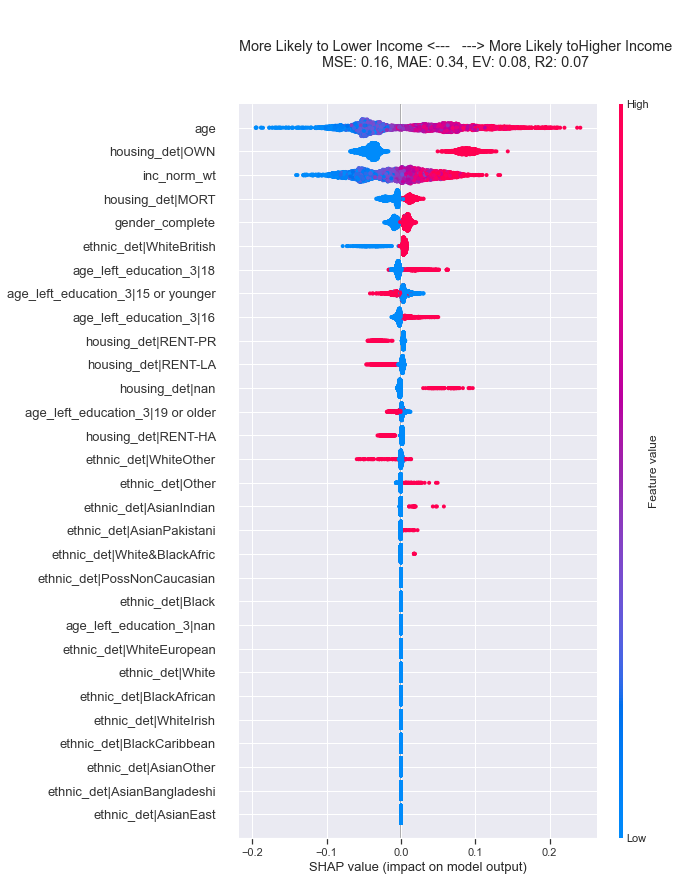

***************************
2010
***************************
MSE: 0.19, MAE: 0.39, EV: 0.08, R2: 0.08


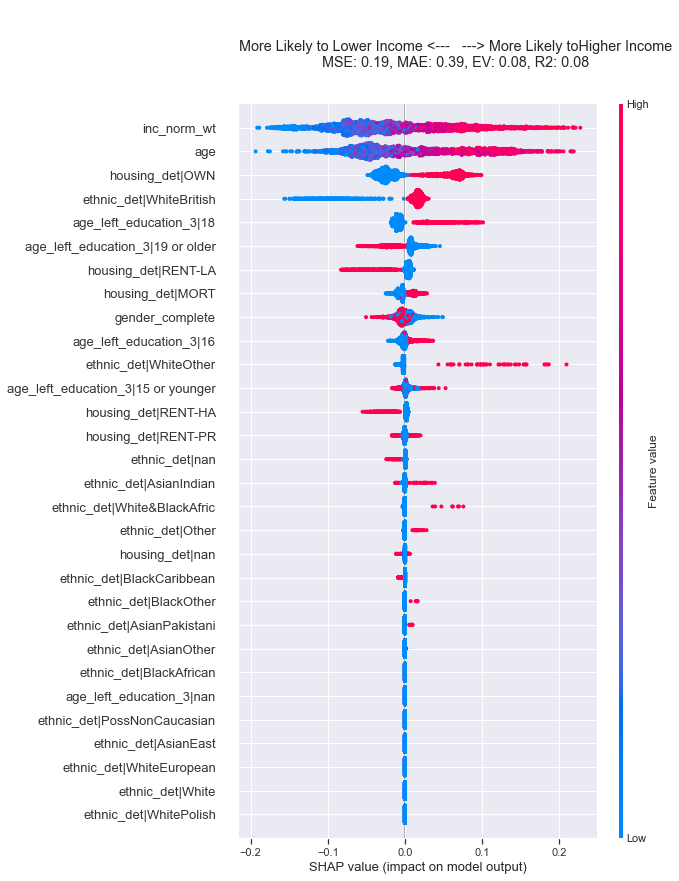

***************************
2015
***************************
MSE: 0.21, MAE: 0.41, EV: 0.11, R2: 0.11


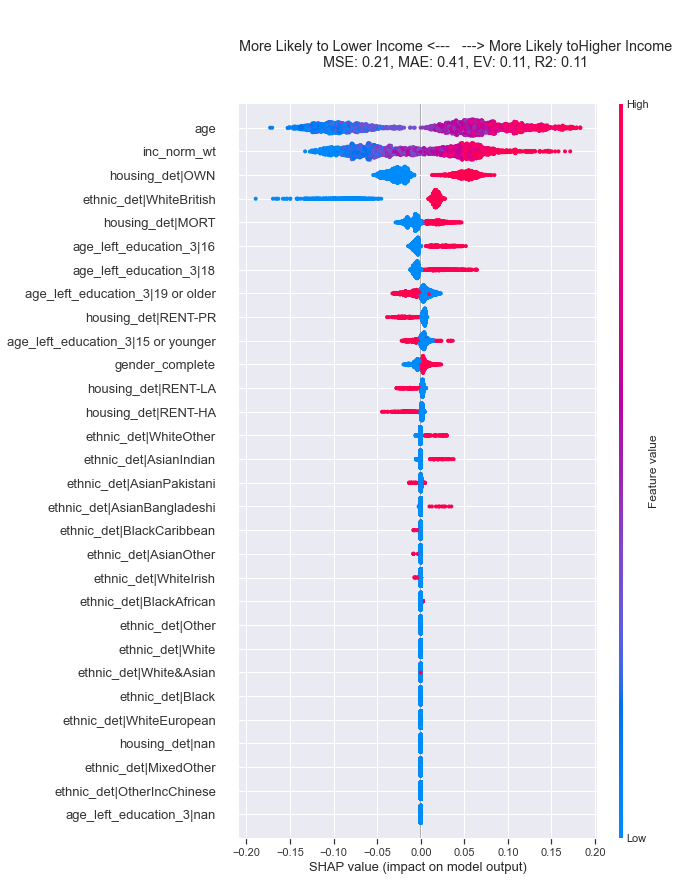

***************************
2017
***************************
MSE: 0.19, MAE: 0.39, EV: 0.13, R2: 0.13


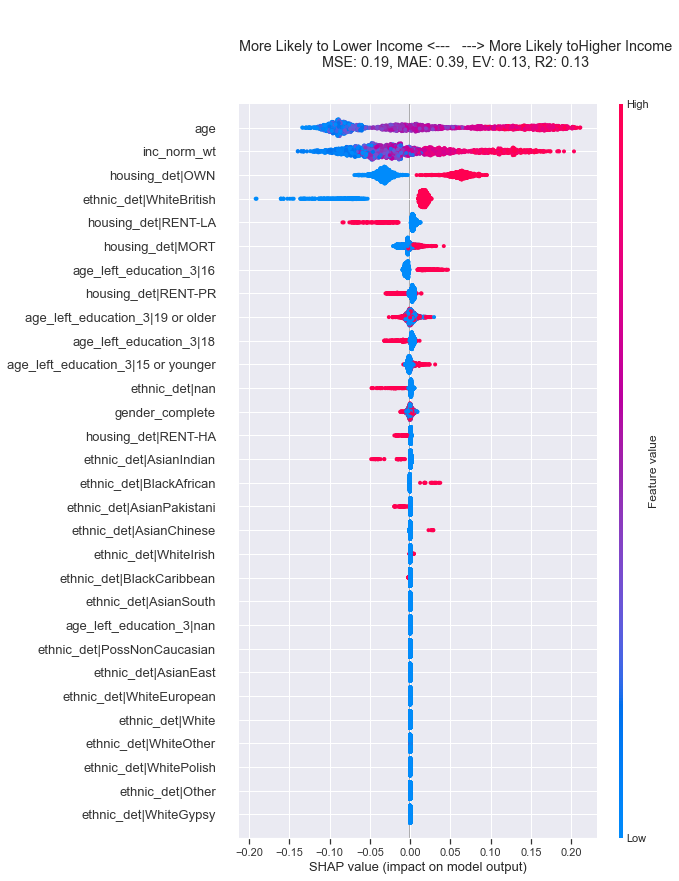

***************************
2019
***************************
MSE: 0.21, MAE: 0.43, EV: 0.10, R2: 0.10


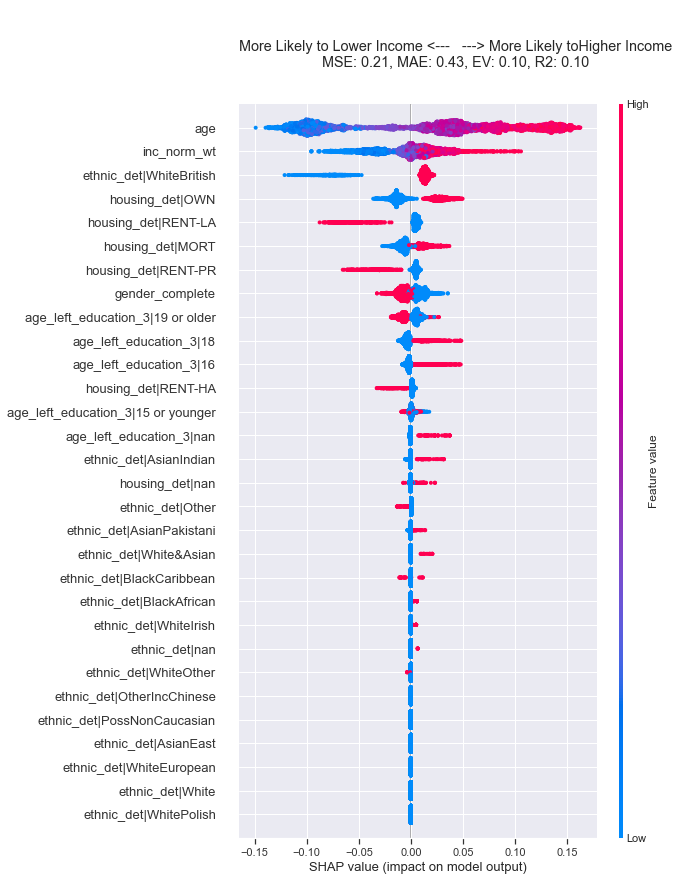

LibLeft
***************************
1959
***************************
MSE: 0.19, MAE: 0.39, EV: 0.18, R2: 0.18


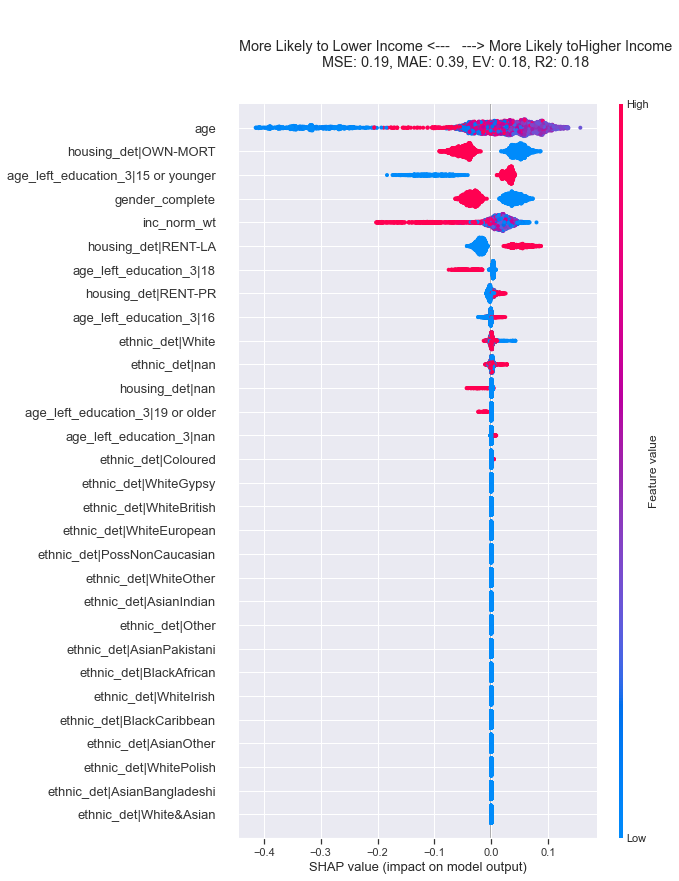

***************************
1964
***************************
MSE: 0.23, MAE: 0.46, EV: 0.07, R2: 0.07


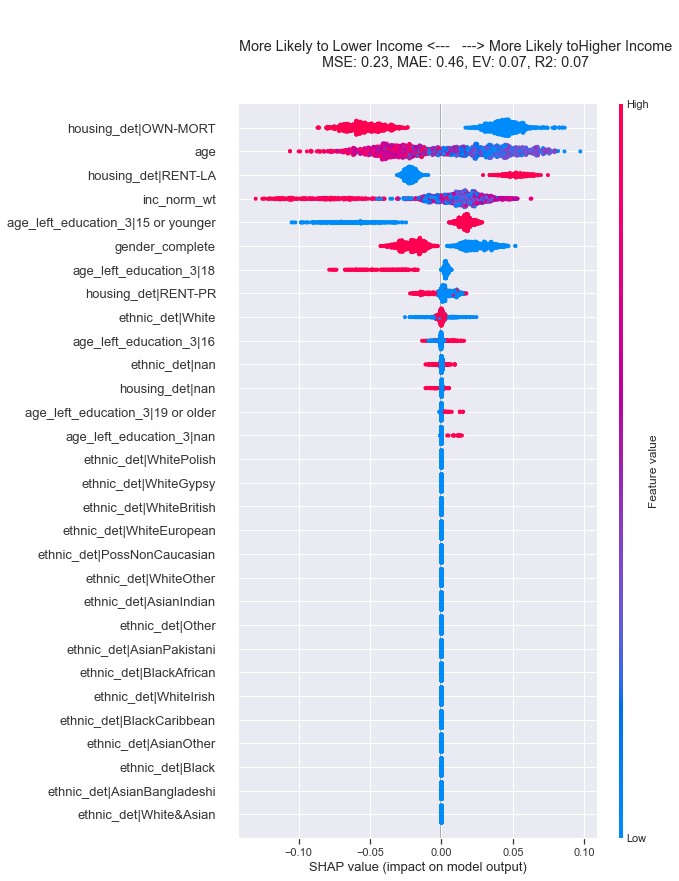

***************************
1966
***************************
MSE: 0.23, MAE: 0.46, EV: 0.07, R2: 0.07


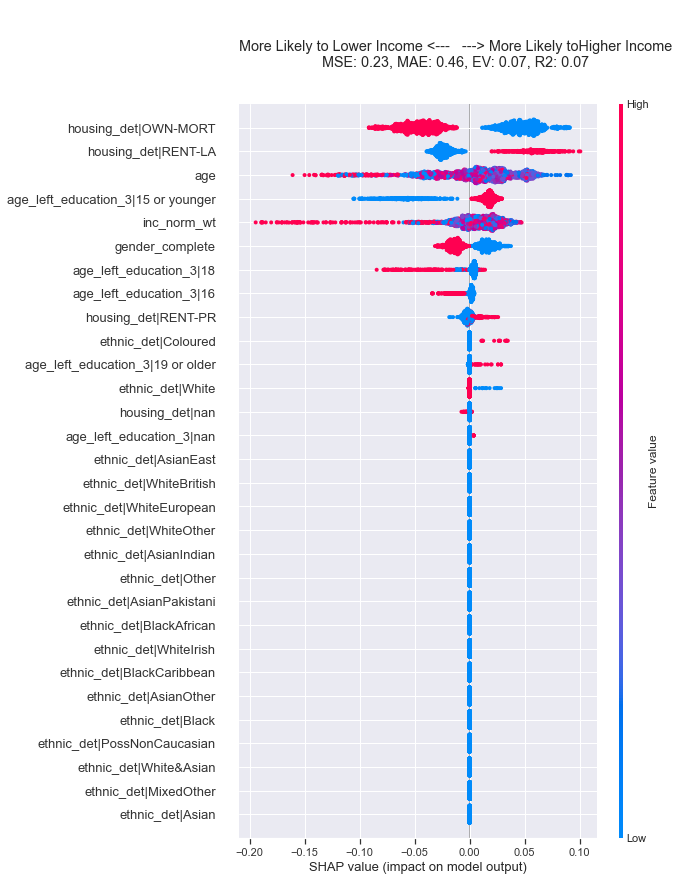

***************************
1970
***************************
MSE: 0.24, MAE: 0.48, EV: 0.02, R2: 0.02


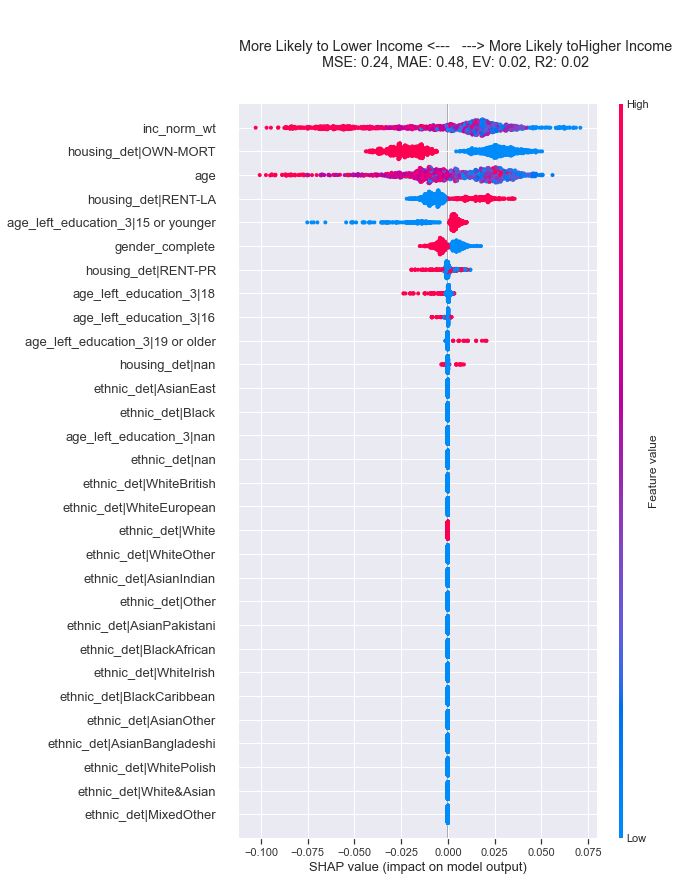

***************************
1974_oct
***************************
MSE: 0.24, MAE: 0.48, EV: 0.05, R2: 0.05


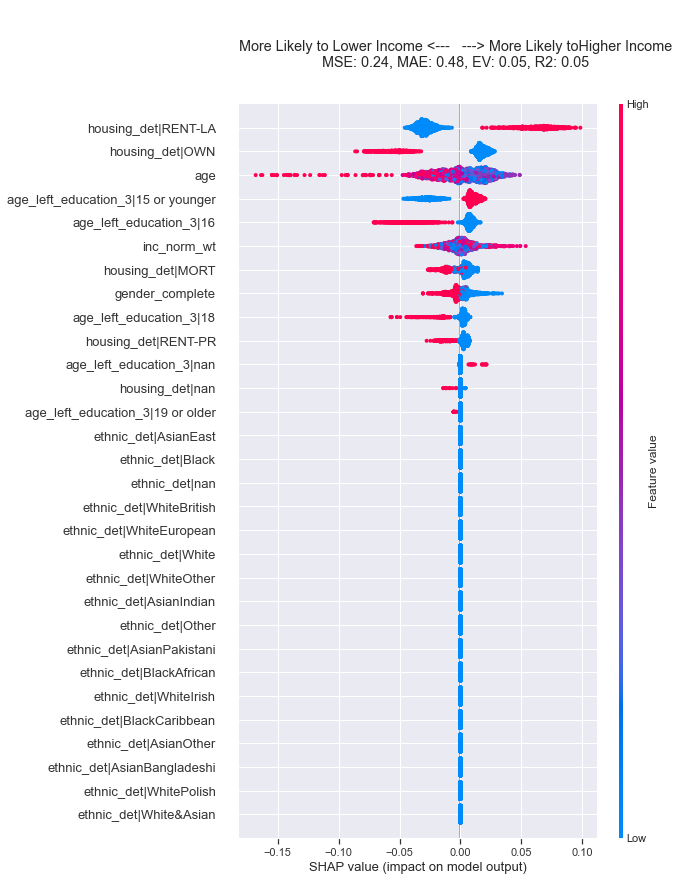

***************************
1974_feb
***************************
MSE: 0.23, MAE: 0.46, EV: 0.07, R2: 0.07


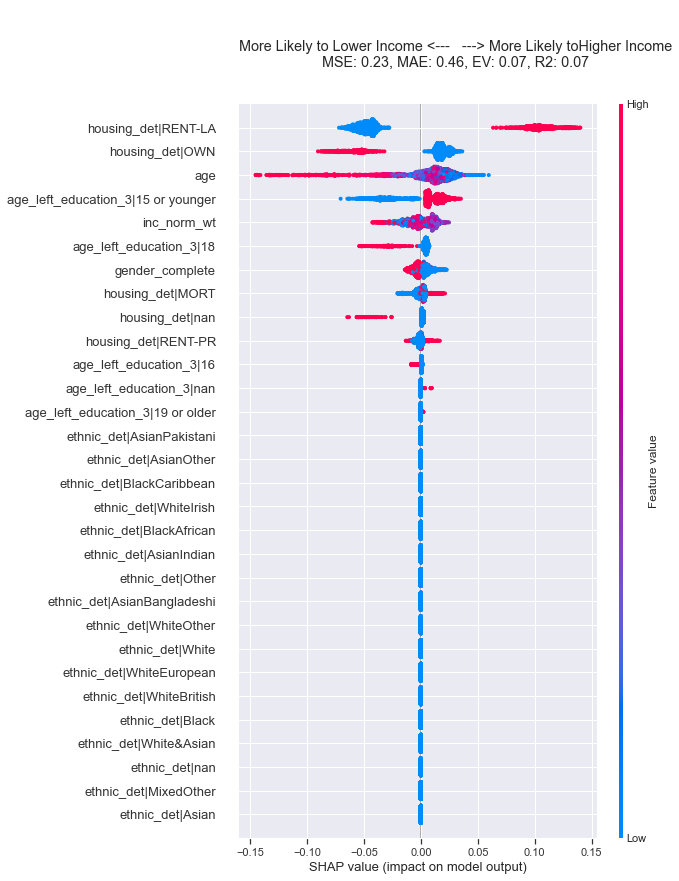

***************************
1979
***************************
MSE: 0.24, MAE: 0.49, EV: 0.01, R2: 0.01


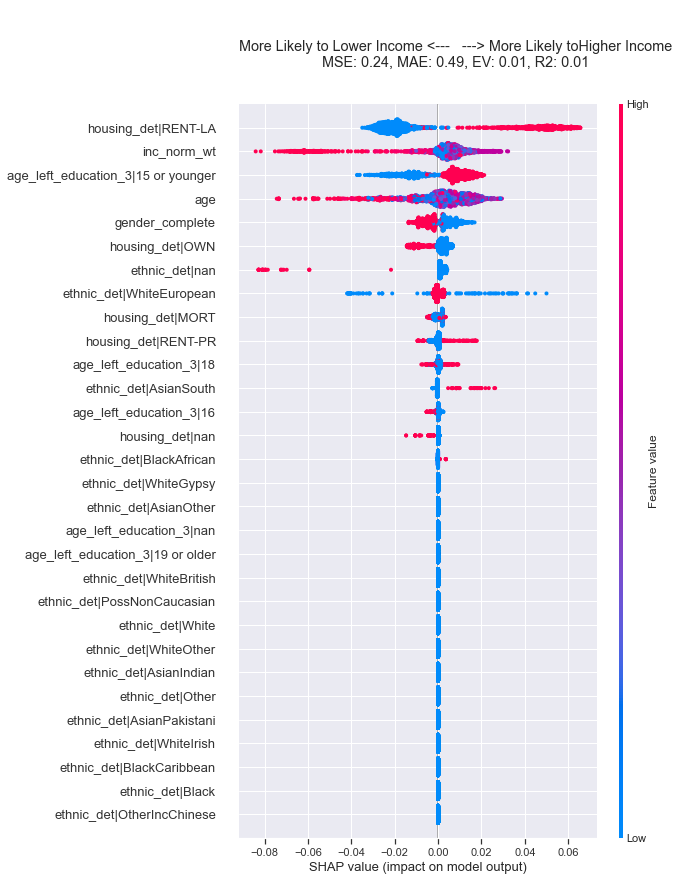

***************************
1983
***************************
MSE: 0.24, MAE: 0.49, EV: 0.03, R2: 0.03


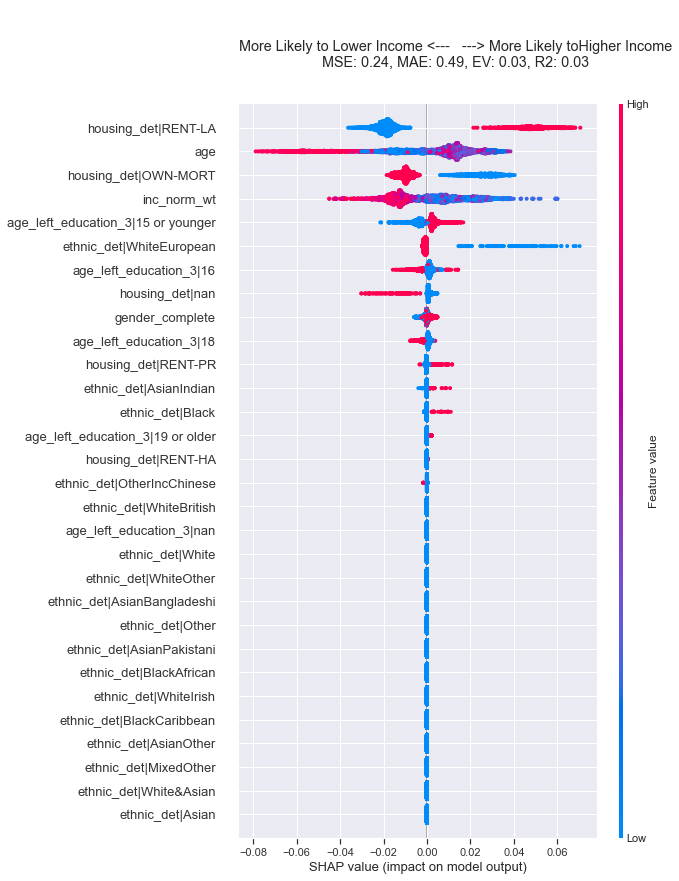

***************************
1987
***************************
MSE: 0.23, MAE: 0.46, EV: 0.08, R2: 0.08


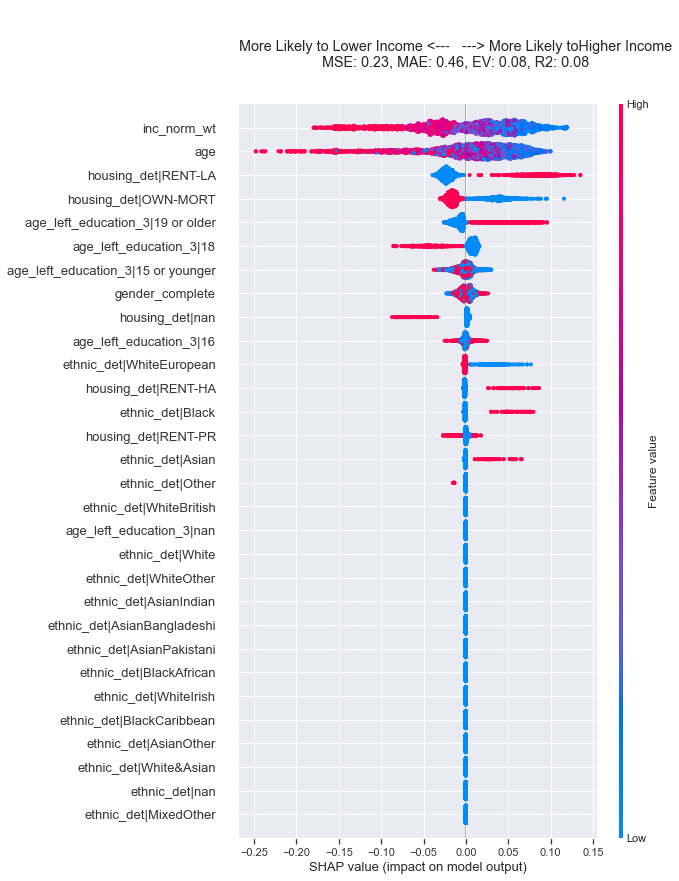

***************************
1992
***************************
MSE: 0.24, MAE: 0.48, EV: 0.04, R2: 0.04


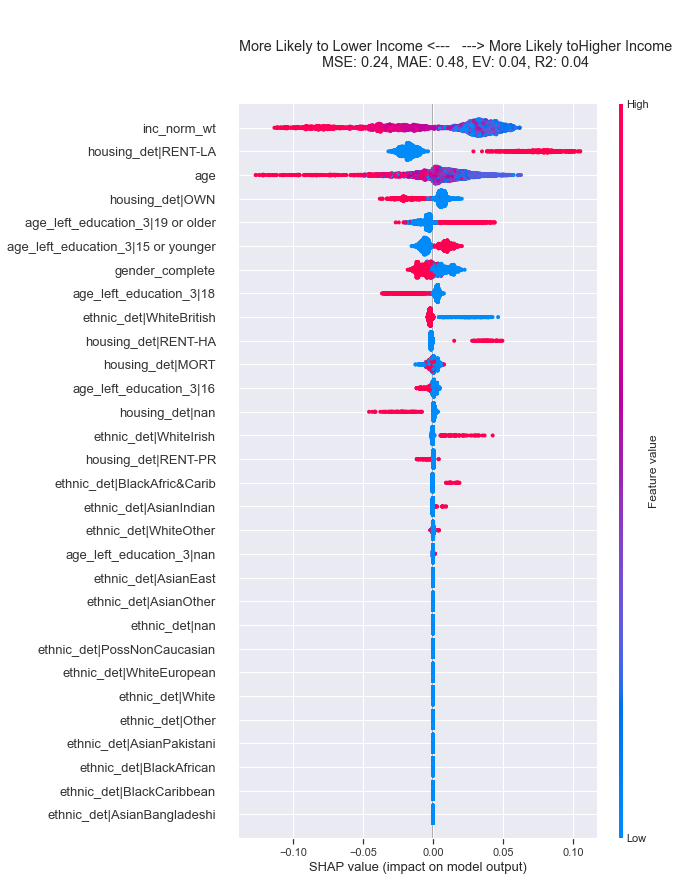

***************************
1997
***************************
MSE: 0.24, MAE: 0.48, EV: 0.02, R2: 0.02


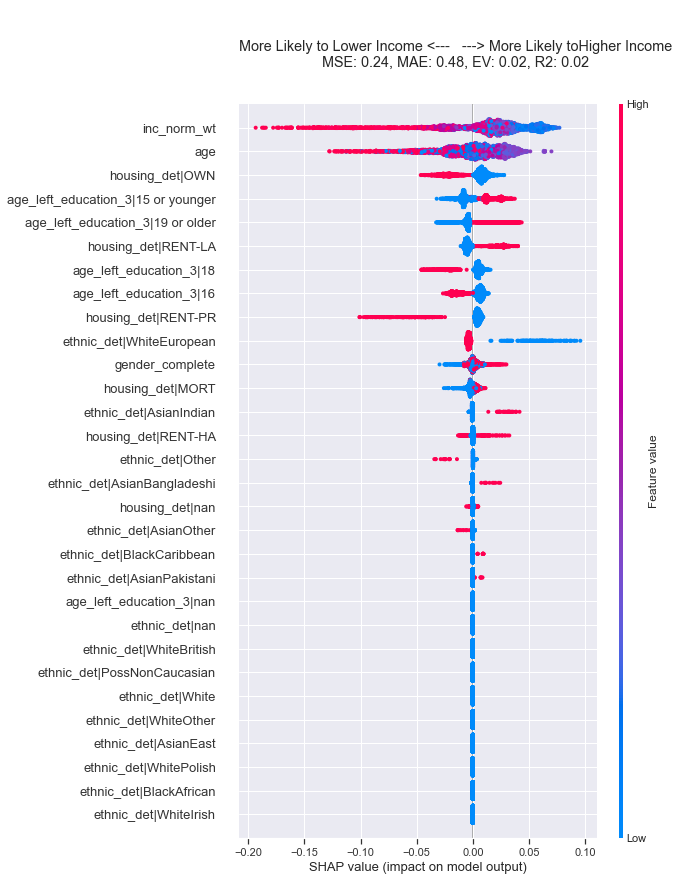

***************************
2001
***************************
MSE: 0.24, MAE: 0.48, EV: 0.03, R2: 0.03


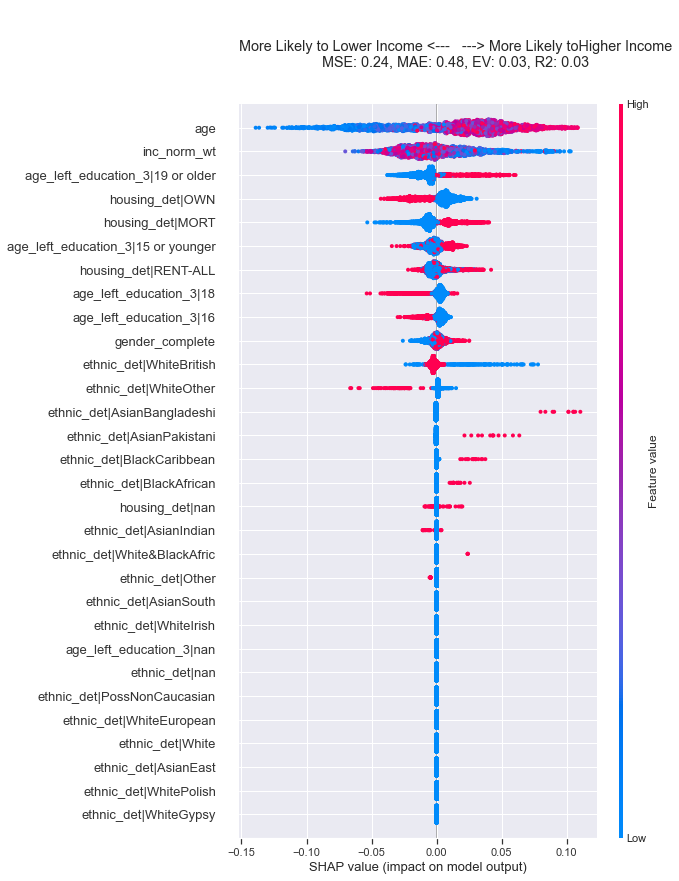

***************************
2005
***************************
MSE: 0.24, MAE: 0.49, EV: 0.03, R2: 0.03


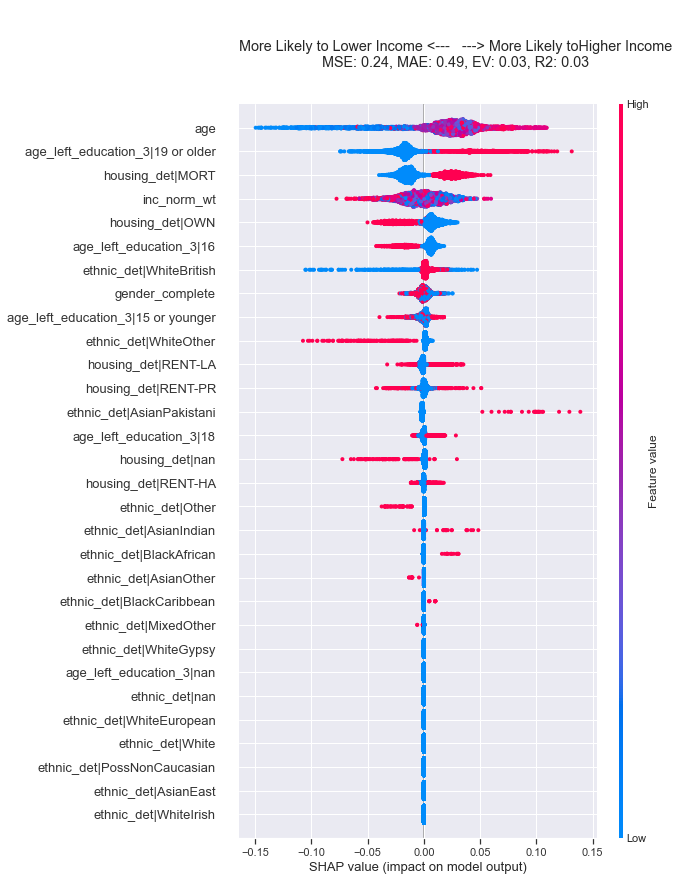

***************************
2010
***************************
MSE: 0.24, MAE: 0.48, EV: 0.02, R2: 0.02


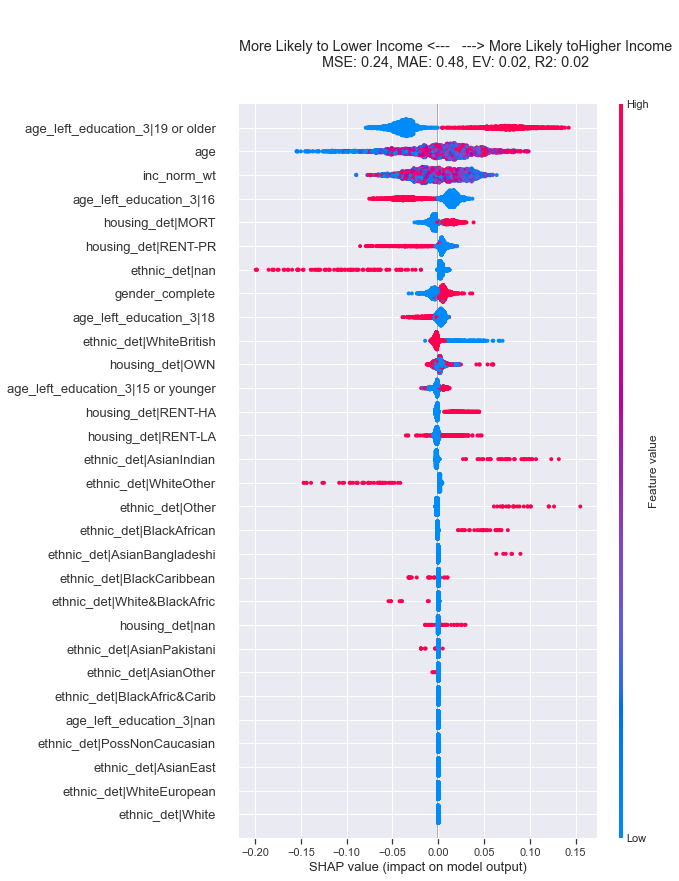

***************************
2015
***************************
MSE: 0.23, MAE: 0.46, EV: 0.00, R2: 0.00


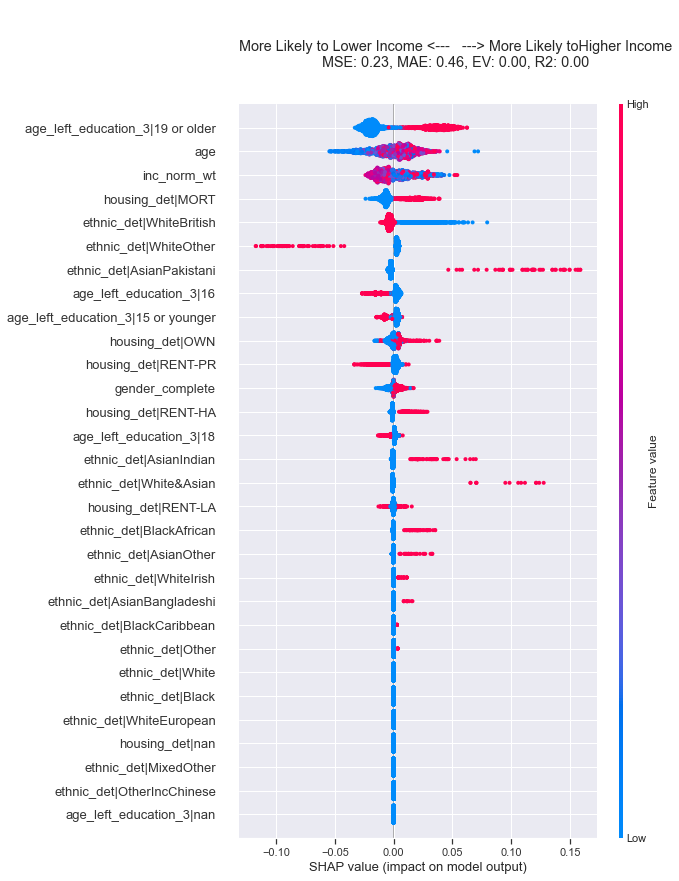

***************************
2017
***************************
MSE: 0.24, MAE: 0.48, EV: 0.04, R2: 0.03


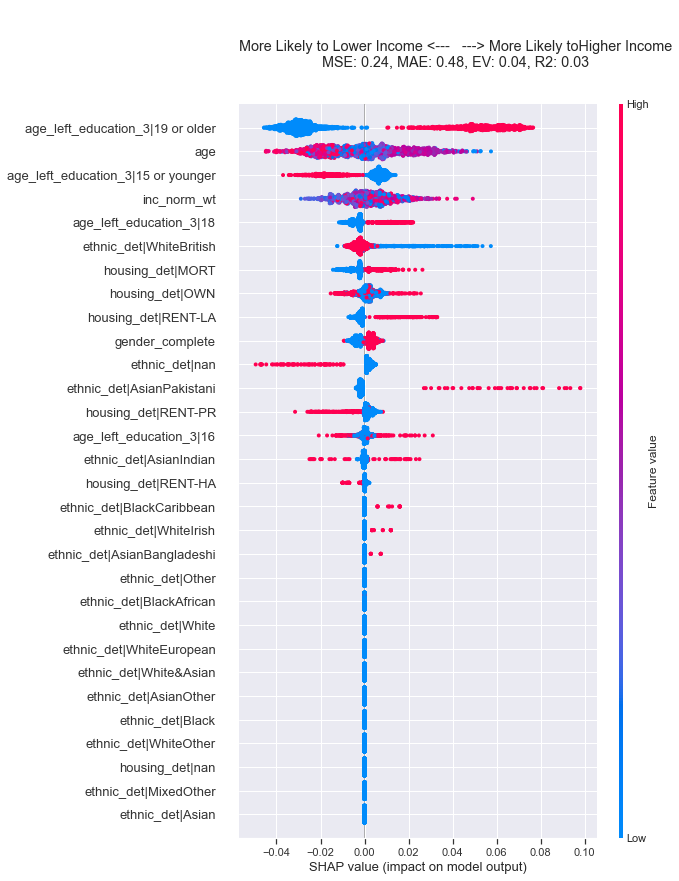

***************************
2019
***************************
MSE: 0.22, MAE: 0.45, EV: 0.07, R2: 0.07


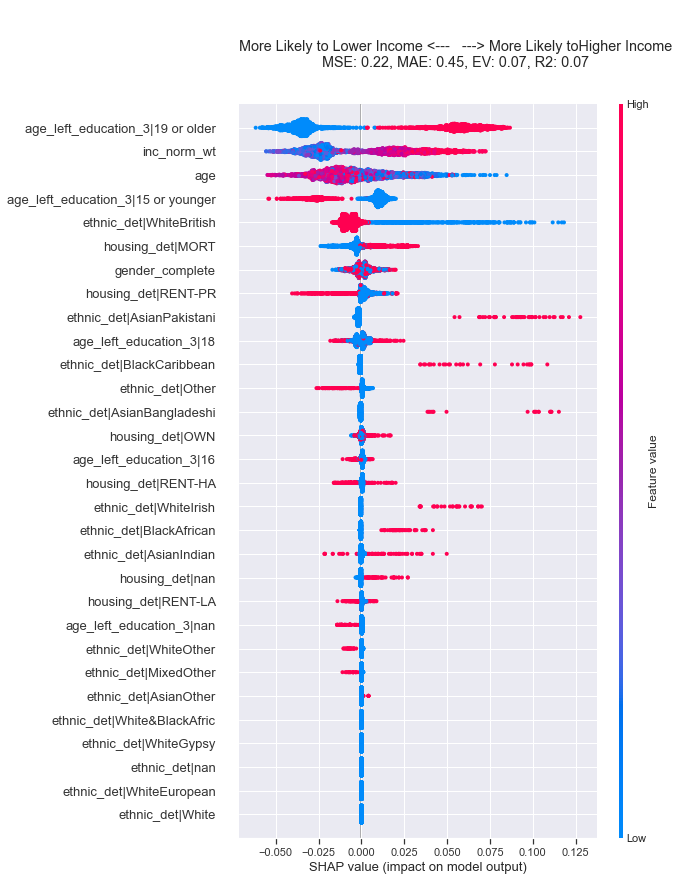

DNV
***************************
1959
***************************
MSE: 0.11, MAE: 0.24, EV: 0.06, R2: 0.06


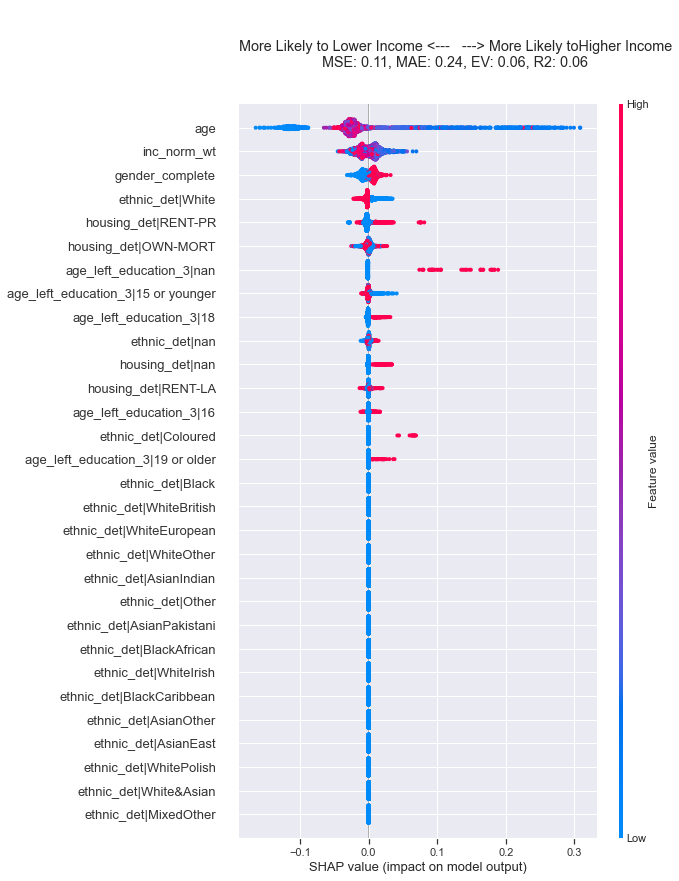

***************************
1964
***************************
MSE: 0.10, MAE: 0.21, EV: -0.02, R2: -0.03


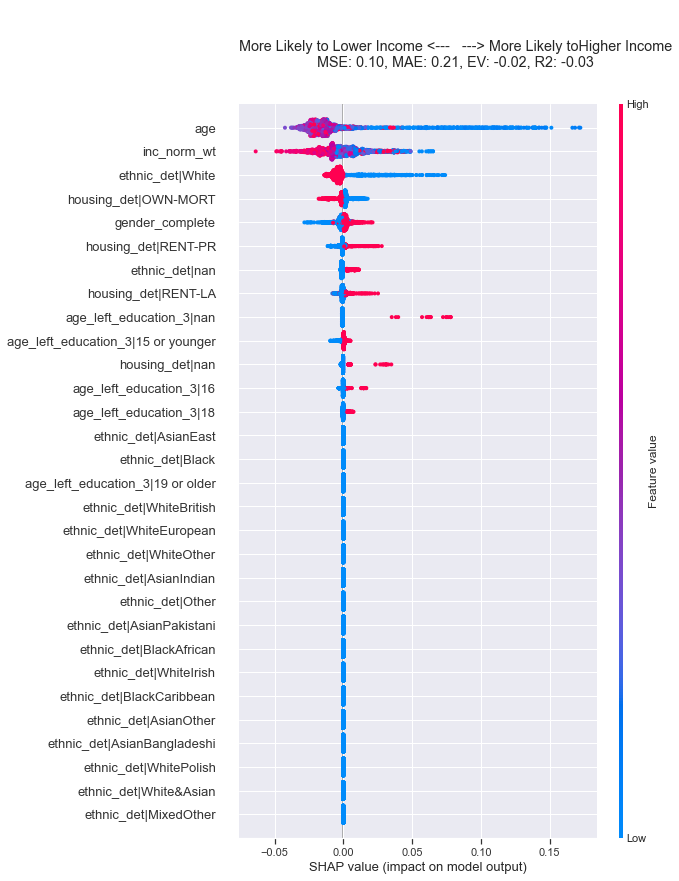

***************************
1966
***************************
MSE: 0.12, MAE: 0.24, EV: 0.04, R2: 0.04


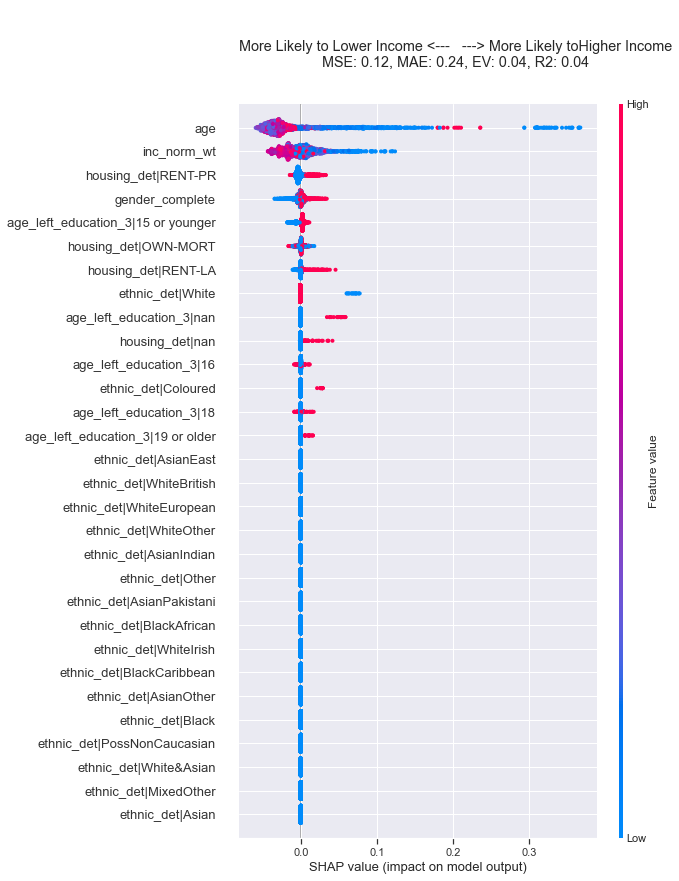

***************************
1970
***************************
MSE: 0.14, MAE: 0.29, EV: -0.00, R2: -0.01


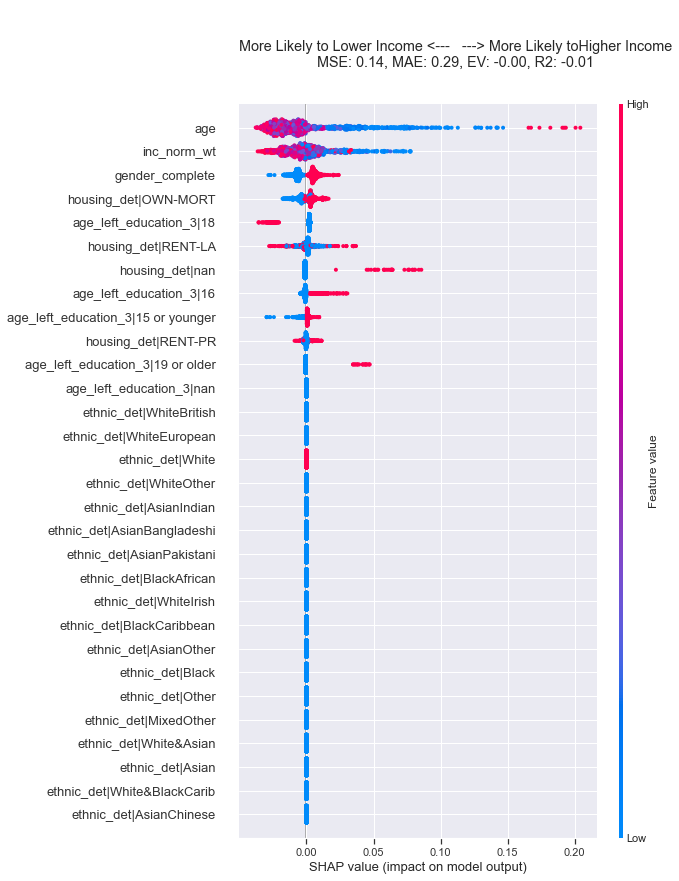

***************************
1974_oct
***************************
MSE: 0.12, MAE: 0.25, EV: 0.04, R2: 0.04


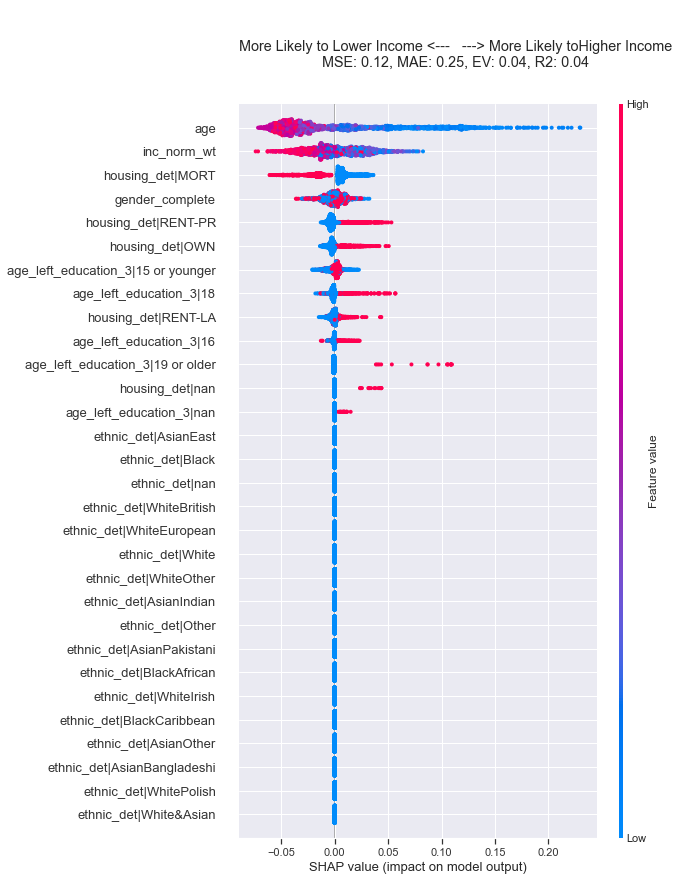

***************************
1974_feb
***************************
MSE: 0.11, MAE: 0.22, EV: 0.01, R2: 0.01


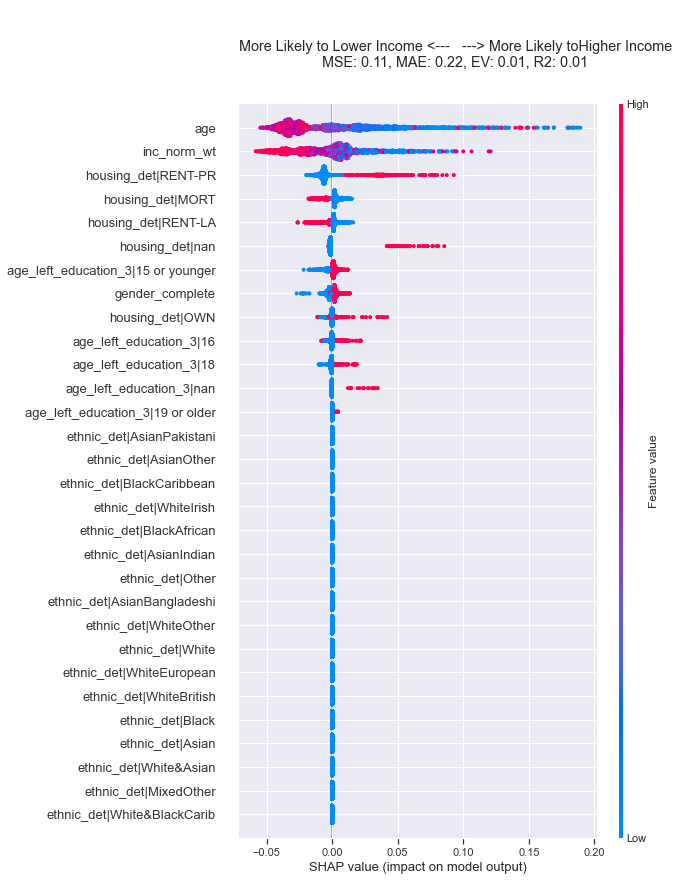

***************************
1979
***************************
MSE: 0.12, MAE: 0.24, EV: 0.08, R2: 0.08


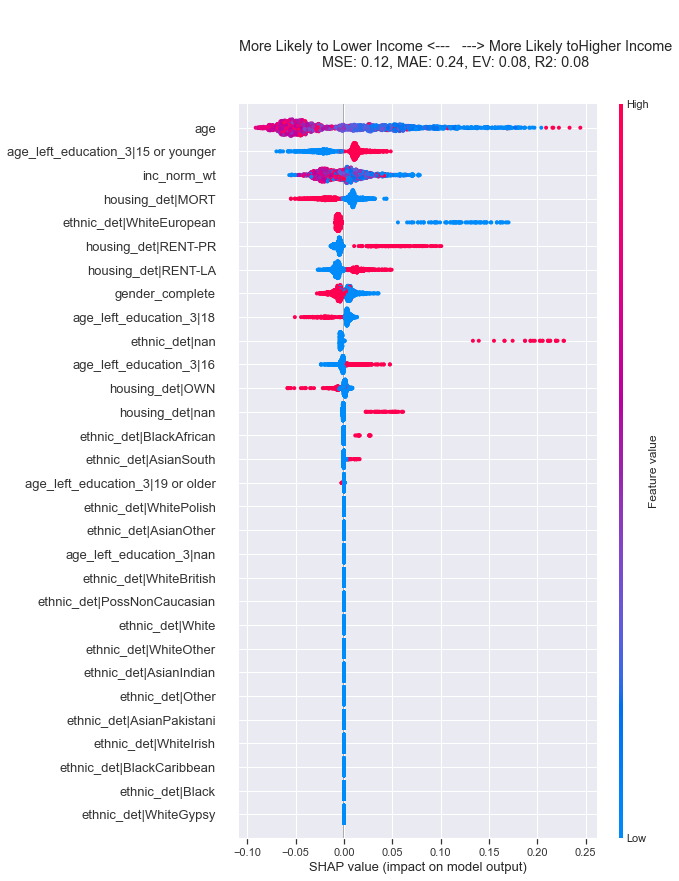

***************************
1983
***************************
MSE: 0.14, MAE: 0.28, EV: 0.02, R2: 0.02


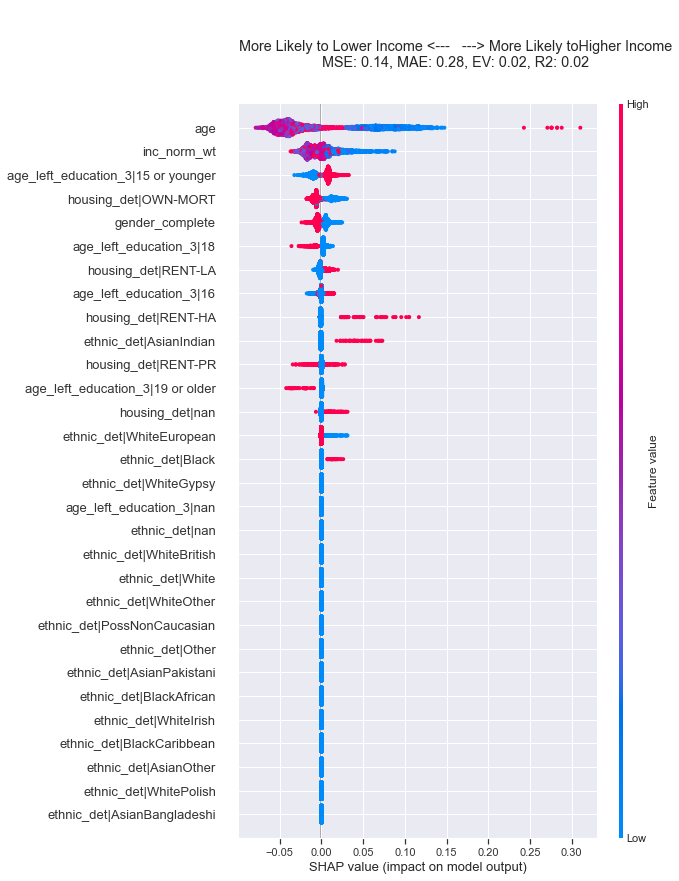

***************************
1987
***************************
MSE: 0.12, MAE: 0.25, EV: 0.03, R2: 0.02


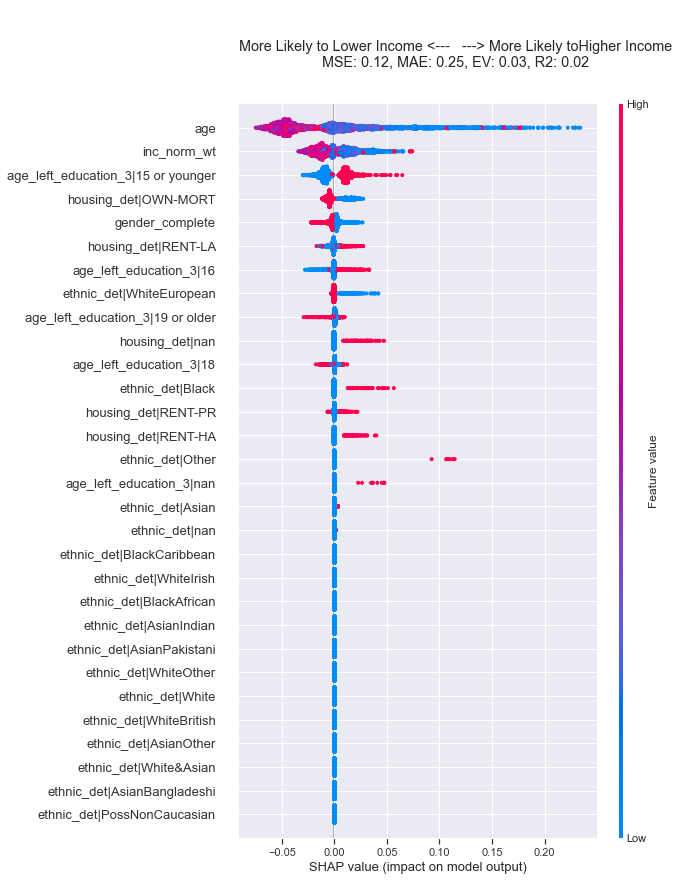

***************************
1992
***************************
MSE: 0.11, MAE: 0.24, EV: 0.02, R2: 0.02


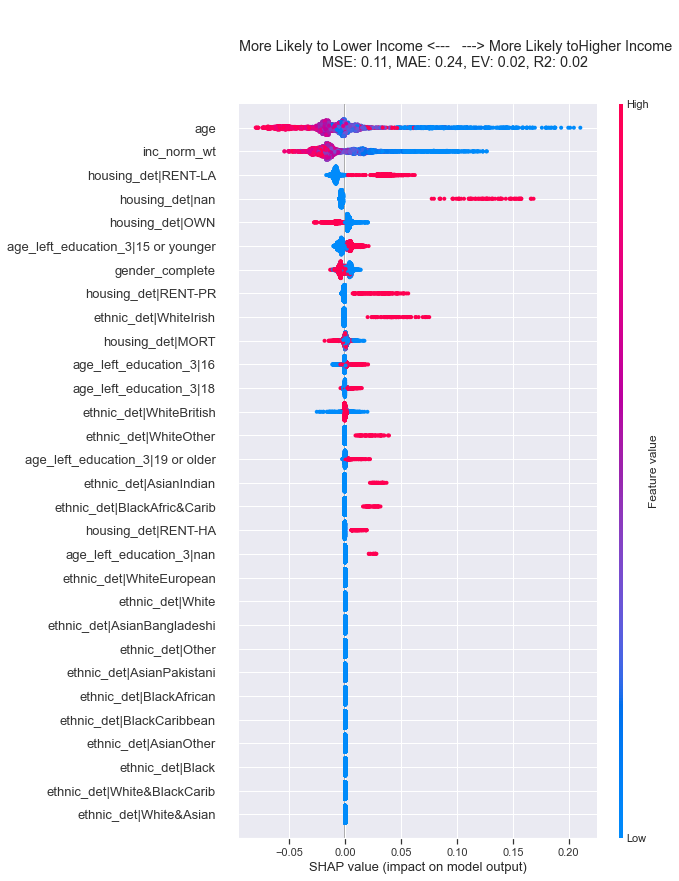

***************************
1997
***************************
MSE: 0.14, MAE: 0.28, EV: 0.06, R2: 0.06


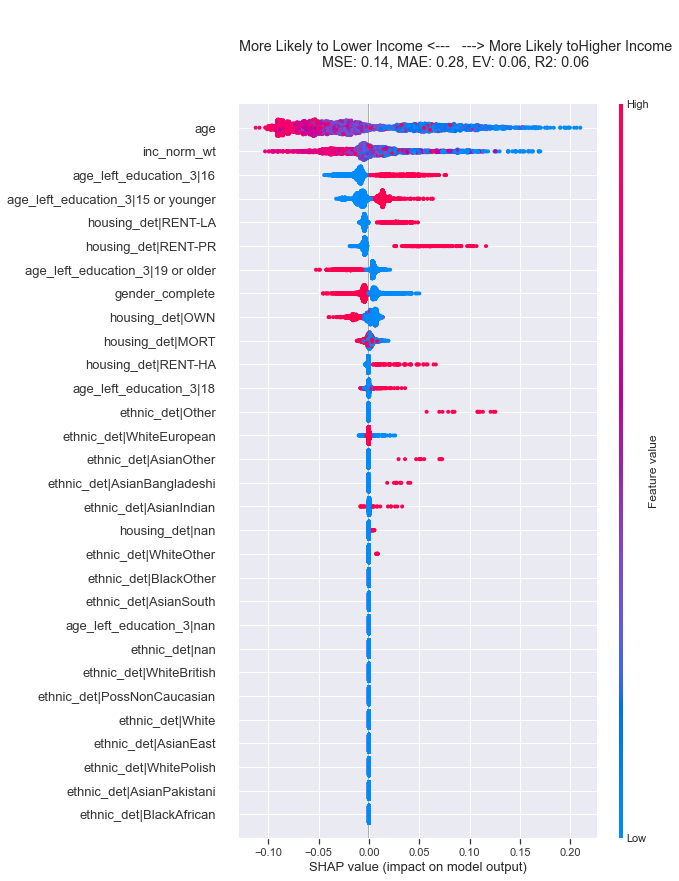

***************************
2001
***************************
MSE: 0.18, MAE: 0.37, EV: 0.10, R2: 0.09


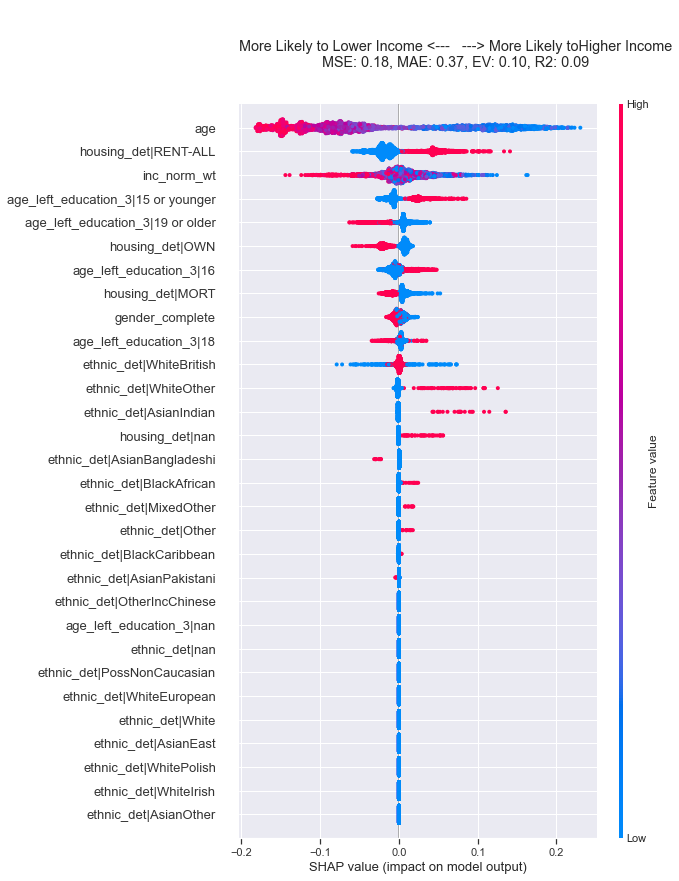

***************************
2005
***************************
MSE: 0.17, MAE: 0.35, EV: 0.13, R2: 0.13


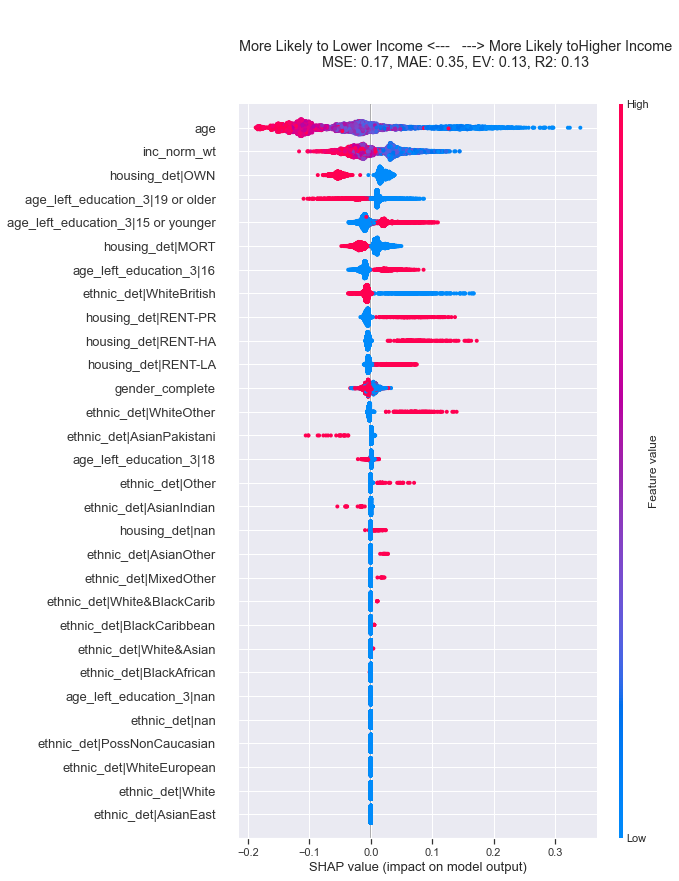

***************************
2010
***************************
MSE: 0.15, MAE: 0.31, EV: 0.13, R2: 0.13


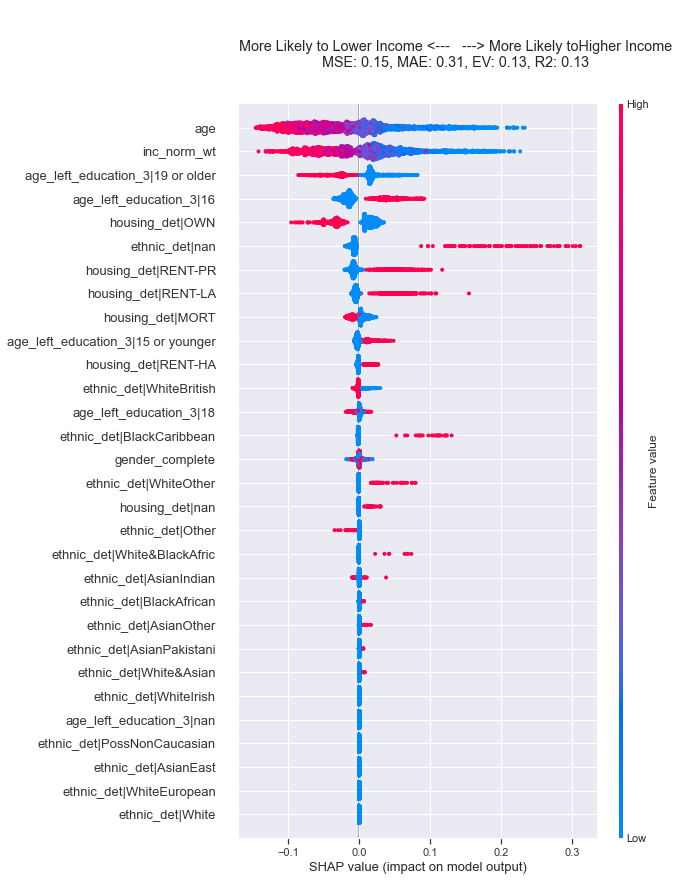

***************************
2015
***************************
MSE: 0.17, MAE: 0.35, EV: 0.15, R2: 0.13


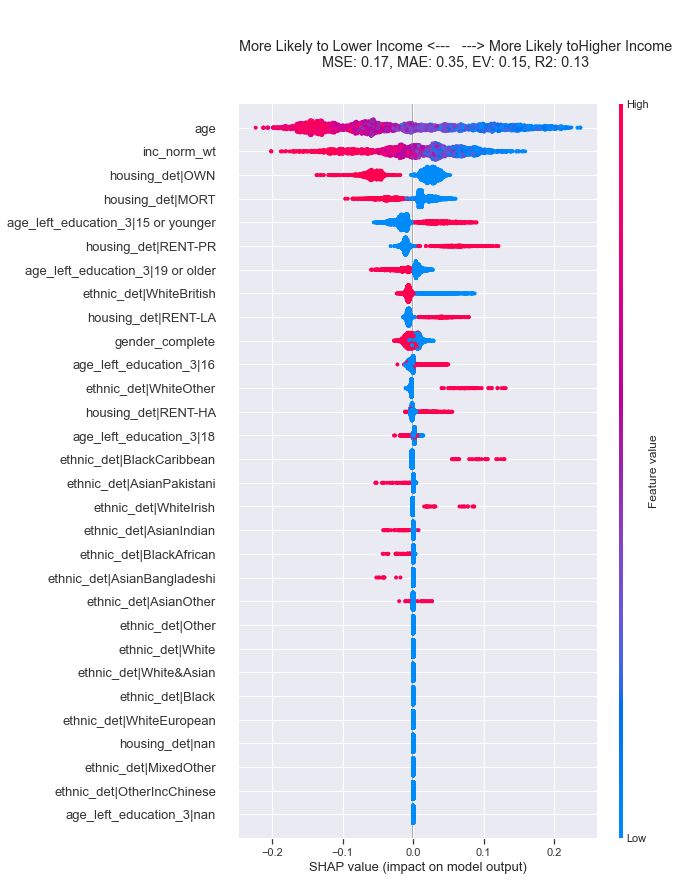

***************************
2017
***************************
MSE: 0.15, MAE: 0.31, EV: 0.16, R2: 0.14


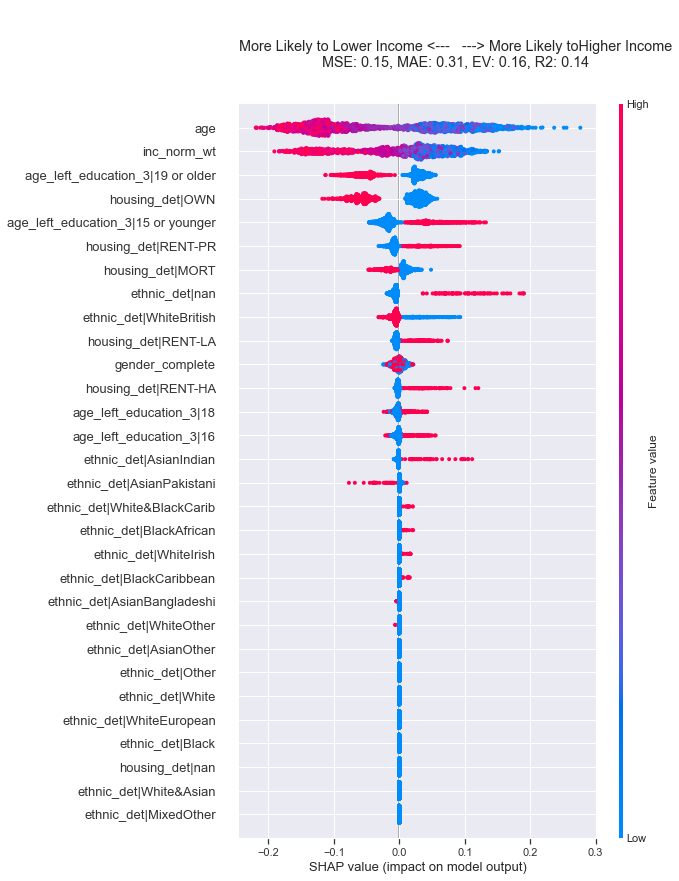

***************************
2019
***************************
MSE: 0.15, MAE: 0.33, EV: 0.10, R2: 0.04


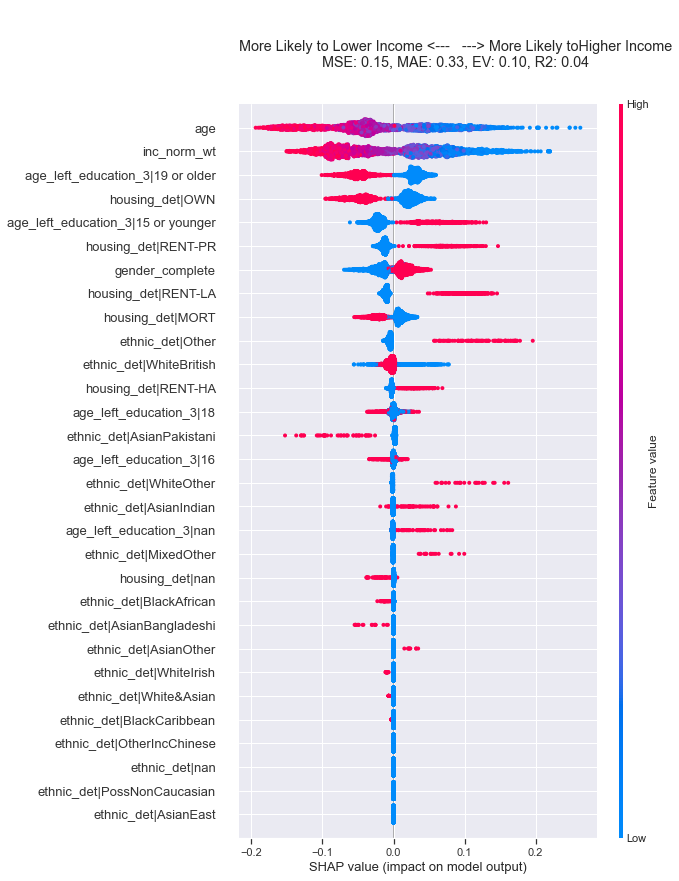

In [51]:
generic_cols = f2f_harmonised.columns
harm_vars = ["wt","age","housing_det",
                                  'gender_complete', 
#              'age_left_education',
                                  'age_left_education_3',
             'inc_norm_wt',
#            'region_harm',  'tumember',
#            'tumember_det', 'marital', 'marital_det',
             'ethnic_det',
#              'relig_det',
            ]

generic_cols = f2f_harmonised.columns
drop_vars = []
for target in ["AuthRight","LibLeft","DNV"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in f2f_harmonised["dataset"].unique()[::-1]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=False, drop_vars = drop_vars, harm_vars=harm_vars,
                          harmonised_only=True,min_features=30)